# Evaluer les modèles

## Imports

In [ ]:
import gc
import json
import os
import re
import sys
import time
import warnings
from datetime import datetime
import torch

import numpy as np
import pandas as pd

from torch.utils.data import DataLoader
from concurrent.futures import ThreadPoolExecutor, as_completed

from torch.utils.data import Dataset
from tqdm.auto import tqdm

from PIL import Image

import matplotlib.pyplot as plt
from matplotlib.gridspec import GridSpec
import seaborn as sns

from loguru import logger
import segmentation_models_pytorch as smp

from pathlib import Path
from ultralytics import YOLO
import cv2
from collections import defaultdict

# Suppress all warnings for cleaner output
warnings.filterwarnings('ignore')

# Enable optimized CUDA settings for Ampere GPUs
torch.backends.cuda.matmul.allow_tf32 = True
torch.backends.cudnn.allow_tf32 = True
torch.backends.cudnn.benchmark = True
torch.backends.cudnn.deterministic = False
torch.backends.cuda.enable_flash_sdp(True)
torch.backends.cuda.matmul.allow_fp16_reduced_precision_reduction = True

## Variables

In [4]:
todays_date = datetime.now().strftime("%Y%m%d-%H%M%S")

INPUT_MODELS_BASE_DIR_PATH = "data/training"

BASE_DATASET_DIR = "datasets/supervisely/dataset_processed_20250523-173715"
DATASET_IMAGES_DIR = BASE_DATASET_DIR + "/images"
DATASET_MASKS_DIR = BASE_DATASET_DIR + "/masks"
TEST_DATASET_FILE = BASE_DATASET_DIR + "/test_dataset.txt"
IMG_SIZE = (1280, 1280)

OUTPUT_BASE_DIR_PATH = "data/notebook_07/"
OUTPUT_PARQUET_PATH = OUTPUT_BASE_DIR_PATH + "parquet/"
GRAPHICS_PATH = OUTPUT_BASE_DIR_PATH + f"graphics/{todays_date}/"

# si MAJ_DATASET est à True, le dataset sera mis à jour
# sinon, il sera chargé depuis le fichier parquet
SAVED_MODEL_RESULTS_PARQUET_PATH = OUTPUT_PARQUET_PATH + "model_evaluation_models_20250629_210320.parquet"
SAVED_PER_IMAGE_RESULTS_PARQUET_PATH = OUTPUT_PARQUET_PATH + "model_evaluation_per_image_20250629_210320.parquet"

# YOLO
TEST_DATASET_PATH = "datasets/supervisely/yolo_processed_20250619_151249/fold_0_dataset/test"

# Analyse qualitative
VIZ_OUTPUT_DIR = Path(OUTPUT_BASE_DIR_PATH + f"analyse_qualitative/{todays_date}/")

# Quartier
QUARTIER_OUTPUT_DIR = Path(OUTPUT_BASE_DIR_PATH + f"analyse_quartier/{todays_date}/")

# -------------------
# Fonctionalités
# -------------------

MAJ_DATASET = False # False/True
YOLO_EVALUATE = False # False/True
EVALUER_ENSEMBLE = False # False/True

In [5]:
os.makedirs(OUTPUT_BASE_DIR_PATH, exist_ok=True)
os.makedirs(OUTPUT_PARQUET_PATH, exist_ok=True)
os.makedirs(GRAPHICS_PATH, exist_ok=True)

In [6]:
logger.remove()
logger.add(sys.stderr, level="INFO", format="{time:YYYY-MM-DD HH:mm:ss} | {level} | {message}")


1

## Charger données

In [ ]:
if MAJ_DATASET:
    def get_best_model_paths(base_dir):
        """
        Recursively find all 'single_fold_complete_results.json' files in the given directory.
        """
        model_paths = []
        for root, dirs, files in os.walk(base_dir):
            for file in files:
                # Match the specific result file pattern
                if re.match(r"single_fold_complete_results.json", file):
                    model_paths.append(os.path.join(root, file))
        return model_paths

    def test_json_parsing(json_file_path):
        """
        Test JSON parsing and DataFrame creation from a single file.
        """
        print("Testing JSON parsing...")
        try:
            # Load the JSON file
            with open(json_file_path, 'r') as f:
                data = json.load(f)
            print("JSON file loaded successfully")
            print(f"Structure: {list(data.keys())}")

            # Parse the file into a DataFrame
            df_test = json_files_to_dataframe([json_file_path])
            print(f"DataFrame created with shape: {df_test.shape}")
            print(f"Columns: {df_test.columns.tolist()}")

            # Complete the DataFrame with additional processing
            df_complete = completer_df(df_test)
            print(f"DataFrame completed with shape: {df_complete.shape}")

            # Display sample data for key columns
            print("\nSample data:")
            for col in ['config', 'validation_fold', 'architecture', 'backbone', 'test_iou', 'model_path']:
                if col in df_complete.columns:
                    print(f"  {col}: {df_complete[col].iloc[0]}")

            return df_complete

        except Exception as e:
            print(f"Error: {e}")
            return None

    def json_files_to_dataframe(model_paths):
        """
        Read multiple JSON files and concatenate them into a pandas DataFrame.
        """
        all_data = []
        for json_path in model_paths:
            try:
                with open(json_path, 'r') as f:
                    data = json.load(f)

                # Helper to safely access nested dictionary values
                def safe_get(data, keys, default=''):
                    current = data
                    for key in keys:
                        if isinstance(current, dict) and key in current:
                            current = current[key]
                        else:
                            return default
                    return current

                # Flatten relevant fields from the JSON structure
                flattened_data = {
                    'file_path': json_path,
                    'config': safe_get(data, ['config']),
                    'validation_fold': safe_get(data, ['fold']),
                    'architecture': safe_get(data, ['training_config', 'architecture']),
                    'backbone': safe_get(data, ['training_config', 'backbone']),
                    'encoder_weights': safe_get(data, ['training_config', 'encoder_weights']),
                    'img_size': safe_get(data, ['training_config', 'img_size']),
                    'num_classes': safe_get(data, ['training_config', 'num_classes']),
                    'batch_size': safe_get(data, ['training_config', 'batch_size']),
                    'learning_rate': safe_get(data, ['training_config', 'learning_rate']),
                    'epochs': safe_get(data, ['training_config', 'epochs']),
                    'patience': safe_get(data, ['training_config', 'patience']),
                    'accumulation_steps': safe_get(data, ['training_config', 'accumulation_steps']),
                    'auto_batch_size': safe_get(data, ['training_config', 'auto_batch_size']),
                    'min_batch_size_search': safe_get(data, ['training_config', 'min_batch_size_search']),
                    'max_batch_size_search': safe_get(data, ['training_config', 'max_batch_size_search']),
                    'batch_size_test_steps': safe_get(data, ['training_config', 'batch_size_test_steps']),
                    'best_val_iou': safe_get(data, ['results', 'best_val_iou']),
                    'final_val_iou': safe_get(data, ['results', 'final_val_metrics', 'iou']),
                    'final_val_f1_score': safe_get(data, ['results', 'final_val_metrics', 'f1_score']),
                    'final_val_accuracy': safe_get(data, ['results', 'final_val_metrics', 'accuracy']),
                    'final_val_recall': safe_get(data, ['results', 'final_val_metrics', 'recall']),
                    'final_val_precision': safe_get(data, ['results', 'final_val_metrics', 'precision']),
                    'test_iou': safe_get(data, ['results', 'test_metrics', 'iou']),
                    'test_f1_score': safe_get(data, ['results', 'test_metrics', 'f1_score']),
                    'test_accuracy': safe_get(data, ['results', 'test_metrics', 'accuracy']),
                    'test_recall': safe_get(data, ['results', 'test_metrics', 'recall']),
                    'test_precision': safe_get(data, ['results', 'test_metrics', 'precision']),
                    'total_seconds': safe_get(data, ['results', 'timing', 'total_seconds']),
                    'total_time_formatted': safe_get(data, ['results', 'timing', 'total_time_formatted']),
                    'total_epochs_trained': safe_get(data, ['results', 'timing', 'total_epochs_trained']),
                    'average_seconds_per_epoch': safe_get(data, ['results', 'timing', 'average_seconds_per_epoch']),
                    'start_timestamp': safe_get(data, ['results', 'timing', 'start_timestamp']),
                    'end_timestamp': safe_get(data, ['results', 'timing', 'end_timestamp']),
                    'plot_path': safe_get(data, ['results', 'plot_path']),
                    'pred_path': safe_get(data, ['results', 'pred_path'])
                }
                all_data.append(flattened_data)
            except Exception as e:
                print(f"Error reading {json_path}: {e}")
                continue

        # Combine all records into a DataFrame
        df = pd.DataFrame(all_data)
        print(f"Loaded {len(df)} records from {len(model_paths)} JSON files")
        return df

    def completer_df(df):
        """
        Process and complete the DataFrame with additional fields and type conversions.
        """
        df_temp = df.copy()

        # Construct model path based on validation fold
        try:
            df_temp["validation_fold_str"] = df_temp["validation_fold"].astype(str)
            df_temp["model_path"] = (
                df_temp["file_path"].str.replace("single_fold_complete_results.json", "") +
                "best_model_fold_" +
                df_temp["validation_fold_str"] +
                ".pth"
            )
            df_temp = df_temp.drop("validation_fold_str", axis=1)
        except Exception as e:
            print(f"Error creating model_path: {e}")
            df_temp["model_path"] = df_temp["file_path"].str.replace("single_fold_complete_results.json", "best_model.pth")

        # Convert timestamps to datetime objects
        try:
            df_temp["model_start_date"] = pd.to_datetime(df_temp["start_timestamp"], errors='coerce')
            df_temp["model_end_date"] = pd.to_datetime(df_temp["end_timestamp"], errors='coerce')
        except Exception as e:
            print(f"Error converting timestamps: {e}")
            df_temp["model_start_date"] = pd.NaT
            df_temp["model_end_date"] = pd.NaT

        # Convert total training time from seconds to hours
        try:
            df_temp["total_training_time_hour"] = pd.to_numeric(df_temp["total_seconds"], errors='coerce') / 3600
        except Exception as e:
            print(f"Error converting training time: {e}")
            df_temp["total_training_time_hour"] = np.nan

        # Convert numeric fields to appropriate types
        numeric_fields = [
            'learning_rate', 'epochs', 'patience', 'accumulation_steps', 'batch_size',
            'num_classes', 'min_batch_size_search', 'max_batch_size_search', 'batch_size_test_steps',
            'best_val_iou', 'final_val_iou', 'final_val_f1_score', 'final_val_accuracy',
            'final_val_recall', 'final_val_precision',
            'test_iou', 'test_f1_score', 'test_accuracy', 'test_recall', 'test_precision',
            'total_seconds', 'total_epochs_trained', 'average_seconds_per_epoch', 'validation_fold'
        ]
        for field in numeric_fields:
            if field in df_temp.columns:
                try:
                    df_temp[field] = df_temp[field].replace('', np.nan)
                    df_temp[field] = pd.to_numeric(df_temp[field], errors='coerce')
                except Exception as e:
                    print(f"Error converting {field} to numeric: {e}")

        # Convert boolean fields
        boolean_fields = ['auto_batch_size']
        for field in boolean_fields:
            if field in df_temp.columns:
                try:
                    df_temp[field] = df_temp[field].replace({'true': True, 'false': False, 'True': True, 'False': False})
                    df_temp[field] = df_temp[field].astype('bool', errors='ignore')
                except Exception as e:
                    print(f"Error converting {field} to boolean: {e}")

        # Convert img_size from string to tuple if needed
        if 'img_size' in df_temp.columns:
            try:
                df_temp['img_size_processed'] = df_temp['img_size'].apply(
                    lambda x: eval(x) if isinstance(x, str) and x.startswith('(') else x
                )
            except Exception as e:
                print(f"Error processing img_size: {e}")
                df_temp['img_size_processed'] = df_temp['img_size']

        print(f"Data processing complete. DataFrame shape: {df_temp.shape}")
        return df_temp


In [ ]:
if MAJ_DATASET:
    # Retrieve all JSON files containing model results
    model_paths = get_best_model_paths(INPUT_MODELS_BASE_DIR_PATH)
    print(f"Found {len(model_paths)} JSON files")
    
    if len(model_paths) == 0:
        print("No JSON files found. Please check your INPUT_MODELS_BASE_DIR_PATH.")
        print(f"Directory searched: {INPUT_MODELS_BASE_DIR_PATH}")
        exit()
    
    # Test JSON parsing with the first file to validate structure
    print("Testing JSON parsing with the first file...")
    test_result = test_json_parsing(model_paths[0])
    if test_result is None:
        print("JSON parsing test failed. Please check your JSON structure.")
        exit()
    
    print("JSON parsing test successful.")
    
    # Process all JSON files into a DataFrame
    print(f"\nProcessing {len(model_paths)} JSON files...")
    df_test_json = json_files_to_dataframe(model_paths)
    df_test_models = completer_df(df_test_json)
    
    # Display summary information about the dataset
    print("\n" + "="*50)
    print("DATASET SUMMARY")
    print("="*50)
    print(f"Total models: {len(df_test_models)}")
    print(f"Unique configs: {df_test_models['config'].nunique()}")
    print(f"Validation folds: {sorted(df_test_models['validation_fold'].unique())}")
    print(f"Architectures: {df_test_models['architecture'].unique()}")
    print(f"Backbones: {df_test_models['backbone'].nunique()} unique")
    
    # Check for missing values in important columns
    print("\nDATA QUALITY CHECKS:")
    print("-" * 20)
    key_columns = ['config', 'architecture', 'backbone', 'test_iou', 'best_val_iou']
    for col in key_columns:
        if col in df_test_models.columns:
            missing = df_test_models[col].isna().sum()
            print(f"Missing {col}: {missing}/{len(df_test_models)} ({missing/len(df_test_models)*100:.1f}%)")
    
    # Verify that each config has results for all folds (should be 5)
    config_counts = df_test_models['config'].value_counts()
    incomplete_configs = config_counts[config_counts != 5]
    if len(incomplete_configs) > 0:
        print(f"\nWarning: {len(incomplete_configs)} configs do not have results for all 5 folds:")
        for config, count in incomplete_configs.head().items():
            print(f"  {config}: {count} folds")
    else:
        print("All configs have results for 5 folds.")
    
    # Check for missing model files on disk
    missing_models = df_test_models[~df_test_models['model_path'].apply(os.path.exists)]
    if len(missing_models) > 0:
        print(f"\nWarning: {len(missing_models)} model files not found:")
        for path in missing_models['model_path'].head(5):
            print(f"  {path}")
        
        print(f"\n{len(missing_models)} out of {len(df_test_models)} model files are missing.")
        response = input("Continue with available models? (y/n): ").lower().strip()
        if response != 'y':
            print("Exiting...")
            exit()
        else:
            # Exclude models with missing files
            df_test_models = df_test_models[df_test_models['model_path'].apply(os.path.exists)]
            print(f"Continuing with {len(df_test_models)} models with available files.")
    else:
        print("All model files found.")
    
    # Exclude models with test IoU below threshold
    df_test_models = df_test_models[df_test_models['test_iou'] >= 0.1]

    # Display performance statistics
    if 'test_iou' in df_test_models.columns:
        test_iou_clean = df_test_models['test_iou'].dropna()
        if len(test_iou_clean) > 0:
            print("\nPERFORMANCE RANGE:")
            print(f"Test IoU: {test_iou_clean.min():.3f} - {test_iou_clean.max():.3f}")
            print(f"Mean Test IoU: {test_iou_clean.mean():.3f}")
    
    print("="*50)
    print("Ready to proceed with evaluation.")
    print("="*50)


## Evaluate SMP test

In [ ]:
def load_test_data(test_file, images_dir, masks_dir):
    """Load test image and mask file paths from a list file."""
    with open(test_file, "r") as f:
        filenames = [line.strip() for line in f.readlines()]

    images = []
    masks = []

    for filename in filenames:
        mask_path = os.path.join(masks_dir, filename)
        image_path = os.path.join(images_dir, filename)

        if os.path.exists(image_path) and os.path.exists(mask_path):
            images.append(image_path)
            masks.append(mask_path)

    logger.debug(f"Loaded {len(images)} test samples")
    return {"images": images, "masks": masks}


class SimpleSegmentationDataset(Dataset):
    """Dataset for segmentation tasks with memory optimization."""

    def __init__(
        self, image_paths, mask_paths, img_size, transform=None, cache_size=250
    ):
        self.image_paths = image_paths
        self.mask_paths = mask_paths
        self.img_size = img_size
        self.transform = transform
        self.cache_size = cache_size
        self._cache = {}

        assert len(image_paths) == len(mask_paths), "Mismatch between images and masks"

        valid_pairs = []
        for img_path, mask_path in zip(image_paths, mask_paths):
            if os.path.exists(img_path) and os.path.exists(mask_path):
                valid_pairs.append((img_path, mask_path))
            else:
                logger.warning(f"Missing files: {img_path} or {mask_path}")

        self.image_paths = [pair[0] for pair in valid_pairs]
        self.mask_paths = [pair[1] for pair in valid_pairs]

        logger.debug(f"Dataset initialized with {len(valid_pairs)} valid pairs")

    def __len__(self):
        return len(self.image_paths)

    def _load_and_process(self, idx):
        """Load and preprocess a single image and mask pair."""
        try:
            image = Image.open(self.image_paths[idx]).convert("RGB")
            image = image.resize(self.img_size, Image.Resampling.BILINEAR)
            image = np.array(image)

            mask = Image.open(self.mask_paths[idx])
            if mask.mode != "L":
                mask = mask.convert("L")
            mask = mask.resize(self.img_size, Image.Resampling.NEAREST)
            mask = np.array(mask)

            if mask.max() > 1:
                mask = mask.astype(np.float32) / 255.0
                mask = (mask > 0.5).astype(np.uint8)
            else:
                mask = (mask > 0).astype(np.uint8)

            return image, mask

        except Exception as e:
            logger.error(f"Error loading sample {idx}: {e}")
            raise e

    def __getitem__(self, idx):
        # Use cache for frequently accessed items
        if idx in self._cache:
            image, mask = self._cache[idx]
        else:
            image, mask = self._load_and_process(idx)
            if len(self._cache) < self.cache_size:
                self._cache[idx] = (image.copy(), mask.copy())

        if self.transform:
            augmented = self.transform(image=image, mask=mask)
            image = augmented["image"]
            mask = augmented["mask"]

        image = torch.from_numpy(image.astype(np.float32) / 255.0).permute(2, 0, 1)
        mask = torch.from_numpy(mask.astype(np.float32))

        return image, mask


def calculate_metrics(pred_logits, target):
    """
    Calculate segmentation metrics including mAP@0.5-0.95.

    Args:
        pred_logits: Model output logits, shape [B, H, W] or [B, 1, H, W]
        target: Ground truth masks, shape [B, H, W]

    Returns:
        Dictionary with metrics including mAP@0.5-0.95.
    """
    try:
        if len(pred_logits.shape) == 4:
            pred_logits = pred_logits.squeeze(1)

        pred_binary = (torch.sigmoid(pred_logits) > 0.5).float()
        target_binary = (target > 0.5).float()

        pred_flat = pred_binary.view(-1)
        target_flat = target_binary.view(-1)

        tp = (pred_flat * target_flat).sum()
        fp = (pred_flat * (1 - target_flat)).sum()
        fn = ((1 - pred_flat) * target_flat).sum()
        tn = ((1 - pred_flat) * (1 - target_flat)).sum()

        eps = 1e-7

        precision = tp / (tp + fp + eps)
        recall = tp / (tp + fn + eps)
        f1_score = 2 * precision * recall / (precision + recall + eps)
        iou = tp / (tp + fp + fn + eps)
        accuracy = (tp + tn) / (tp + fp + fn + tn + eps)

        batch_size = pred_logits.shape[0]
        iou_thresholds = torch.arange(0.5, 1.0, 0.05, device=pred_logits.device)

        batch_ious = []
        for i in range(batch_size):
            pred_img = pred_binary[i].view(-1)
            target_img = target_binary[i].view(-1)
            img_tp = (pred_img * target_img).sum()
            img_fp = (pred_img * (1 - target_img)).sum()
            img_fn = ((1 - pred_img) * target_img).sum()
            img_iou = img_tp / (img_tp + img_fp + img_fn + eps)
            batch_ious.append(img_iou)

        batch_ious = torch.stack(batch_ious)

        aps = []
        for threshold in iou_thresholds:
            tp_at_threshold = (batch_ious >= threshold).float().sum()
            total_positives = (target_binary.view(batch_size, -1).sum(dim=1) > 0).float().sum()
            precision_at_threshold = tp_at_threshold / (total_positives + eps)
            aps.append(precision_at_threshold)

        map_50 = (batch_ious >= 0.5).float().mean()
        map_55 = (batch_ious >= 0.55).float().mean()
        map_60 = (batch_ious >= 0.6).float().mean()
        map_65 = (batch_ious >= 0.65).float().mean()
        map_70 = (batch_ious >= 0.7).float().mean()
        map_75 = (batch_ious >= 0.75).float().mean()
        map_80 = (batch_ious >= 0.8).float().mean()
        map_85 = (batch_ious >= 0.85).float().mean()
        map_90 = (batch_ious >= 0.9).float().mean()
        map_95 = (batch_ious >= 0.95).float().mean()

        return {
            "iou": iou.item(),
            "f1_score": f1_score.item(),
            "accuracy": accuracy.item(),
            "recall": recall.item(),
            "precision": precision.item(),
            "map_50": map_50.item(),
            "map_55": map_55.item(),
            "map_60": map_60.item(),
            "map_65": map_65.item(),
            "map_70": map_70.item(),
            "map_75": map_75.item(),
            "map_80": map_80.item(),
            "map_85": map_85.item(),
            "map_90": map_90.item(),
            "map_95": map_95.item(),
            "mean_iou": batch_ious.mean().item(),
        }

    except Exception as e:
        print(f"Metrics calculation error: {e}")
        return {
            "iou": 0.0,
            "f1_score": 0.0,
            "accuracy": 0.0,
            "recall": 0.0,
            "precision": 0.0,
            "map_50": 0.0,
            "map_55": 0.0,
            "map_60": 0.0,
            "map_65": 0.0,
            "map_70": 0.0,
            "map_75": 0.0,
            "map_80": 0.0,
            "map_85": 0.0,
            "map_90": 0.0,
            "map_95": 0.0,
            "mean_iou": 0.0,
        }


def create_model(config):
    """Create a segmentation model based on the provided configuration."""
    try:
        architecture = config["architecture"].lower()

        aux_params = {
            "dropout": 0.2,
            "activation": None,
            "classes": 1
        }

        if architecture == "unet":
            model = smp.Unet(
                encoder_name=config["backbone"],
                encoder_weights=config["encoder_weights"],
                in_channels=3,
                classes=config["num_classes"],
                activation=None,
                aux_params=aux_params,
            )
        elif architecture == "unetplusplus":
            model = smp.UnetPlusPlus(
                encoder_name=config["backbone"],
                encoder_weights=config["encoder_weights"],
                in_channels=3,
                classes=config["num_classes"],
                activation=None,
                aux_params=aux_params,
            )
        elif architecture == "manet":
            model = smp.MAnet(
                encoder_name=config["backbone"],
                encoder_weights=config["encoder_weights"],
                in_channels=3,
                classes=config["num_classes"],
                activation=None,
                aux_params=aux_params,
            )
        elif architecture == "linknet":
            model = smp.Linknet(
                encoder_name=config["backbone"],
                encoder_weights=config["encoder_weights"],
                in_channels=3,
                classes=config["num_classes"],
                activation=None,
                aux_params=aux_params,
            )
        elif architecture == "fpn":
            model = smp.FPN(
                encoder_name=config["backbone"],
                encoder_weights=config["encoder_weights"],
                in_channels=3,
                classes=config["num_classes"],
                activation=None,
                aux_params=aux_params,
            )
        elif architecture == "pan":
            model = smp.PAN(
                encoder_name=config["backbone"],
                encoder_weights=config["encoder_weights"],
                in_channels=3,
                classes=config["num_classes"],
                activation=None,
                aux_params=aux_params,
            )
        elif architecture == "pspnet":
            model = smp.PSPNet(
                encoder_name=config["backbone"],
                encoder_weights=config["encoder_weights"],
                in_channels=3,
                classes=config["num_classes"],
                activation=None,
                aux_params=aux_params,
            )
        elif architecture == "segformer":
            model = smp.Segformer(
                encoder_name=config["backbone"],
                encoder_weights=config["encoder_weights"],
                in_channels=3,
                classes=config["num_classes"],
                activation=None,
                aux_params=aux_params,
            )
        elif architecture == "deeplabv3":
            model = smp.DeepLabV3Plus(
                encoder_name=config["backbone"],
                encoder_weights=config["encoder_weights"],
                in_channels=3,
                classes=config["num_classes"],
                activation=None,
                aux_params=aux_params,
            )
        elif architecture == "dpt":
            model = smp.DPT(
                encoder_name=config["backbone"],
                encoder_weights=config["encoder_weights"],
                in_channels=3,
                classes=config["num_classes"],
                activation=None,
                dynamic_img_size=True,
                aux_params=aux_params,
            )
        elif architecture == "upernet":
            model = smp.UPerNet(
                encoder_name=config["backbone"],
                encoder_weights=config["encoder_weights"],
                in_channels=3,
                classes=config["num_classes"],
                activation=None,
                aux_params=aux_params,
            )
        else:
            raise ValueError(f"Architecture {config['architecture']} not supported")

        return model, aux_params

    except Exception as e:
        logger.error(f"Error creating model: {e}")
        logger.error(f"Config: {config}")
        raise e


def corriger_state_dict(model, model_path, logger):
    """
    Load a model state dict, handling common naming mismatches.
    """
    try:
        checkpoint = torch.load(model_path, map_location="cpu")
        if 'model_state_dict' in checkpoint:
            state_dict = checkpoint['model_state_dict']
        else:
            state_dict = checkpoint

        model_keys = set(model.state_dict().keys())
        state_dict_keys = set(state_dict.keys())

        if model_keys == state_dict_keys:
            model.load_state_dict(state_dict)
            logger.debug("State dict loaded directly (perfect match)")
            return True

        logger.debug("Keys don't match exactly, trying to fix...")

        fixed_state_dict = {}
        used_keys = set()

        for model_key in model_keys:
            found = False

            if model_key in state_dict:
                fixed_state_dict[model_key] = state_dict[model_key]
                used_keys.add(model_key)
                found = True
            else:
                possible_keys = [
                    model_key,
                    model_key.replace('encoder.', 'encoder.model.'),
                    model_key.replace('encoder.model.', 'encoder.'),
                    f"module.{model_key}",
                    model_key.replace('module.', ''),
                    model_key.replace('encoder.', 'backbone.'),
                    model_key.replace('backbone.', 'encoder.'),
                    model_key.replace('decoder.', 'segmentation_head.'),
                    model_key.replace('segmentation_head.', 'decoder.'),
                ]

                for possible_key in possible_keys:
                    if possible_key in state_dict and possible_key not in used_keys:
                        fixed_state_dict[model_key] = state_dict[possible_key]
                        used_keys.add(possible_key)
                        found = True
                        break

            if not found:
                logger.debug(f"Could not find match for: {model_key}")

        match_percentage = len(fixed_state_dict) / len(model_keys) * 100
        logger.debug(f"Matched {len(fixed_state_dict)}/{len(model_keys)} keys ({match_percentage:.1f}%)")

        if match_percentage >= 80:
            try:
                model.load_state_dict(fixed_state_dict, strict=False)
                logger.debug("State dict loaded with fixes")
                return True
            except Exception as e:
                logger.error(f"Failed to load fixed state dict: {e}")
                return False
        else:
            logger.error(f"Too few keys matched ({match_percentage:.1f}%), skipping model")
            return False

    except Exception as e:
        logger.error(f"Error loading state dict: {e}")
        return False

def clear_memory():
    """Clear GPU memory cache and run garbage collection."""
    if torch.cuda.is_available():
        torch.cuda.empty_cache()
        torch.cuda.synchronize()
        gc.collect()

# --------------------------

def test_single_model(df_models, test_paths, img_size, batch_size=4):
    """
    Evaluate a single model for debugging purposes.
    """
    print("Testing single model evaluation...")

    model_info = df_models.iloc[0].to_dict()

    print(f"Testing: {model_info['architecture']}_{model_info['backbone']}")
    print(f"Model path: {model_info['model_path']}")
    print(f"Path exists: {os.path.exists(model_info['model_path'])}")

    result, per_image_data = evaluate_single_model_with_per_image(model_info, test_paths, img_size, batch_size, 0, track_per_image=True)

    print(f"Result: {result['evaluation_status']}")
    if result['evaluation_status'] == 'success':
        print(f"IoU: {result['eval_test_iou']:.3f}")
        print(f"Parameters: {result['num_params_M']:.1f}M")
        print(f"Images processed: {len(per_image_data)}")

    return result

def worker_thread_safe(gpu_id, models_subset, test_paths, img_size, batch_size, track_per_image):
    """
    Worker function for multi-GPU evaluation with a progress bar for each thread.
    """
    import warnings

    with torch.cuda.device(gpu_id):
        torch.randn(1).to(f'cuda:{gpu_id}')

    thread_name = f"GPU-{gpu_id}"

    pbar = tqdm(
        total=len(models_subset),
        desc=f"GPU {gpu_id}",
        position=gpu_id,
        leave=True,
        colour=['red', 'green', 'blue', 'yellow', 'magenta', 'cyan'][gpu_id % 6]
    )

    try:
        test_dataset = SimpleSegmentationDataset(
            test_paths["images"],
            test_paths["masks"],
            img_size,
            None,
            cache_size=50,
        )

        test_loader = DataLoader(
            test_dataset,
            batch_size=batch_size,
            shuffle=False,
            num_workers=0,
            pin_memory=True,
            drop_last=False,
            persistent_workers=False,
        )
    except Exception as loader_error:
        pbar.set_description(f"GPU {gpu_id}: DataLoader Failed")
        pbar.close()
        print(f"{thread_name}: Failed to create DataLoader: {loader_error}")
        return [], []

    model_results = []
    per_image_results = []
    successful = 0

    try:
        for i, model_info in enumerate(models_subset):
            model_start_time = time.time()
            model_name = f"{model_info['architecture']}_{model_info['backbone']}"

            pbar.set_description(f"GPU {gpu_id}: {model_name[:20]}")

            try:
                with warnings.catch_warnings():
                    warnings.simplefilter("ignore")
                    result, per_image_data = evaluate_single_model_with_per_image(
                        model_info, test_paths, img_size, batch_size, gpu_id, 
                        track_per_image, test_loader, test_dataset
                    )

                model_results.append(result)
                per_image_results.extend(per_image_data)

                model_time = time.time() - model_start_time

                if result["evaluation_status"] == "success":
                    successful += 1
                    per_image_count = len(per_image_data) if track_per_image else result.get("num_test_images", 0)
                    pbar.set_postfix({
                        'Status': 'Success',
                        'IoU': f"{result['eval_test_iou']:.3f}",
                        'Time': f"{model_time:.1f}s",
                        'Success': f"{successful}/{i+1}"
                    })
                else:
                    pbar.set_postfix({
                        'Status': 'Failed', 
                        'Error': 'Failed',
                        'Time': f"{model_time:.1f}s",
                        'Success': f"{successful}/{i+1}"
                    })

            except Exception as model_error:
                pbar.set_postfix({
                    'Status': 'Error',
                    'Error': str(model_error)[:10],
                    'Success': f"{successful}/{i+1}"
                })

                result = model_info.copy()
                result.update({
                    "eval_test_iou": np.nan,
                    "eval_test_f1_score": np.nan,
                    "eval_test_accuracy": np.nan,
                    "eval_test_recall": np.nan,
                    "eval_test_precision": np.nan,
                    "eval_test_map_50": np.nan,
                    "eval_test_map_55": np.nan,
                    "eval_test_map_60": np.nan,
                    "eval_test_map_65": np.nan,
                    "eval_test_map_75": np.nan,
                    "eval_test_map_80": np.nan,
                    "eval_test_map_85": np.nan,
                    "eval_test_map_90": np.nan,
                    "eval_test_map_95": np.nan,
                    "eval_test_mean_iou": np.nan,
                    "num_params_M": np.nan,
                    "evaluation_status": f"failed: {str(model_error)[:50]}",
                    "device_id": gpu_id,
                    "num_test_images": 0
                })
                model_results.append(result)

            pbar.update(1)

    except Exception as thread_error:
        pbar.set_postfix({'Status': 'Thread Failed', 'Error': 'Thread Failed'})
        print(f"{thread_name}: Thread failed with error: {thread_error}")

    finally:
        pbar.set_description(f"GPU {gpu_id}: Complete")
        pbar.set_postfix({
            'Status': 'Complete',
            'Success': f"{successful}/{len(models_subset)}",
            'Rate': f"{successful/len(models_subset)*100:.0f}%"
        })
        pbar.close()

        try:
            del test_loader, test_dataset
            torch.cuda.empty_cache()
            gc.collect()
        except Exception as e:
            print(f"{thread_name}: Error clearing memory: {e}")
            pass

    return model_results, per_image_results


def evaluate_single_model_with_per_image(model_info, test_paths, img_size, batch_size, device_id, track_per_image, test_loader, test_dataset):
    """
    Evaluate a single model and optionally collect per-image metrics.
    """
    model = None

    try:
        device = torch.device(f'cuda:{device_id}')

        with torch.cuda.device(device_id):

            config = {
                "architecture": model_info["architecture"],
                "backbone": model_info["backbone"],
                "encoder_weights": model_info.get("encoder_weights"),
                "num_classes": int(model_info.get("num_classes", 1)),
                "model_path": model_info["model_path"],
            }

            if not os.path.exists(config["model_path"]):
                raise Exception(f"Model file not found: {config['model_path']}")

            import warnings
            with warnings.catch_warnings():
                warnings.simplefilter("ignore")
                model, aux_params = create_model(config)

            import logging
            logger = logging.getLogger('silent')
            logger.setLevel(logging.CRITICAL)

            if not corriger_state_dict(model, config["model_path"], logger):
                raise Exception("Failed to load model weights")

            model = model.to(device)

            if hasattr(model, 'aux_params'):
                model.aux_params = None

            num_params_M = sum(p.numel() for p in model.parameters() if p.requires_grad) / 1_000_000

            model.eval()
            all_metrics = {
                "iou": [],
                "f1_score": [],
                "accuracy": [],
                "recall": [],
                "precision": [],
                "map_50": [],
                "map_55": [],
                "map_60": [],
                "map_65": [],
                "map_70": [],
                "map_75": [],
                "map_80": [],
                "map_85": [],
                "map_90": [],
                "map_95": [],
                "mean_iou": [],
            }

            per_image_results = []
            image_counter = 0

            try:
                data_iter = iter(test_loader)
            except Exception as iter_error:
                raise Exception(f"Failed to create data iterator: {iter_error}")

            with torch.no_grad():
                batch_idx = 0
                while True:
                    try:
                        try:
                            images, masks = next(data_iter)
                        except StopIteration:
                            break
                        except Exception as batch_error:
                            print(f"GPU {device_id}: Batch loading error: {batch_error}")
                            continue

                        images = images.to(device, non_blocking=True)
                        masks = masks.to(device, non_blocking=True)

                        with torch.cuda.amp.autocast():
                            outputs = model(images)
                            if isinstance(outputs, tuple):
                                outputs = outputs[0]
                            raw_outputs = outputs.squeeze(1) if len(outputs.shape) == 4 else outputs

                        if track_per_image:
                            for i in range(len(images)):
                                single_raw_output = raw_outputs[i : i + 1]
                                single_mask = masks[i : i + 1]
                                batch_metrics = calculate_metrics(single_raw_output, single_mask)
                                for key, value in batch_metrics.items():
                                    all_metrics[key].append(value)
                                per_image_result = {
                                    "image_id": image_counter,
                                    "batch_idx": batch_idx,
                                    "image_in_batch": i,
                                    **batch_metrics,
                                }
                                per_image_result.update({
                                    "architecture": model_info["architecture"],
                                    "backbone": model_info["backbone"],
                                    "model_path": model_info["model_path"],
                                    "device_id": device_id,
                                    "num_params_M": num_params_M,
                                })
                                for key in ["validation_fold", "config", "model_start_date", "model_end_date", "total_training_time_hour"]:
                                    if key in model_info:
                                        per_image_result[key] = model_info[key]
                                per_image_results.append(per_image_result)
                                image_counter += 1
                        else:
                            batch_metrics = calculate_metrics(raw_outputs, masks)
                            for key, value in batch_metrics.items():
                                all_metrics[key].append(value)

                        del images, masks, outputs, raw_outputs
                        batch_idx += 1

                    except Exception as batch_error:
                        print(f"GPU {device_id}: Batch {batch_idx} failed: {batch_error}")
                        batch_idx += 1
                        continue

            if any(all_metrics.values()):
                avg_metrics = {key: np.mean(values) if values else 0.0 for key, values in all_metrics.items()}
            else:
                avg_metrics = {key: 0.0 for key in all_metrics.keys()}

            result = model_info.copy()
            result.update({
                "eval_test_iou": avg_metrics["iou"],
                "eval_test_f1_score": avg_metrics["f1_score"],
                "eval_test_accuracy": avg_metrics["accuracy"],
                "eval_test_recall": avg_metrics["recall"],
                "eval_test_precision": avg_metrics["precision"],
                "eval_test_map_50": avg_metrics["map_50"],
                "eval_test_map_55": avg_metrics["map_55"],
                "eval_test_map_60": avg_metrics["map_60"],
                "eval_test_map_65": avg_metrics["map_65"],
                "eval_test_map_70": avg_metrics["map_70"],
                "eval_test_map_75": avg_metrics["map_75"],
                "eval_test_map_80": avg_metrics["map_80"],
                "eval_test_map_85": avg_metrics["map_85"],
                "eval_test_map_90": avg_metrics["map_90"],
                "eval_test_map_95": avg_metrics["map_95"],
                "eval_test_mean_iou": avg_metrics["mean_iou"],
                "num_params_M": num_params_M,
                "evaluation_status": "success",
                "device_id": device_id,
                "num_test_images": image_counter if track_per_image else len(test_dataset)
            })

            return result, per_image_results if track_per_image else []

    except Exception as e:
        print(f"GPU {device_id}: Model evaluation failed: {str(e)}")
        import traceback
        print(f"GPU {device_id}: Traceback: {traceback.format_exc()}")

        result = model_info.copy()
        result.update({
            "eval_test_iou": np.nan,
            "eval_test_f1_score": np.nan,
            "eval_test_accuracy": np.nan,
            "eval_test_recall": np.nan,
            "eval_test_precision": np.nan,
            "eval_test_map_50": np.nan,
            "eval_test_map_55": np.nan,
            "eval_test_map_60": np.nan,
            "eval_test_map_65": np.nan,
            "eval_test_map_70": np.nan,
            "eval_test_map_75": np.nan,
            "eval_test_map_80": np.nan,
            "eval_test_map_85": np.nan,
            "eval_test_map_90": np.nan,
            "eval_test_map_95": np.nan,
            "eval_test_mean_iou": np.nan,
            "num_params_M": np.nan,
            "evaluation_status": f"failed: {str(e)[:50]}",
            "device_id": device_id,
            "num_test_images": 0
        })

        return result, []

    finally:
        try:
            if model is not None:
                del model
            gc.collect()
            if torch.cuda.is_available():
                torch.cuda.empty_cache()
                torch.cuda.synchronize()
                torch.cuda.reset_peak_memory_stats(device)
        except Exception as cleanup_error:
            print(f"GPU {device_id}: Cleanup error: {cleanup_error}")


def evaluate_models_threading_with_per_image(df_models, test_paths, img_size, batch_size=4, num_gpus=4, track_per_image=True, timeout_per_model=300):
    """
    Evaluate multiple models in parallel using threading and multiple GPUs.
    """
    print("Starting Multi-GPU Evaluation with Progress Tracking")
    print(f"Models: {len(df_models)} | GPUs: {num_gpus} | Batch Size: {batch_size}")
    print(f"Per-image tracking: {'Enabled' if track_per_image else 'Disabled'}")
    print(f"Timeout per model: {timeout_per_model}s")

    all_models_list = []
    for idx, row in df_models.iterrows():
        model_dict = row.to_dict()
        model_dict['original_index'] = idx
        all_models_list.append(model_dict)

    models_per_gpu = len(all_models_list) // num_gpus
    remainder = len(all_models_list) % num_gpus

    gpu_assignments = []
    start_idx = 0

    for gpu_id in range(num_gpus):
        current_batch_size = models_per_gpu + (1 if gpu_id < remainder else 0)
        end_idx = start_idx + current_batch_size

        gpu_models = all_models_list[start_idx:end_idx]
        gpu_assignments.append((gpu_id, gpu_models))
        print(f"GPU {gpu_id}: {len(gpu_models)} models")

        start_idx = end_idx

    main_pbar = tqdm(
        total=len(df_models),
        desc="Overall Progress",
        position=num_gpus,
        colour='white'
    )

    start_time = time.time()
    all_model_results = []
    all_per_image_results = []

    max_models_per_gpu = max(len(models) for _, models in gpu_assignments)
    total_timeout = max_models_per_gpu * timeout_per_model + 60

    print(f"Total timeout: {total_timeout}s ({total_timeout//60:.1f} minutes)")
    print("="*60)
    print("Starting GPU workers...")
    print("="*60)

    with ThreadPoolExecutor(max_workers=num_gpus, thread_name_prefix="GPU-Worker") as executor:
        future_to_gpu = {}
        for gpu_id, models in gpu_assignments:
            future = executor.submit(
                worker_thread_safe,
                gpu_id, 
                models, 
                test_paths, 
                img_size, 
                batch_size, 
                track_per_image
            )
            future_to_gpu[future] = (gpu_id, len(models))

        completed_gpus = set()

        try:
            for future in as_completed(future_to_gpu, timeout=total_timeout):
                gpu_id, num_models = future_to_gpu[future]
                try:
                    model_results, per_image_results = future.result(timeout=30)
                    all_model_results.extend(model_results)
                    all_per_image_results.extend(per_image_results)
                    completed_gpus.add(gpu_id)

                    main_pbar.update(num_models)
                    main_pbar.set_postfix({
                        'Completed_GPUs': f"{len(completed_gpus)}/{num_gpus}",
                        'Success_Rate': f"{sum(1 for r in all_model_results if r.get('evaluation_status') == 'success')}/{len(all_model_results)}"
                    })

                    print(f"GPU {gpu_id} completed successfully ({len(model_results)} models)")

                except Exception as e:
                    print(f"GPU {gpu_id} failed: {e}")
                    main_pbar.update(num_models)

        except TimeoutError:
            print(f"Evaluation timed out after {total_timeout}s")
            for future in future_to_gpu:
                if not future.done():
                    gpu_id, _ = future_to_gpu[future]
                    print(f"Cancelling GPU {gpu_id}")
                    future.cancel()

        finally:
            main_pbar.close()

    total_time = time.time() - start_time

    df_model_results = pd.DataFrame(all_model_results)
    df_per_image_results = pd.DataFrame(all_per_image_results) if track_per_image else pd.DataFrame()

    successful = sum(1 for r in all_model_results if r.get("evaluation_status") == "success")
    total_images = len(all_per_image_results) if track_per_image else 0

    print("="*60)
    print("EVALUATION COMPLETE")
    print("="*60)
    print(f"Total Time: {total_time//60:.0f}m {total_time%60:.0f}s")
    print(f"Models Processed: {len(all_model_results)}")
    print(f"Successful Models: {successful}/{len(df_models)} ({100*successful/len(df_models):.1f}%)")
    if len(all_model_results) > 0:
        print(f"Model Processing Speed: {len(all_model_results)*3600/total_time:.1f} models/hour")
    print(f"Completed GPUs: {len(completed_gpus)}/{num_gpus}")

    if track_per_image and total_images > 0:
        print(f"Total Images Evaluated: {total_images:,}")
        print(f"Image Processing Speed: {total_images*3600/total_time:.0f} images/hour")
        if successful > 0:
            successful_images = df_per_image_results[
                df_per_image_results['architecture'].isin(
                    df_model_results[df_model_results['evaluation_status'] == 'success']['architecture']
                )
            ]
            if len(successful_images) > 0:
                avg_image_iou = successful_images['iou'].mean()
                std_image_iou = successful_images['iou'].std()
                print(f"Average Image IoU: {avg_image_iou:.3f} ± {std_image_iou:.3f}")

    print(f"Model Results DataFrame shape: {df_model_results.shape}")
    if track_per_image:
        print(f"Per-Image Results DataFrame shape: {df_per_image_results.shape}")
    print("="*60)

    return df_model_results, df_per_image_results

def save_results_with_per_image(df_model_results, df_per_image_results, output_path, filename_prefix="model_evaluation"):
    """
    Save model-level and per-image results to disk with a timestamp.
    """
    from datetime import datetime

    timestamp = datetime.now().strftime("%Y%m%d_%H%M%S")

    os.makedirs(output_path, exist_ok=True)

    model_filename = f"{filename_prefix}_models_{timestamp}.parquet"
    model_filepath = os.path.join(output_path, model_filename)
    df_model_results.to_parquet(model_filepath, index=False)

    print(f"Model results saved to: {model_filepath}")
    print(f"Saved {len(df_model_results)} model results")

    per_image_filepath = None
    if len(df_per_image_results) > 0:
        per_image_filename = f"{filename_prefix}_per_image_{timestamp}.parquet"
        per_image_filepath = os.path.join(output_path, per_image_filename)
        df_per_image_results.to_parquet(per_image_filepath, index=False)

        print(f"Per-image results saved to: {per_image_filepath}")
        print(f"Saved {len(df_per_image_results)} per-image results")
    else:
        print("No per-image results to save")

    return model_filepath, per_image_filepath

def evaluate_models_simple_tqdm(df_models, test_paths, img_size, batch_size=4, num_gpus=4, track_per_image=True):
    """
    Evaluate models sequentially with a progress bar.
    """
    print("Starting Sequential Model Evaluation with tqdm")

    all_models_list = []
    for idx, row in df_models.iterrows():
        model_dict = row.to_dict()
        model_dict['original_index'] = idx
        all_models_list.append(model_dict)

    def evaluate_single_wrapper(model_info):
        """Evaluate a single model using GPU 0."""
        gpu_id = 0

        test_dataset = SimpleSegmentationDataset(
            test_paths["images"],
            test_paths["masks"],
            img_size,
            None,
            cache_size=100,
        )

        test_loader = DataLoader(
            test_dataset,
            batch_size=batch_size,
            shuffle=False,
            num_workers=2,
            pin_memory=True,
            drop_last=False,
        )

        return evaluate_single_model_with_per_image(
            model_info, test_paths, img_size, batch_size, gpu_id, 
            track_per_image, test_loader, test_dataset
        )

    results = []
    per_image_all = []

    for model_info in tqdm(all_models_list, desc="Evaluating Models"):
        try:
            result, per_image_data = evaluate_single_wrapper(model_info)
            results.append(result)
            per_image_all.extend(per_image_data)
        except Exception as e:
            print(f"Error processing model: {e}")
            failed_result = model_info.copy()
            failed_result.update({
                "eval_test_iou": np.nan,
                "evaluation_status": f"failed: {str(e)[:50]}",
                "device_id": 0,
                "num_test_images": 0
            })
            results.append(failed_result)

    df_model_results = pd.DataFrame(results)
    df_per_image_results = pd.DataFrame(per_image_all) if track_per_image else pd.DataFrame()

    return df_model_results, df_per_image_results

def evaluate_models_threading(df_models, test_paths, img_size, batch_size=4, num_gpus=4):
    """
    Evaluate models using threading, returning only model-level results.
    """
    df_model_results, _ = evaluate_models_threading_with_per_image(
        df_models, test_paths, img_size, batch_size, num_gpus, track_per_image=False
    )
    return df_model_results

def save_results_clean(df_results, output_path, filename_prefix="model_evaluation"):
    """
    Save only model-level results to disk.
    """
    model_filepath, _ = save_results_with_per_image(
        df_results, pd.DataFrame(), output_path, filename_prefix
    )
    return model_filepath


In [ ]:
if MAJ_DATASET:
    # Load test image and mask file paths
    test_paths = load_test_data(TEST_DATASET_FILE, DATASET_IMAGES_DIR, DATASET_MASKS_DIR)
    
    # Evaluate all models using multi-GPU threading and collect per-image metrics
    df_model_results, df_per_image_results = evaluate_models_threading_with_per_image(
        df_test_models,
        test_paths, 
        IMG_SIZE, 
        batch_size=2,
        num_gpus=4,
        track_per_image=True,
        timeout_per_model=25
    )
    
    # Save evaluation results to parquet files
    model_file, per_image_file = save_results_with_per_image(
        df_model_results, 
        df_per_image_results, 
        OUTPUT_PARQUET_PATH
    )
    
    print("Evaluation completed successfully.")

else:
    logger.info("Skipping dataset loading; using existing evaluation results.")
    df_model_results = pd.read_parquet(SAVED_MODEL_RESULTS_PARQUET_PATH)
    df_per_image_results = pd.read_parquet(SAVED_PER_IMAGE_RESULTS_PARQUET_PATH)

2025-07-03 09:17:57 | INFO | Skipping dataset loading, using existing DataFrame


In [11]:
df_model_results

,file_path,config,validation_fold,architecture,backbone,encoder_weights,img_size,num_classes,batch_size,learning_rate,...,eval_test_map_75,eval_test_map_80,eval_test_map_85,eval_test_map_90,eval_test_map_95,eval_test_mean_iou,num_params_M,evaluation_status,device_id,num_test_images
0,data/training/pan_tu-regnety_080.ra3_in1k_imag...,pan_regnety_080_imagenet,2,pan,tu-regnety_080.ra3_in1k,imagenet,"(1280, 1280)",1,4,0.0010,...,0.595506,0.528090,0.426966,0.292135,0.134831,0.701297,37.832613,success,3,89
1,data/training/pan_tu-regnety_080.ra3_in1k_imag...,pan_regnety_080_imagenet,2,pan,tu-regnety_080.ra3_in1k,imagenet,"(1280, 1280)",1,2,0.0010,...,0.595506,0.483146,0.382022,0.235955,0.112360,0.703608,37.832613,success,3,89
2,data/training/pan_tu-regnety_080.ra3_in1k_imag...,pan_regnety_080_imagenet,3,pan,tu-regnety_080.ra3_in1k,imagenet,"(1280, 1280)",1,2,0.0010,...,0.539326,0.449438,0.337079,0.202247,0.078652,0.661343,37.832613,success,3,89
3,data/training/pan_tu-regnety_080.ra3_in1k_imag...,pan_regnety_080_imagenet,4,pan,tu-regnety_080.ra3_in1k,imagenet,"(1280, 1280)",1,8,0.0010,...,0.629213,0.561798,0.471910,0.292135,0.089888,0.726014,37.832613,success,3,89
4,data/training/pan_tu-regnety_080.ra3_in1k_imag...,pan_regnety_080_imagenet,0,pan,tu-regnety_080.ra3_in1k,imagenet,"(1280, 1280)",1,2,0.0010,...,0.584270,0.505618,0.382022,0.247191,0.089888,0.697595,37.832613,success,3,89
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
907,data/training/linknet_timm-efficientnet-b5_ima...,linknet_timm_efficientnet_b5_imagenet,3,linknet,timm-efficientnet-b5,imagenet,"(1280, 1280)",1,2,0.0010,...,0.674157,0.595506,0.483146,0.325843,0.146067,0.743717,28.746348,success,0,89
908,data/training/upernet_resnext101_32x8d_imagene...,upernet_resnext101_32x8d_imagenet,4,upernet,resnext101_32x8d,imagenet,"(1280, 1280)",1,1,0.0010,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.178655,100.521026,success,0,89
909,data/training/upernet_resnext101_32x8d_imagene...,upernet_resnext101_32x8d_imagenet,3,upernet,resnext101_32x8d,imagenet,"(1280, 1280)",1,1,0.0010,...,0.011236,0.011236,0.000000,0.000000,0.000000,0.272804,100.521026,success,0,89
910,data/training/fpn_tu-mambaout_base_imagenet/si...,fpn_mambaout_base_imagenet,3,fpn,tu-mambaout_base,imagenet,"(1280, 1280)",1,4,0.0001,...,0.101124,0.078652,0.022472,0.011236,0.000000,0.509551,81.421758,success,0,89


In [12]:
df_per_image_results

,image_id,batch_idx,image_in_batch,iou,f1_score,accuracy,recall,precision,map_50,map_55,...,architecture,backbone,model_path,device_id,num_params_M,validation_fold,config,model_start_date,model_end_date,total_training_time_hour
0,0,0,0,0.770727,0.870520,0.988126,0.978456,0.784032,1.0,1.0,...,pan,tu-regnety_080.ra3_in1k,data/training/pan_tu-regnety_080.ra3_in1k_imag...,3,37.832613,2,pan_regnety_080_imagenet,2025-06-21 23:39:53,2025-06-22 07:01:39,7.362938
1,1,0,1,0.936507,0.967212,0.985850,0.983291,0.951652,1.0,1.0,...,pan,tu-regnety_080.ra3_in1k,data/training/pan_tu-regnety_080.ra3_in1k_imag...,3,37.832613,2,pan_regnety_080_imagenet,2025-06-21 23:39:53,2025-06-22 07:01:39,7.362938
2,2,1,0,0.871971,0.931607,0.976919,0.968350,0.897551,1.0,1.0,...,pan,tu-regnety_080.ra3_in1k,data/training/pan_tu-regnety_080.ra3_in1k_imag...,3,37.832613,2,pan_regnety_080_imagenet,2025-06-21 23:39:53,2025-06-22 07:01:39,7.362938
3,3,1,1,0.901838,0.948386,0.986934,0.925101,0.972874,1.0,1.0,...,pan,tu-regnety_080.ra3_in1k,data/training/pan_tu-regnety_080.ra3_in1k_imag...,3,37.832613,2,pan_regnety_080_imagenet,2025-06-21 23:39:53,2025-06-22 07:01:39,7.362938
4,4,2,0,0.744321,0.853422,0.948546,0.870168,0.837309,1.0,1.0,...,pan,tu-regnety_080.ra3_in1k,data/training/pan_tu-regnety_080.ra3_in1k_imag...,3,37.832613,2,pan_regnety_080_imagenet,2025-06-21 23:39:53,2025-06-22 07:01:39,7.362938
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
81074,84,42,0,0.876413,0.934137,0.974648,0.933283,0.934992,1.0,1.0,...,fpn,tu-mambaout_base,data/training/fpn_tu-mambaout_base_imagenet/si...,0,81.421758,1,fpn_mambaout_base_imagenet,2025-06-19 21:19:34,2025-06-19 21:36:13,0.277355
81075,85,42,1,0.963258,0.981285,0.995305,0.966744,0.996271,1.0,1.0,...,fpn,tu-mambaout_base,data/training/fpn_tu-mambaout_base_imagenet/si...,0,81.421758,1,fpn_mambaout_base_imagenet,2025-06-19 21:19:34,2025-06-19 21:36:13,0.277355
81076,86,43,0,0.911369,0.953629,0.993715,0.941354,0.966229,1.0,1.0,...,fpn,tu-mambaout_base,data/training/fpn_tu-mambaout_base_imagenet/si...,0,81.421758,1,fpn_mambaout_base_imagenet,2025-06-19 21:19:34,2025-06-19 21:36:13,0.277355
81077,87,43,1,0.888800,0.941126,0.991372,0.980407,0.904872,1.0,1.0,...,fpn,tu-mambaout_base,data/training/fpn_tu-mambaout_base_imagenet/si...,0,81.421758,1,fpn_mambaout_base_imagenet,2025-06-19 21:19:34,2025-06-19 21:36:13,0.277355


In [ ]:
# Display columns in df_model_results that are related to configuration
print("Original df_model_results columns related to config:")
config_cols = [col for col in df_model_results.columns if 'config' in col.lower()]
print(config_cols)

# Check for the presence of 'config' and 'config_' columns
print(f"\n'config' in columns: {'config' in df_model_results.columns}")
print(f"'config_' in columns: {'config_' in df_model_results.columns}")

# Show a sample of relevant columns for quick inspection
print("\nSample data:")
print(df_model_results[['config', 'validation_fold', 'architecture', 'eval_test_iou']].head())

Original df_model_results columns related to config:
['config']

'config' in columns: True
'config_' in columns: False

Sample data:
                     config  validation_fold architecture  eval_test_iou
0  pan_regnety_080_imagenet                2          pan       0.701297
1  pan_regnety_080_imagenet                2          pan       0.703608
2  pan_regnety_080_imagenet                3          pan       0.661343
3  pan_regnety_080_imagenet                4          pan       0.726014
4  pan_regnety_080_imagenet                0          pan       0.697595


### Nettoyage

In [ ]:
def filter_complete_trainings(df):
    """
    Filter the DataFrame to include only training runs that have all 5 folds (0, 1, 2, 3, 4).
    Groups by config only, not by config + model_start_date.
    """
    # Count the number of folds per config
    fold_counts = df.groupby(['config'])['validation_fold'].agg(['count', 'nunique']).reset_index()
    fold_counts.columns = ['config', 'total_folds', 'unique_folds']
    
    # Select configs with exactly 5 unique folds
    complete_trainings = fold_counts[fold_counts['unique_folds'] == 5]
    
    # Warn if any configs have more than 5 folds (multiple training sessions)
    multiple_sessions = fold_counts[fold_counts['total_folds'] > 5]
    if len(multiple_sessions) > 0:
        print(f"Warning: {len(multiple_sessions)} configs have more than 5 folds (multiple training sessions)")
        print("Using all available folds for these configs (will average across all sessions).")
        complete_trainings = fold_counts[fold_counts['unique_folds'] == 5]
    
    # Ensure each config has exactly the expected folds
    expected_folds = set([0, 1, 2, 3, 4])
    def has_all_folds(group):
        return set(group['validation_fold'].unique()) == expected_folds
    
    complete_check = df.groupby(['config']).apply(has_all_folds).reset_index()
    complete_check.columns = ['config', 'has_all_folds']
    
    complete_trainings = complete_trainings.merge(complete_check, on=['config'])
    complete_trainings = complete_trainings[complete_trainings['has_all_folds']]
    
    # Filter the original DataFrame to keep only complete configs
    df_complete = df.merge(complete_trainings[['config']], on=['config'], how='inner')
    
    print(f"Original configs: {df['config'].nunique()}")
    print(f"Complete configs (all 5 folds): {len(complete_trainings)}")
    print(f"Filtered from {len(df)} to {len(df_complete)} rows")
    
    return df_complete


def show_incomplete_trainings(df):
    """Display which training configurations are missing folds."""
    fold_summary = df.groupby(['config']).agg({
        'validation_fold': lambda x: sorted(list(x.unique()))
    }).reset_index()
    fold_summary.columns = ['config', 'available_folds']
    
    incomplete = fold_summary[fold_summary['available_folds'].apply(lambda x: len(x) < 5 or x != [0,1,2,3,4])]
    
    if len(incomplete) > 0:
        print(f"Incomplete configs removed: {len(incomplete)}")
        for _, row in incomplete.iterrows():
            print(f"  {row['config']}: folds {row['available_folds']}")
    else:
        print("No incomplete trainings found")


def show_available_metrics(df_clean):
    """List available metrics in the cleaned dataset."""
    print("AVAILABLE METRICS IN CLEANED DATASET:")
    print("=" * 60)
    
    original_test_cols = [col for col in df_clean.columns if col.startswith('test_') and col.endswith('_mean')]
    eval_test_cols = [col for col in df_clean.columns if col.startswith('eval_test_') and col.endswith('_mean')]
    val_cols = [col for col in df_clean.columns if any(prefix in col.lower() for prefix in ['val_', 'validation_', 'best_val']) and col.endswith('_mean')]
    
    exclude_cols = original_test_cols + eval_test_cols + val_cols + ['config', 'model_start_date']
    static_cols = [col for col in df_clean.columns if col not in exclude_cols]
    
    if original_test_cols:
        print("Original Test Metrics (from JSON):")
        for col in sorted(original_test_cols):
            print(f"  - {col}")
    
    if eval_test_cols:
        print("Evaluation Test Metrics (from re-evaluation):")
        for col in sorted(eval_test_cols):
            print(f"  - {col}")
    
    if val_cols:
        print("Validation Metrics:")
        for col in sorted(val_cols):
            print(f"  - {col}")
    
    if static_cols:
        print("Model Characteristics:")
        for col in sorted(static_cols):
            print(f"  - {col}")


def clean_cv_results(df):
    """
    Keep all configs that have 5 unique folds (0,1,2,3,4).
    For configs with multiple evaluations of the same fold, keep the best one.
    """
    # Remove models with low performance
    df_filtered = df[df['eval_test_iou'] > 0.2].copy()
    
    print(f"Starting with {len(df_filtered)} rows from {df_filtered['config'].nunique()} configs")
    print(f"(Filtered out {len(df) - len(df_filtered)} rows with IoU <= 0.2)")
    
    # For each config, keep the best evaluation per fold
    print("\nSelecting best evaluation per fold for each config...")
    
    best_per_config_fold = []
    configs_processed = 0
    configs_kept = 0
    
    for config in df_filtered['config'].unique():
        config_data = df_filtered[df_filtered['config'] == config]
        configs_processed += 1
        
        available_folds = set(config_data['validation_fold'].unique())
        required_folds = {0, 1, 2, 3, 4}
        
        if available_folds == required_folds:
            configs_kept += 1
            for fold in range(5):
                fold_data = config_data[config_data['validation_fold'] == fold]
                if len(fold_data) > 1:
                    # Keep the best evaluation for this fold
                    best_idx = fold_data['eval_test_iou'].idxmax()
                    best_per_config_fold.append(fold_data.loc[best_idx])
                else:
                    best_per_config_fold.append(fold_data.iloc[0])
        else:
            # Skip configs missing folds
            missing_folds = required_folds - available_folds
            if configs_processed <= 10:
                print(f"  Skipping {config}: missing folds {sorted(missing_folds)}")
    
    print(f"\nKept {configs_kept} out of {configs_processed} configs (all with complete 5-fold CV)")
    
    # Create DataFrame with best evaluations
    df_complete = pd.DataFrame(best_per_config_fold)
    print(f"Selected best evaluations: {len(df_complete)} rows from {df_complete['config'].nunique()} configs")
    
    # Verify each config has exactly 5 folds
    fold_check = df_complete.groupby('config')['validation_fold'].agg(['count', 'nunique'])
    assert all(fold_check['count'] == 5), "Some configs don't have exactly 5 rows"
    assert all(fold_check['nunique'] == 5), "Some configs don't have 5 unique folds"
    print("Verified: All configs have exactly 5 unique folds")
    
    # Aggregate metrics by config
    print("\nAggregating metrics by config...")
    
    original_test_metrics = [col for col in df_complete.columns if col.startswith('test_')]
    eval_test_metrics = [col for col in df_complete.columns if col.startswith('eval_test_')]
    val_metrics = [col for col in df_complete.columns if any(prefix in col.lower() for prefix in ['final_val_', 'best_val_'])]
    
    print(f"Found {len(original_test_metrics)} original test metrics")
    print(f"Found {len(eval_test_metrics)} evaluation test metrics")
    print(f"Found {len(val_metrics)} validation metrics")
    
    agg_dict = {}
    for metric in original_test_metrics + eval_test_metrics + val_metrics:
        agg_dict[metric] = 'mean'
    
    # Aggregate model characteristics (should be the same across folds)
    static_cols = ['architecture', 'backbone', 'encoder_weights', 'img_size', 
                   'num_classes', 'batch_size', 'learning_rate', 'epochs', 
                   'patience', 'accumulation_steps', 'auto_batch_size',
                   'min_batch_size_search', 'max_batch_size_search', 'batch_size_test_steps']
    for col in static_cols:
        if col in df_complete.columns:
            agg_dict[col] = 'first'
    
    # Sum training time across folds
    if 'total_training_time_hour' in df_complete.columns:
        agg_dict['total_training_time_hour'] = 'sum'
    
    # Parameter count should be the same across folds
    if 'num_params_M' in df_complete.columns:
        agg_dict['num_params_M'] = 'first'
    
    # Group by config and aggregate
    df_clean = df_complete.groupby('config').agg(agg_dict)
    
    # Handle model_start_date separately
    if 'model_start_date' in df_complete.columns:
        date_agg = df_complete.groupby('config')['model_start_date'].agg(['min', 'max', 'nunique'])
        df_clean['first_training_date'] = date_agg['min']
        df_clean['last_training_date'] = date_agg['max']
        df_clean['num_training_sessions'] = date_agg['nunique']
    
    # Add fold count for verification
    fold_counts = df_complete.groupby('config')['validation_fold'].agg(['count', 'nunique'])
    df_clean['fold_count'] = fold_counts['count']
    df_clean['fold_unique'] = fold_counts['nunique']
    
    # Reset index to make config a regular column
    df_clean = df_clean.reset_index()
    
    print(f"Aggregated to {len(df_clean)} unique configs")
    
    # Rename columns to add _mean suffix where appropriate
    rename_dict = {}
    for col in df_clean.columns:
        if col in original_test_metrics + eval_test_metrics + val_metrics:
            rename_dict[col] = f"{col}_mean"
    df_clean = df_clean.rename(columns=rename_dict)
    
    # Add config_ column for compatibility with graphics functions
    if 'config' in df_clean.columns:
        df_clean['config_'] = df_clean['config']
    
    # Final verification
    assert all(df_clean['fold_count'] == 5), "Some configs don't have exactly 5 folds after aggregation"
    assert all(df_clean['fold_unique'] == 5), "Some configs don't have 5 unique folds after aggregation"
    
    # Remove verification columns
    df_clean = df_clean.drop(['fold_count', 'fold_unique'], axis=1)
    
    # Print summary statistics
    print(f"\n{'='*60}")
    print("FINAL SUMMARY")
    print(f"{'='*60}")
    print(f"Total configs in final dataset: {len(df_clean)}")
    
    if 'eval_test_iou_mean' in df_clean.columns:
        print("\nPerformance statistics:")
        print(f"  Min IoU: {df_clean['eval_test_iou_mean'].min():.3f}")
        print(f"  Max IoU: {df_clean['eval_test_iou_mean'].max():.3f}")
        print(f"  Mean IoU: {df_clean['eval_test_iou_mean'].mean():.3f}")
        print(f"  Std IoU: {df_clean['eval_test_iou_mean'].std():.3f}")
        
        # Show dropped configs due to incomplete folds
        original_configs = df_filtered['config'].unique()
        kept_configs = set(df_clean['config'])
        dropped_configs = set(original_configs) - kept_configs
        
        if dropped_configs:
            print(f"\nDropped {len(dropped_configs)} configs due to incomplete folds")
            print("Examples of dropped configs:")
            for i, config in enumerate(sorted(dropped_configs)[:5]):
                config_data = df_filtered[df_filtered['config'] == config]
                available_folds = sorted(config_data['validation_fold'].unique())
                print(f"  - {config}: has folds {available_folds}")
            if len(dropped_configs) > 5:
                print(f"  ... and {len(dropped_configs) - 5} more")
    
    if 'num_training_sessions' in df_clean.columns:
        multi_session = df_clean[df_clean['num_training_sessions'] > 1]
        if len(multi_session) > 0:
            print(f"\n{len(multi_session)} configs had multiple training sessions")
            print("Best evaluation per fold was kept across all sessions")
    
    print(f"{'='*60}")
    
    return df_clean


def compare_original_vs_evaluation_metrics(df_clean):
    """Compare original JSON test metrics with re-evaluation metrics."""
    original_iou = None
    eval_iou = None
    
    for col in df_clean.columns:
        if col.startswith('test_') and 'iou' in col and col.endswith('_mean'):
            original_iou = col
        elif col.startswith('eval_test_') and 'iou' in col and col.endswith('_mean'):
            eval_iou = col
    
    if original_iou and eval_iou:
        print("COMPARISON: Original vs Re-evaluation Metrics")
        print("=" * 50)
        
        iou_diff = df_clean[eval_iou] - df_clean[original_iou]
        
        print(f"Original Test IoU (from JSON): {df_clean[original_iou].mean():.3f} ± {df_clean[original_iou].std():.3f}")
        print(f"Re-eval Test IoU: {df_clean[eval_iou].mean():.3f} ± {df_clean[eval_iou].std():.3f}")
        print(f"Average difference (re-eval - original): {iou_diff.mean():.3f} ± {iou_diff.std():.3f}")
        
        df_temp = df_clean.copy()
        df_temp['iou_difference'] = iou_diff
        
        # Determine which config column to use
        config_col = 'config' if 'config' in df_temp.columns else 'config_' if 'config_' in df_temp.columns else None
        
        if config_col:
            print("\nLargest improvements in re-evaluation:")
            top_improvements = df_temp.nlargest(3, 'iou_difference')[[config_col, original_iou, eval_iou, 'iou_difference']]
            print(top_improvements.to_string(index=False))
            
            print("\nLargest drops in re-evaluation:")
            top_drops = df_temp.nsmallest(3, 'iou_difference')[[config_col, original_iou, eval_iou, 'iou_difference']]
            print(top_drops.to_string(index=False))
        else:
            print("\nWarning: No config column found for detailed comparison")
            print("Top 3 improvements by index:")
            top_improvements = df_temp.nlargest(3, 'iou_difference')[[original_iou, eval_iou, 'iou_difference']]
            print(top_improvements)
            
            print("\nTop 3 drops by index:")
            top_drops = df_temp.nsmallest(3, 'iou_difference')[[original_iou, eval_iou, 'iou_difference']]
            print(top_drops)
        
        return df_temp
    else:
        print("Cannot compare metrics - missing columns:")
        print(f"  Original IoU column: {original_iou}")
        print(f"  Evaluation IoU column: {eval_iou}")
        return df_clean


def fix_column_names_for_graphics(df):
    """Add compatibility columns for graphics functions."""
    df_fixed = df.copy()
    if 'config' in df_fixed.columns and 'config_' not in df_fixed.columns:
        df_fixed['config_'] = df_fixed['config']
    return df_fixed


def run_cv_analysis(df_clean, save_path=None, use_evaluation_metrics=True):
    """
    Run analysis on cleaned cross-validation data.
    Prioritizes evaluation metrics over original JSON metrics.
    """
    # Select the performance metric to use
    available_eval_test = [col for col in df_clean.columns if col.startswith('eval_test_') and 'iou' in col and col.endswith('_mean')]
    available_original_test = [col for col in df_clean.columns if col.startswith('test_') and 'iou' in col and col.endswith('_mean')]
    available_val = [col for col in df_clean.columns if ('val' in col.lower() or 'validation' in col.lower()) and 'iou' in col and col.endswith('_mean')]
    
    if use_evaluation_metrics and available_eval_test:
        performance_metric = available_eval_test[0]
        print(f"Using evaluation metric: {performance_metric}")
    elif available_original_test:
        performance_metric = available_original_test[0]
        print(f"Using original test metric: {performance_metric}")
    elif available_val:
        performance_metric = available_val[0]
        print(f"Using validation metric: {performance_metric}")
    else:
        print("No IoU metrics found")
        return
    
    # Prepare analysis DataFrame with compatibility columns
    df_analysis = df_clean.copy()
    column_mapping = {
        performance_metric: 'test_iou',
        'total_training_time_hour': 'total_training_time_hour',
        'num_params_M': 'num_params_M'
    }
    for old_col, new_col in column_mapping.items():
        if old_col in df_analysis.columns and old_col != new_col:
            df_analysis[new_col] = df_analysis[old_col]
    
    # Print analysis summary
    print(f"Running analysis on {len(df_analysis)} complete training runs")
    print(f"Performance range: {df_analysis['test_iou'].min():.3f} - {df_analysis['test_iou'].max():.3f}")
    print(f"Mean performance: {df_analysis['test_iou'].mean():.3f}")
    
    threshold = 0.5
    good_models = df_analysis[df_analysis['test_iou'] > threshold]
    print(f"Models above {threshold} IoU: {len(good_models)}")
    
    if len(good_models) > 0:
        print("\nDATA ANALYSIS SUMMARY:")
        print(f"Models above threshold: {len(good_models)}")
        print(f"Best performing model: {good_models['test_iou'].max():.3f} IoU")
        
        top_5 = good_models.nlargest(5, 'test_iou')
        print("\nTop 5 Models:")
        for i, (_, row) in enumerate(top_5.iterrows(), 1):
            config_name = row.get('config', f'Model {i}')
            architecture = row.get('architecture', 'Unknown')
            print(f"  {i}. {config_name} ({architecture}): {row['test_iou']:.3f} IoU")
    else:
        print("No models above threshold for analysis")
        
    return df_analysis


In [ ]:
# Display basic information about the data structure
print("DIAGNOSTICS: Understanding the data structure")
print("="*60)

# Examine a config with multiple training sessions
sample_config = 'pan_regnety_080_imagenet'
sample_data = df_model_results[df_model_results['config'] == sample_config].sort_values(['model_start_date', 'validation_fold'])

print(f"\nSample config: {sample_config}")
print(f"Total rows: {len(sample_data)}")
print("\nData structure:")
print(sample_data[['config', 'validation_fold', 'model_start_date', 'eval_test_iou']].to_string())

# Show unique training start dates for this config
print("\nUnique model_start_dates:")
print(sample_data['model_start_date'].value_counts())

# Clean the results to keep only complete cross-validation runs
df_model_results_clean = clean_cv_results(df_model_results)

# Summarize the cleaned dataset
print("\n" + "="*60)
print("CLEANED DATASET SUMMARY")
print("="*60)
print(f"Total configs: {len(df_model_results_clean)}")
print(f"Original had: {df_model_results['config'].nunique()} unique configs")
print(f"Kept: {len(df_model_results_clean) / df_model_results['config'].nunique() * 100:.1f}%")

# Run analysis on the cleaned dataset
df_analysis = run_cv_analysis(df_model_results_clean, save_path=GRAPHICS_PATH)

# Display the top 10 models based on mean IoU
print("\n" + "="*60)
print("TOP 10 MODELS (Best Sessions Only)")
print("="*60)
if 'eval_test_iou_mean' in df_model_results_clean.columns:
    top_10 = df_model_results_clean.nlargest(10, 'eval_test_iou_mean')[['config', 'architecture', 'backbone', 'eval_test_iou_mean', 'num_params_M']]
    print(top_10.to_string(index=False))

DIAGNOSTICS: Understanding the data structure

Sample config: pan_regnety_080_imagenet
Total rows: 12

Data structure:
                       config  validation_fold    model_start_date  eval_test_iou
682  pan_regnety_080_imagenet                1 2025-06-17 19:54:09       0.718624
683  pan_regnety_080_imagenet                2 2025-06-17 19:54:22       0.718567
3    pan_regnety_080_imagenet                4 2025-06-17 19:55:22       0.726014
6    pan_regnety_080_imagenet                0 2025-06-18 11:05:11       0.700141
7    pan_regnety_080_imagenet                3 2025-06-18 11:05:12       0.724907
5    pan_regnety_080_imagenet                1 2025-06-21 23:38:53       0.715453
0    pan_regnety_080_imagenet                2 2025-06-21 23:39:53       0.701297
2    pan_regnety_080_imagenet                3 2025-06-25 18:07:04       0.661343
4    pan_regnety_080_imagenet                0 2025-06-25 18:07:05       0.697595
680  pan_regnety_080_imagenet                1 2025-06-25 18:

In [16]:
df_model_results_clean

,config,test_iou_mean,test_f1_score_mean,test_accuracy_mean,test_recall_mean,test_precision_mean,eval_test_iou_mean,eval_test_f1_score_mean,eval_test_accuracy_mean,eval_test_recall_mean,...,auto_batch_size,min_batch_size_search,max_batch_size_search,batch_size_test_steps,total_training_time_hour,num_params_M,first_training_date,last_training_date,num_training_sessions,config_
0,deeplabv3_efficientnet_b3_imagenet,0.729162,0.797084,0.974115,0.839423,0.788829,0.729163,0.797086,0.974115,0.839425,...,False,1,128,2,30.875472,11.680570,2025-06-22 12:21:06,2025-06-25 22:48:24,5,deeplabv3_efficientnet_b3_imagenet
1,deeplabv3_efficientnetv2_m_imagenet,0.708016,0.783274,0.963320,0.830401,0.772319,0.708016,0.783273,0.963321,0.830397,...,False,1,128,2,28.529690,51.285524,2025-06-25 21:54:48,2025-06-25 22:46:34,5,deeplabv3_efficientnetv2_m_imagenet
2,deeplabv3_efficientnetv2_s_imagenet,0.729284,0.799759,0.972001,0.839695,0.792127,0.729286,0.799763,0.972001,0.839695,...,True,2,128,2,18.491102,22.495898,2025-06-17 20:58:57,2025-06-25 17:25:54,5,deeplabv3_efficientnetv2_s_imagenet
3,deeplabv3_regnety_032_imagenet,0.726527,0.795353,0.973833,0.831620,0.787153,0.726530,0.795357,0.973833,0.831625,...,True,1,128,2,30.391772,20.385020,2025-06-22 12:31:23,2025-06-25 19:06:23,5,deeplabv3_regnety_032_imagenet
4,deeplabv3_regnety_080_imagenet,0.715650,0.789420,0.970852,0.824378,0.781128,0.715650,0.789420,0.970852,0.824376,...,True,2,128,2,16.300745,40.288590,2025-06-17 21:01:59,2025-06-25 22:48:42,4,deeplabv3_regnety_080_imagenet
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
84,unetplusplus_timm_efficientnet_b5_imagenet,0.726895,0.802562,0.969564,0.855125,0.781207,0.726884,0.802554,0.969566,0.855010,...,True,2,128,2,27.823314,31.910594,2025-06-19 19:03:53,2025-06-21 15:21:05,5,unetplusplus_timm_efficientnet_b5_imagenet
85,upernet_efficientnetv2_s_imagenet,0.735009,0.800291,0.974230,0.834094,0.796995,0.735004,0.800284,0.974230,0.834091,...,True,1,128,2,27.754554,29.127962,2025-06-17 21:19:39,2025-06-25 23:55:14,5,upernet_efficientnetv2_s_imagenet
86,upernet_regnety_032_imagenet,0.728385,0.794068,0.973956,0.825376,0.792825,0.728383,0.794065,0.973956,0.825376,...,True,1,128,2,27.991994,29.677188,2025-06-22 13:30:05,2025-06-26 16:50:23,5,upernet_regnety_032_imagenet
87,upernet_res2net101_26w_4s_imagenet,0.705772,0.786283,0.967148,0.815932,0.784721,0.705771,0.786281,0.967148,0.815929,...,True,1,128,2,31.062129,56.936378,2025-06-17 21:24:25,2025-06-25 21:15:42,5,upernet_res2net101_26w_4s_imagenet


## Evaluate YOLO test

In [ ]:
def polygon_to_mask(polygon, img_width, img_height):
    """Convert normalized polygon coordinates to a binary mask."""
    # Convert polygon to numpy array and reshape to (N, 2)
    polygon = np.array(polygon).reshape(-1, 2)
    # Scale coordinates to image size
    polygon[:, 0] *= img_width
    polygon[:, 1] *= img_height
    polygon = polygon.astype(np.int32)
    # Create an empty mask and fill the polygon area
    mask = np.zeros((img_height, img_width), dtype=np.uint8)
    cv2.fillPoly(mask, [polygon], 1)
    return mask

def parse_yolo_segmentation(label_path, img_width, img_height):
    """Parse YOLO segmentation label file and return masks and class IDs."""
    masks = []
    classes = []
    if not os.path.exists(label_path):
        return masks, classes
    with open(label_path, 'r') as f:
        lines = f.readlines()
    for line in lines:
        parts = line.strip().split()
        if len(parts) < 7:  # Require at least class and 3 points
            continue
        class_id = int(parts[0])
        polygon = [float(x) for x in parts[1:]]
        mask = polygon_to_mask(polygon, img_width, img_height)
        masks.append(mask)
        classes.append(class_id)
    return masks, classes

def calculate_iou(mask1, mask2):
    """Compute Intersection over Union (IoU) between two masks."""
    intersection = np.logical_and(mask1, mask2).sum()
    union = np.logical_or(mask1, mask2).sum()
    if union == 0:
        return 0.0
    return intersection / union

def match_predictions_to_ground_truth(pred_masks, pred_classes, gt_masks, gt_classes, iou_threshold=0.5):
    """Match predicted masks to ground truth masks using IoU and class labels."""
    matches = []
    matched_gt = set()
    for i, (pred_mask, pred_class) in enumerate(zip(pred_masks, pred_classes)):
        best_iou = 0
        best_gt_idx = -1
        for j, (gt_mask, gt_class) in enumerate(zip(gt_masks, gt_classes)):
            if j in matched_gt:
                continue
            if pred_class != gt_class:
                continue
            iou = calculate_iou(pred_mask, gt_mask)
            if iou > best_iou and iou >= iou_threshold:
                best_iou = iou
                best_gt_idx = j
        if best_gt_idx >= 0:
            matches.append((i, best_gt_idx, best_iou))
            matched_gt.add(best_gt_idx)
    return matches

def calculate_metrics_for_image(pred_masks, pred_classes, pred_scores, gt_masks, gt_classes, iou_thresholds):
    """Calculate detection and segmentation metrics for a single image."""
    metrics = {}
    # Handle cases with no predictions and/or ground truth
    if len(pred_masks) == 0 and len(gt_masks) == 0:
        for iou_thresh in iou_thresholds:
            metrics[f'map_{int(iou_thresh*100)}'] = 1.0
        metrics['precision'] = 1.0
        metrics['recall'] = 1.0
        metrics['f1_score'] = 1.0
        metrics['accuracy'] = 1.0
        metrics['iou'] = 1.0
        metrics['mean_iou'] = 1.0
        return metrics
    if len(pred_masks) == 0:
        for iou_thresh in iou_thresholds:
            metrics[f'map_{int(iou_thresh*100)}'] = 0.0
        metrics['precision'] = 0.0
        metrics['recall'] = 0.0
        metrics['f1_score'] = 0.0
        metrics['accuracy'] = 0.0
        metrics['iou'] = 0.0
        metrics['mean_iou'] = 0.0
        return metrics
    if len(gt_masks) == 0:
        for iou_thresh in iou_thresholds:
            metrics[f'map_{int(iou_thresh*100)}'] = 0.0
        metrics['precision'] = 0.0
        metrics['recall'] = 1.0
        metrics['f1_score'] = 0.0
        metrics['accuracy'] = 0.0
        metrics['iou'] = 0.0
        metrics['mean_iou'] = 0.0
        return metrics

    ious_for_matches = []
    for iou_thresh in iou_thresholds:
        matches = match_predictions_to_ground_truth(pred_masks, pred_classes, gt_masks, gt_classes, iou_thresh)
        true_positives = len(matches)
        false_positives = len(pred_masks) - true_positives
        false_negatives = len(gt_masks) - true_positives
        precision = true_positives / (true_positives + false_positives) if (true_positives + false_positives) > 0 else 0
        recall = true_positives / (true_positives + false_negatives) if (true_positives + false_negatives) > 0 else 0
        # Calculate Average Precision (AP) for this threshold
        if len(pred_scores) > 0:
            sorted_indices = np.argsort(pred_scores)[::-1]
            sorted_pred_masks = [pred_masks[i] for i in sorted_indices]
            sorted_pred_classes = [pred_classes[i] for i in sorted_indices]
            matches = match_predictions_to_ground_truth(sorted_pred_masks, sorted_pred_classes, gt_masks, gt_classes, iou_thresh)
            precisions = []
            recalls = []
            tp = 0
            fp = 0
            matched_gt = set()
            for i in range(len(sorted_pred_masks)):
                matched = False
                for match in matches:
                    if match[0] == i:
                        tp += 1
                        matched = True
                        ious_for_matches.append(match[2])
                        break
                if not matched:
                    fp += 1
                precision = tp / (tp + fp) if (tp + fp) > 0 else 0
                recall = tp / len(gt_masks) if len(gt_masks) > 0 else 0
                precisions.append(precision)
                recalls.append(recall)
            # 11-point interpolation for AP calculation
            ap = 0
            for r in np.linspace(0, 1, 11):
                if len(recalls) > 0:
                    prec_at_recall = [p for p, rec in zip(precisions, recalls) if rec >= r]
                    if prec_at_recall:
                        ap += max(prec_at_recall) / 11
            metrics[f'map_{int(iou_thresh*100)}'] = ap
        else:
            metrics[f'map_{int(iou_thresh*100)}'] = precision

    # Compute metrics at IoU 0.5 for reporting
    matches = match_predictions_to_ground_truth(pred_masks, pred_classes, gt_masks, gt_classes, 0.5)
    true_positives = len(matches)
    false_positives = len(pred_masks) - true_positives
    false_negatives = len(gt_masks) - true_positives
    metrics['precision'] = true_positives / (true_positives + false_positives) if (true_positives + false_positives) > 0 else 0
    metrics['recall'] = true_positives / (true_positives + false_negatives) if (true_positives + false_negatives) > 0 else 0
    metrics['f1_score'] = 2 * metrics['precision'] * metrics['recall'] / (metrics['precision'] + metrics['recall']) if (metrics['precision'] + metrics['recall']) > 0 else 0
    total_predictions = true_positives + false_positives + false_negatives
    metrics['accuracy'] = true_positives / total_predictions if total_predictions > 0 else 0
    metrics['mean_iou'] = np.mean(ious_for_matches) if ious_for_matches else 0.0
    metrics['iou'] = metrics['mean_iou']
    return metrics

def evaluate_model_on_test_set(model_path, test_images_dir, test_labels_dir):
    """Evaluate a segmentation model on a test dataset and return per-image and overall metrics."""
    try:
        model = YOLO(model_path)
    except Exception as e:
        print(f"Error loading model {model_path}: {e}")
        return None, None
    # Collect all image files in the test directory
    image_files = list(Path(test_images_dir).glob("*.jpg")) + \
                  list(Path(test_images_dir).glob("*.png")) + \
                  list(Path(test_images_dir).glob("*.jpeg"))
    if len(image_files) == 0:
        print(f"No images found in {test_images_dir}")
        return None, None
    per_image_results = []
    all_metrics = defaultdict(list)
    iou_thresholds = [0.5, 0.55, 0.6, 0.65, 0.7, 0.75, 0.8, 0.85, 0.9, 0.95]
    for img_path in tqdm(image_files, desc="Evaluating images"):
        img = cv2.imread(str(img_path))
        if img is None:
            continue
        img_height, img_width = img.shape[:2]
        label_name = img_path.stem + ".txt"
        label_path = os.path.join(test_labels_dir, label_name)
        gt_masks, gt_classes = parse_yolo_segmentation(label_path, img_width, img_height)
        try:
            results = model(img, verbose=False)
            pred_masks = []
            pred_classes = []
            pred_scores = []
            if results[0].masks is not None:
                masks_data = results[0].masks.data.cpu().numpy()
                boxes = results[0].boxes
                for i in range(len(masks_data)):
                    mask = masks_data[i]
                    # Resize predicted mask to match original image size
                    mask = cv2.resize(mask, (img_width, img_height), interpolation=cv2.INTER_NEAREST)
                    mask = (mask > 0.5).astype(np.uint8)
                    pred_masks.append(mask)
                    pred_classes.append(int(boxes.cls[i]))
                    pred_scores.append(float(boxes.conf[i]))
            # Compute metrics for this image
            image_metrics = calculate_metrics_for_image(
                pred_masks, pred_classes, pred_scores,
                gt_masks, gt_classes,
                iou_thresholds
            )
            image_result = {
                'image_name': img_path.name,
                **image_metrics
            }
            per_image_results.append(image_result)
            for key, value in image_metrics.items():
                all_metrics[key].append(value)
        except Exception as e:
            print(f"Error processing {img_path}: {e}")
            continue
    # Compute mean metrics over the test set
    overall_metrics = {}
    for key, values in all_metrics.items():
        overall_metrics[key] = np.mean(values)
    return per_image_results, overall_metrics


In [ ]:
if YOLO_EVALUATE:
    # Check if the input models directory exists
    if not os.path.exists(INPUT_MODELS_BASE_DIR_PATH):
        print(f"ERROR: INPUT_MODELS_BASE_DIR_PATH does not exist: {INPUT_MODELS_BASE_DIR_PATH}")

    # Check if the test dataset path exists, try to resolve if not found
    if not os.path.exists(TEST_DATASET_PATH):
        print(f"WARNING: TEST_DATASET_PATH does not exist: {TEST_DATASET_PATH}")
        print("Trying to find it relative to INPUT_MODELS_BASE_DIR_PATH...")
        alt_test_path = os.path.join(INPUT_MODELS_BASE_DIR_PATH, TEST_DATASET_PATH)
        if os.path.exists(alt_test_path):
            TEST_DATASET_PATH = alt_test_path
            print(f"Found test dataset at: {TEST_DATASET_PATH}")
        else:
            print("ERROR: Could not find test dataset")
            print("Please update TEST_DATASET_PATH in the script")

    # List all model directories that match the naming pattern
    print(f"\nSearching for model directories in: {INPUT_MODELS_BASE_DIR_PATH}")
    all_dirs = os.listdir(INPUT_MODELS_BASE_DIR_PATH)
    model_dirs = [d for d in all_dirs 
                    if d.startswith("01_training_yolo") and os.path.isdir(os.path.join(INPUT_MODELS_BASE_DIR_PATH, d))]

    print(f"Found {len(model_dirs)} model directories starting with '01_training_yolo':")
    for d in model_dirs:
        print(f"  - {d}")

    if len(model_dirs) == 0:
        print("\nNo directories starting with '01_training_yolo' found.")
        print("Available directories:")
        for d in all_dirs:
            if os.path.isdir(os.path.join(INPUT_MODELS_BASE_DIR_PATH, d)):
                print(f"  - {d}")

    all_results = []
    models_found = 0

    for model_dir in model_dirs:
        model_dir_path = os.path.join(INPUT_MODELS_BASE_DIR_PATH, model_dir)
        print(f"\nSearching in: {model_dir_path}")
        
        # Search for training_metrics.json files in the directory tree
        for root, dirs, files in os.walk(model_dir_path):
            if "training_metrics.json" in files:
                metrics_path = os.path.join(root, "training_metrics.json")
                print(f"Found training_metrics.json at: {metrics_path}")
                
                try:
                    # Load metrics from the JSON file
                    with open(metrics_path, 'r') as f:
                        existing_metrics = json.load(f)
                    
                    model_path = existing_metrics.get("model_path")
                    if not model_path:
                        print(f"  No model path found in {metrics_path}")
                        continue
                    
                    # Resolve model path if it is relative
                    if not os.path.isabs(model_path):
                        possible_paths = [
                            os.path.join(INPUT_MODELS_BASE_DIR_PATH, model_path),
                            os.path.join(root, model_path),
                            os.path.join(root, "weights", "best.pt"),
                            os.path.join(root, "..", model_path),
                            os.path.join(root, "..", "..", model_path)
                        ]
                        
                        model_found = False
                        for p in possible_paths:
                            p = os.path.normpath(p)
                            if os.path.exists(p):
                                model_path = p
                                model_found = True
                                break
                        
                        if not model_found:
                            print("  Model not found at any of these locations:")
                            for p in possible_paths:
                                print(f"    - {os.path.normpath(p)}")
                            continue
                    
                    if not os.path.exists(model_path):
                        print(f"  Model not found: {model_path}")
                        continue
                    
                    models_found += 1
                    print(f"  Found model: {model_path}")
                    print("  Evaluating model...")
                    
                    # Prepare test images and labels directories
                    test_images_dir = os.path.join(TEST_DATASET_PATH, "images")
                    test_labels_dir = os.path.join(TEST_DATASET_PATH, "labels")
                    
                    if not os.path.exists(test_images_dir):
                        print(f"  ERROR: Test images directory not found: {test_images_dir}")
                        continue
                    
                    if not os.path.exists(test_labels_dir):
                        print(f"  ERROR: Test labels directory not found: {test_labels_dir}")
                        continue
                    
                    # Evaluate the model on the test set
                    per_image_results, overall_metrics = evaluate_model_on_test_set(
                        model_path, test_images_dir, test_labels_dir
                    )
                    
                    if overall_metrics:
                        # Store overall evaluation results
                        result = {
                            'model_name': os.path.basename(model_dir),
                            'model_path': model_path,
                            'fold': existing_metrics.get("fold", 0),
                            'training_time_minutes': existing_metrics.get("training_time_minutes", 0),
                            **overall_metrics
                        }
                        all_results.append(result)
                        
                        # Save per-image evaluation results to CSV
                        if per_image_results:
                            per_image_df = pd.DataFrame(per_image_results)
                            per_image_output_path = os.path.join(
                                root, 
                                "test_evaluation_per_image.csv"
                            )
                            per_image_df.to_csv(per_image_output_path, index=False)
                            print(f"  Saved per-image results to: {per_image_output_path}")
                    else:
                        print("  Failed to evaluate model")
                        
                except Exception as e:
                    print(f"  Error processing {metrics_path}: {e}")
                    import traceback
                    traceback.print_exc()

    print(f"\nTotal models found: {models_found}")

    # Create a DataFrame with all evaluation results
    if all_results:
        results_df = pd.DataFrame(all_results)
        
        # Set column order for the results
        column_order = [
            'model_name', 'model_path', 'fold', 'training_time_minutes',
            'iou', 'f1_score', 'accuracy', 'recall', 'precision',
            'map_50', 'map_55', 'map_60', 'map_65', 'map_70',
            'map_75', 'map_80', 'map_85', 'map_90', 'map_95',
            'mean_iou'
        ]
        
        # Add missing columns as NaN if necessary
        for col in column_order:
            if col not in results_df.columns:
                results_df[col] = np.nan
        
        results_df = results_df[column_order]
        
        # Save the overall evaluation results to CSV
        output_path = "yolo_models_test_evaluation_results.csv"
        results_df.to_csv(output_path, index=False)
        print(f"\nSaved overall results to: {output_path}")
        
        # Print a summary of the evaluation results
        print("\nEvaluation Summary:")
        print(results_df.to_string())
    else:
        print("\nNo models were successfully evaluated.")
        if models_found > 0:
            print("Models were found but evaluation failed. Check error messages above.")


### Nettoyage

In [ ]:
# Load YOLO evaluation results from CSV
yolo_results = pd.read_csv("yolo_models_test_evaluation_results.csv")

# Define aggregation rules for metrics and training time
custom_agg = {
    'fold': 'count',
    'training_time_minutes': 'sum',
    'iou': 'mean',
    'f1_score': 'mean',
    'accuracy': 'mean',
    'recall': 'mean',
    'precision': 'mean',
    'map_50': 'mean',
    'map_55': 'mean',
    'map_60': 'mean',
    'map_65': 'mean',
    'map_70': 'mean',
    'map_75': 'mean',
    'map_80': 'mean',
    'map_85': 'mean',
    'map_90': 'mean',
    'map_95': 'mean',
    'mean_iou': 'mean'
}

# Aggregate results by model name
yolo_grouped_custom = yolo_results.groupby('model_name').agg(custom_agg).reset_index()

# Remove mean_iou column if present
yolo_grouped_custom.drop(columns=['mean_iou'], inplace=True, errors='ignore')

# Convert training time from minutes to hours
yolo_grouped_custom['total_training_time_hour'] = yolo_grouped_custom['training_time_minutes'] / 60

# Remove the original training_time_minutes column
yolo_grouped_custom.drop(columns=['training_time_minutes'], inplace=True)

# Map model names to parameter counts (in millions)
yolo_params_m = {
    "01_training_yolo12n_20250623": 2.8,
    "01_training_yolo12s_20250623": 9.8,
    "01_training_yolo12m_20250623": 21.9,
    "01_training_yolo12l_20250623": 28.8,
    "01_training_yolo12x_20250623": 64.5
}
yolo_grouped_custom['num_params_M'] = yolo_grouped_custom['model_name'].map(yolo_params_m)

# Set architecture and backbone columns for compatibility
yolo_grouped_custom['architecture'] = 'YOLO'
yolo_grouped_custom['backbone'] = yolo_grouped_custom['model_name'].apply(lambda x: '_'.join(x.split('_')[2:3]))

# Rename columns to match expected format
yolo_grouped_custom.rename(columns={
    'fold': 'num_training_sessions',
    'model_name': 'config',
    'iou': 'eval_test_iou_mean',
    'f1_score': 'eval_test_f1_score_mean',
    'accuracy': 'eval_test_accuracy_mean',
    'recall': 'eval_test_recall_mean',
    'precision': 'eval_test_precision_mean',
    'map_50': 'eval_test_map_50_mean',
    'map_55': 'eval_test_map_55_mean',
    'map_60': 'eval_test_map_60_mean',
    'map_65': 'eval_test_map_65_mean',
    'map_70': 'eval_test_map_70_mean',
    'map_75': 'eval_test_map_75_mean',
    'map_80': 'eval_test_map_80_mean',
    'map_85': 'eval_test_map_85_mean',
    'map_90': 'eval_test_map_90_mean',
    'map_95': 'eval_test_map_95_mean',
}, inplace=True)

# Filter out models with low IoU performance
yolo_grouped_custom = yolo_grouped_custom[yolo_grouped_custom['eval_test_iou_mean'] > 0.2]

# Display the processed DataFrame
display(yolo_grouped_custom)

,config,num_training_sessions,eval_test_iou_mean,eval_test_f1_score_mean,eval_test_accuracy_mean,eval_test_recall_mean,eval_test_precision_mean,eval_test_map_50_mean,eval_test_map_55_mean,eval_test_map_60_mean,...,eval_test_map_70_mean,eval_test_map_75_mean,eval_test_map_80_mean,eval_test_map_85_mean,eval_test_map_90_mean,eval_test_map_95_mean,total_training_time_hour,num_params_M,architecture,backbone
0,01_training_yolo12l_20250623,5,0.729137,0.586656,0.491329,0.658200,0.604430,0.602015,0.582134,0.535450,...,0.437114,0.400852,0.363761,0.305652,0.207654,0.087281,23.112847,28.8,YOLO,yolo12l
2,01_training_yolo12n_20250623,5,0.707740,0.559353,0.470527,0.615615,0.604861,0.565480,0.541909,0.501978,...,0.416345,0.378189,0.343074,0.272297,0.178812,0.070521,7.939002,2.8,YOLO,yolo12n
3,01_training_yolo12s_20250623,5,0.703187,0.544152,0.450526,0.616603,0.577487,0.555686,0.520746,0.482750,...,0.400400,0.346961,0.304282,0.248696,0.164889,0.064705,16.070326,9.8,YOLO,yolo12s
4,01_training_yolo12x_20250623,5,0.726655,0.573052,0.478914,0.638191,0.607904,0.583548,0.553707,0.506844,...,0.419869,0.385857,0.348350,0.287544,0.203479,0.076585,30.341467,64.5,YOLO,yolo12x


## Concat

In [20]:
df_model_results_clean_concat_yolo_smp = pd.concat([df_model_results_clean, yolo_grouped_custom], ignore_index=True)

display(df_model_results_clean_concat_yolo_smp)

,config,test_iou_mean,test_f1_score_mean,test_accuracy_mean,test_recall_mean,test_precision_mean,eval_test_iou_mean,eval_test_f1_score_mean,eval_test_accuracy_mean,eval_test_recall_mean,...,auto_batch_size,min_batch_size_search,max_batch_size_search,batch_size_test_steps,total_training_time_hour,num_params_M,first_training_date,last_training_date,num_training_sessions,config_
0,deeplabv3_efficientnet_b3_imagenet,0.729162,0.797084,0.974115,0.839423,0.788829,0.729163,0.797086,0.974115,0.839425,...,False,1.0,128.0,2.0,30.875472,11.680570,2025-06-22 12:21:06,2025-06-25 22:48:24,5,deeplabv3_efficientnet_b3_imagenet
1,deeplabv3_efficientnetv2_m_imagenet,0.708016,0.783274,0.963320,0.830401,0.772319,0.708016,0.783273,0.963321,0.830397,...,False,1.0,128.0,2.0,28.529690,51.285524,2025-06-25 21:54:48,2025-06-25 22:46:34,5,deeplabv3_efficientnetv2_m_imagenet
2,deeplabv3_efficientnetv2_s_imagenet,0.729284,0.799759,0.972001,0.839695,0.792127,0.729286,0.799763,0.972001,0.839695,...,True,2.0,128.0,2.0,18.491102,22.495898,2025-06-17 20:58:57,2025-06-25 17:25:54,5,deeplabv3_efficientnetv2_s_imagenet
3,deeplabv3_regnety_032_imagenet,0.726527,0.795353,0.973833,0.831620,0.787153,0.726530,0.795357,0.973833,0.831625,...,True,1.0,128.0,2.0,30.391772,20.385020,2025-06-22 12:31:23,2025-06-25 19:06:23,5,deeplabv3_regnety_032_imagenet
4,deeplabv3_regnety_080_imagenet,0.715650,0.789420,0.970852,0.824378,0.781128,0.715650,0.789420,0.970852,0.824376,...,True,2.0,128.0,2.0,16.300745,40.288590,2025-06-17 21:01:59,2025-06-25 22:48:42,4,deeplabv3_regnety_080_imagenet
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
88,upernet_resnext50_32x4d_imagenet,0.718316,0.789976,0.971128,0.818811,0.786185,0.718316,0.789977,0.971127,0.818825,...,True,1.0,128.0,2.0,34.602561,36.758594,2025-06-22 03:18:26,2025-06-25 23:23:02,5,upernet_resnext50_32x4d_imagenet
89,01_training_yolo12l_20250623,NaN,NaN,NaN,NaN,NaN,0.729137,0.586656,0.491329,0.658200,...,NaN,NaN,NaN,NaN,23.112847,28.800000,NaT,NaT,5,NaN
90,01_training_yolo12n_20250623,NaN,NaN,NaN,NaN,NaN,0.707740,0.559353,0.470527,0.615615,...,NaN,NaN,NaN,NaN,7.939002,2.800000,NaT,NaT,5,NaN
91,01_training_yolo12s_20250623,NaN,NaN,NaN,NaN,NaN,0.703187,0.544152,0.450526,0.616603,...,NaN,NaN,NaN,NaN,16.070326,9.800000,NaT,NaT,5,NaN


## Graphics

In [ ]:
# Configure global style parameters for all plots
def set_plot_style():
    """Apply a consistent and professional style to all plots."""
    sns.set_style("whitegrid")
    sns.set_palette("pastel")
    plt.rcParams.update({
        'font.size': 10,
        'axes.titlesize': 11,
        'axes.titleweight': 'bold',
        'axes.labelsize': 10,
        'xtick.labelsize': 10,
        'ytick.labelsize': 10,
        'legend.fontsize': 10,
        'figure.dpi': 150,
        'savefig.dpi': 300
    })


### Heatmap modèles

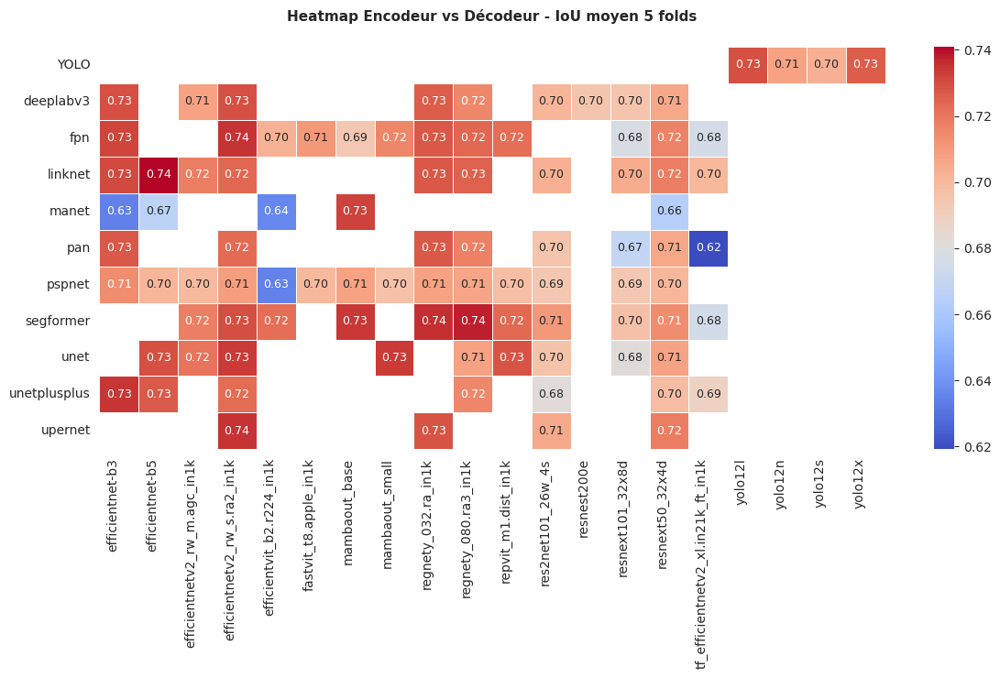

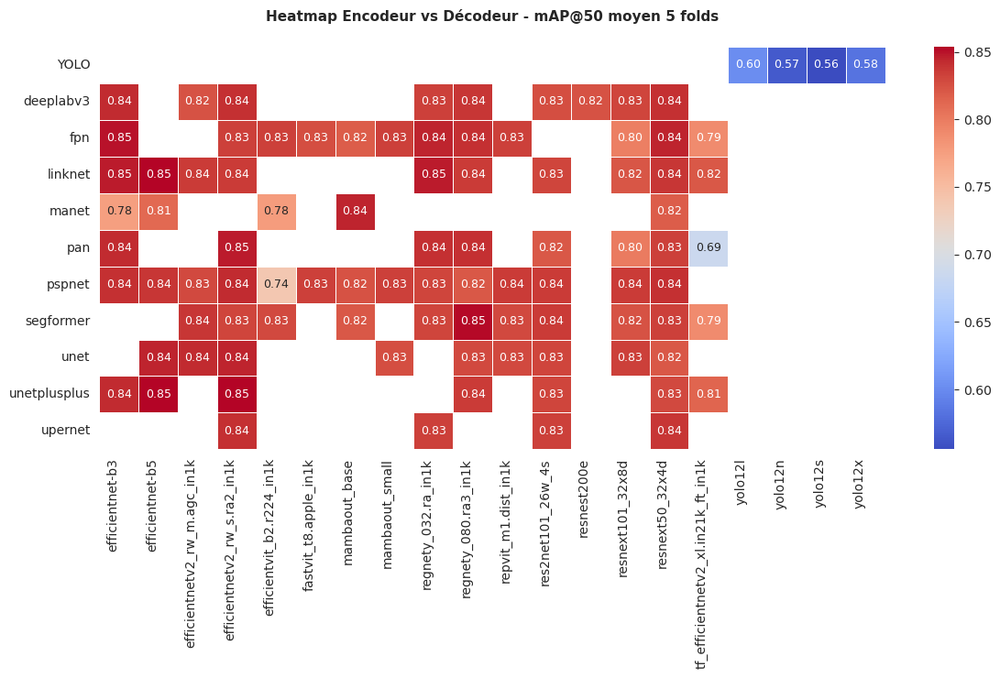

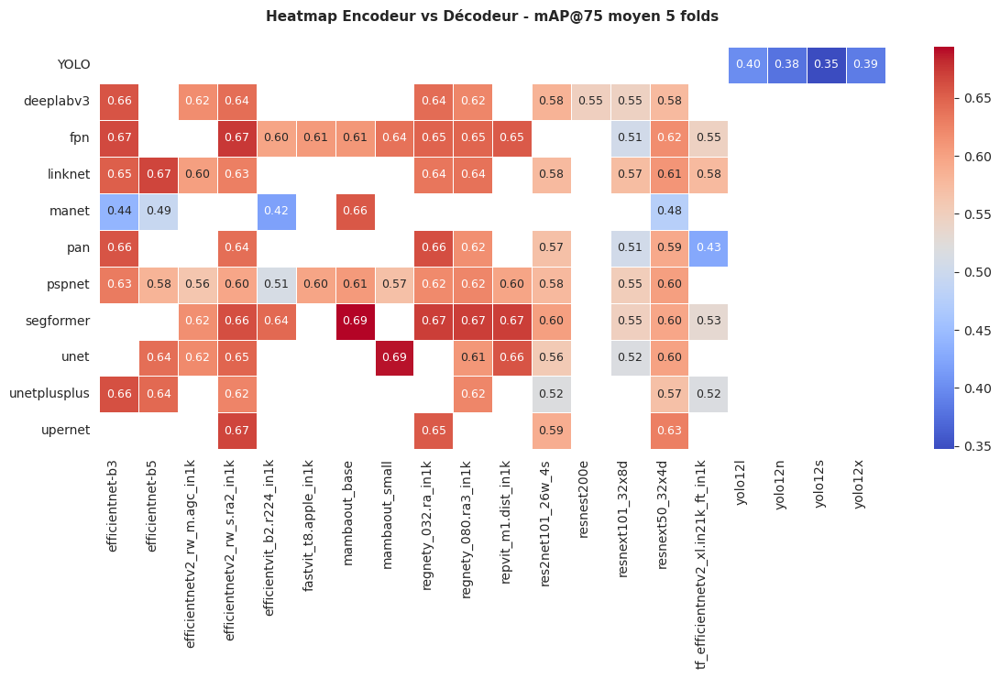

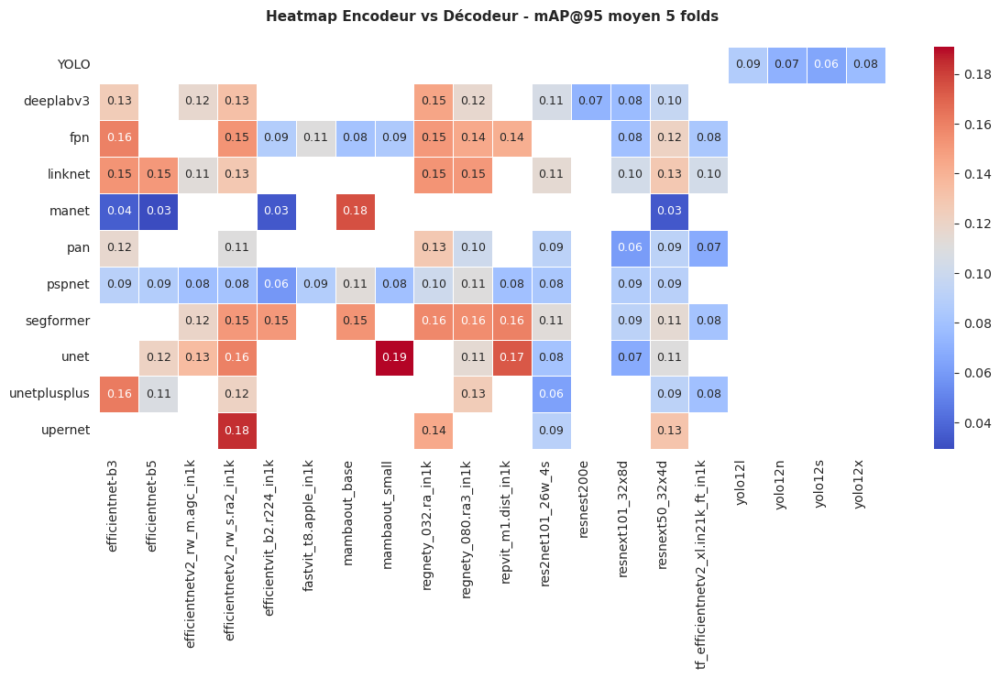

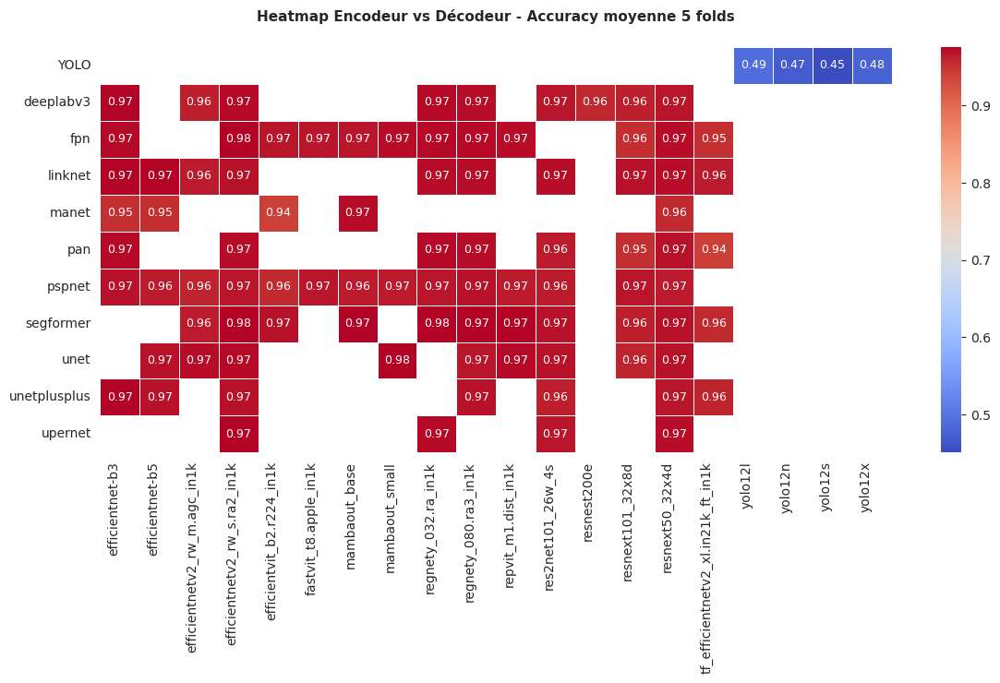

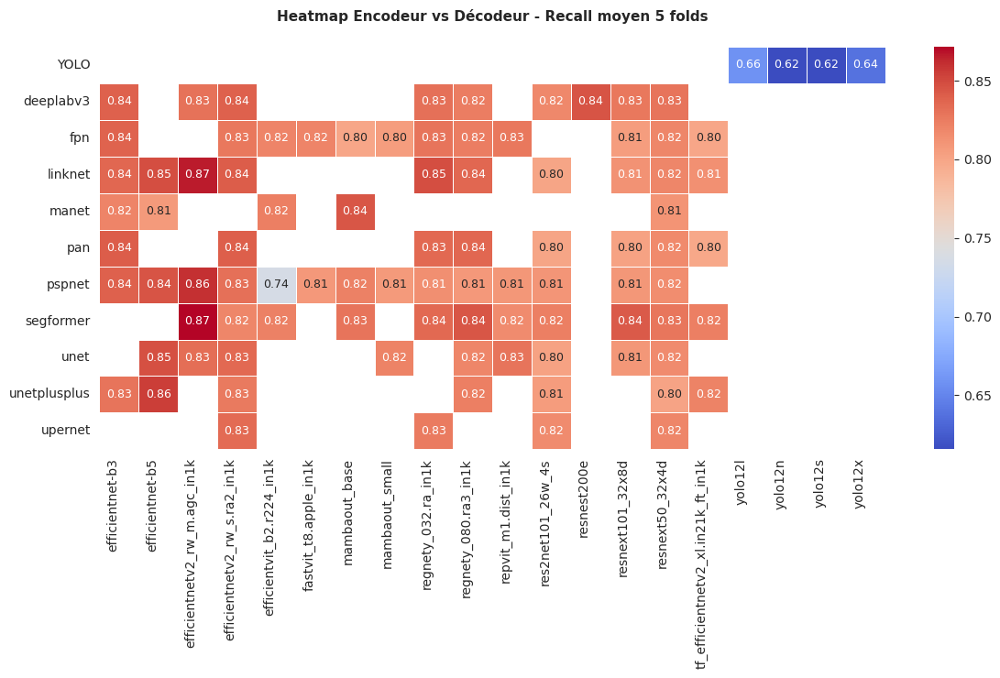

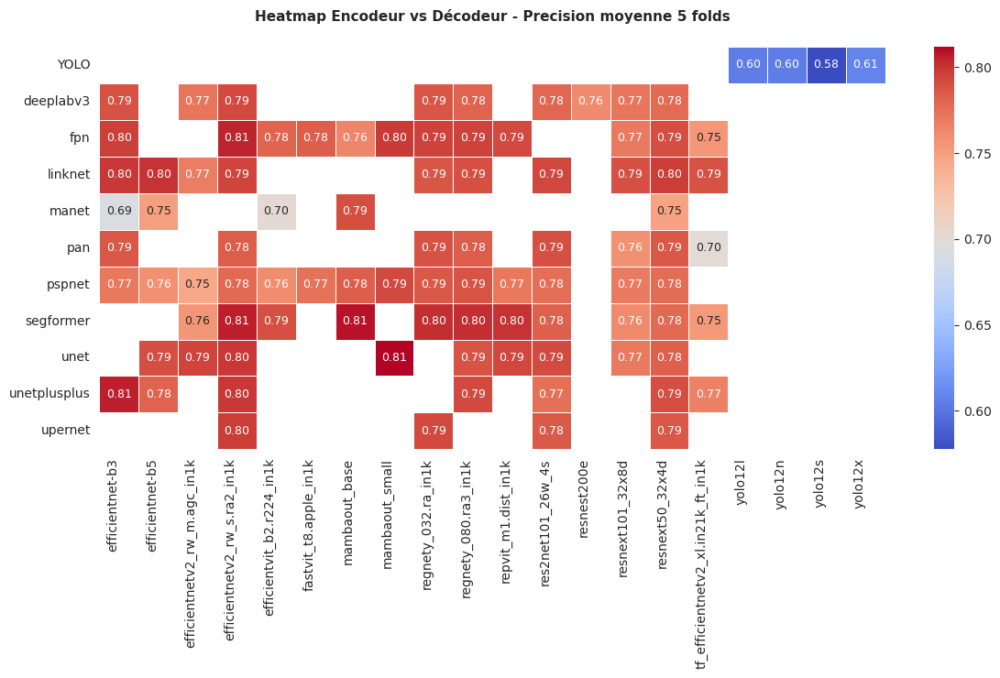

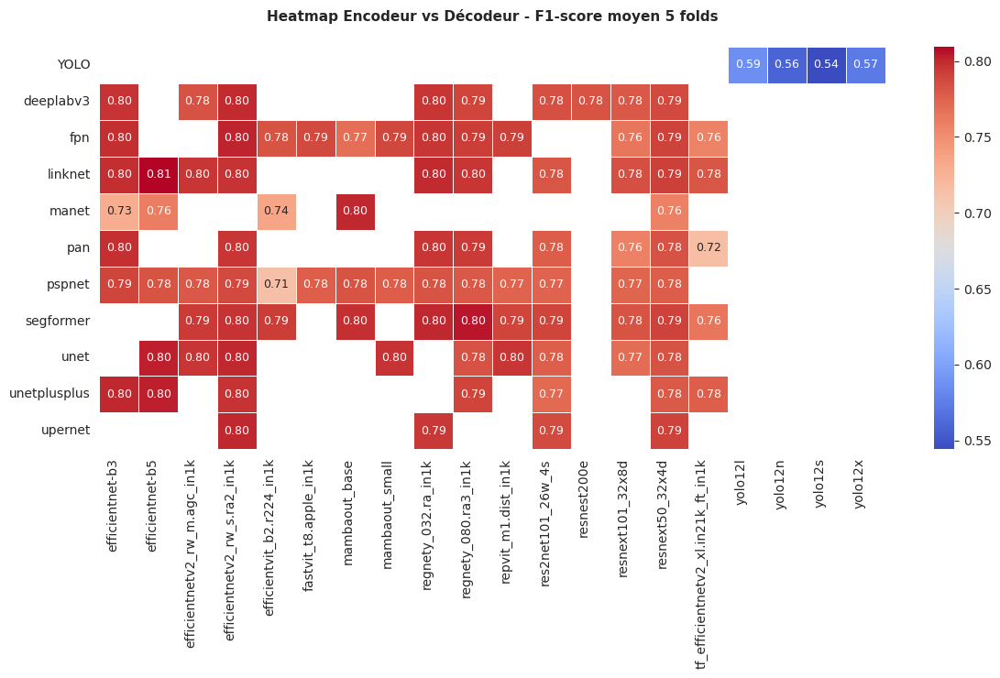

In [ ]:
def plot_architecture_backbone_heatmap(df_models, performance_metric='eval_test_iou_mean', save_path=None):
    """Plot a heatmap showing the mean performance metric for each architecture-backbone combination."""
    # Set seaborn style for better plot appearance
    sns.set_style("white")
    
    # Check if required columns exist
    if 'architecture' not in df_models.columns or 'backbone' not in df_models.columns:
        print("Architecture or backbone columns not found")
        return
    
    # Use whitegrid style for grid background
    sns.set_style("whitegrid")

    fig, ax = plt.subplots(1, 1, figsize=(12, 7.5))
    
    # Create a pivot table with mean performance for each architecture-backbone pair
    heatmap_data = df_models.pivot_table(
        values=performance_metric,
        index='architecture',
        columns='backbone',
        aggfunc='mean'
    )
    
    # Sort architectures and backbones alphabetically
    heatmap_data = heatmap_data.sort_index()
    
    # Remove common prefixes from backbone names for clarity
    clean_columns = []
    for col in heatmap_data.columns:
        clean_name = col
        for prefix in ['timm-', 'tu-', 'tv-']:
            if clean_name.startswith(prefix):
                clean_name = clean_name[len(prefix):]
        clean_columns.append(clean_name)
    
    heatmap_data.columns = clean_columns
    heatmap_data = heatmap_data[sorted(heatmap_data.columns)]
    
    # Mask NaN values in the heatmap
    mask = heatmap_data.isna()
    
    # Set plot title and graphic number based on the performance metric
    if performance_metric == 'eval_test_iou_mean':
        texte_performance = "IoU moyen 5 folds"
        graphic_number = "01"
    elif performance_metric.startswith('eval_test_map_50_mean'):
        texte_performance = "mAP@50 moyen 5 folds"
        graphic_number = "02"
    elif performance_metric.startswith('eval_test_map_75_mean'):
        texte_performance = "mAP@75 moyen 5 folds"
        graphic_number = "03"
    elif performance_metric.startswith('eval_test_map_95_mean'):
        texte_performance = "mAP@95 moyen 5 folds"
        graphic_number = "04"
    elif performance_metric.startswith('eval_test_accuracy_mean'):
        texte_performance = "Accuracy moyenne 5 folds"
        graphic_number = "05"
    elif performance_metric.startswith('eval_test_recall_mean'):
        texte_performance = "Recall moyen 5 folds"
        graphic_number = "06"
    elif performance_metric.startswith('eval_test_precision_mean'):
        texte_performance = "Precision moyenne 5 folds"
        graphic_number = "07"
    elif performance_metric.startswith('eval_test_f1_score_mean'):
        texte_performance = "F1-score moyen 5 folds"
        graphic_number = "08"

    # Plot the heatmap with annotations and colorbar
    sns.heatmap(
        heatmap_data,
        annot=True,
        fmt=".2f",
        cmap='coolwarm',
        linewidth=.5,
        annot_kws={"fontsize": 9},
        mask=mask
    )

    # Set plot title and remove axis labels
    ax.set_title('Heatmap Encodeur vs Décodeur - ' + texte_performance, 
                 fontsize=11, fontweight='bold', pad=20)
    ax.set_xlabel('')
    ax.set_ylabel('')
    
    # Rotate x-axis labels for readability
    ax.set_xticklabels(ax.get_xticklabels(), rotation=90, ha='right', fontsize=10)
    ax.set_yticklabels(ax.get_yticklabels(), rotation=0, fontsize=10)
    
    # Remove gridlines for a cleaner look
    ax.grid(False)
   
    # Hide plot spines for a minimalistic appearance
    for spine in ax.spines.values():
        spine.set_visible(False)
    
    plt.tight_layout()
    # Save the figure if a path is provided
    if save_path:
        plt.savefig(
            f"{save_path}/ch4_01_architecture_backbone_heatmap_{graphic_number}_{performance_metric}.png", 
            dpi=300, bbox_inches='tight'
        )
    plt.show()
    plt.close()

plot_architecture_backbone_heatmap(df_model_results_clean_concat_yolo_smp, performance_metric='eval_test_iou_mean', save_path=GRAPHICS_PATH)
plot_architecture_backbone_heatmap(df_model_results_clean_concat_yolo_smp, performance_metric='eval_test_map_50_mean', save_path=GRAPHICS_PATH)
plot_architecture_backbone_heatmap(df_model_results_clean_concat_yolo_smp, performance_metric='eval_test_map_75_mean', save_path=GRAPHICS_PATH)
plot_architecture_backbone_heatmap(df_model_results_clean_concat_yolo_smp, performance_metric='eval_test_map_95_mean', save_path=GRAPHICS_PATH)
plot_architecture_backbone_heatmap(df_model_results_clean_concat_yolo_smp, performance_metric='eval_test_accuracy_mean', save_path=GRAPHICS_PATH)
plot_architecture_backbone_heatmap(df_model_results_clean_concat_yolo_smp, performance_metric='eval_test_recall_mean', save_path=GRAPHICS_PATH)
plot_architecture_backbone_heatmap(df_model_results_clean_concat_yolo_smp, performance_metric='eval_test_precision_mean', save_path=GRAPHICS_PATH)
plot_architecture_backbone_heatmap(df_model_results_clean_concat_yolo_smp, performance_metric='eval_test_f1_score_mean', save_path=GRAPHICS_PATH)


### Top 10 modèles

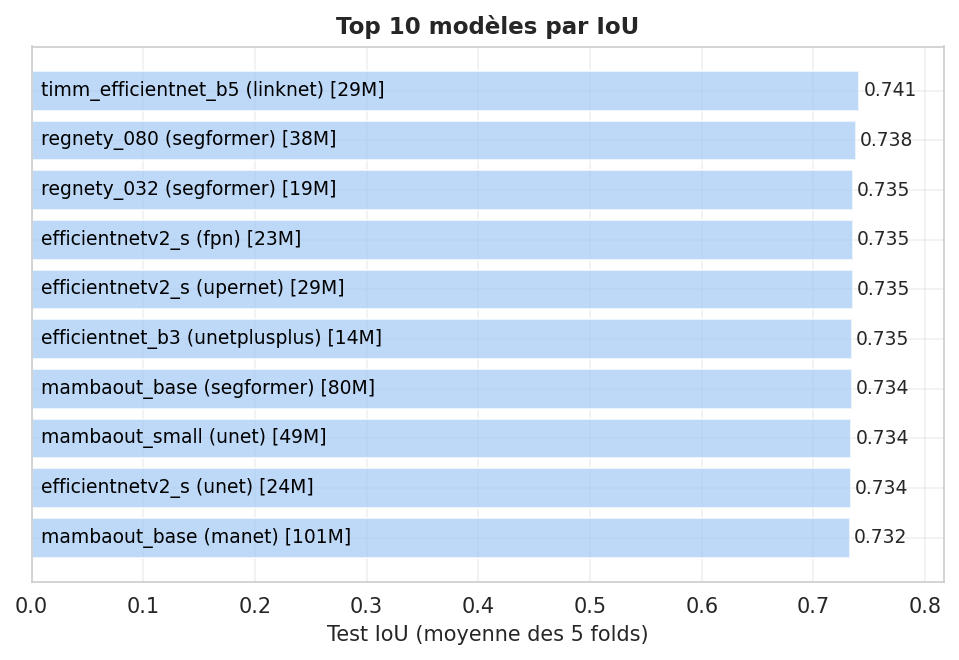

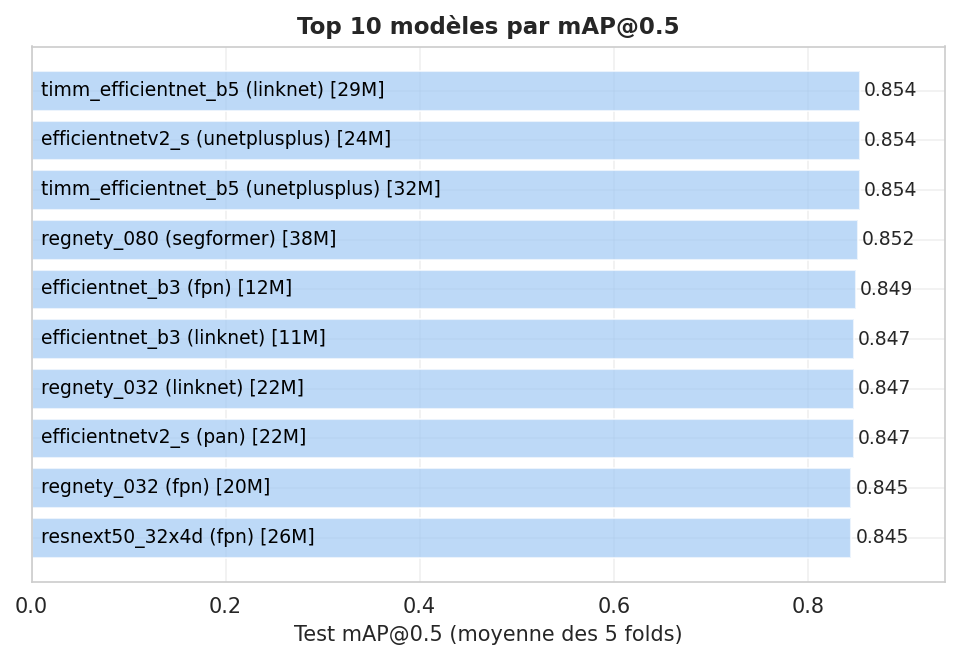

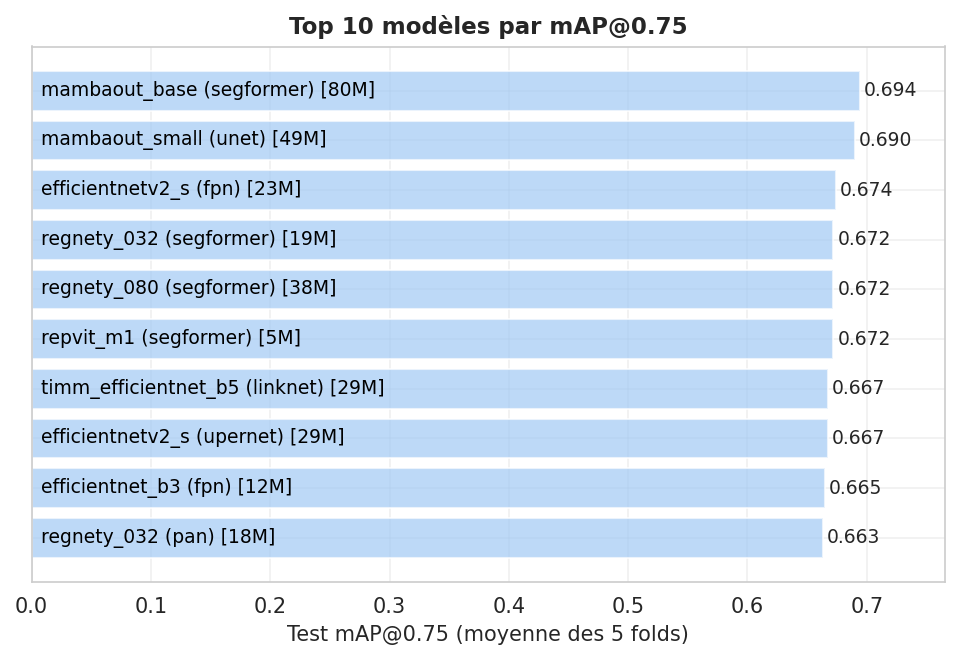

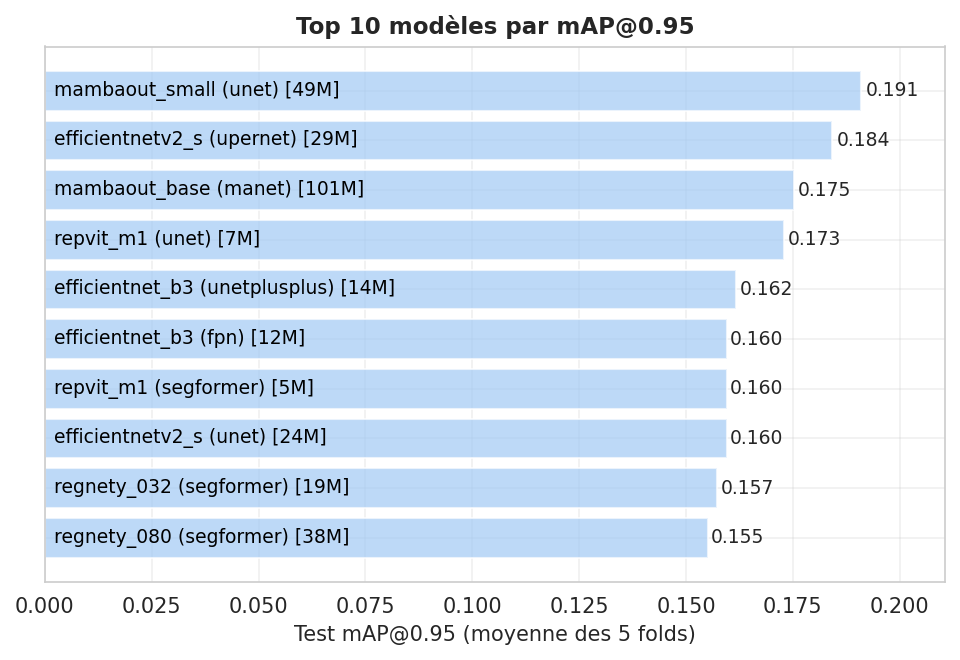

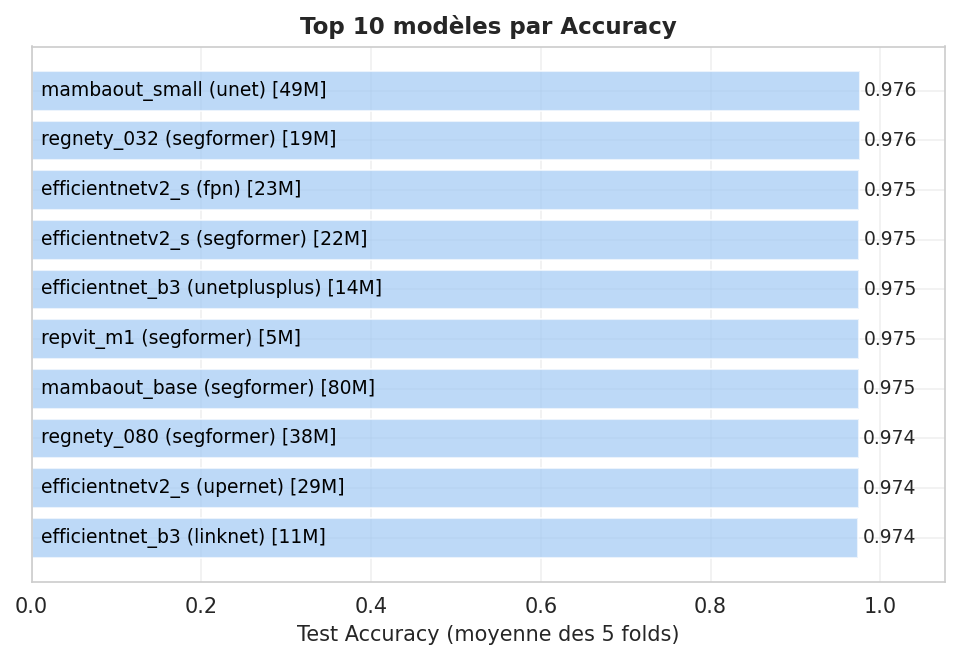

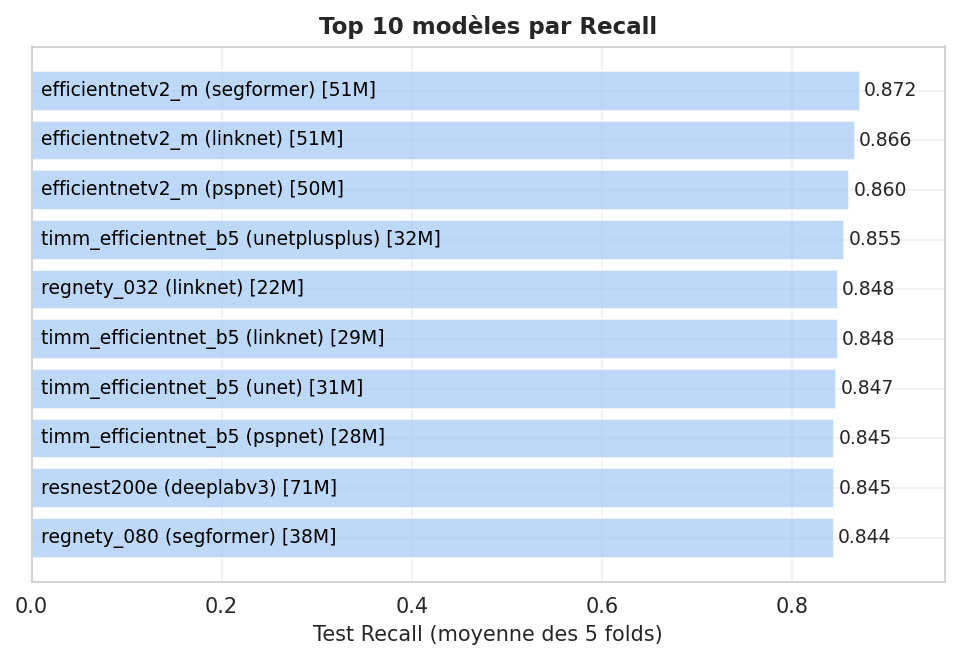

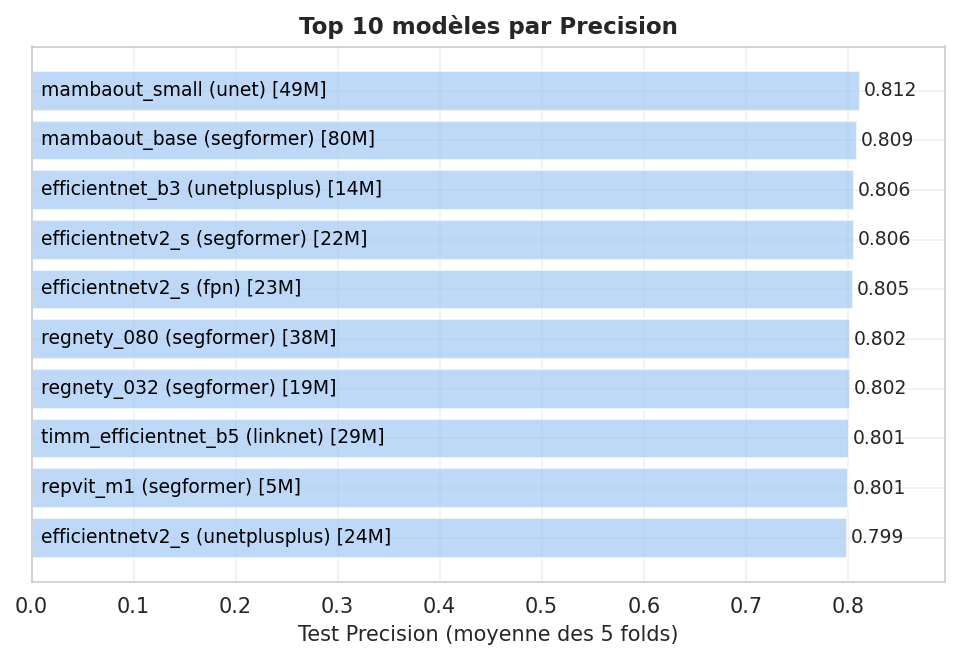

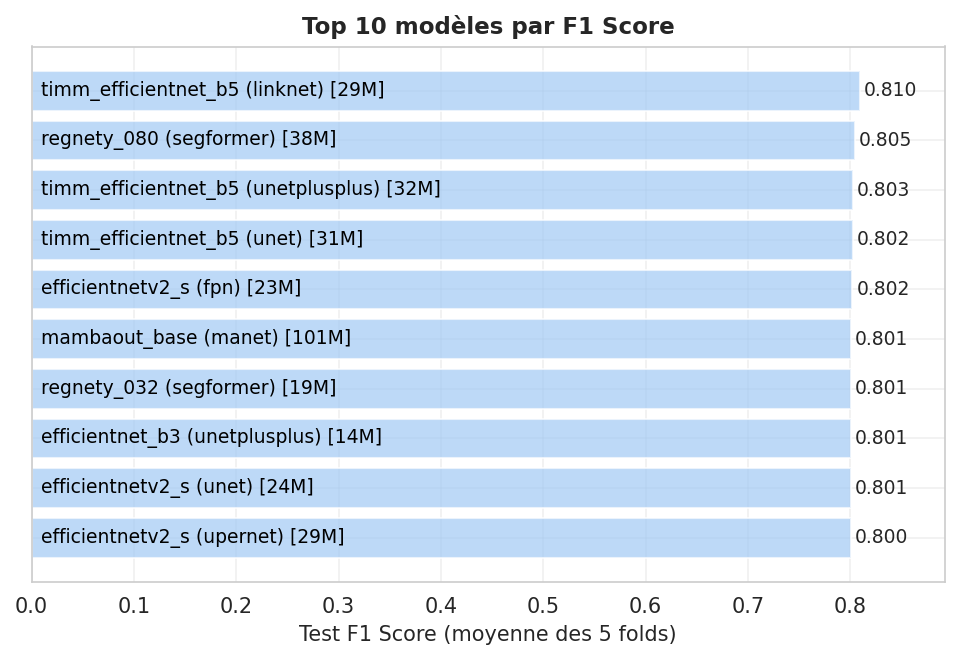

In [ ]:
def plot_top_models_performance(df_models, performance_metric='eval_test_iou_mean', save_path=None):
    """Plot the top 10 models by a given performance metric.

    Args:
        df_models (pd.DataFrame): DataFrame containing model results.
        performance_metric (str): Column name for the metric to rank models.
        save_path (str, optional): Directory to save the plot. If None, the plot is not saved.
    """
    set_plot_style()
    fig, ax = plt.subplots(1, 1, figsize=(6.5, 4.5))

    if performance_metric in df_models.columns:
        # Select the top 10 models based on the chosen metric
        top_models = df_models.nlargest(10, performance_metric).copy()

        if not top_models.empty:
            # Reverse order so the best model appears at the top
            y_pos = range(len(top_models) - 1, -1, -1)
            bars = ax.barh(y_pos, top_models[performance_metric], alpha=0.7)

            # Add value labels to the end of each bar
            for i, (bar, perf_val) in enumerate(zip(bars, top_models[performance_metric])):
                ax.text(bar.get_width()*1.005, bar.get_y() + bar.get_height()/2, 
                        f'{perf_val:.3f}', ha='left', va='center', fontsize=9)

            # Adjust x-axis limits for better label spacing
            ax.set_xlim(left=0, right=ax.get_xlim()[1]*1.05)

            # Build model labels with config, backbone, and parameter info
            model_labels = []
            for _, row in top_models.iterrows():
                label_parts = []

                # Add config name if available
                if 'config_' in row and pd.notna(row['config_']):
                    config_name = str(row['config_'])
                    if '_' in config_name:
                        config_name = '_'.join(config_name.split('_')[1:])
                    config_name = config_name.replace('_imagenet', '')
                    label_parts.append(config_name)

                # Add backbone architecture if available
                if 'architecture' in row and pd.notna(row['architecture']):
                    label_parts.append(f"({row['architecture']})")

                # Add number of parameters if available
                if 'num_params_M' in row and pd.notna(row['num_params_M']):
                    label_parts.append(f"[{row['num_params_M']:.0f}M]")

                # Use index if no other label is available
                if not label_parts:
                    label_parts.append(f"Model {row.name}")

                model_labels.append(" ".join(label_parts))

            # Place custom labels inside the bars for clarity
            ax.set_yticks(y_pos)
            for i, (bar, label) in enumerate(zip(bars, model_labels)):
                ax.text(ax.get_xlim()[1]*0.01, bar.get_y() + bar.get_height()/2, 
                        label, ha='left', va='center', fontsize=9, color='black', zorder=10)

            # Remove default y-axis labels to avoid overlap
            ax.set_yticklabels([])
            ax.tick_params(axis='y', pad=-5)

            # Set axis labels and titles based on the metric
            if performance_metric == 'eval_test_iou_mean':
                ax.set_xlabel('Test IoU (mean of 5 folds)', fontsize=10)
                ax.set_title('Top 10 Models by IoU', fontsize=11, fontweight='bold')
                graphic_number = "01"
            if performance_metric == 'eval_test_map_50_mean':
                ax.set_xlabel('Test mAP@0.5 (mean of 5 folds)', fontsize=10)
                ax.set_title('Top 10 Models by mAP@0.5', fontsize=11, fontweight='bold')
                graphic_number = "02"
            if performance_metric == 'eval_test_map_75_mean':
                ax.set_xlabel('Test mAP@0.75 (mean of 5 folds)', fontsize=10)
                ax.set_title('Top 10 Models by mAP@0.75', fontsize=11, fontweight='bold')
                graphic_number = "03"
            if performance_metric == 'eval_test_map_95_mean':
                ax.set_xlabel('Test mAP@0.95 (mean of 5 folds)', fontsize=10)
                ax.set_title('Top 10 Models by mAP@0.95', fontsize=11, fontweight='bold')
                graphic_number = "04"
            if performance_metric == 'eval_test_accuracy_mean':
                ax.set_xlabel('Test Accuracy (mean of 5 folds)', fontsize=10)
                ax.set_title('Top 10 Models by Accuracy', fontsize=11, fontweight='bold')
                graphic_number = "05"
            if performance_metric == 'eval_test_recall_mean':
                ax.set_xlabel('Test Recall (mean of 5 folds)', fontsize=10)
                ax.set_title('Top 10 Models by Recall', fontsize=11, fontweight='bold')
                graphic_number = "06"
            if performance_metric == 'eval_test_precision_mean':
                ax.set_xlabel('Test Precision (mean of 5 folds)', fontsize=10)
                ax.set_title('Top 10 Models by Precision', fontsize=11, fontweight='bold')
                graphic_number = "07"
            if performance_metric == 'eval_test_f1_score_mean':
                ax.set_xlabel('Test F1 Score (mean of 5 folds)', fontsize=10)
                ax.set_title('Top 10 Models by F1 Score', fontsize=11, fontweight='bold')
                graphic_number = "08"
            ax.grid(True, alpha=0.3)

    plt.tight_layout()
    if save_path:
        plt.savefig(f"{save_path}/ch4_02_top_models_performance_{graphic_number}_{performance_metric}.png", dpi=300, bbox_inches='tight')
    plt.show()

plot_top_models_performance(df_model_results_clean_concat_yolo_smp, performance_metric='eval_test_iou_mean', save_path=GRAPHICS_PATH)
plot_top_models_performance(df_model_results_clean_concat_yolo_smp, performance_metric='eval_test_map_50_mean', save_path=GRAPHICS_PATH)
plot_top_models_performance(df_model_results_clean_concat_yolo_smp, performance_metric='eval_test_map_75_mean', save_path=GRAPHICS_PATH)
plot_top_models_performance(df_model_results_clean_concat_yolo_smp, performance_metric='eval_test_map_95_mean', save_path=GRAPHICS_PATH)
plot_top_models_performance(df_model_results_clean_concat_yolo_smp, performance_metric='eval_test_accuracy_mean', save_path=GRAPHICS_PATH)
plot_top_models_performance(df_model_results_clean_concat_yolo_smp, performance_metric='eval_test_recall_mean', save_path=GRAPHICS_PATH)
plot_top_models_performance(df_model_results_clean_concat_yolo_smp, performance_metric='eval_test_precision_mean', save_path=GRAPHICS_PATH)
plot_top_models_performance(df_model_results_clean_concat_yolo_smp, performance_metric='eval_test_f1_score_mean', save_path=GRAPHICS_PATH)


### Top 10 décodeurs

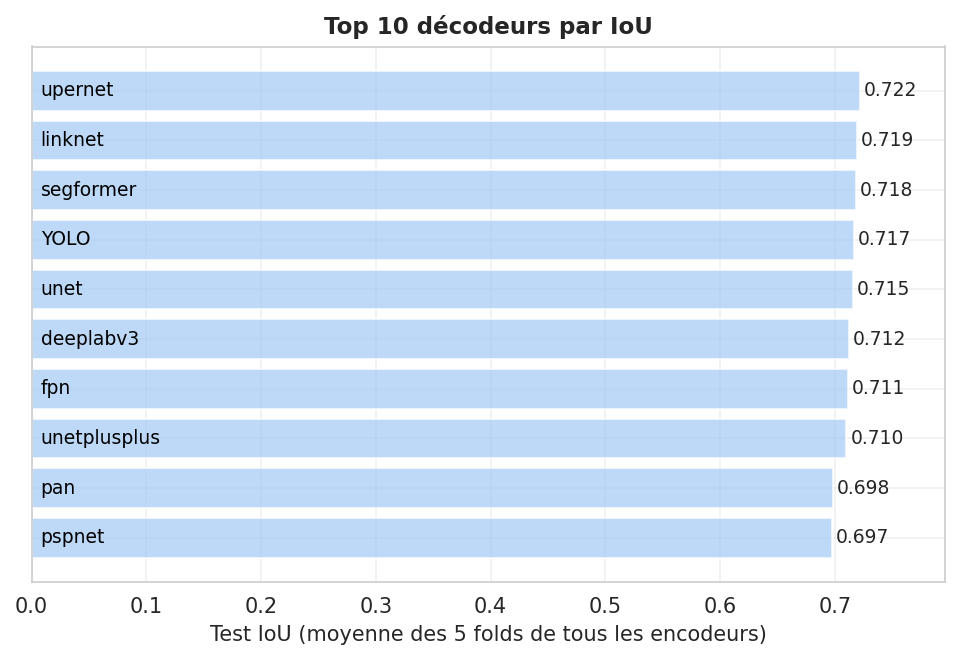

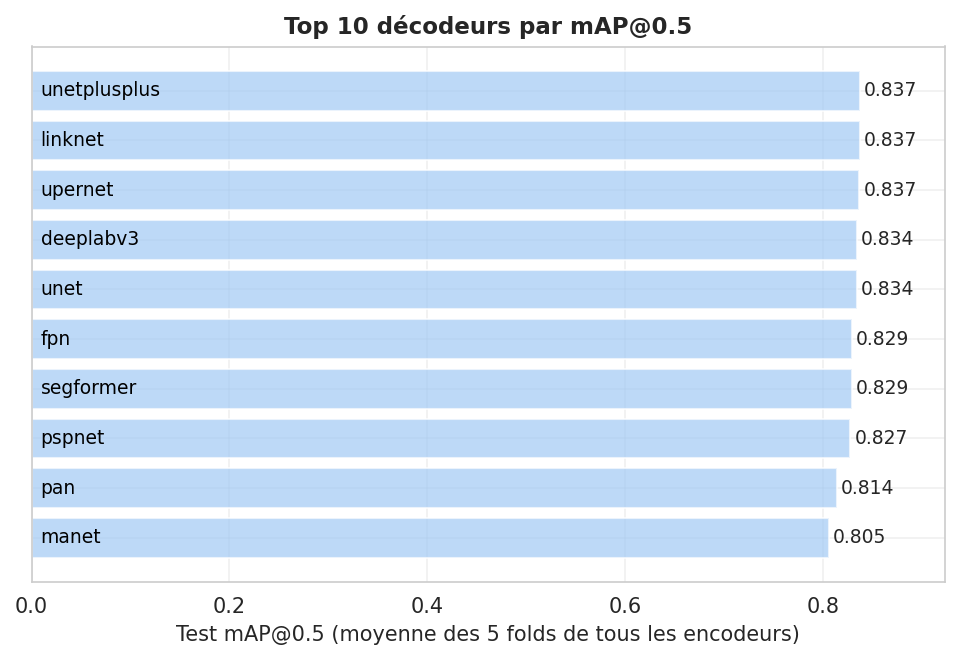

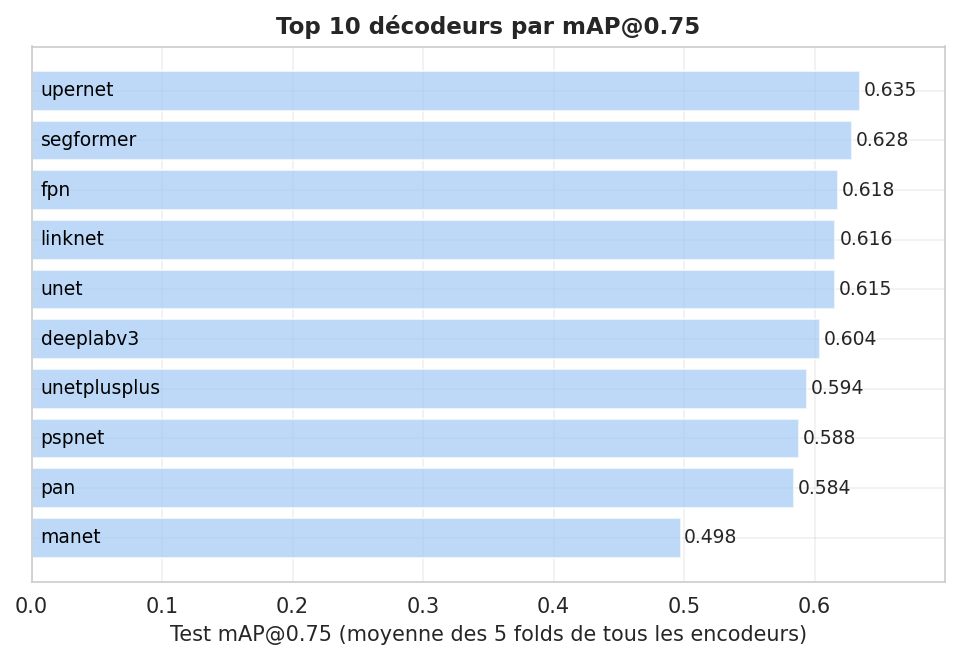

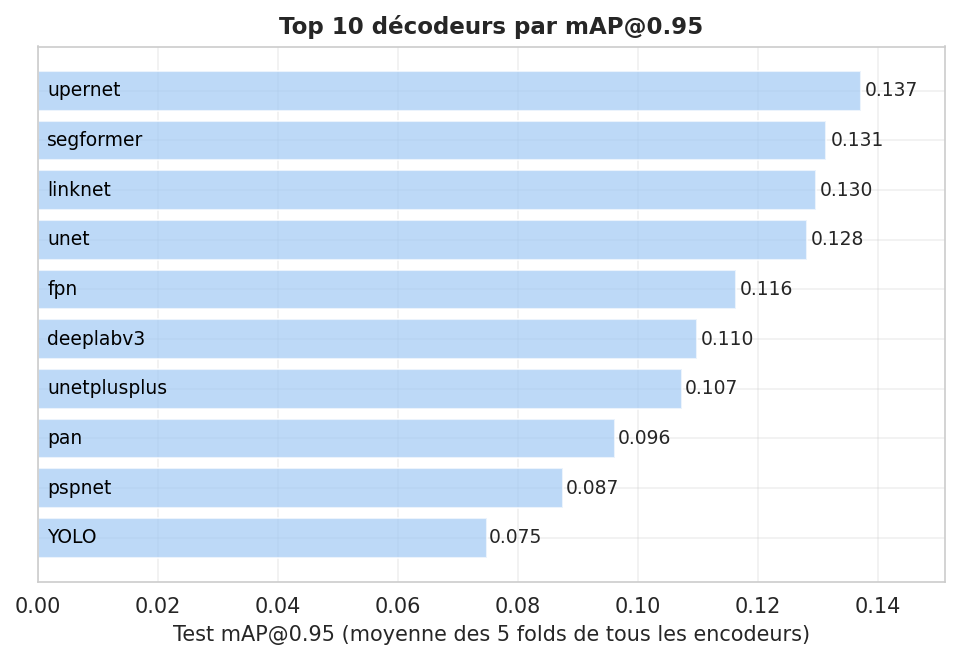

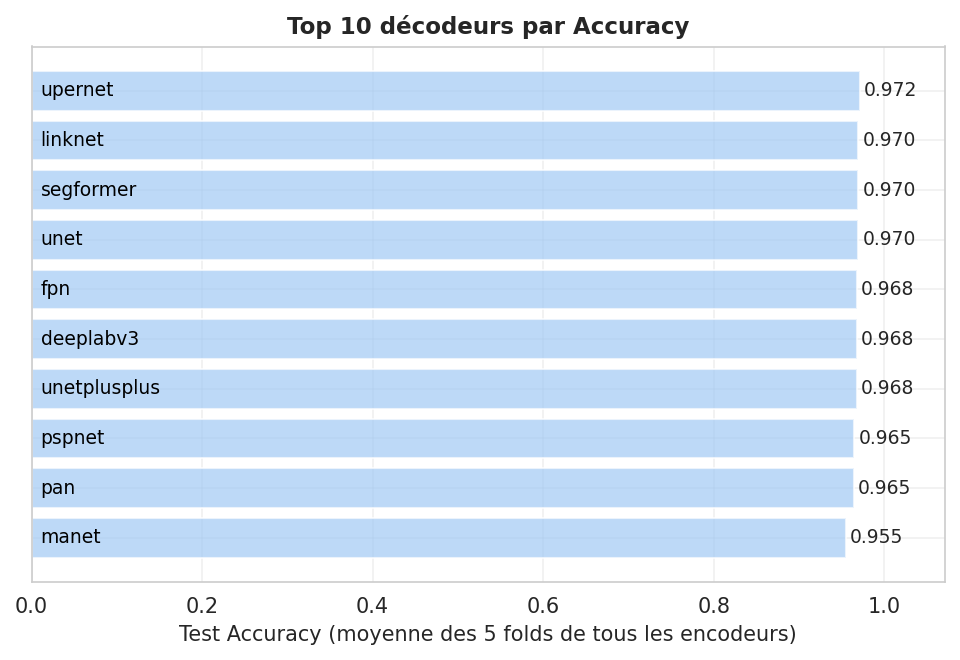

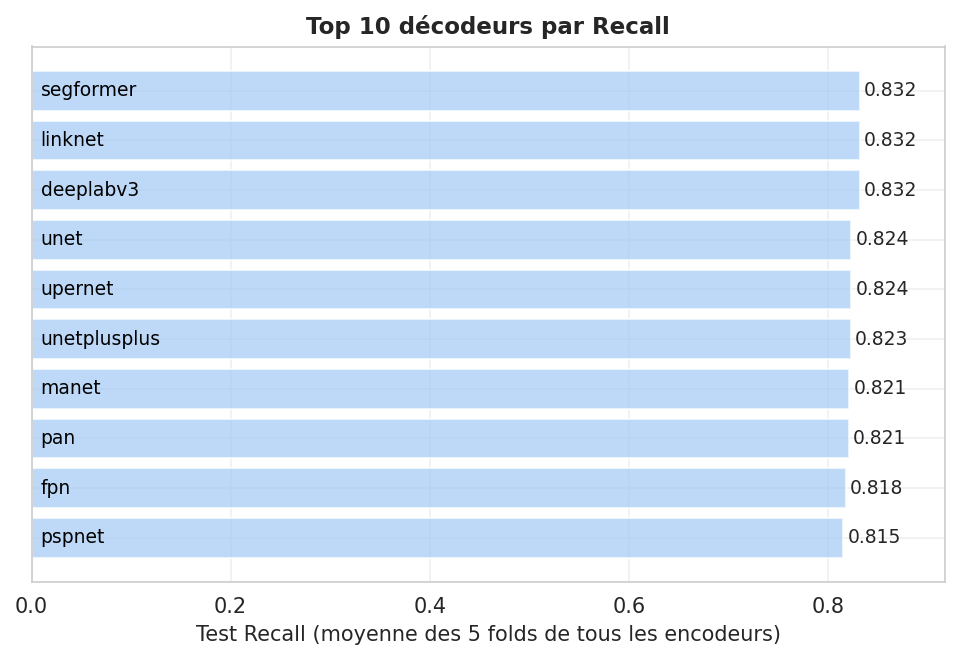

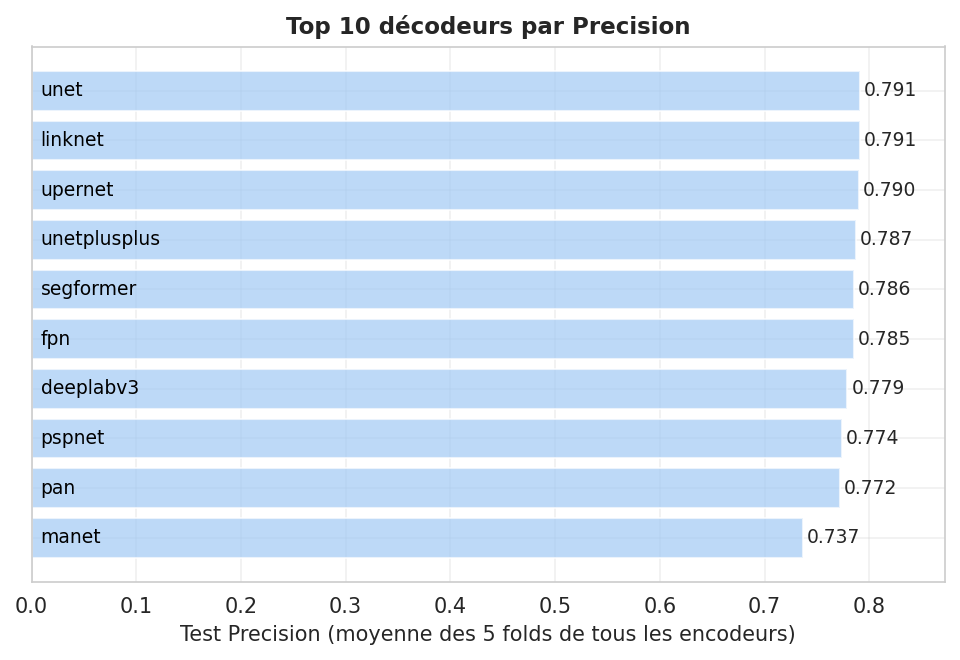

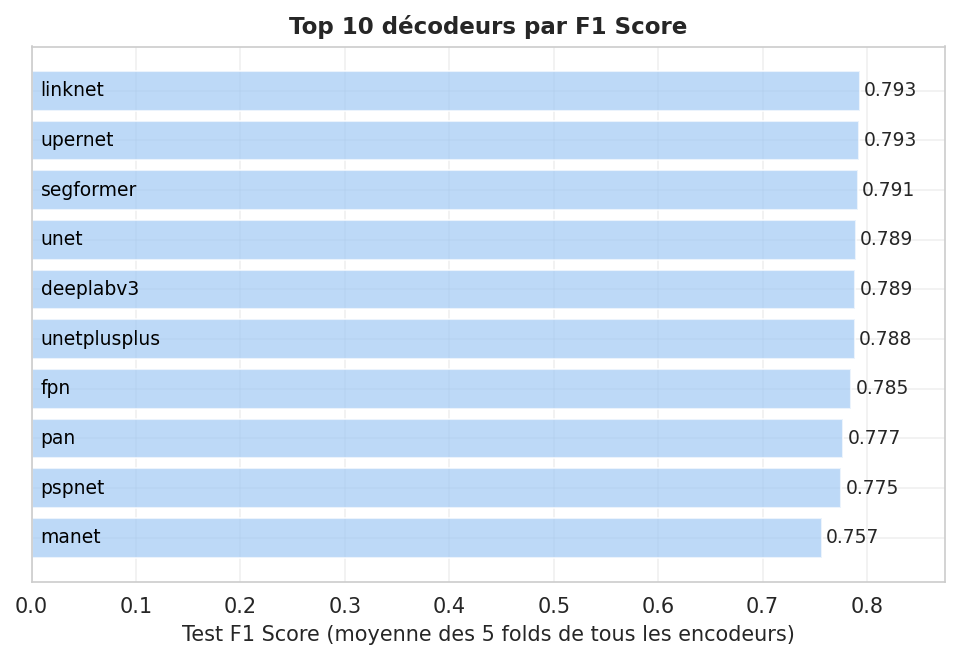

In [ ]:
def plot_architecture_performance(df_models, performance_metric='eval_test_iou_mean', save_path=None):
    """Plot the mean performance of the top 10 architectures for a given metric.

    Args:
        df_models (pd.DataFrame): DataFrame containing model results.
        performance_metric (str): Column name for the metric to display.
        save_path (str, optional): Directory to save the plot. If None, the plot is not saved.
    """
    set_plot_style()
    
    if 'architecture' not in df_models.columns:
        print("Architecture column not found")
        return
    
    fig, ax = plt.subplots(1, 1, figsize=(6.5, 4.5))
    
    # Compute mean and count for each architecture
    architecture_performance = df_models.groupby('architecture')[performance_metric].agg(['mean', 'count']).reset_index()
    architecture_performance = architecture_performance[architecture_performance['count'] >= 1]
    architecture_performance = architecture_performance.sort_values('mean', ascending=False).head(10)
    
    if not architecture_performance.empty:
        y_pos = range(len(architecture_performance) - 1, -1, -1)
        bars = ax.barh(y_pos, architecture_performance['mean'], alpha=0.7)
        
        # Add value labels at the end of each bar
        for bar, mean_val in zip(bars, architecture_performance['mean']):
            ax.text(bar.get_width()*1.005, bar.get_y() + bar.get_height()/2, 
                    f'{mean_val:.3f}', ha='left', va='center', fontsize=9)
        
        ax.set_xlim(left=0, right=ax.get_xlim()[1]*1.05)
        ax.set_yticks(y_pos)
        
        # Add architecture names inside the bars
        architecture_names = list(architecture_performance['architecture'])
        for bar, name in zip(bars, architecture_names):
            ax.text(ax.get_xlim()[1]*0.01, bar.get_y() + bar.get_height()/2, 
                    name, ha='left', va='center', fontsize=9, color='black', zorder=10)
        
        ax.set_yticklabels([])
        ax.tick_params(axis='y', pad=-5)
        
        # Set axis labels and titles based on the metric
        if performance_metric == 'eval_test_iou_mean':
            ax.set_xlabel('Test IoU (mean of 5 folds for all encoders)', fontsize=10)
            ax.set_title('Top 10 Decoders by IoU', fontsize=11, fontweight='bold')
            graphic_number = "01"
        elif performance_metric == 'eval_test_map_50_mean':
            ax.set_xlabel('Test mAP@0.5 (mean of 5 folds for all encoders)', fontsize=10)
            ax.set_title('Top 10 Decoders by mAP@0.5', fontsize=11, fontweight='bold')
            graphic_number = "02"
        elif performance_metric == 'eval_test_map_75_mean':
            ax.set_xlabel('Test mAP@0.75 (mean of 5 folds for all encoders)', fontsize=10)
            ax.set_title('Top 10 Decoders by mAP@0.75', fontsize=11, fontweight='bold')
            graphic_number = "03"
        elif performance_metric == 'eval_test_map_95_mean':
            ax.set_xlabel('Test mAP@0.95 (mean of 5 folds for all encoders)', fontsize=10)
            ax.set_title('Top 10 Decoders by mAP@0.95', fontsize=11, fontweight='bold')
            graphic_number = "04"
        elif performance_metric == 'eval_test_accuracy_mean':
            ax.set_xlabel('Test Accuracy (mean of 5 folds for all encoders)', fontsize=10)
            ax.set_title('Top 10 Decoders by Accuracy', fontsize=11, fontweight='bold')
            graphic_number = "05"
        elif performance_metric == 'eval_test_recall_mean':
            ax.set_xlabel('Test Recall (mean of 5 folds for all encoders)', fontsize=10)
            ax.set_title('Top 10 Decoders by Recall', fontsize=11, fontweight='bold')
            graphic_number = "06"
        elif performance_metric == 'eval_test_precision_mean':
            ax.set_xlabel('Test Precision (mean of 5 folds for all encoders)', fontsize=10)
            ax.set_title('Top 10 Decoders by Precision', fontsize=11, fontweight='bold')
            graphic_number = "07"
        elif performance_metric == 'eval_test_f1_score_mean':
            ax.set_xlabel('Test F1 Score (mean of 5 folds for all encoders)', fontsize=10)
            ax.set_title('Top 10 Decoders by F1 Score', fontsize=11, fontweight='bold')
            graphic_number = "08"
        ax.grid(True, alpha=0.3)
    
    plt.tight_layout()
    if save_path:
        plt.savefig(f"{save_path}/ch4_03_plot_architecture_performance_{graphic_number}_{performance_metric}.png", dpi=300, bbox_inches='tight')
    plt.show()

plot_architecture_performance(df_model_results_clean_concat_yolo_smp, performance_metric='eval_test_iou_mean', save_path=GRAPHICS_PATH)
plot_architecture_performance(df_model_results_clean_concat_yolo_smp, performance_metric='eval_test_map_50_mean', save_path=GRAPHICS_PATH)
plot_architecture_performance(df_model_results_clean_concat_yolo_smp, performance_metric='eval_test_map_75_mean', save_path=GRAPHICS_PATH)
plot_architecture_performance(df_model_results_clean_concat_yolo_smp, performance_metric='eval_test_map_95_mean', save_path=GRAPHICS_PATH)
plot_architecture_performance(df_model_results_clean_concat_yolo_smp, performance_metric='eval_test_accuracy_mean', save_path=GRAPHICS_PATH)
plot_architecture_performance(df_model_results_clean_concat_yolo_smp, performance_metric='eval_test_recall_mean', save_path=GRAPHICS_PATH)
plot_architecture_performance(df_model_results_clean_concat_yolo_smp, performance_metric='eval_test_precision_mean', save_path=GRAPHICS_PATH)
plot_architecture_performance(df_model_results_clean_concat_yolo_smp, performance_metric='eval_test_f1_score_mean', save_path=GRAPHICS_PATH)

### Top 10 encodeurs

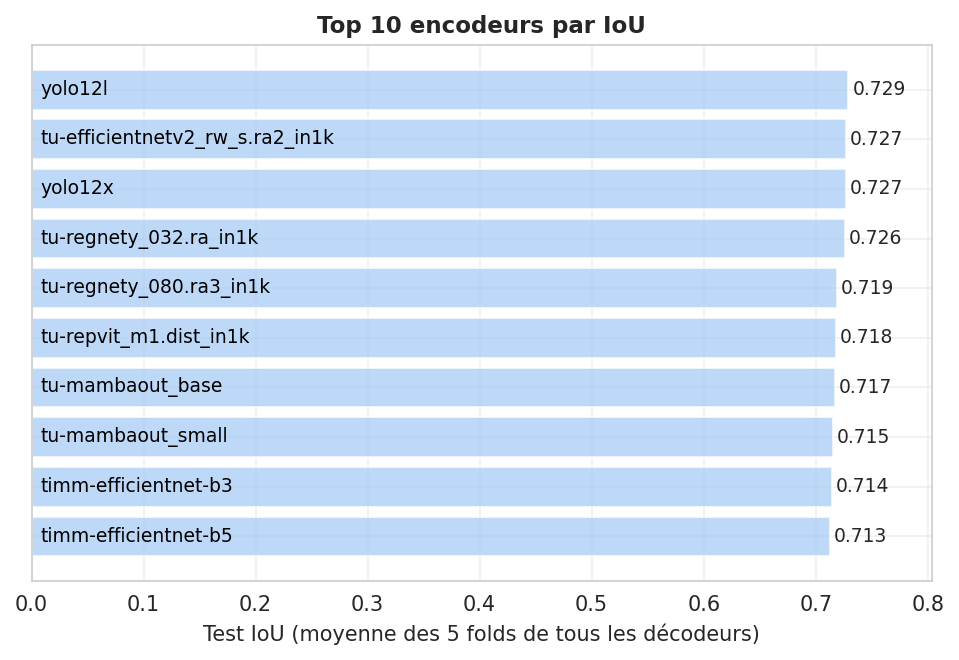

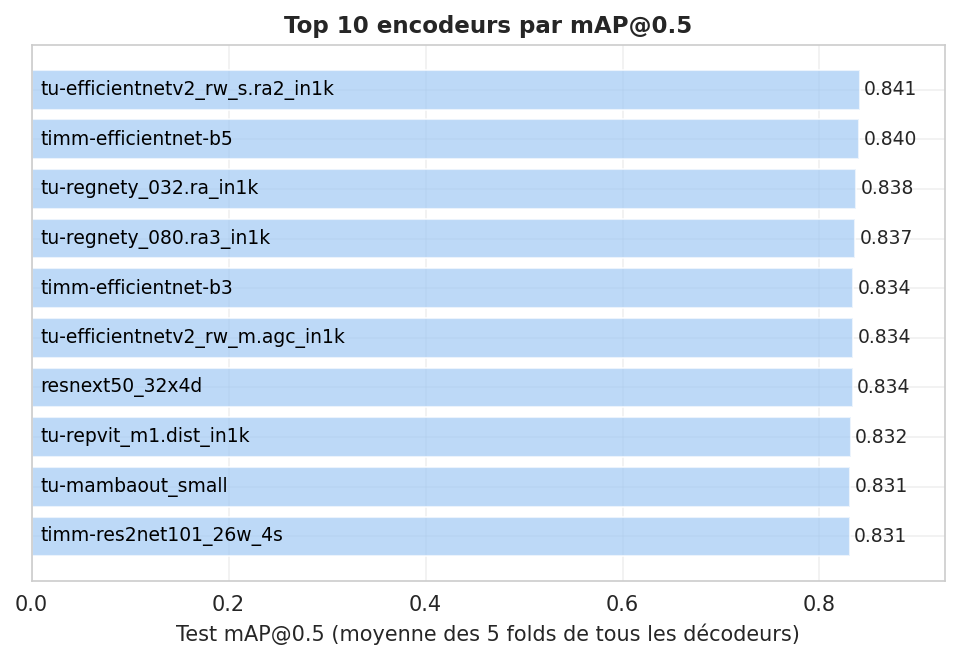

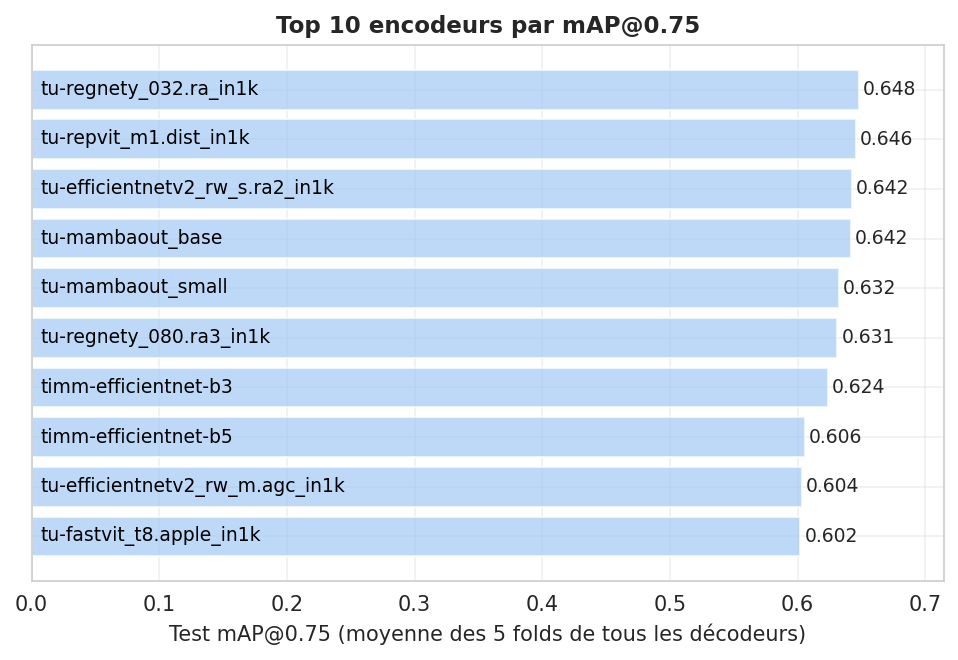

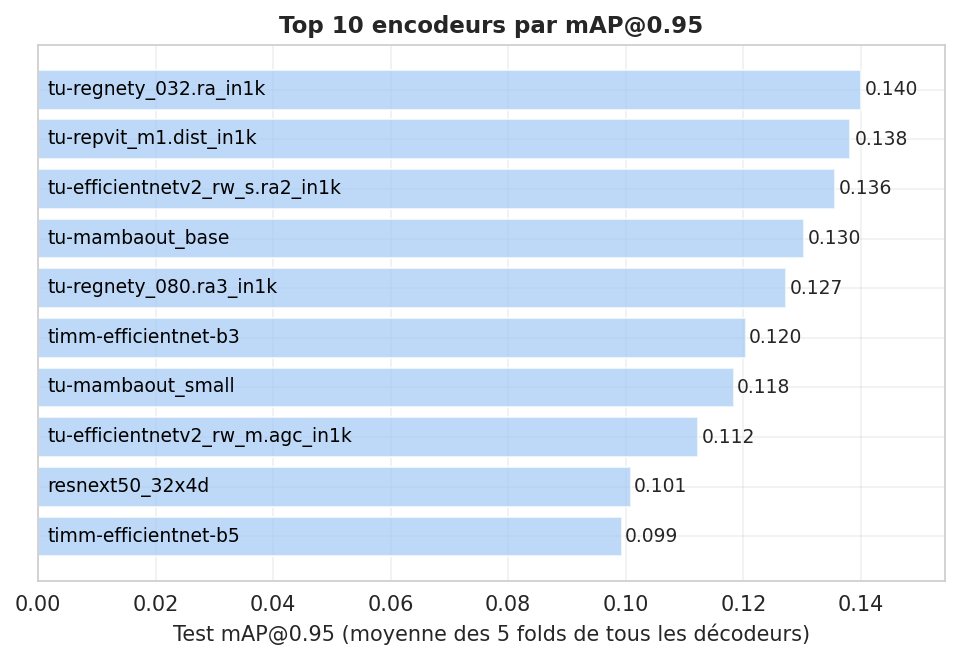

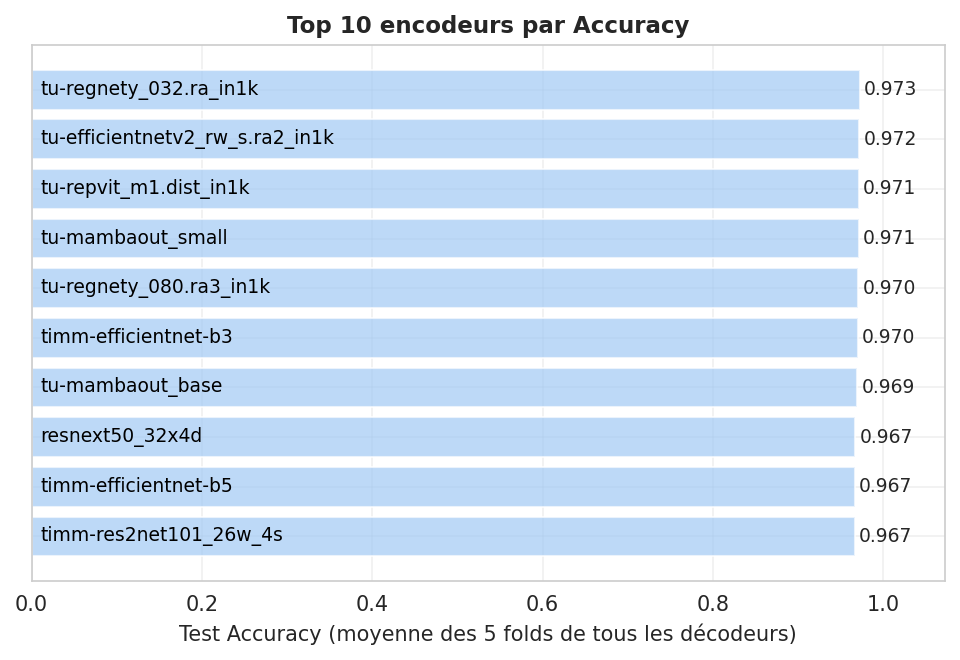

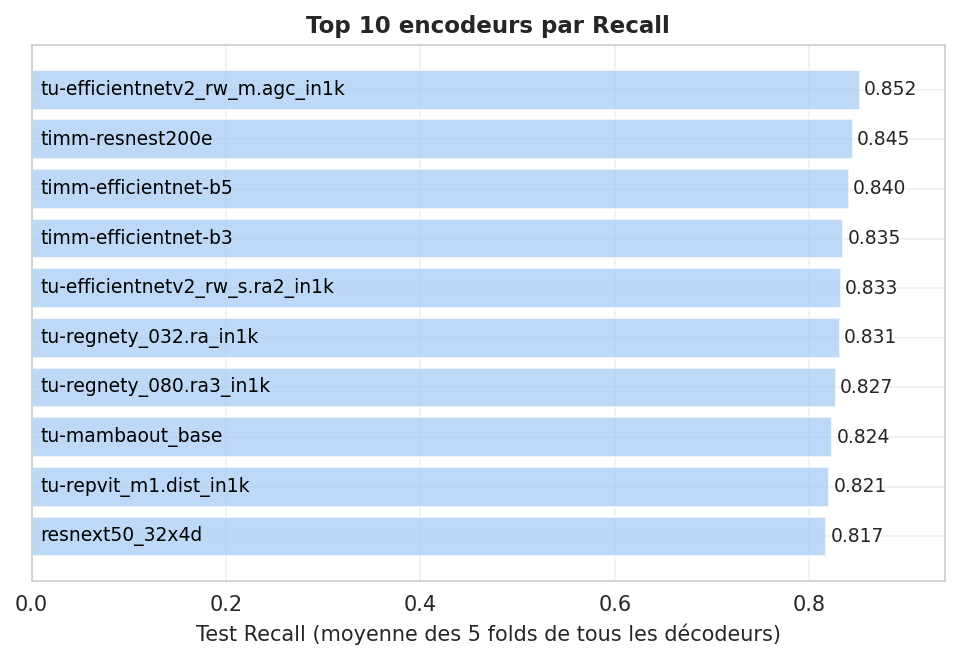

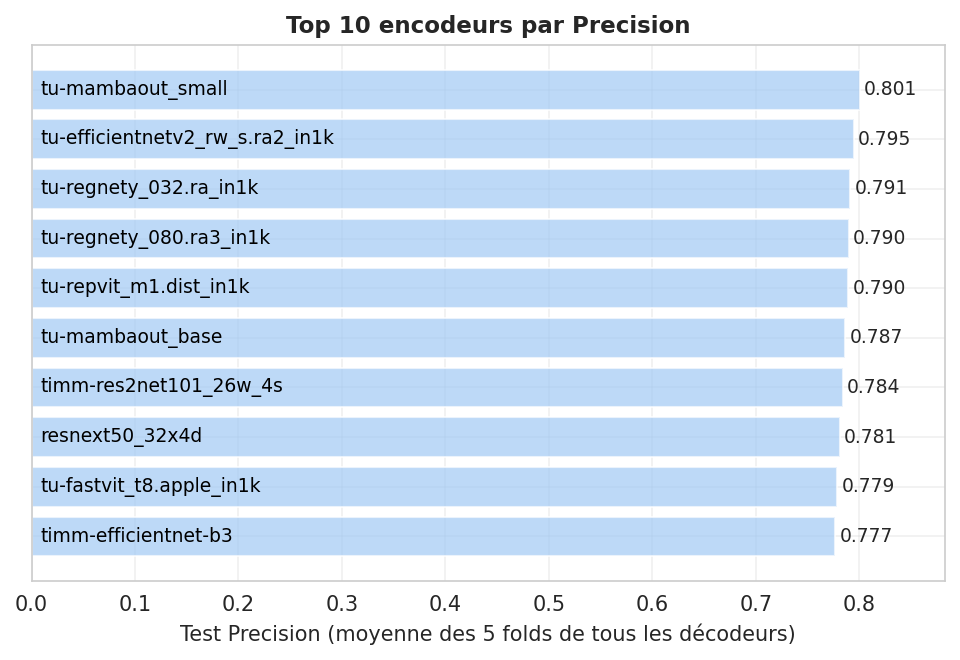

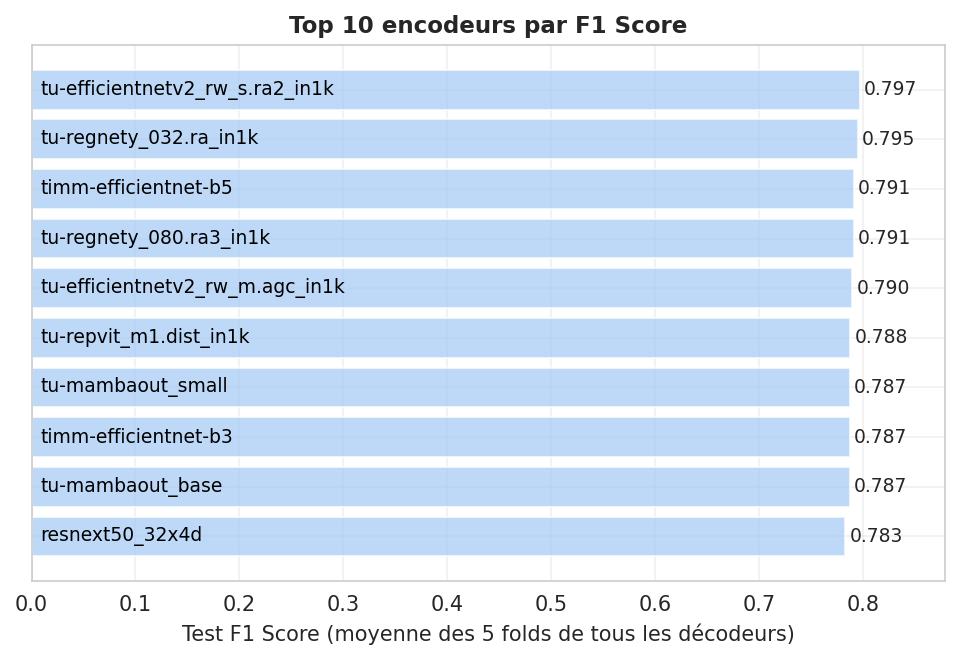

In [ ]:
def plot_backbone_performance(df_models, performance_metric='eval_test_iou_mean', save_path=None):
    """Plot the mean performance of the top 10 backbones for a given metric.

    Args:
        df_models (pd.DataFrame): DataFrame containing model results.
        performance_metric (str): Column name for the metric to display.
        save_path (str, optional): Directory to save the plot. If None, the plot is not saved.
    """
    set_plot_style()
    
    if 'backbone' not in df_models.columns:
        print("Backbone column not found")
        return
    
    fig, ax = plt.subplots(1, 1, figsize=(6.5, 4.5))
    
    # Calculate mean and count for each backbone
    backbone_performance = df_models.groupby('backbone')[performance_metric].agg(['mean', 'count']).reset_index()
    backbone_performance = backbone_performance[backbone_performance['count'] >= 1]
    backbone_performance = backbone_performance.sort_values('mean', ascending=False).head(10)
    
    if not backbone_performance.empty:
        y_pos = range(len(backbone_performance) - 1, -1, -1)
        bars = ax.barh(y_pos, backbone_performance['mean'], alpha=0.7)
        
        # Add value labels to the end of each bar
        for bar, mean_val in zip(bars, backbone_performance['mean']):
            ax.text(bar.get_width()*1.005, bar.get_y() + bar.get_height()/2, 
                    f'{mean_val:.3f}', ha='left', va='center', fontsize=9)
        
        ax.set_xlim(left=0, right=ax.get_xlim()[1]*1.05)
        ax.set_yticks(y_pos)
        
        # Display backbone names inside the bars
        backbone_names = list(backbone_performance['backbone'])
        for bar, name in zip(bars, backbone_names):
            ax.text(ax.get_xlim()[1]*0.01, bar.get_y() + bar.get_height()/2, 
                    name, ha='left', va='center', fontsize=9, color='black', zorder=10)
        
        ax.set_yticklabels([])
        ax.tick_params(axis='y', pad=-5)
        
        # Set axis labels and titles based on the metric
        if performance_metric == 'eval_test_iou_mean':
            ax.set_xlabel('Test IoU (mean of 5 folds for all decoders)', fontsize=10)
            ax.set_title('Top 10 Backbones by IoU', fontsize=11, fontweight='bold')
            graphic_number = "01"
        elif performance_metric == 'eval_test_map_50_mean':
            ax.set_xlabel('Test mAP@0.5 (mean of 5 folds for all decoders)', fontsize=10)
            ax.set_title('Top 10 Backbones by mAP@0.5', fontsize=11, fontweight='bold')
            graphic_number = "02"
        elif performance_metric == 'eval_test_map_75_mean':
            ax.set_xlabel('Test mAP@0.75 (mean of 5 folds for all decoders)', fontsize=10)
            ax.set_title('Top 10 Backbones by mAP@0.75', fontsize=11, fontweight='bold')
            graphic_number = "03"
        elif performance_metric == 'eval_test_map_95_mean':
            ax.set_xlabel('Test mAP@0.95 (mean of 5 folds for all decoders)', fontsize=10)
            ax.set_title('Top 10 Backbones by mAP@0.95', fontsize=11, fontweight='bold')
            graphic_number = "04"
        elif performance_metric == 'eval_test_accuracy_mean':
            ax.set_xlabel('Test Accuracy (mean of 5 folds for all decoders)', fontsize=10)
            ax.set_title('Top 10 Backbones by Accuracy', fontsize=11, fontweight='bold')
            graphic_number = "05"
        elif performance_metric == 'eval_test_recall_mean':
            ax.set_xlabel('Test Recall (mean of 5 folds for all decoders)', fontsize=10)
            ax.set_title('Top 10 Backbones by Recall', fontsize=11, fontweight='bold')
            graphic_number = "06"
        elif performance_metric == 'eval_test_precision_mean':
            ax.set_xlabel('Test Precision (mean of 5 folds for all decoders)', fontsize=10)
            ax.set_title('Top 10 Backbones by Precision', fontsize=11, fontweight='bold')
            graphic_number = "07"
        elif performance_metric == 'eval_test_f1_score_mean':
            ax.set_xlabel('Test F1 Score (mean of 5 folds for all decoders)', fontsize=10)
            ax.set_title('Top 10 Backbones by F1 Score', fontsize=11, fontweight='bold')
            graphic_number = "08"
        ax.grid(True, alpha=0.3)
    
    plt.tight_layout()
    if save_path:
        plt.savefig(f"{save_path}/ch4_04_backbone_performance_{graphic_number}_{performance_metric}.png", dpi=300, bbox_inches='tight')
    plt.show()

plot_backbone_performance(df_model_results_clean_concat_yolo_smp, performance_metric='eval_test_iou_mean', save_path=GRAPHICS_PATH)
plot_backbone_performance(df_model_results_clean_concat_yolo_smp, performance_metric='eval_test_map_50_mean', save_path=GRAPHICS_PATH)
plot_backbone_performance(df_model_results_clean_concat_yolo_smp, performance_metric='eval_test_map_75_mean', save_path=GRAPHICS_PATH)
plot_backbone_performance(df_model_results_clean_concat_yolo_smp, performance_metric='eval_test_map_95_mean', save_path=GRAPHICS_PATH)
plot_backbone_performance(df_model_results_clean_concat_yolo_smp, performance_metric='eval_test_accuracy_mean', save_path=GRAPHICS_PATH)
plot_backbone_performance(df_model_results_clean_concat_yolo_smp, performance_metric='eval_test_recall_mean', save_path=GRAPHICS_PATH)
plot_backbone_performance(df_model_results_clean_concat_yolo_smp, performance_metric='eval_test_precision_mean', save_path=GRAPHICS_PATH)
plot_backbone_performance(df_model_results_clean_concat_yolo_smp, performance_metric='eval_test_f1_score_mean', save_path=GRAPHICS_PATH)

### Top 3 modèles par taille

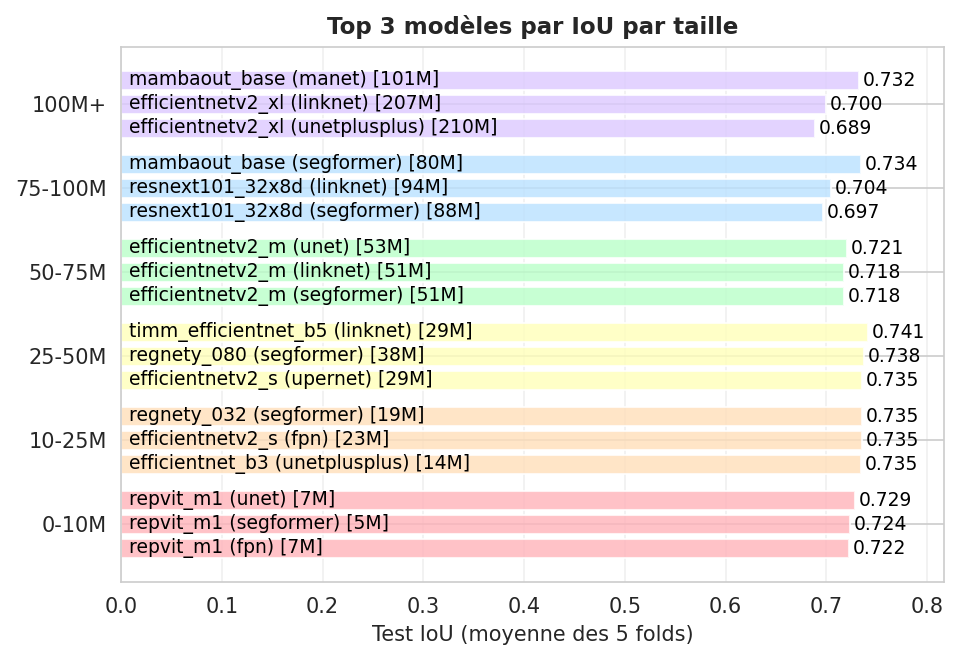

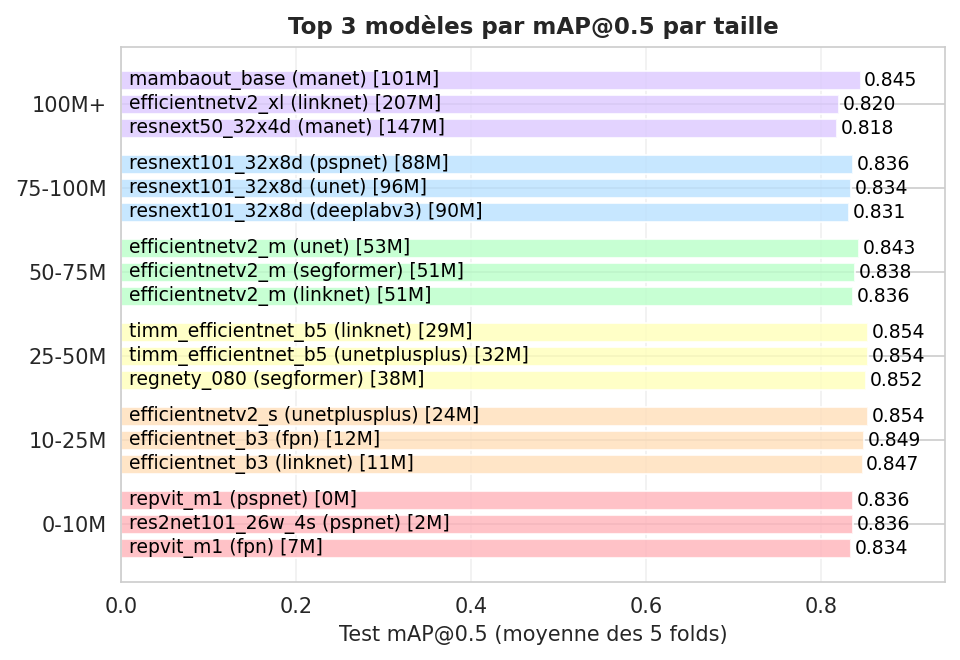

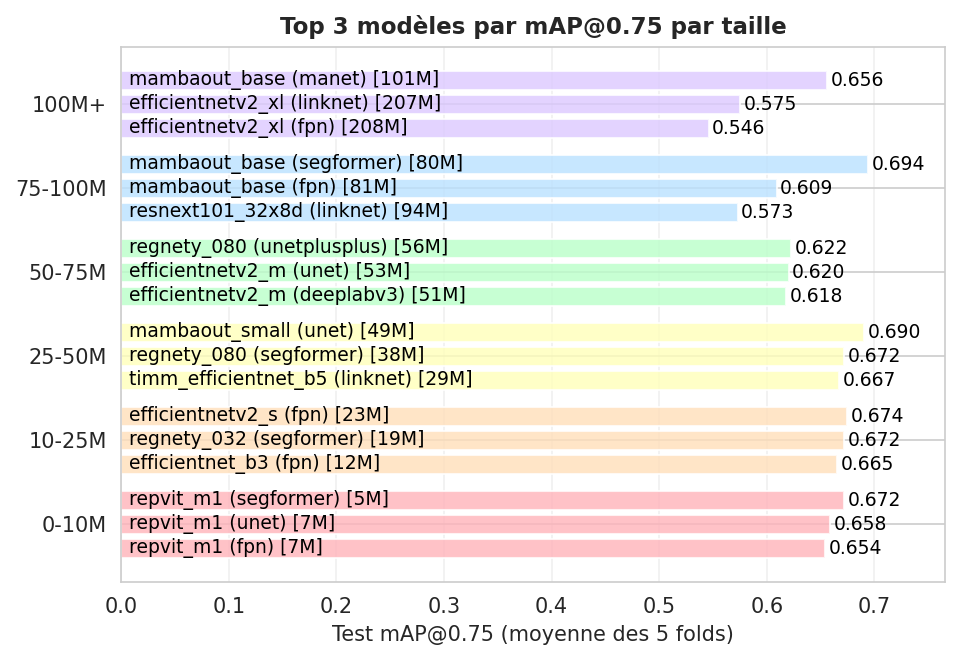

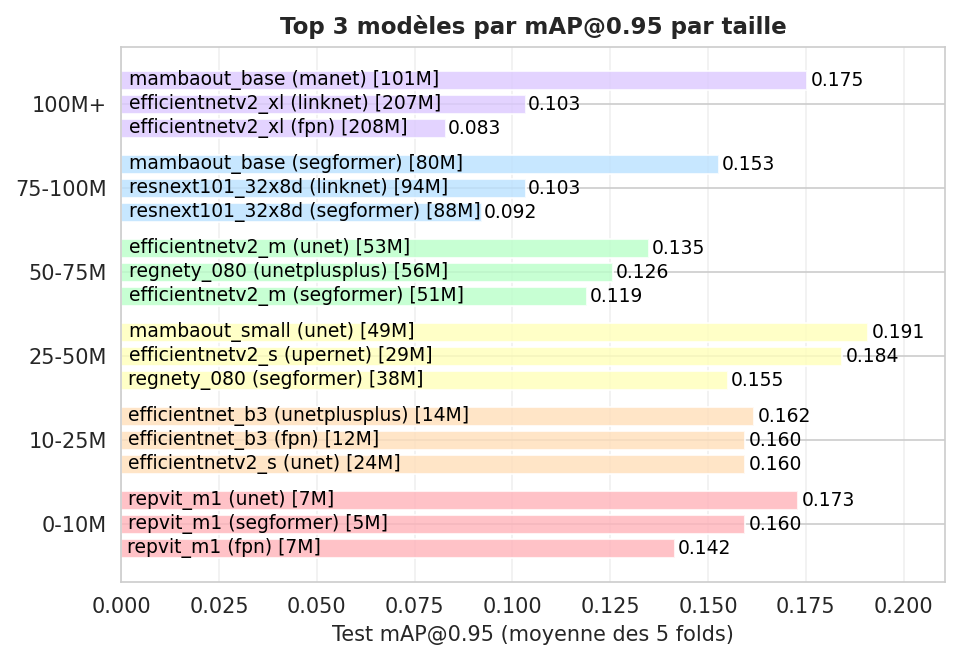

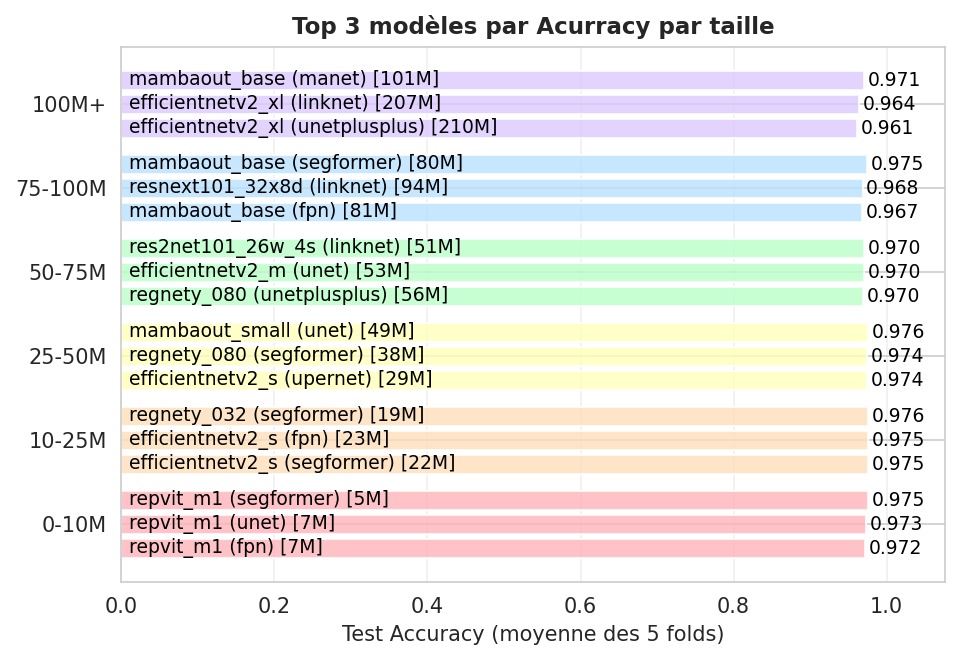

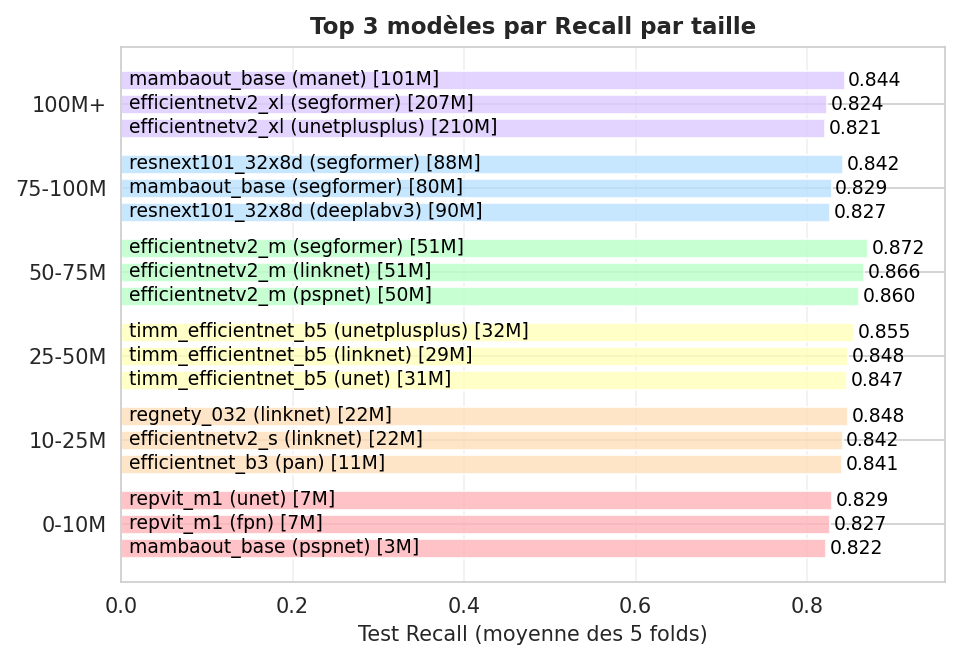

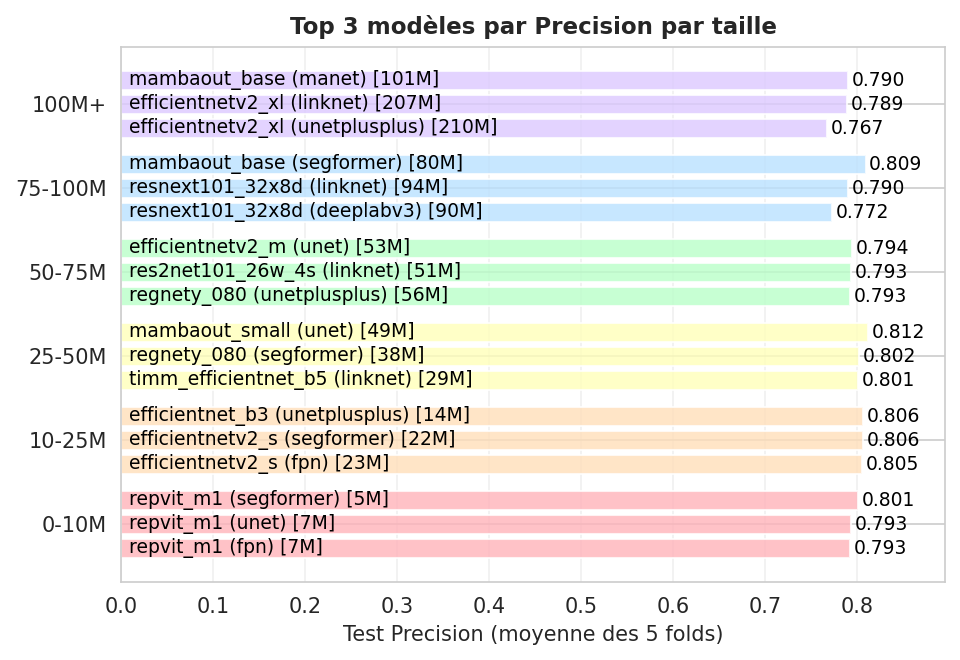

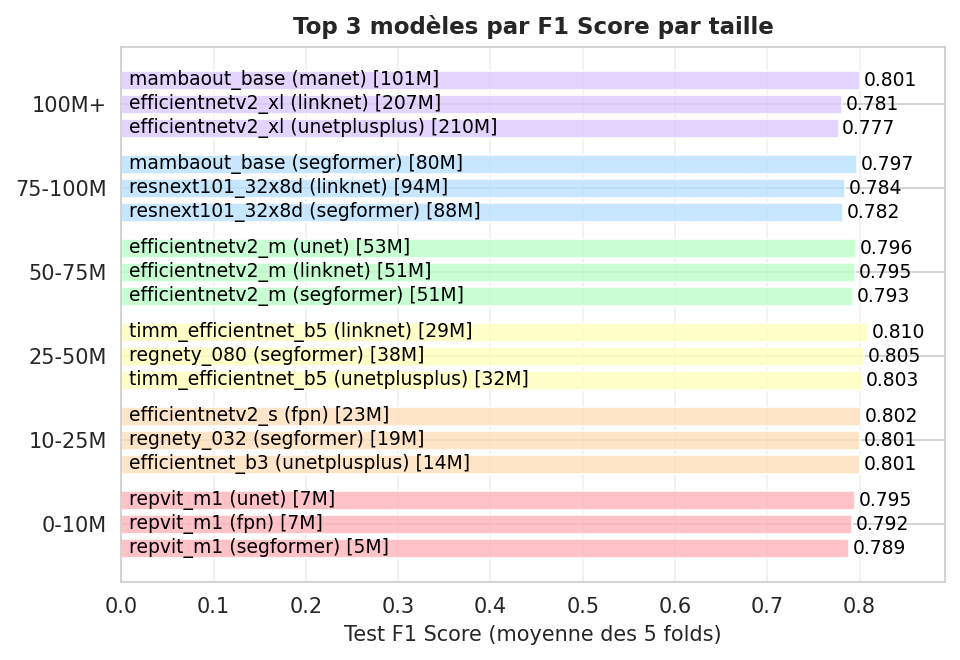

In [ ]:
def plot_models_by_size_category(df_models, performance_metric='eval_test_iou_mean', save_path=None):
    """Plot the top 3 models by size category for a given performance metric.
    
    Args:
        df_models (pd.DataFrame): DataFrame containing model results.
        performance_metric (str): Column name for the performance metric to plot.
        save_path (str, optional): Directory to save the plot. If None, the plot is not saved.
    """
    set_plot_style()
    
    fig, ax = plt.subplots(1, 1, figsize=(6.5, 4.5))
    
    if 'num_params_M' in df_models.columns and performance_metric in df_models.columns:
        # Define parameter size bins and labels
        size_bins = [(0, 10), (10, 25), (25, 50), (50, 75), (75, 100), (100, float('inf'))]
        bin_labels = ['0-10M', '10-25M', '25-50M', '50-75M', '75-100M', '100M+']
        
        # Assign pastel colors for each size category
        pastel_colors = ['#FFB3BA', '#FFDFBA', '#FFFFBA', '#BAFFC9', '#BAE1FF', '#DCC9FF']
        
        # Remove rows with missing values in relevant columns
        size_data = df_models[['num_params_M', performance_metric, 'config_', 'architecture']].dropna()
        
        if not size_data.empty:
            models_per_bin = 3  # Maximum number of models to display per bin
            bin_spacing = 0.5   # Space between bins
            total_bins = len(bin_labels)
            
            # Calculate y-axis positions for each bin
            bin_positions = {}
            current_y = 0
            for i, label in enumerate(bin_labels):
                bin_positions[label] = {
                    'start': current_y,
                    'middle': current_y + (models_per_bin - 1) / 2,
                    'end': current_y + models_per_bin - 1
                }
                current_y += models_per_bin + bin_spacing
            
            all_models = []
            
            for i, ((min_size, max_size), label) in enumerate(zip(size_bins, bin_labels)):
                # Select models within the current size range
                if max_size == float('inf'):
                    bin_models = size_data[size_data['num_params_M'] >= min_size]
                else:
                    bin_models = size_data[(size_data['num_params_M'] >= min_size) & 
                                         (size_data['num_params_M'] < max_size)]
                
                # Select the top 3 models by performance
                top3 = bin_models.nlargest(3, performance_metric)
                
                if not top3.empty:
                    top3_reversed = top3.iloc[::-1]
                    bin_start_y = bin_positions[label]['start']
                    
                    for rank, (_, model) in enumerate(top3_reversed.iterrows()):
                        # Clean up config name for display
                        config_name = str(model['config_'])
                        if '_' in config_name:
                            config_name = '_'.join(config_name.split('_')[1:])
                        config_name = config_name.replace('_imagenet', '')
                        
                        all_models.append({
                            'performance': model[performance_metric],
                            'label': f"{config_name} ({model['architecture']}) [{model['num_params_M']:.0f}M]",
                            'color': pastel_colors[i],
                            'bin_label': label,
                            'y_pos': bin_start_y + rank  # Position within the bin
                        })
            
            if all_models:
                # Draw horizontal bars for each model
                for model in all_models:
                    bar = ax.barh(model['y_pos'], model['performance'], 
                                 color=model['color'], alpha=0.8, height=0.8)
                    
                    # Annotate performance value next to the bar
                    ax.text(model['performance']*1.005, model['y_pos'], 
                           f"{model['performance']:.3f}", 
                           ha='left', va='center', fontsize=9, color='black')
                    
                    # Annotate model label inside the bar area
                    ax.text(ax.get_xlim()[1]*0.01, model['y_pos'], model['label'], 
                           ha='left', va='center', fontsize=9, 
                           color='black', zorder=10)
                
                # Set y-axis ticks and labels for each bin
                y_ticks = [bin_positions[label]['middle'] for label in bin_labels]
                y_labels = bin_labels
                
                ax.set_yticks(y_ticks)
                ax.set_yticklabels(y_labels, fontsize=10)
                
                # Set axis labels and plot title based on the metric
                if performance_metric == 'eval_test_iou_mean':
                    ax.set_xlabel('Test IoU (mean of 5 folds)', fontsize=10)
                    ax.set_title('Top 3 Models by IoU per Size Category', fontsize=11, fontweight='bold')
                    graphic_number = "01"
                if performance_metric == 'eval_test_map_50_mean':
                    ax.set_xlabel('Test mAP@0.5 (mean of 5 folds)', fontsize=10)
                    ax.set_title('Top 3 Models by mAP@0.5 per Size Category', fontsize=11, fontweight='bold')
                    graphic_number = "02"
                if performance_metric == 'eval_test_map_75_mean':
                    ax.set_xlabel('Test mAP@0.75 (mean of 5 folds)', fontsize=10)
                    ax.set_title('Top 3 Models by mAP@0.75 per Size Category', fontsize=11, fontweight='bold')
                    graphic_number = "03"
                if performance_metric == 'eval_test_map_95_mean':
                    ax.set_xlabel('Test mAP@0.95 (mean of 5 folds)', fontsize=10)
                    ax.set_title('Top 3 Models by mAP@0.95 per Size Category', fontsize=11, fontweight='bold')
                    graphic_number = "04"
                if performance_metric == 'eval_test_accuracy_mean':
                    ax.set_xlabel('Test Accuracy (mean of 5 folds)', fontsize=10)
                    ax.set_title('Top 3 Models by Accuracy per Size Category', fontsize=11, fontweight='bold')
                    graphic_number = "05"
                if performance_metric == 'eval_test_recall_mean':
                    ax.set_xlabel('Test Recall (mean of 5 folds)', fontsize=10)
                    ax.set_title('Top 3 Models by Recall per Size Category', fontsize=11, fontweight='bold')
                    graphic_number = "06"
                if performance_metric == 'eval_test_precision_mean':
                    ax.set_xlabel('Test Precision (mean of 5 folds)', fontsize=10)
                    ax.set_title('Top 3 Models by Precision per Size Category', fontsize=11, fontweight='bold')
                    graphic_number = "07"
                if performance_metric == 'eval_test_f1_score_mean':
                    ax.set_xlabel('Test F1 Score (mean of 5 folds)', fontsize=10)
                    ax.set_title('Top 3 Models by F1 Score per Size Category', fontsize=11, fontweight='bold')
                    graphic_number = "08"
                ax.grid(True, alpha=0.3, axis='x')
                
                # Extend x-axis to provide space for labels
                ax.set_xlim(left=0, right=ax.get_xlim()[1]*1.05)
    
    plt.tight_layout()
    if save_path:
        plt.savefig(f"{save_path}/ch4_05_models_by_size_category_{graphic_number}_{performance_metric}.png", dpi=300, bbox_inches='tight')
    plt.show()

# Example usage:
plot_models_by_size_category(df_model_results_clean_concat_yolo_smp, performance_metric='eval_test_iou_mean', save_path=GRAPHICS_PATH)
plot_models_by_size_category(df_model_results_clean_concat_yolo_smp, performance_metric='eval_test_map_50_mean', save_path=GRAPHICS_PATH)
plot_models_by_size_category(df_model_results_clean_concat_yolo_smp, performance_metric='eval_test_map_75_mean', save_path=GRAPHICS_PATH)
plot_models_by_size_category(df_model_results_clean_concat_yolo_smp, performance_metric='eval_test_map_95_mean', save_path=GRAPHICS_PATH)
plot_models_by_size_category(df_model_results_clean_concat_yolo_smp, performance_metric='eval_test_accuracy_mean', save_path=GRAPHICS_PATH)
plot_models_by_size_category(df_model_results_clean_concat_yolo_smp, performance_metric='eval_test_recall_mean', save_path=GRAPHICS_PATH)
plot_models_by_size_category(df_model_results_clean_concat_yolo_smp, performance_metric='eval_test_precision_mean', save_path=GRAPHICS_PATH)
plot_models_by_size_category(df_model_results_clean_concat_yolo_smp, performance_metric='eval_test_f1_score_mean', save_path=GRAPHICS_PATH)

### moustache par décodeur

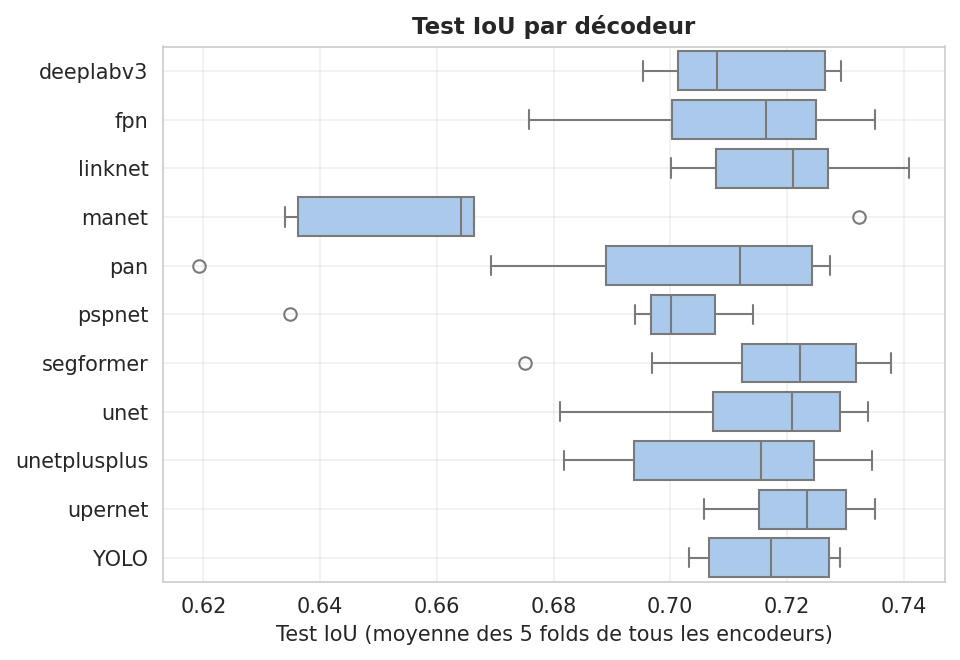

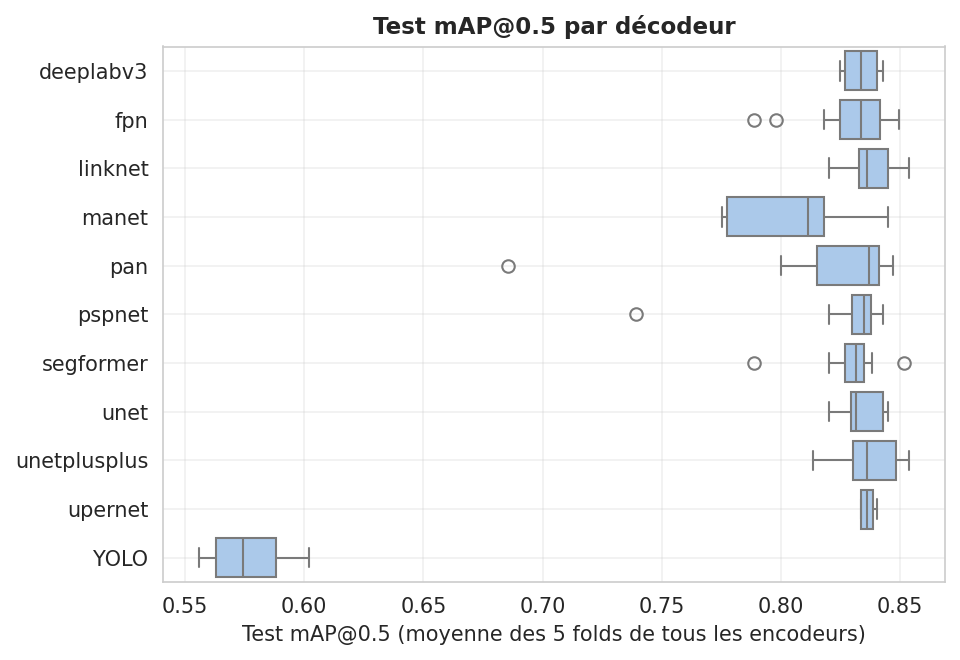

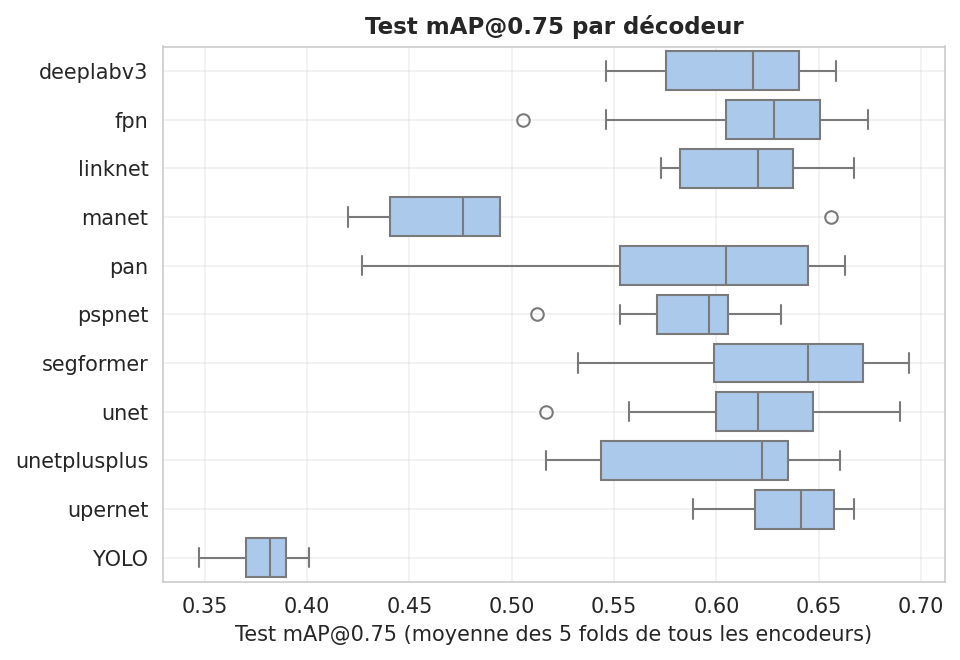

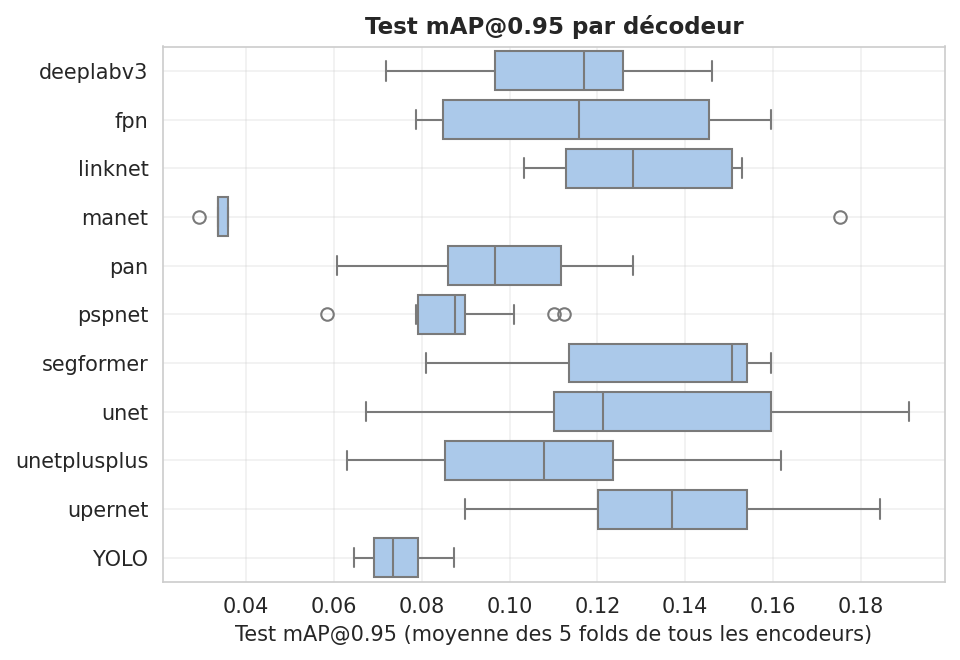

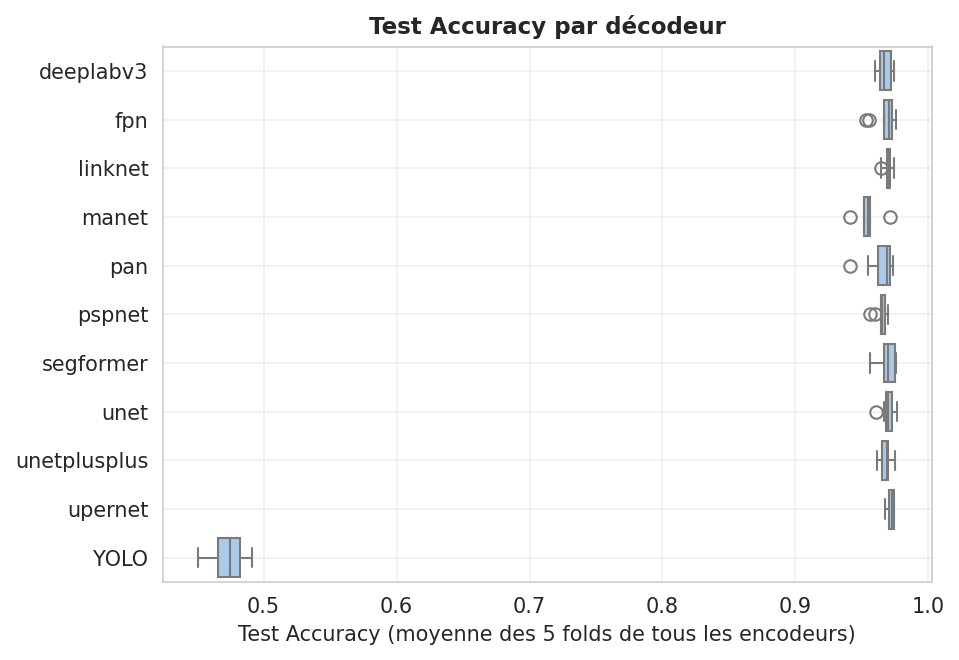

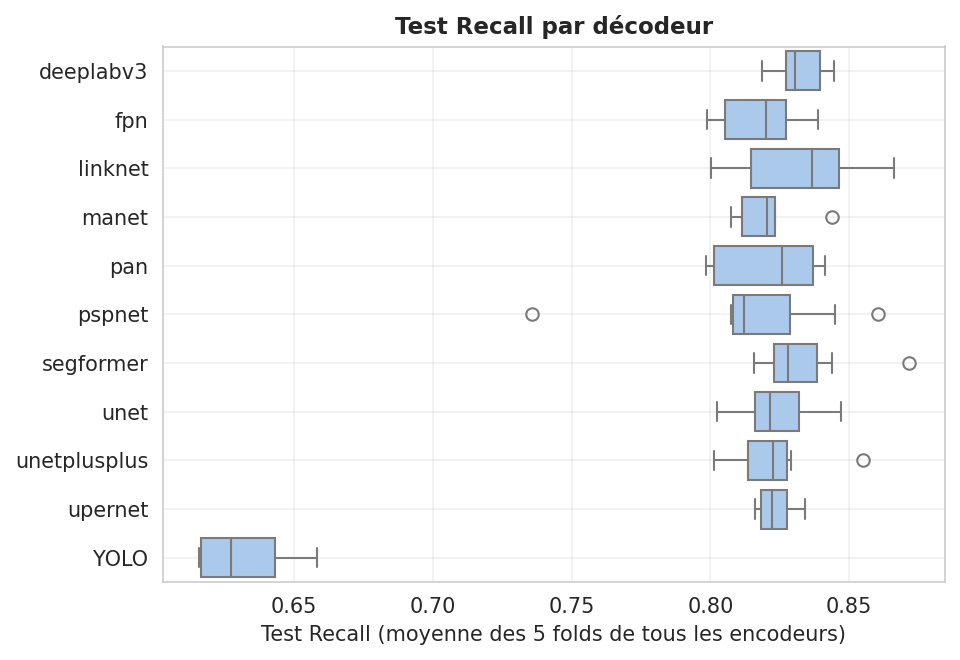

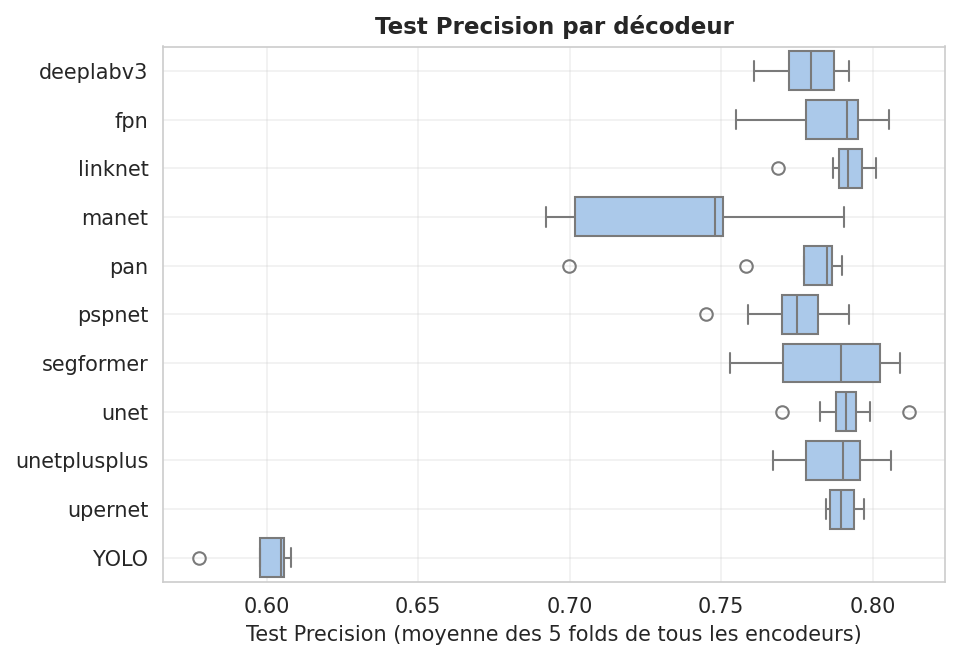

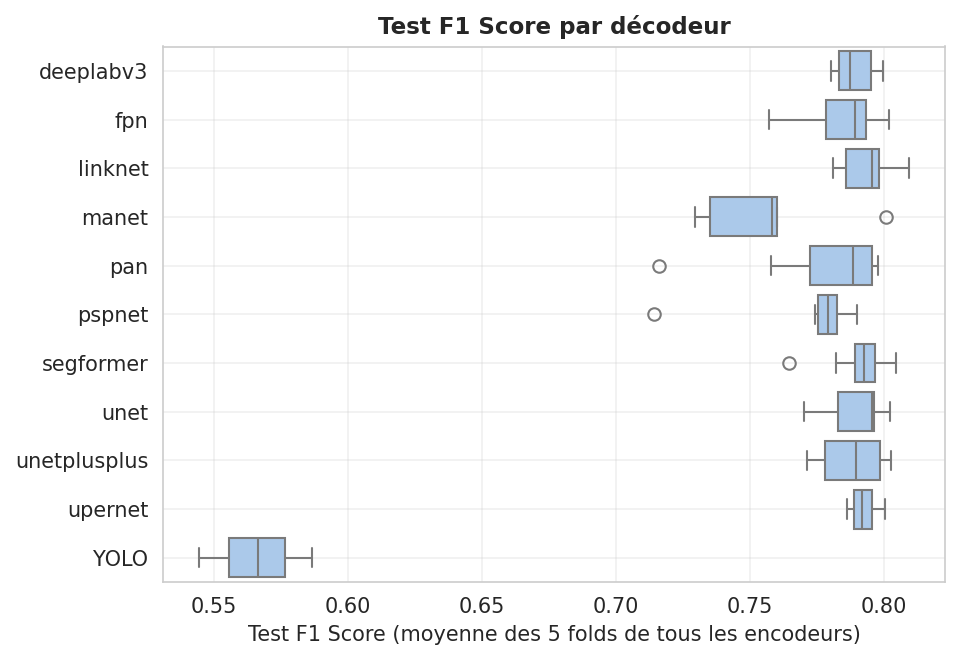

In [ ]:
def plot_architecture_boxplot(df_models, performance_metric='eval_test_iou_mean', save_path=None):
    """Plot a boxplot of test performance by architecture.

    Args:
        df_models (pd.DataFrame): DataFrame containing model results.
        performance_metric (str): Column name for the metric to plot.
        save_path (str, optional): Directory to save the plot. If None, the plot is not saved.
    """
    set_plot_style()
    
    if 'architecture' not in df_models.columns:
        print("Architecture column not found")
        return
    
    fig, ax = plt.subplots(1, 1, figsize=(6.5, 4.5))
    
    # Prepare data for plotting, removing rows with missing values
    plot_data = df_models[[performance_metric, 'architecture']].dropna()
    if len(plot_data) > 0:
        # Draw boxplot for the selected metric grouped by architecture
        sns.boxplot(data=plot_data, y='architecture', x=performance_metric, ax=ax)
        
        # Set axis labels and titles based on the selected metric
        if performance_metric == 'eval_test_iou_mean':
            ax.set_xlabel('Test IoU (mean of 5 folds for all encoders)', fontsize=10)
            ax.set_title('Test IoU by Decoder', fontsize=11, fontweight='bold')
            graphic_number = "01"
        elif performance_metric == 'eval_test_map_50_mean':
            ax.set_xlabel('Test mAP@0.5 (mean of 5 folds for all encoders)', fontsize=10)
            ax.set_title('Test mAP@0.5 by Decoder', fontsize=11, fontweight='bold')
            graphic_number = "02"
        elif performance_metric == 'eval_test_map_75_mean':
            ax.set_xlabel('Test mAP@0.75 (mean of 5 folds for all encoders)', fontsize=10)
            ax.set_title('Test mAP@0.75 by Decoder', fontsize=11, fontweight='bold')
            graphic_number = "03"
        elif performance_metric == 'eval_test_map_95_mean':
            ax.set_xlabel('Test mAP@0.95 (mean of 5 folds for all encoders)', fontsize=10)
            ax.set_title('Test mAP@0.95 by Decoder', fontsize=11, fontweight='bold')
            graphic_number = "04"
        elif performance_metric == 'eval_test_accuracy_mean':
            ax.set_xlabel('Test Accuracy (mean of 5 folds for all encoders)', fontsize=10)
            ax.set_title('Test Accuracy by Decoder', fontsize=11, fontweight='bold')
            graphic_number = "05"
        elif performance_metric == 'eval_test_recall_mean':
            ax.set_xlabel('Test Recall (mean of 5 folds for all encoders)', fontsize=10)
            ax.set_title('Test Recall by Decoder', fontsize=11, fontweight='bold')
            graphic_number = "06"
        elif performance_metric == 'eval_test_precision_mean':
            ax.set_xlabel('Test Precision (mean of 5 folds for all encoders)', fontsize=10)
            ax.set_title('Test Precision by Decoder', fontsize=11, fontweight='bold')
            graphic_number = "07"
        elif performance_metric == 'eval_test_f1_score_mean':
            ax.set_xlabel('Test F1 Score (mean of 5 folds for all encoders)', fontsize=10)
            ax.set_title('Test F1 Score by Decoder', fontsize=11, fontweight='bold')
            graphic_number = "08"
        ax.set_ylabel('', fontsize=10)
        ax.grid(True, alpha=0.3)
    
    plt.tight_layout()
    if save_path:
        plt.savefig(f"{save_path}/ch4_06_architecture_boxplot_{graphic_number}_{performance_metric}.png", dpi=300, bbox_inches='tight')
    plt.show()

plot_architecture_boxplot(df_model_results_clean_concat_yolo_smp, performance_metric='eval_test_iou_mean', save_path=GRAPHICS_PATH)
plot_architecture_boxplot(df_model_results_clean_concat_yolo_smp, performance_metric='eval_test_map_50_mean', save_path=GRAPHICS_PATH)
plot_architecture_boxplot(df_model_results_clean_concat_yolo_smp, performance_metric='eval_test_map_75_mean', save_path=GRAPHICS_PATH)
plot_architecture_boxplot(df_model_results_clean_concat_yolo_smp, performance_metric='eval_test_map_95_mean', save_path=GRAPHICS_PATH)
plot_architecture_boxplot(df_model_results_clean_concat_yolo_smp, performance_metric='eval_test_accuracy_mean', save_path=GRAPHICS_PATH)
plot_architecture_boxplot(df_model_results_clean_concat_yolo_smp, performance_metric='eval_test_recall_mean', save_path=GRAPHICS_PATH)
plot_architecture_boxplot(df_model_results_clean_concat_yolo_smp, performance_metric='eval_test_precision_mean', save_path=GRAPHICS_PATH)
plot_architecture_boxplot(df_model_results_clean_concat_yolo_smp, performance_metric='eval_test_f1_score_mean', save_path=GRAPHICS_PATH)

### moustache par encodeur

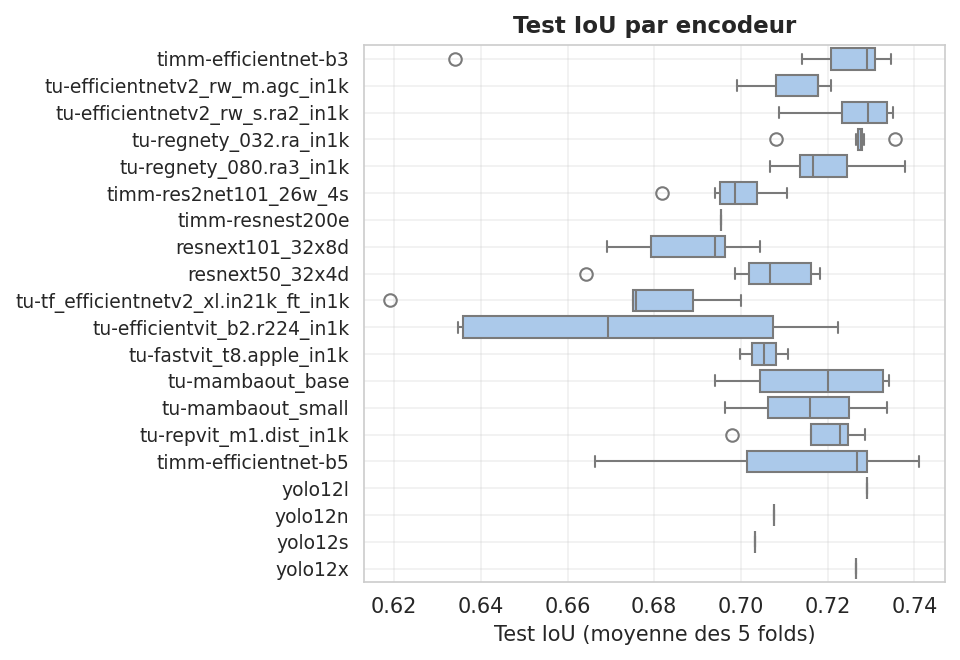

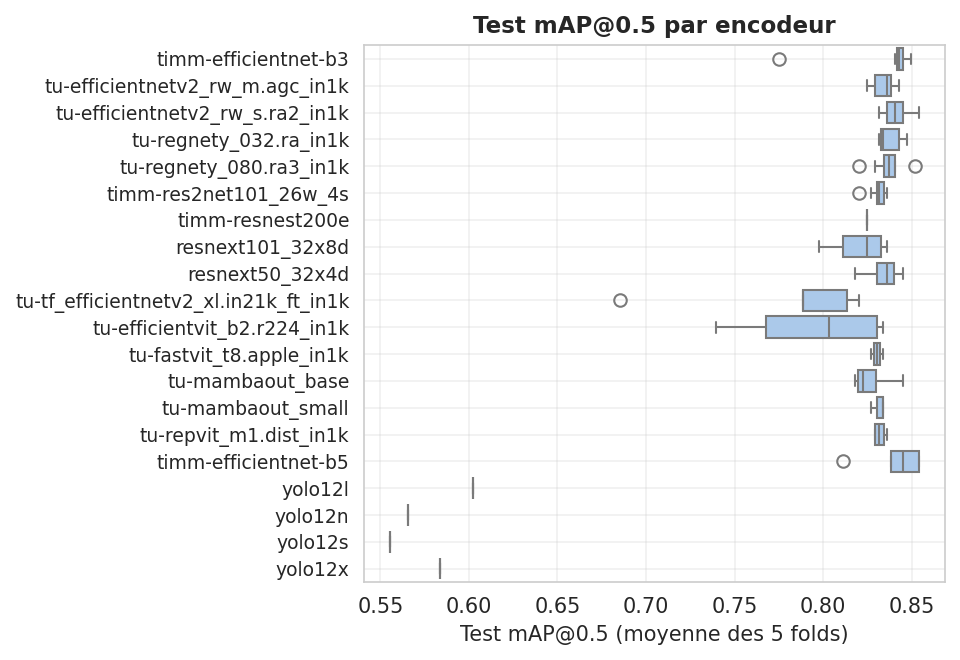

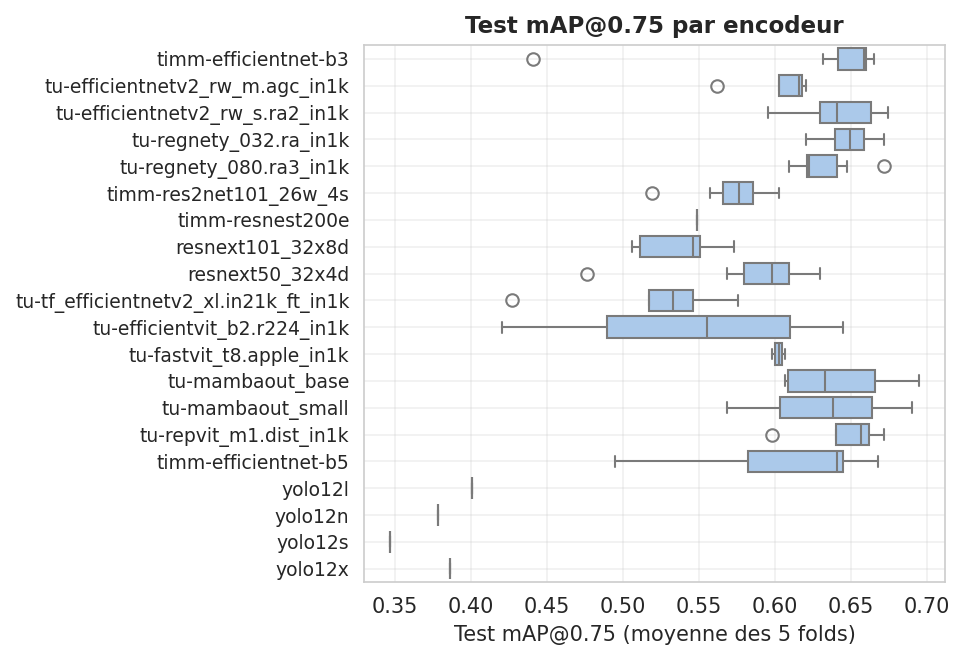

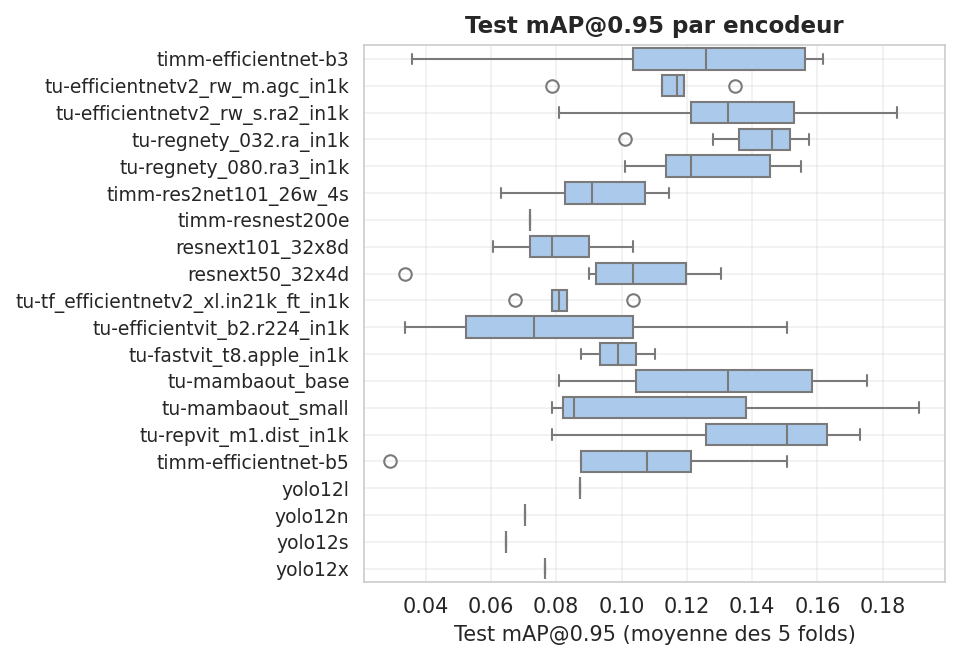

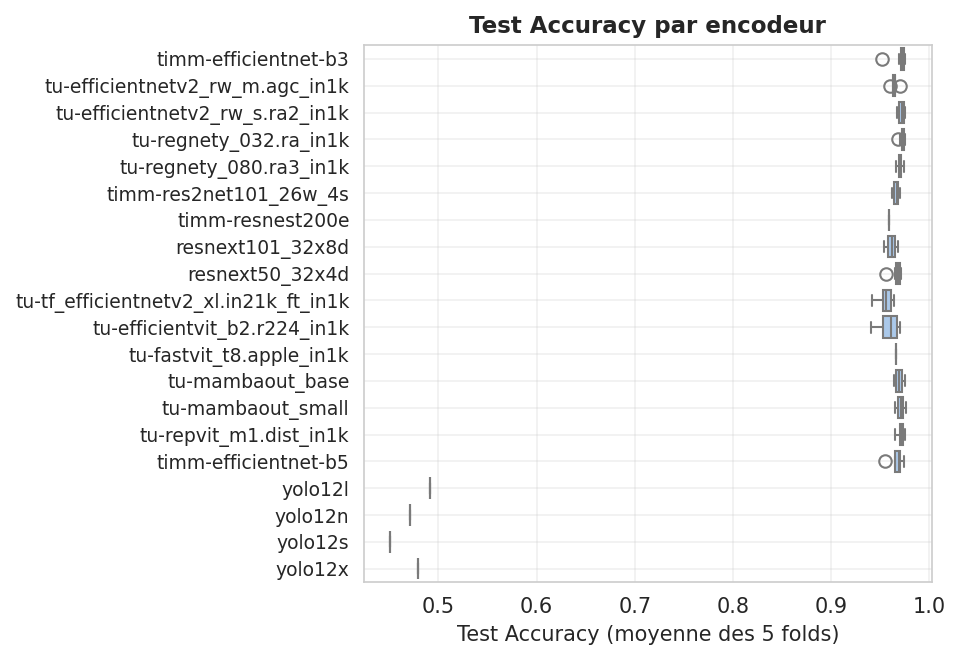

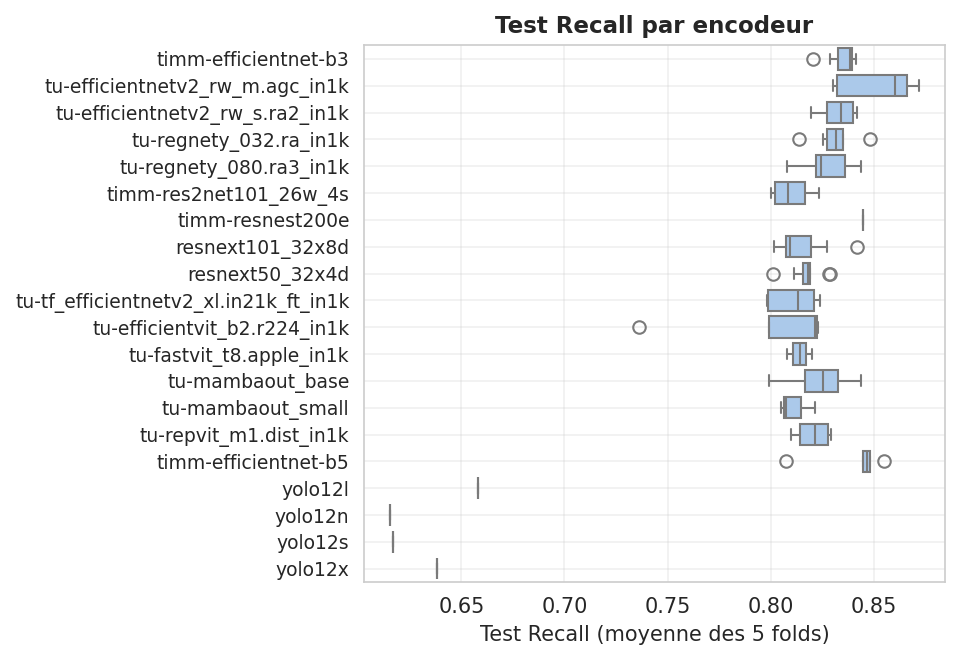

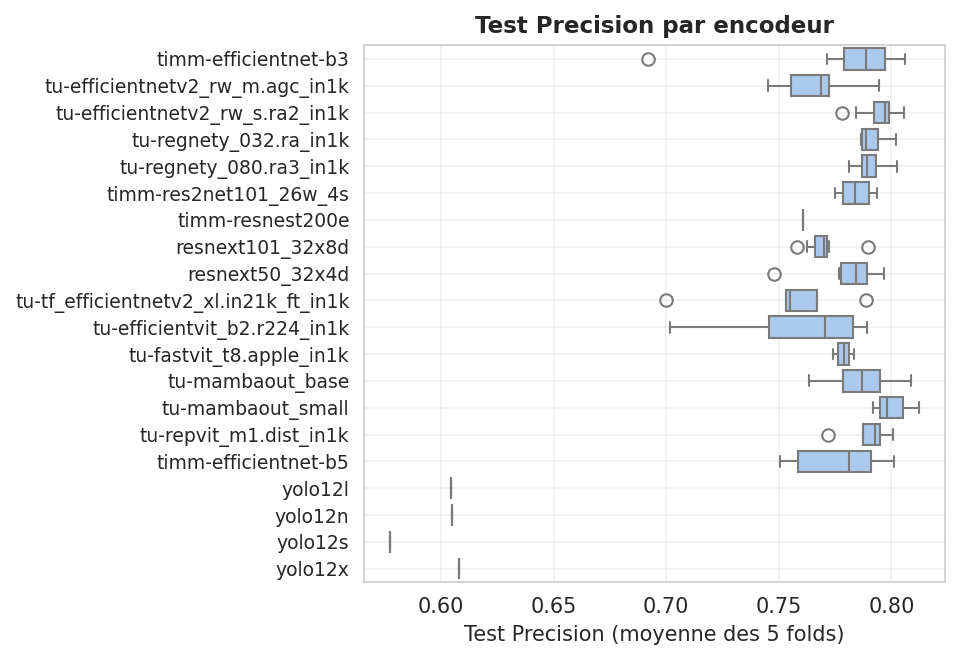

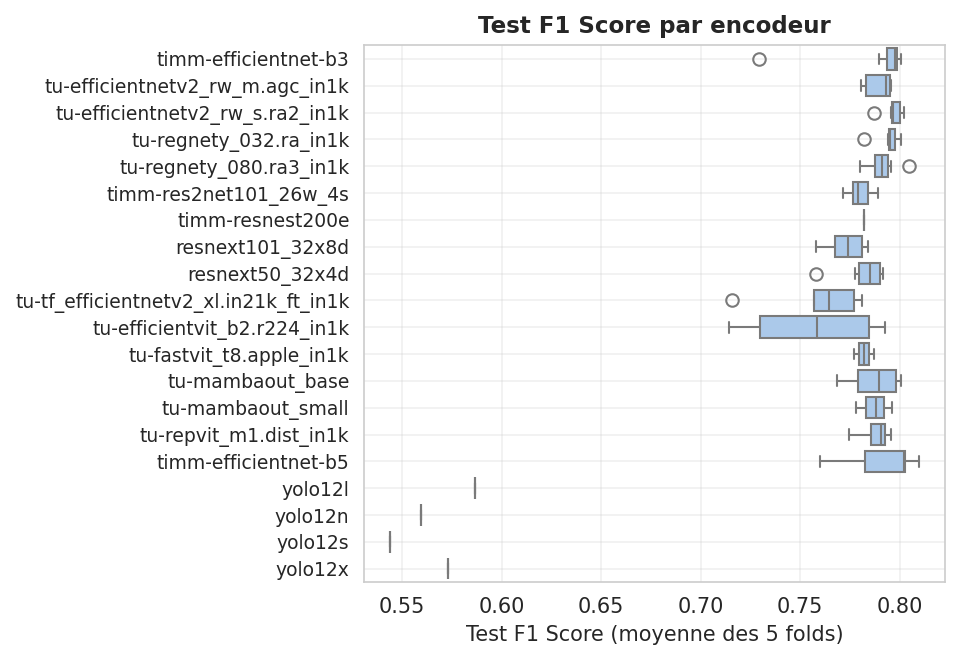

In [ ]:
def plot_backbone_boxplot(df_models, performance_metric='eval_test_iou_mean', save_path=None):
    """
    Plot a boxplot of test performance by backbone.

    Args:
        df_models (pd.DataFrame): DataFrame containing model results.
        performance_metric (str): Column name for the metric to plot.
        save_path (str, optional): Directory to save the plot. If None, the plot is not saved.
    """
    set_plot_style()
    
    if 'backbone' not in df_models.columns:
        print("Backbone column not found")
        return
    
    fig, ax = plt.subplots(1, 1, figsize=(6.5, 4.5))
    
    # Prepare data for plotting, removing rows with missing values
    plot_data = df_models[[performance_metric, 'backbone']].dropna()
    if len(plot_data) > 0:
        # Draw boxplot for the selected metric grouped by backbone
        sns.boxplot(data=plot_data, y='backbone', x=performance_metric, ax=ax)
        # Set axis labels and titles based on the selected metric
        if performance_metric == 'eval_test_iou_mean':
            ax.set_xlabel('Test IoU (mean of 5 folds)', fontsize=10)
            ax.set_title('Test IoU by Encoder', fontsize=11, fontweight='bold')
            graphic_number = "01"
        elif performance_metric == 'eval_test_map_50_mean':
            ax.set_xlabel('Test mAP@0.5 (mean of 5 folds)', fontsize=10)
            ax.set_title('Test mAP@0.5 by Encoder', fontsize=11, fontweight='bold')
            graphic_number = "02"
        elif performance_metric == 'eval_test_map_75_mean':
            ax.set_xlabel('Test mAP@0.75 (mean of 5 folds)', fontsize=10)
            ax.set_title('Test mAP@0.75 by Encoder', fontsize=11, fontweight='bold')
            graphic_number = "03"
        elif performance_metric == 'eval_test_map_95_mean':
            ax.set_xlabel('Test mAP@0.95 (mean of 5 folds)', fontsize=10)
            ax.set_title('Test mAP@0.95 by Encoder', fontsize=11, fontweight='bold')
            graphic_number = "04"
        elif performance_metric == 'eval_test_accuracy_mean':
            ax.set_xlabel('Test Accuracy (mean of 5 folds)', fontsize=10)
            ax.set_title('Test Accuracy by Encoder', fontsize=11, fontweight='bold')
            graphic_number = "05"
        elif performance_metric == 'eval_test_recall_mean':
            ax.set_xlabel('Test Recall (mean of 5 folds)', fontsize=10)
            ax.set_title('Test Recall by Encoder', fontsize=11, fontweight='bold')
            graphic_number = "06"
        elif performance_metric == 'eval_test_precision_mean':
            ax.set_xlabel('Test Precision (mean of 5 folds)', fontsize=10)
            ax.set_title('Test Precision by Encoder', fontsize=11, fontweight='bold')
            graphic_number = "07"
        elif performance_metric == 'eval_test_f1_score_mean':
            ax.set_xlabel('Test F1 Score (mean of 5 folds)', fontsize=10)
            ax.set_title('Test F1 Score by Encoder', fontsize=11, fontweight='bold')
            graphic_number = "08"
        ax.set_ylabel('', fontsize=10)
        ax.tick_params(axis='y', labelsize=9)
        ax.grid(True, alpha=0.3)
    
    plt.tight_layout()
    if save_path:
        plt.savefig(f"{save_path}/ch4_07_backbone_boxplot_{graphic_number}_{performance_metric}.png", dpi=300, bbox_inches='tight')
    plt.show()

plot_backbone_boxplot(df_model_results_clean_concat_yolo_smp, performance_metric='eval_test_iou_mean', save_path=GRAPHICS_PATH)
plot_backbone_boxplot(df_model_results_clean_concat_yolo_smp, performance_metric='eval_test_map_50_mean', save_path=GRAPHICS_PATH)
plot_backbone_boxplot(df_model_results_clean_concat_yolo_smp, performance_metric='eval_test_map_75_mean', save_path=GRAPHICS_PATH)
plot_backbone_boxplot(df_model_results_clean_concat_yolo_smp, performance_metric='eval_test_map_95_mean', save_path=GRAPHICS_PATH)
plot_backbone_boxplot(df_model_results_clean_concat_yolo_smp, performance_metric='eval_test_accuracy_mean', save_path=GRAPHICS_PATH)
plot_backbone_boxplot(df_model_results_clean_concat_yolo_smp, performance_metric='eval_test_recall_mean', save_path=GRAPHICS_PATH)
plot_backbone_boxplot(df_model_results_clean_concat_yolo_smp, performance_metric='eval_test_precision_mean', save_path=GRAPHICS_PATH)
plot_backbone_boxplot(df_model_results_clean_concat_yolo_smp, performance_metric='eval_test_f1_score_mean', save_path=GRAPHICS_PATH)

### pareto modèles

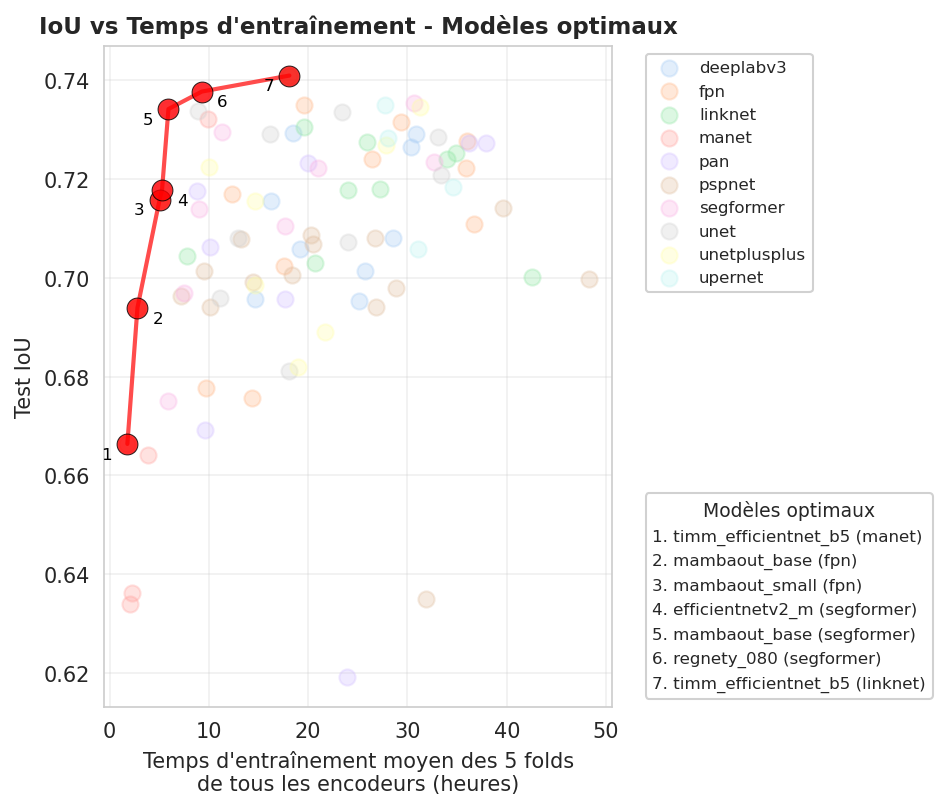

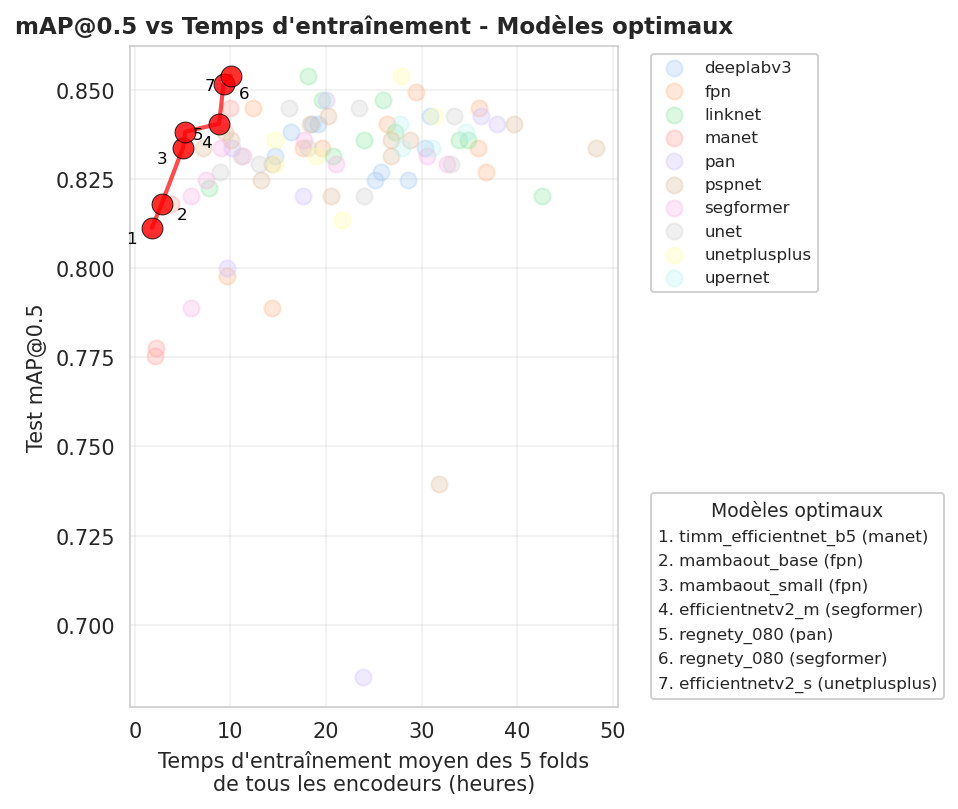

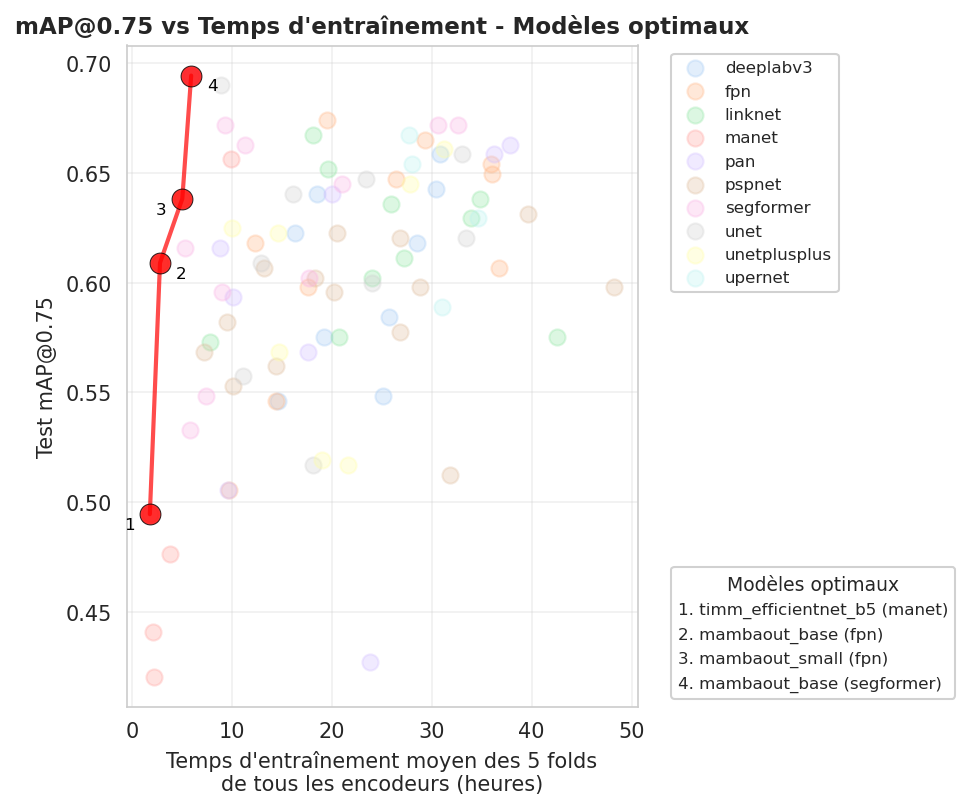

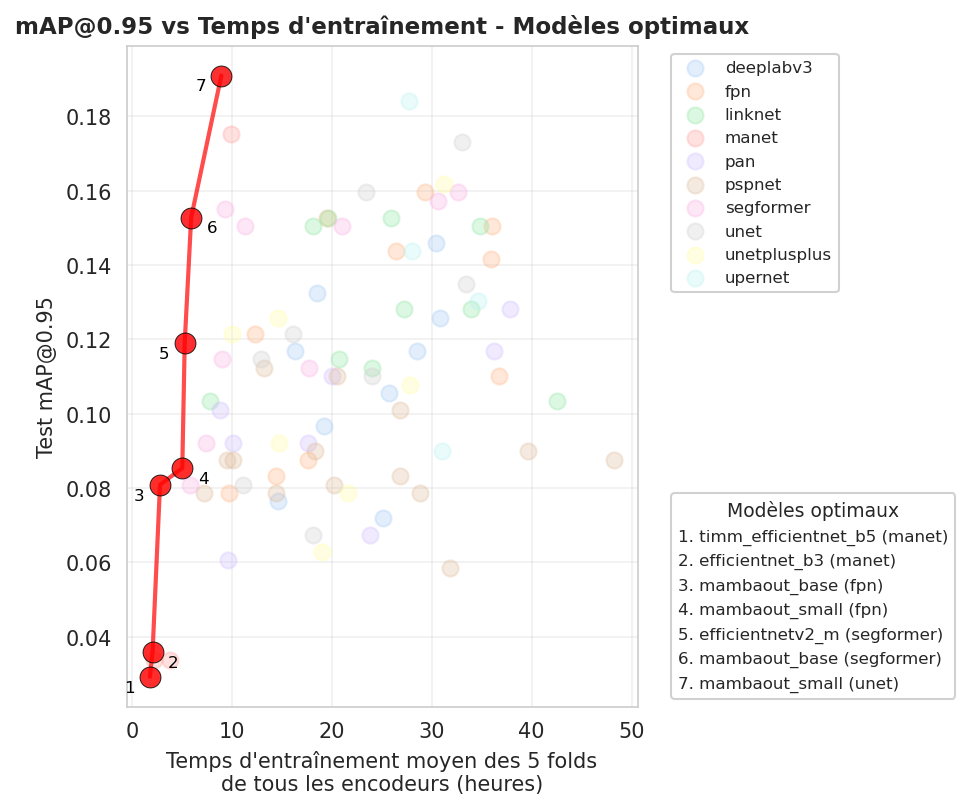

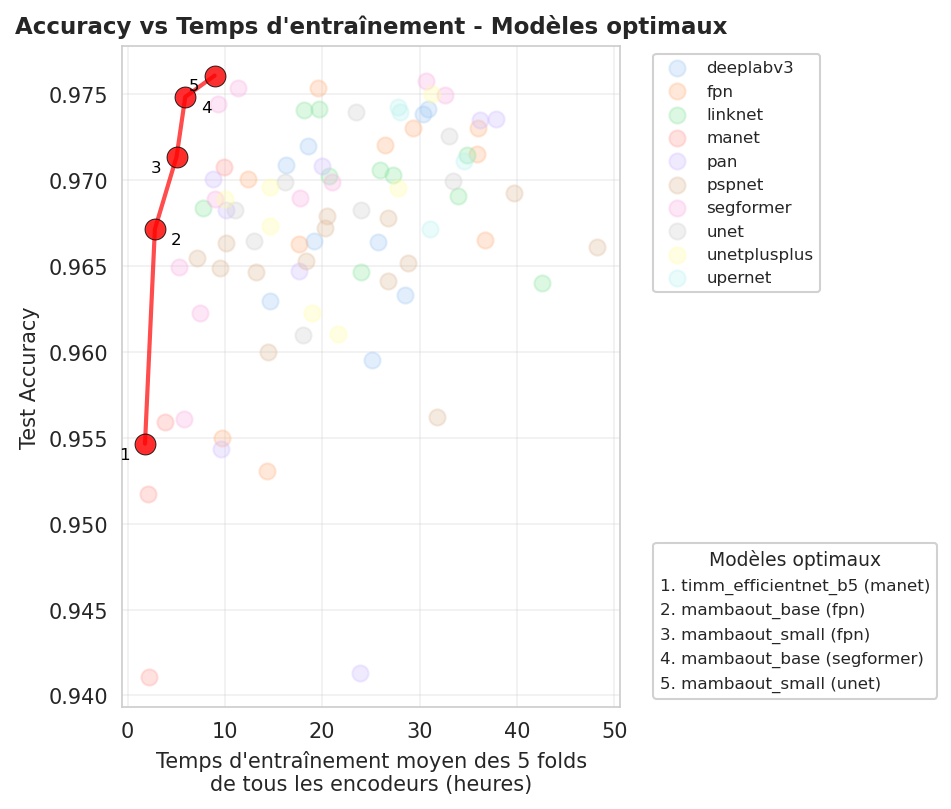

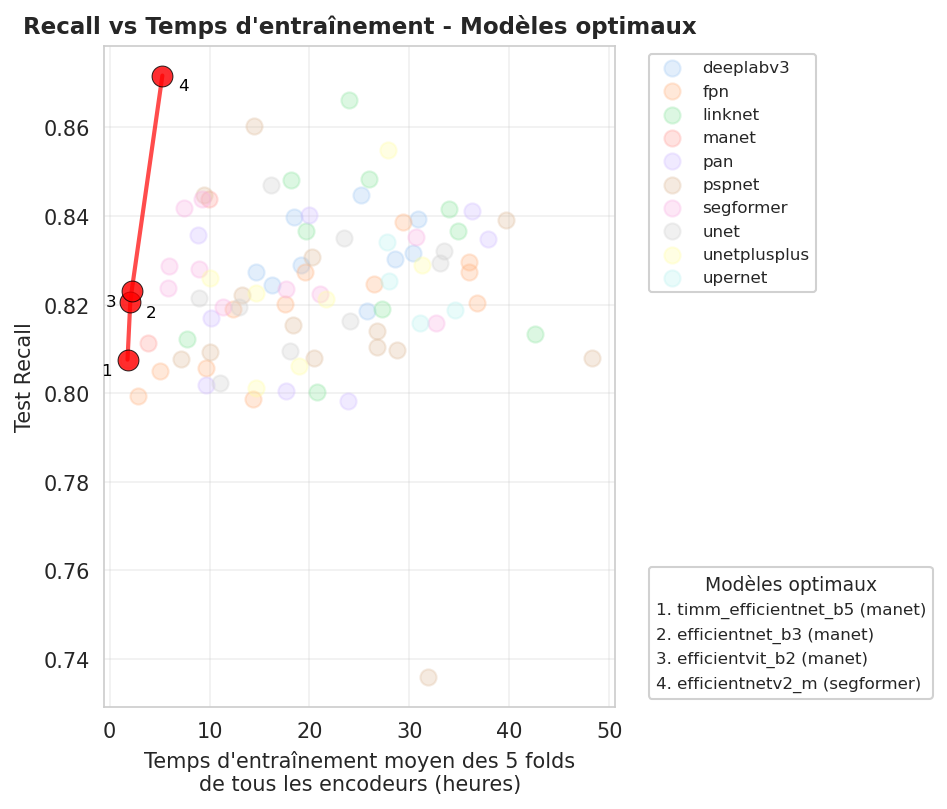

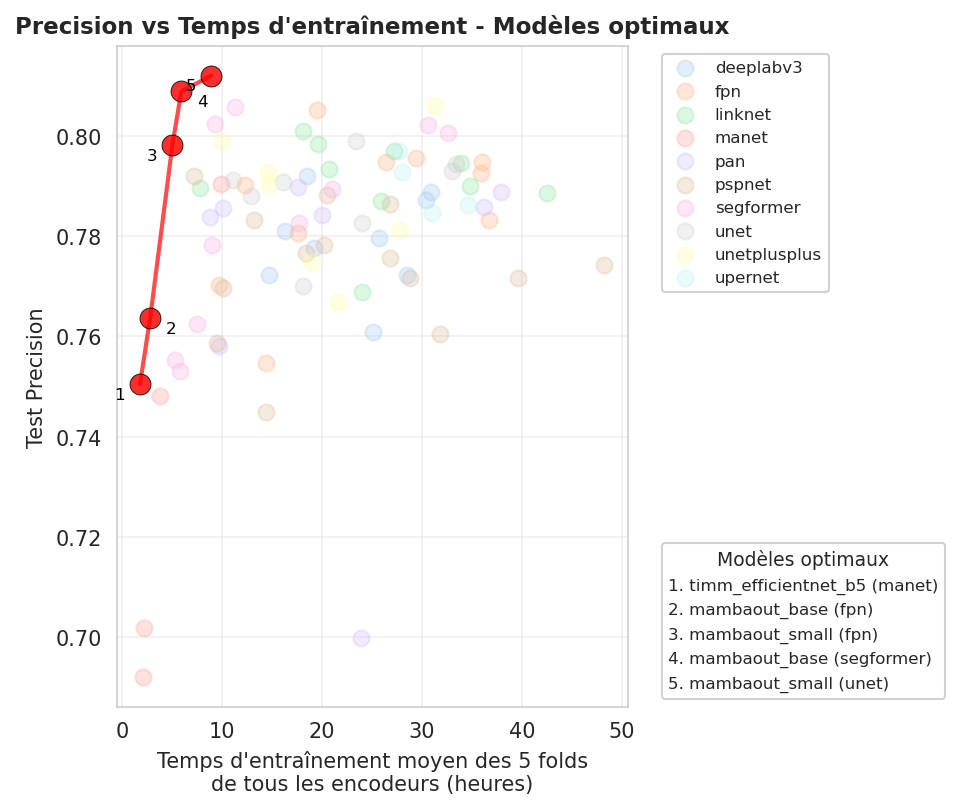

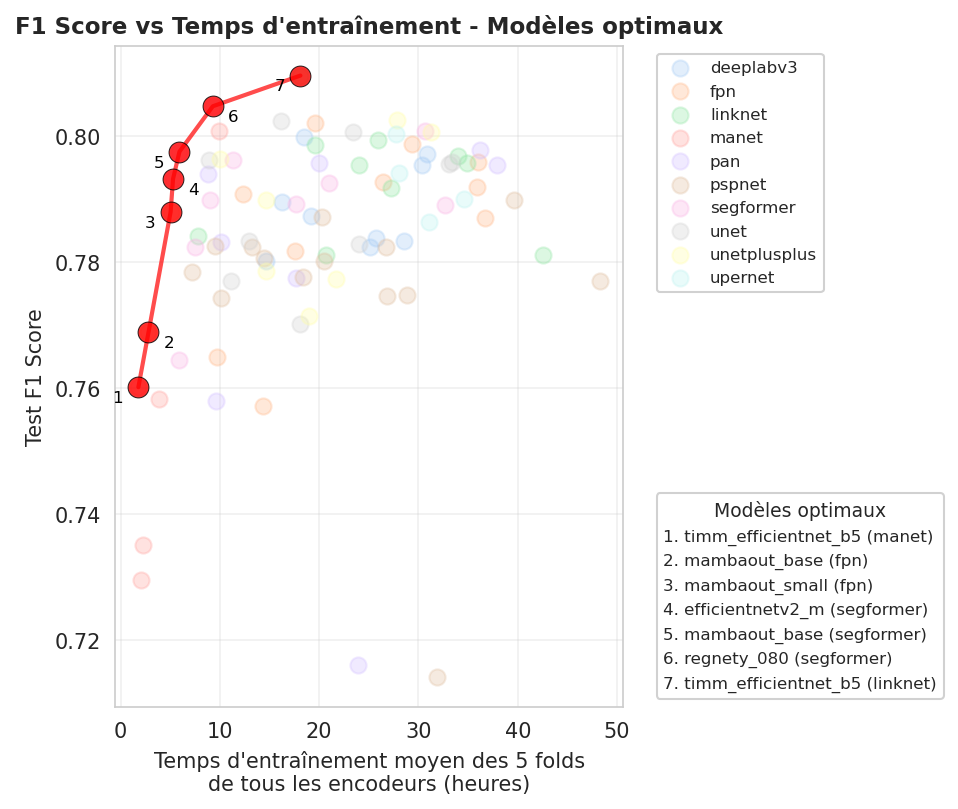

In [ ]:
def plot_performance_vs_training_time_pareto(df_models, performance_metric='eval_test_iou_mean', save_path=None):
    """Plot performance vs. training time with Pareto frontier and numbered annotations.

    Args:
        df_models (pd.DataFrame): DataFrame containing model results.
        performance_metric (str): Column name for the performance metric to plot.
        save_path (str, optional): Directory to save the plot. If None, the plot is not saved.
    """
    set_plot_style()
    
    fig, ax = plt.subplots(1, 1, figsize=(6.5, 5.5))
    
    if 'total_training_time_hour' in df_models.columns and 'architecture' in df_models.columns:
        # Select required columns based on availability
        required_cols = [performance_metric, 'total_training_time_hour', 'architecture', 'config_']
        if 'backbone' in df_models.columns:
            required_cols.append('backbone')
        scatter_data = df_models[required_cols].dropna()
        
        if len(scatter_data) > 0:
            # Plot all models with low opacity for context
            for i, arch in enumerate(scatter_data['architecture'].unique()):
                arch_data = scatter_data[scatter_data['architecture'] == arch]
                ax.scatter(arch_data['total_training_time_hour'], 
                          arch_data[performance_metric], 
                          label=arch, alpha=0.3, s=60)
            
            # Identify Pareto-optimal models (not dominated by others)
            pareto_models = []
            for idx, row in scatter_data.iterrows():
                is_pareto = True
                for idx2, row2 in scatter_data.iterrows():
                    if idx != idx2:
                        # A model is dominated if another is better or equal in performance and faster
                        if (row2[performance_metric] >= row[performance_metric] and 
                            row2['total_training_time_hour'] <= row['total_training_time_hour'] and
                            (row2[performance_metric] > row[performance_metric] or 
                             row2['total_training_time_hour'] < row['total_training_time_hour'])):
                            is_pareto = False
                            break
                if is_pareto:
                    pareto_models.append(idx)
            
            # Prepare Pareto frontier data
            pareto_data = scatter_data.loc[pareto_models].sort_values('total_training_time_hour')
            
            # Draw Pareto frontier line
            ax.plot(pareto_data['total_training_time_hour'], 
                   pareto_data[performance_metric], 
                   'r-', linewidth=2, alpha=0.7)
            
            # Highlight Pareto-optimal points
            ax.scatter(pareto_data['total_training_time_hour'], 
                      pareto_data[performance_metric], 
                      color='red', s=100, zorder=5, edgecolors='black', linewidth=0.5, alpha=0.8)
            
            # Prepare legend text for Pareto models
            model_legend_text = []
            
            # Annotate Pareto models with numbers
            for i, (_, row) in enumerate(pareto_data.iterrows(), 1):
                config_name = str(row['config_'])
                if '_' in config_name:
                    config_name = '_'.join(config_name.split('_')[1:])
                config_name = config_name.replace('_imagenet', '')
                decoder = row['architecture']
                
                # Alternate annotation position for readability
                offset_x = -10 if i % 2 == 1 else 10
                ax.annotate(str(i), 
                           xy=(row['total_training_time_hour'], row[performance_metric]),
                           xytext=(offset_x, -5), textcoords='offset points',
                           fontsize=8,
                           ha='center', va='center',
                           color='black', zorder=10)
                
                model_legend_text.append(f"{i}. {config_name} ({decoder})")
            
            # Set axis labels and plot title based on metric
            ax.set_xlabel("Temps d'entraînement moyen des 5 folds\nde tous les encodeurs (heures)", fontsize=10)
            
            if performance_metric == 'eval_test_iou_mean':
                ax.set_ylabel('Test IoU', fontsize=10)
                ax.set_title("IoU vs Temps d'entraînement - Modèles optimaux", fontsize=11, fontweight='bold')
                graphic_number = "01"
            elif performance_metric == 'eval_test_map_50_mean':
                ax.set_ylabel('Test mAP@0.5', fontsize=10)
                ax.set_title("mAP@0.5 vs Temps d'entraînement - Modèles optimaux", fontsize=11, fontweight='bold')
                graphic_number = "02"
            elif performance_metric == 'eval_test_map_75_mean':
                ax.set_ylabel('Test mAP@0.75', fontsize=10)
                ax.set_title("mAP@0.75 vs Temps d'entraînement - Modèles optimaux", fontsize=11, fontweight='bold')
                graphic_number = "03"
            elif performance_metric == 'eval_test_map_95_mean':
                ax.set_ylabel('Test mAP@0.95', fontsize=10)
                ax.set_title("mAP@0.95 vs Temps d'entraînement - Modèles optimaux", fontsize=11, fontweight='bold')
                graphic_number = "04"
            elif performance_metric == 'eval_test_accuracy_mean':
                ax.set_ylabel('Test Accuracy', fontsize=10)
                ax.set_title("Accuracy vs Temps d'entraînement - Modèles optimaux", fontsize=11, fontweight='bold')
                graphic_number = "05"
            elif performance_metric == 'eval_test_recall_mean':
                ax.set_ylabel('Test Recall', fontsize=10)
                ax.set_title("Recall vs Temps d'entraînement - Modèles optimaux", fontsize=11, fontweight='bold')
                graphic_number = "06"
            elif performance_metric == 'eval_test_precision_mean':
                ax.set_ylabel('Test Precision', fontsize=10)
                ax.set_title("Precision vs Temps d'entraînement - Modèles optimaux", fontsize=11, fontweight='bold')
                graphic_number = "07"
            elif performance_metric == 'eval_test_f1_score_mean':
                ax.set_ylabel('Test F1 Score', fontsize=10)
                ax.set_title("F1 Score vs Temps d'entraînement - Modèles optimaux", fontsize=11, fontweight='bold')
                graphic_number = "08"
            
            # Add legend for architectures
            handles, labels = ax.get_legend_handles_labels()
            legend1 = ax.legend(handles, labels,
                               bbox_to_anchor=(1.05, 1), loc='upper left', 
                               fontsize=8, framealpha=0.9)
            ax.add_artist(legend1)
            
            # Add legend for Pareto-optimal models
            if model_legend_text:
                from matplotlib.patches import Rectangle
                extra = Rectangle((0, 0), 1, 1, fc="w", fill=False, edgecolor='none', linewidth=0)
                legend2 = ax.legend([extra]*len(model_legend_text), model_legend_text,
                                  title='Modèles optimaux', title_fontsize=9,
                                  bbox_to_anchor=(1.05, 0.00), loc='lower left',
                                  fontsize=8, framealpha=0.9,
                                  handlelength=0, handletextpad=0)
            
            ax.grid(True, alpha=0.3)
    
    plt.tight_layout()
    if save_path:
        plt.savefig(f"{save_path}/ch4_08_performance_vs_training_time_pareto_{graphic_number}_{performance_metric}.png", 
                   dpi=300, bbox_inches='tight')
    plt.show()

### pareto paramètres

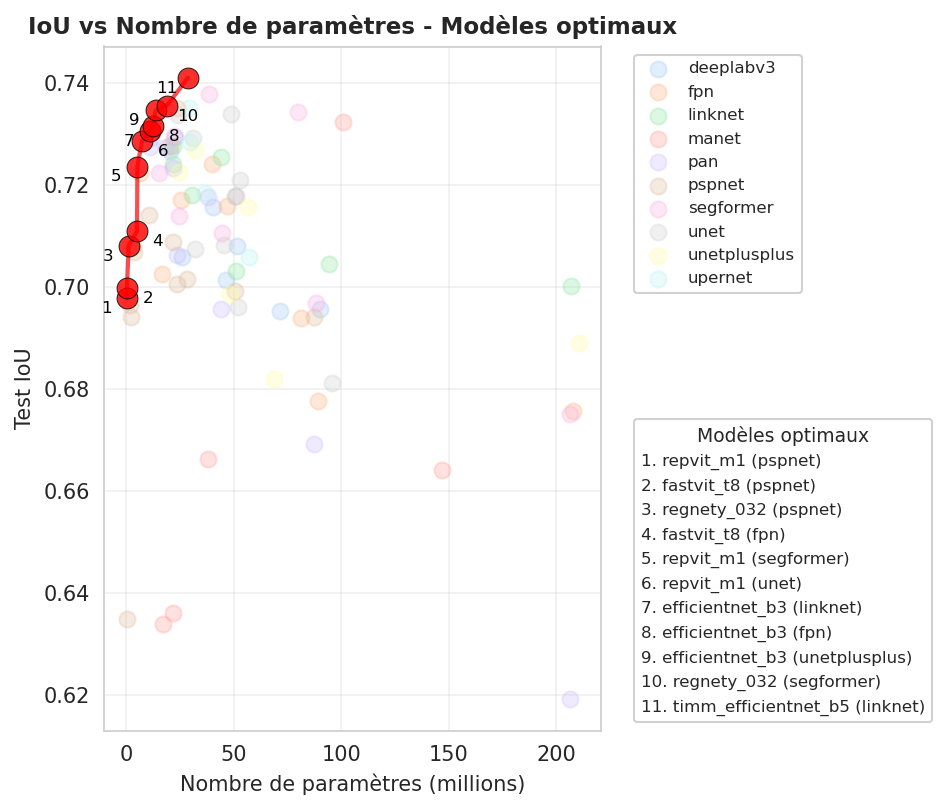

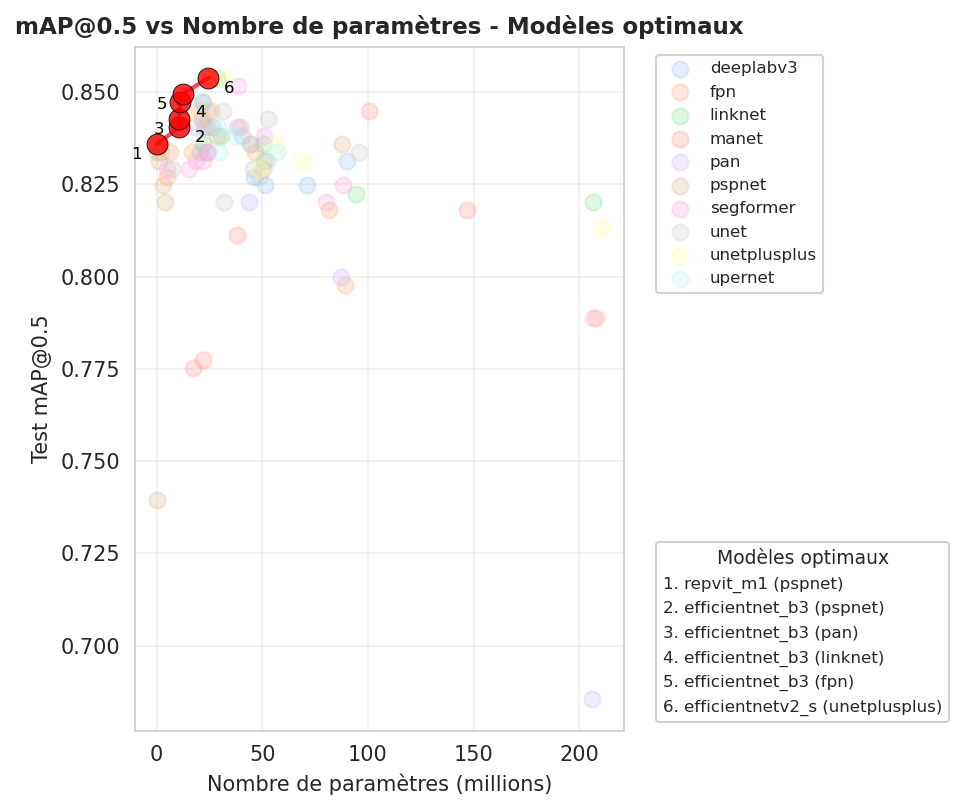

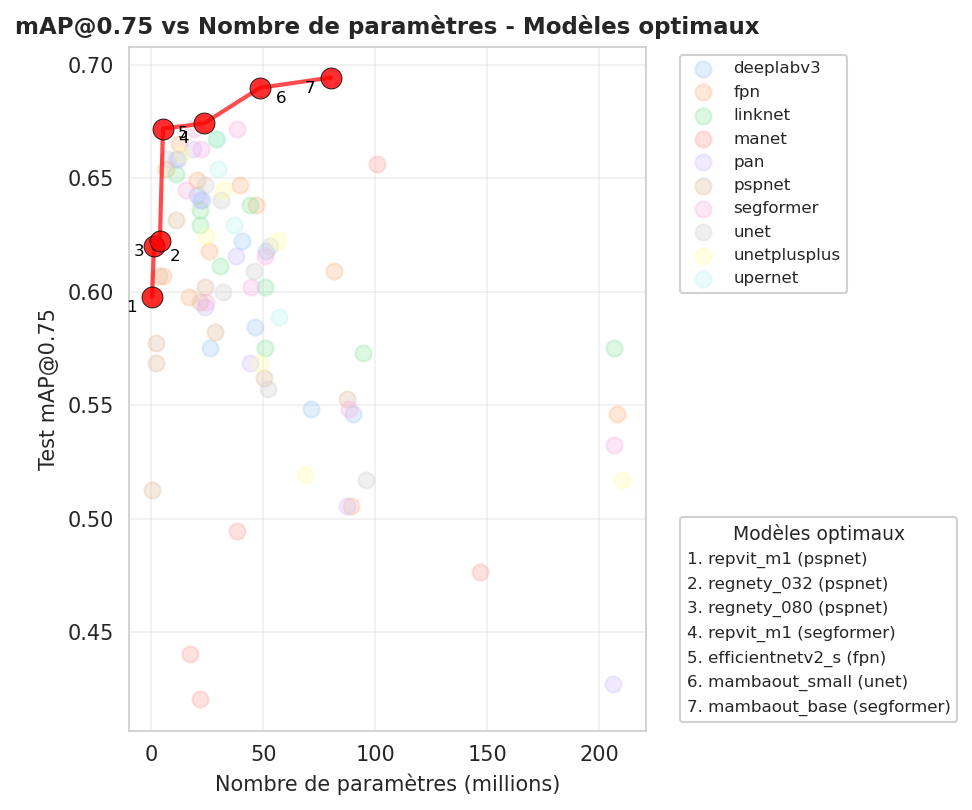

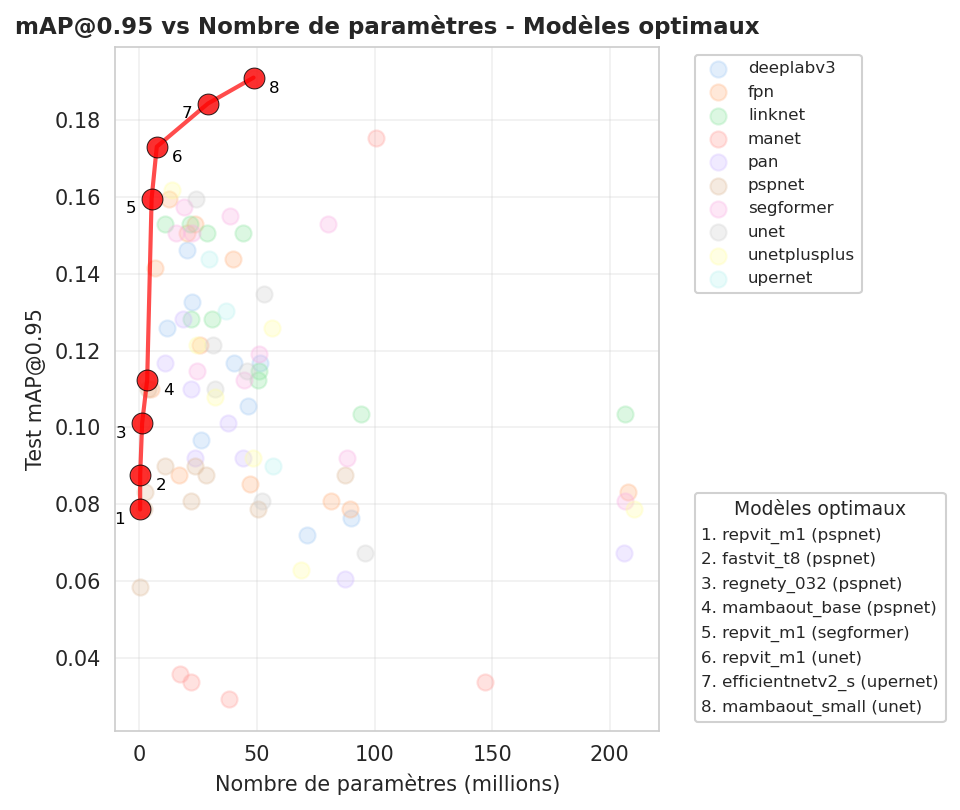

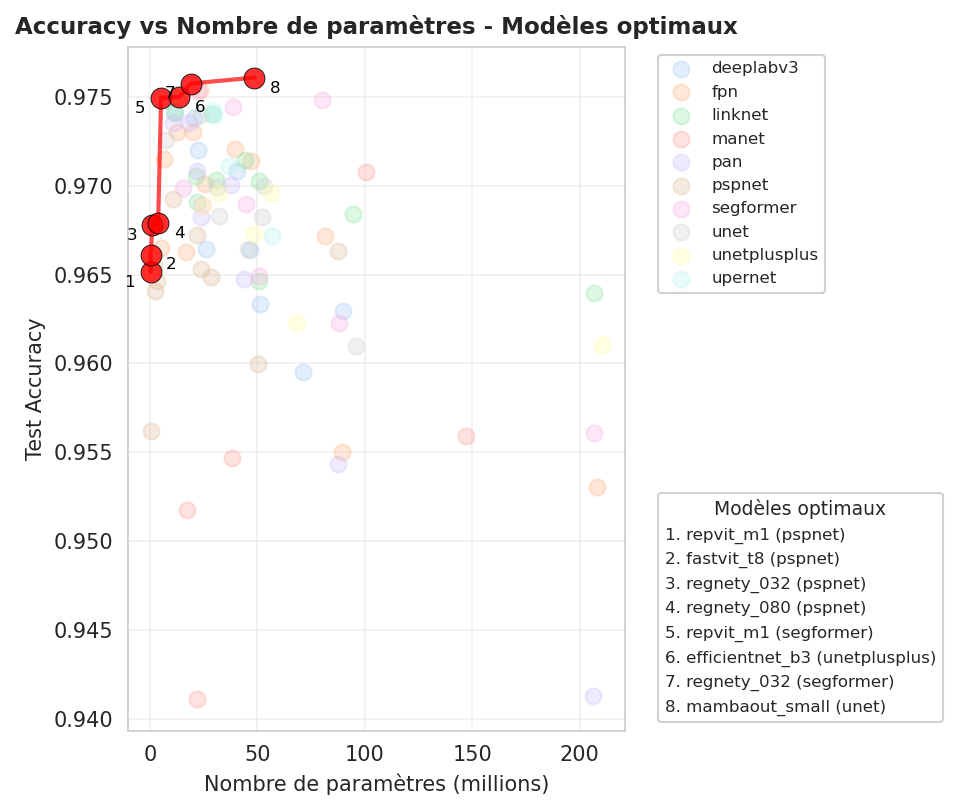

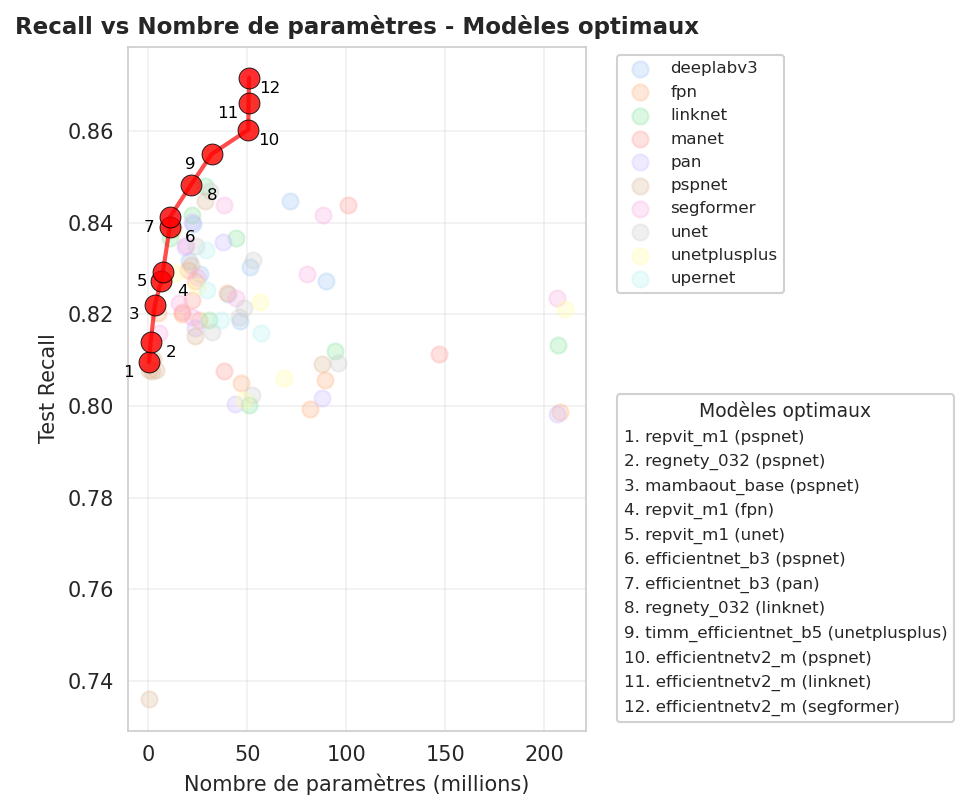

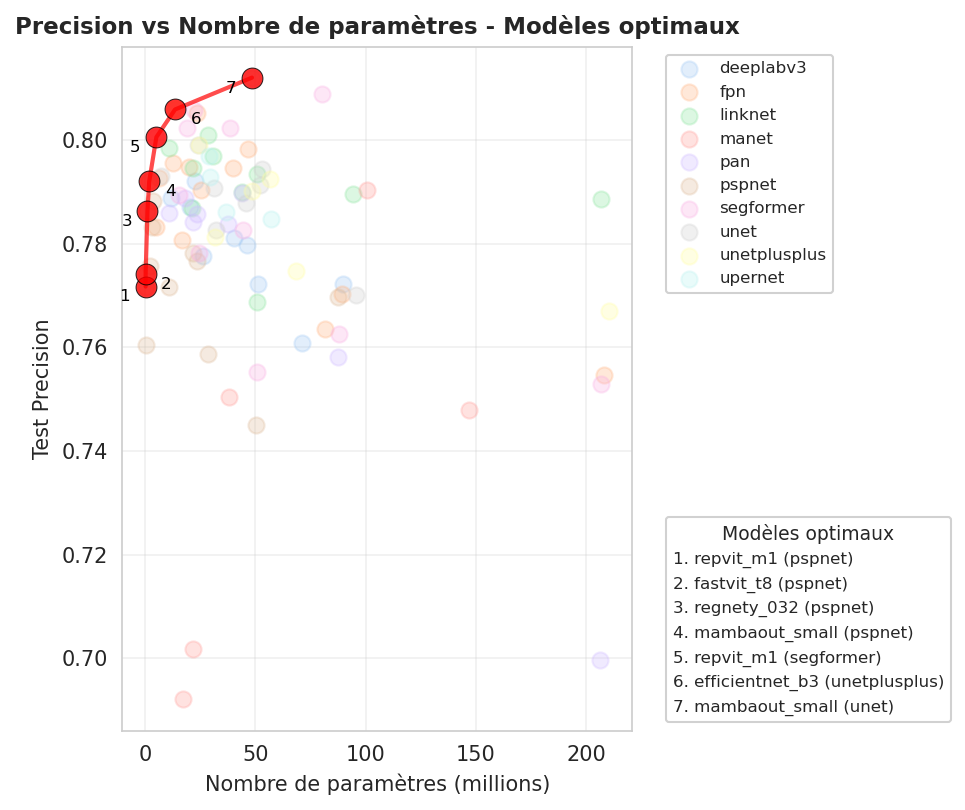

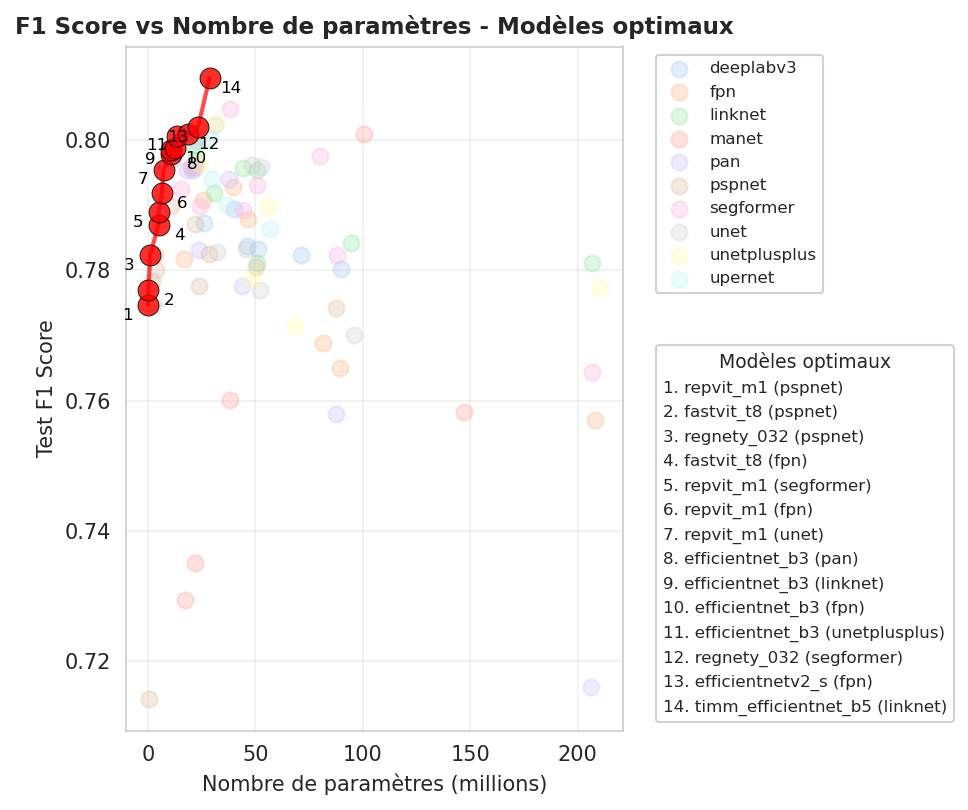

In [ ]:
def plot_performance_vs_parameters_pareto(df_models, performance_metric='eval_test_iou_mean', save_path=None):
    """Plot model performance vs number of parameters, highlighting Pareto-optimal models with numbered annotations.

    Args:
        df_models (pd.DataFrame): DataFrame containing model results.
        performance_metric (str): Column name for the performance metric to plot.
        save_path (str, optional): Directory to save the plot. If None, the plot is not saved.
    """
    set_plot_style()
    
    fig, ax = plt.subplots(1, 1, figsize=(6.5, 5.5))
    
    if 'num_params_M' in df_models.columns and 'architecture' in df_models.columns:
        # Select required columns based on availability
        required_cols = [performance_metric, 'num_params_M', 'architecture', 'config_']
        if 'backbone' in df_models.columns:
            required_cols.append('backbone')
        scatter_data = df_models[required_cols].dropna()
        
        if len(scatter_data) > 0:
            # Plot all models with low opacity for context
            for i, arch in enumerate(scatter_data['architecture'].unique()):
                arch_data = scatter_data[scatter_data['architecture'] == arch]
                ax.scatter(arch_data['num_params_M'], 
                          arch_data[performance_metric], 
                          label=arch, alpha=0.3, s=60)
            
            # Identify Pareto-optimal models (not dominated by others)
            pareto_models = []
            for idx, row in scatter_data.iterrows():
                is_pareto = True
                for idx2, row2 in scatter_data.iterrows():
                    if idx != idx2:
                        # A model is dominated if another has better or equal performance and fewer or equal parameters,
                        # and is strictly better in at least one criterion
                        if (row2[performance_metric] >= row[performance_metric] and 
                            row2['num_params_M'] <= row['num_params_M'] and
                            (row2[performance_metric] > row[performance_metric] or 
                             row2['num_params_M'] < row['num_params_M'])):
                            is_pareto = False
                            break
                if is_pareto:
                    pareto_models.append(idx)
            
            # Prepare Pareto-optimal data for plotting
            pareto_data = scatter_data.loc[pareto_models].sort_values('num_params_M')
            
            # Draw line connecting Pareto-optimal models
            ax.plot(pareto_data['num_params_M'], 
                   pareto_data[performance_metric], 
                   'r-', linewidth=2, alpha=0.7)
            
            # Highlight Pareto-optimal points
            ax.scatter(pareto_data['num_params_M'], 
                      pareto_data[performance_metric], 
                      color='red', s=100, zorder=5, edgecolors='black', linewidth=0.5, alpha=0.8)
            
            # Prepare legend text for Pareto-optimal models
            model_legend_text = []
            
            # Annotate Pareto-optimal models with numbers
            for i, (_, row) in enumerate(pareto_data.iterrows(), 1):
                config_name = str(row['config_'])
                if '_' in config_name:
                    config_name = '_'.join(config_name.split('_')[1:])
                config_name = config_name.replace('_imagenet', '')
                decoder = row['architecture']
                
                # Alternate annotation position for readability
                offset_x = -10 if i % 2 == 1 else 10
                ax.annotate(str(i), 
                           xy=(row['num_params_M'], row[performance_metric]),
                           xytext=(offset_x, -5), textcoords='offset points',
                           fontsize=8,
                           ha='center', va='center',
                           color='black', zorder=10,)
                
                model_legend_text.append(f"{i}. {config_name} ({decoder})")
            
            # Set axis labels and plot title based on metric
            ax.set_xlabel("Nombre de paramètres (millions)", fontsize=10)
            
            if performance_metric == 'eval_test_iou_mean':
                ax.set_ylabel('Test IoU', fontsize=10)
                ax.set_title("IoU vs Nombre de paramètres - Modèles optimaux", fontsize=11, fontweight='bold')
                graphic_number = "01"
                legend_y = 0.00
            elif performance_metric == 'eval_test_map_50_mean':
                ax.set_ylabel('Test mAP@0.5', fontsize=10)
                ax.set_title("mAP@0.5 vs Nombre de paramètres - Modèles optimaux", fontsize=11, fontweight='bold')
                graphic_number = "02"
                legend_y = 0.00
            elif performance_metric == 'eval_test_map_75_mean':
                ax.set_ylabel('Test mAP@0.75', fontsize=10)
                ax.set_title("mAP@0.75 vs Nombre de paramètres - Modèles optimaux", fontsize=11, fontweight='bold')
                graphic_number = "03"
                legend_y = 0.00
            elif performance_metric == 'eval_test_map_95_mean':
                ax.set_ylabel('Test mAP@0.95', fontsize=10)
                ax.set_title("mAP@0.95 vs Nombre de paramètres - Modèles optimaux", fontsize=11, fontweight='bold')
                graphic_number = "04"
                legend_y = 0.00
            elif performance_metric == 'eval_test_accuracy_mean':
                ax.set_ylabel('Test Accuracy', fontsize=10)
                ax.set_title("Accuracy vs Nombre de paramètres - Modèles optimaux", fontsize=11, fontweight='bold')
                graphic_number = "05"
                legend_y = 0.00
            elif performance_metric == 'eval_test_recall_mean':
                ax.set_ylabel('Test Recall', fontsize=10)
                ax.set_title("Recall vs Nombre de paramètres - Modèles optimaux", fontsize=11, fontweight='bold')
                graphic_number = "06"
                legend_y = 0.00
            elif performance_metric == 'eval_test_precision_mean':
                ax.set_ylabel('Test Precision', fontsize=10)
                ax.set_title("Precision vs Nombre de paramètres - Modèles optimaux", fontsize=11, fontweight='bold')
                graphic_number = "07"
                legend_y = 0.00
            elif performance_metric == 'eval_test_f1_score_mean':
                ax.set_ylabel('Test F1 Score', fontsize=10)
                ax.set_title("F1 Score vs Nombre de paramètres - Modèles optimaux", fontsize=11, fontweight='bold')
                graphic_number = "08"
                legend_y = 0.00
            
            # Create legend for architectures
            handles, labels = ax.get_legend_handles_labels()
            legend1 = ax.legend(handles, labels,
                               bbox_to_anchor=(1.05, 1), loc='upper left', 
                               fontsize=8, framealpha=0.9)
            ax.add_artist(legend1)
            
            # Add legend for Pareto-optimal models
            if model_legend_text:
                from matplotlib.patches import Rectangle
                extra = Rectangle((0, 0), 1, 1, fc="w", fill=False, edgecolor='none', linewidth=0)
                legend2 = ax.legend([extra]*len(model_legend_text), model_legend_text,
                                  title='Modèles optimaux', title_fontsize=9,
                                  bbox_to_anchor=(1.05, legend_y), loc='lower left',
                                  fontsize=8, framealpha=0.9,
                                  handlelength=0, handletextpad=0)
            
            ax.grid(True, alpha=0.3)
    
    plt.tight_layout()
    if save_path:
        plt.savefig(f"{save_path}/ch4_09_performance_vs_parameters_pareto_{graphic_number}_{performance_metric}.png", 
                   dpi=300, bbox_inches='tight')
    plt.show()

plot_performance_vs_parameters_pareto(df_model_results_clean_concat_yolo_smp, performance_metric='eval_test_iou_mean', save_path=GRAPHICS_PATH)
plot_performance_vs_parameters_pareto(df_model_results_clean_concat_yolo_smp, performance_metric='eval_test_map_50_mean', save_path=GRAPHICS_PATH)
plot_performance_vs_parameters_pareto(df_model_results_clean_concat_yolo_smp, performance_metric='eval_test_map_75_mean', save_path=GRAPHICS_PATH)
plot_performance_vs_parameters_pareto(df_model_results_clean_concat_yolo_smp, performance_metric='eval_test_map_95_mean', save_path=GRAPHICS_PATH)
plot_performance_vs_parameters_pareto(df_model_results_clean_concat_yolo_smp, performance_metric='eval_test_accuracy_mean', save_path=GRAPHICS_PATH)
plot_performance_vs_parameters_pareto(df_model_results_clean_concat_yolo_smp, performance_metric='eval_test_recall_mean', save_path=GRAPHICS_PATH)
plot_performance_vs_parameters_pareto(df_model_results_clean_concat_yolo_smp, performance_metric='eval_test_precision_mean', save_path=GRAPHICS_PATH)
plot_performance_vs_parameters_pareto(df_model_results_clean_concat_yolo_smp, performance_metric='eval_test_f1_score_mean', save_path=GRAPHICS_PATH)


### pareto ioui vs f1-score

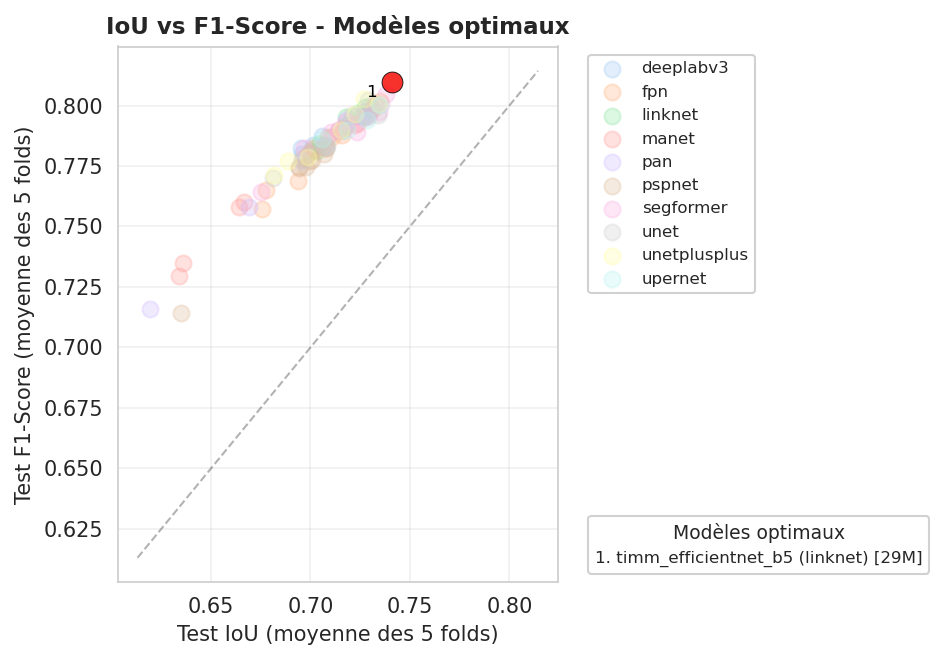

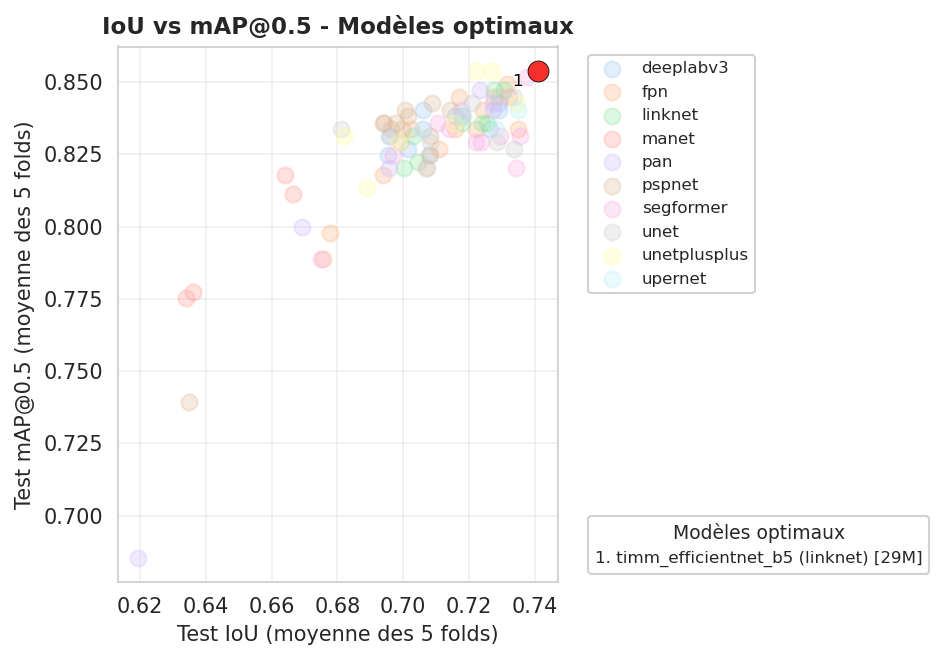

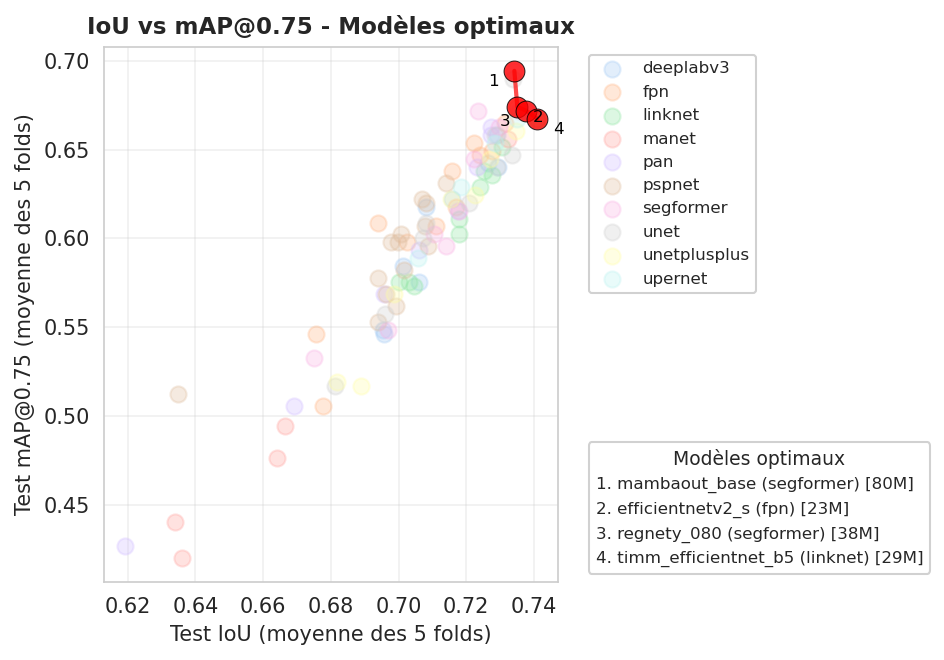

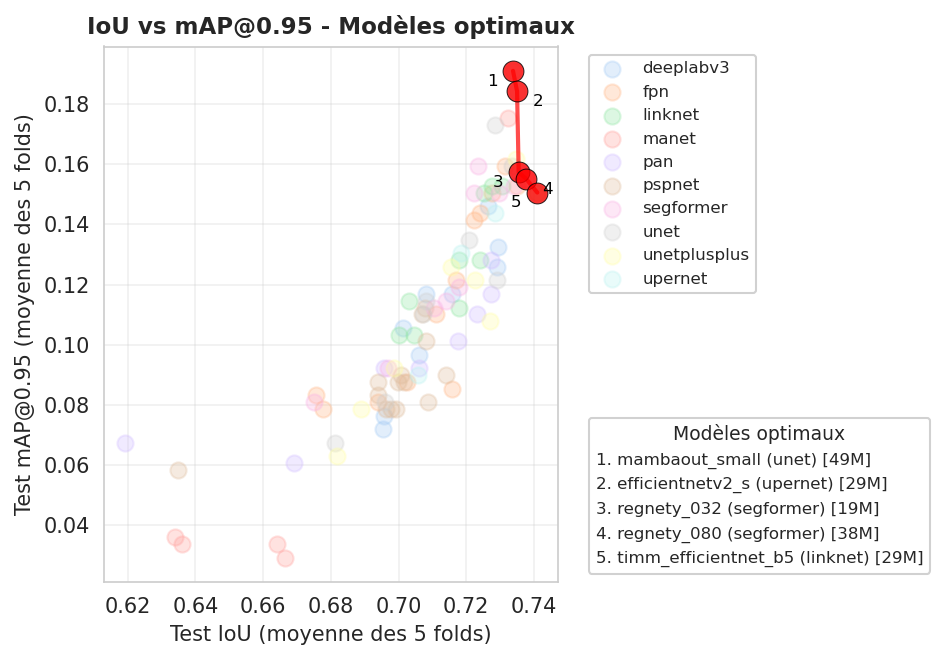

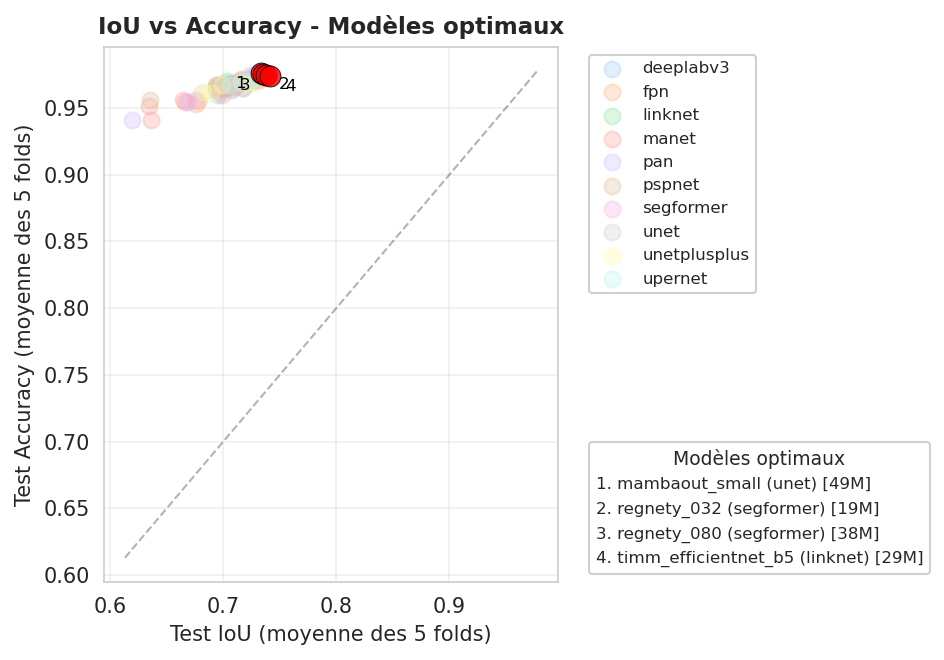

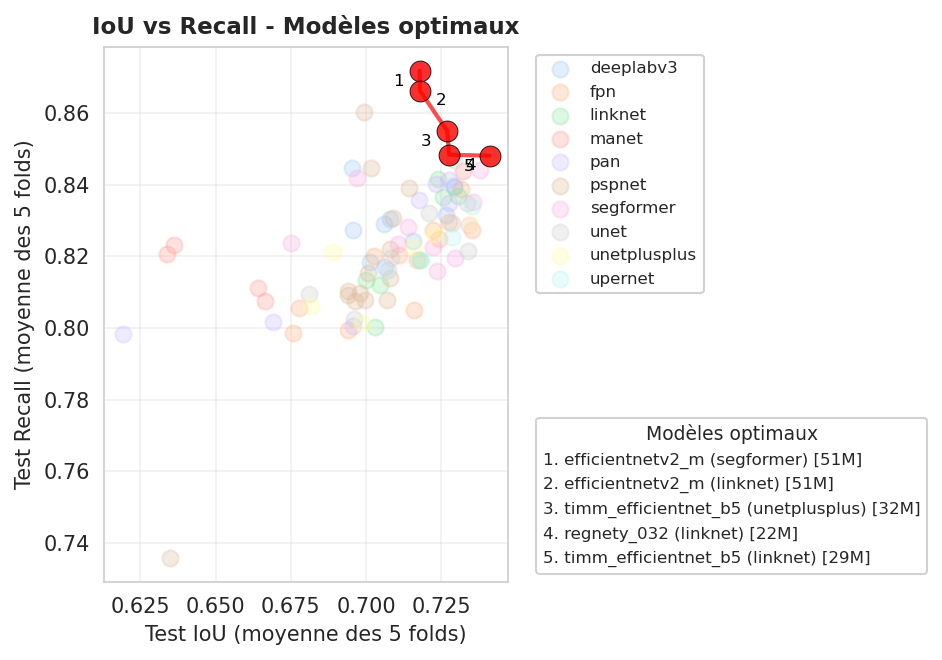

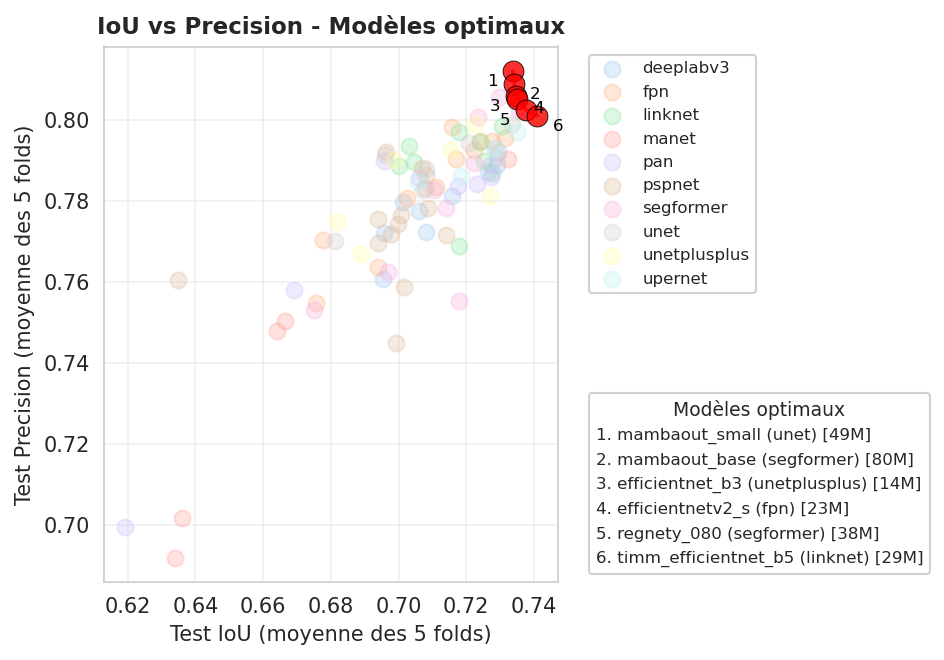

In [ ]:
def plot_iou_vs_metric_pareto(df_models, second_metric='eval_test_f1_score_mean', save_path=None):
    """Plot IoU vs another metric with Pareto frontier and numbered annotations.

    Args:
        df_models (pd.DataFrame): DataFrame containing model results.
        second_metric (str): The secondary metric to plot against IoU.
        save_path (str, optional): Directory to save the plot. If None, the plot is not saved.
    """
    set_plot_style()
    fig, ax = plt.subplots(1, 1, figsize=(6.5, 4.5))
    iou_metric = 'eval_test_iou_mean'

    if iou_metric in df_models.columns and second_metric in df_models.columns and 'architecture' in df_models.columns:
        # Select required columns and remove rows with missing values
        required_cols = [iou_metric, second_metric, 'architecture', 'config_', 'num_params_M']
        scatter_data = df_models[required_cols].dropna()

        if len(scatter_data) > 0:
            # Plot all models with low opacity for context
            for i, arch in enumerate(scatter_data['architecture'].unique()):
                arch_data = scatter_data[scatter_data['architecture'] == arch]
                ax.scatter(arch_data[iou_metric], 
                          arch_data[second_metric], 
                          label=arch, alpha=0.3, s=60)

            # Identify Pareto-optimal models (not dominated by others)
            pareto_models = []
            for idx, row in scatter_data.iterrows():
                is_pareto = True
                for idx2, row2 in scatter_data.iterrows():
                    if idx != idx2:
                        # A model is dominated if another model is better in both metrics
                        if (row2[iou_metric] >= row[iou_metric] and 
                            row2[second_metric] >= row[second_metric] and
                            (row2[iou_metric] > row[iou_metric] or 
                             row2[second_metric] > row[second_metric])):
                            is_pareto = False
                            break
                if is_pareto:
                    pareto_models.append(idx)

            # Prepare Pareto frontier data
            pareto_data = scatter_data.loc[pareto_models].sort_values(iou_metric)

            # Draw Pareto frontier line
            ax.plot(pareto_data[iou_metric], 
                   pareto_data[second_metric], 
                   'r-', linewidth=2, alpha=0.7)

            # Highlight Pareto-optimal points
            ax.scatter(pareto_data[iou_metric], 
                      pareto_data[second_metric], 
                      color='red', s=100, zorder=5, edgecolors='black', linewidth=0.5, alpha=0.8)

            # Prepare legend text for Pareto models
            model_legend_text = []

            # Annotate Pareto models with numbers
            for i, (_, row) in enumerate(pareto_data.iterrows(), 1):
                config_name = str(row['config_'])
                if '_' in config_name:
                    config_name = '_'.join(config_name.split('_')[1:])
                config_name = config_name.replace('_imagenet', '')
                decoder = row['architecture']
                params = row['num_params_M']

                # Alternate annotation position for clarity
                offset_x = -10 if i % 2 == 1 else 10
                ax.annotate(str(i), 
                           xy=(row[iou_metric], row[second_metric]),
                           xytext=(offset_x, -5), textcoords='offset points',
                           fontsize=8,
                           ha='center', va='center',
                           color='black', zorder=10,)

                # Add model details to legend
                model_legend_text.append(f"{i}. {config_name} ({decoder}) [{params:.0f}M]")

            # Set axis labels and plot title based on the selected metric
            ax.set_xlabel("Test IoU (moyenne des 5 folds)", fontsize=10)
            if second_metric == 'eval_test_f1_score_mean':
                ax.set_ylabel('Test F1-Score (moyenne des 5 folds)', fontsize=10)
                ax.set_title("IoU vs F1-Score - Modèles optimaux", fontsize=11, fontweight='bold')
                graphic_number = "01"
            elif second_metric == 'eval_test_map_50_mean':
                ax.set_ylabel('Test mAP@0.5 (moyenne des 5 folds)', fontsize=10)
                ax.set_title("IoU vs mAP@0.5 - Modèles optimaux", fontsize=11, fontweight='bold')
                graphic_number = "02"
            elif second_metric == 'eval_test_map_75_mean':
                ax.set_ylabel('Test mAP@0.75 (moyenne des 5 folds)', fontsize=10)
                ax.set_title("IoU vs mAP@0.75 - Modèles optimaux", fontsize=11, fontweight='bold')
                graphic_number = "03"
            elif second_metric == 'eval_test_map_95_mean':
                ax.set_ylabel('Test mAP@0.95 (moyenne des 5 folds)', fontsize=10)
                ax.set_title("IoU vs mAP@0.95 - Modèles optimaux", fontsize=11, fontweight='bold')
                graphic_number = "04"
            elif second_metric == 'eval_test_accuracy_mean':
                ax.set_ylabel('Test Accuracy (moyenne des 5 folds)', fontsize=10)
                ax.set_title("IoU vs Accuracy - Modèles optimaux", fontsize=11, fontweight='bold')
                graphic_number = "05"
            elif second_metric == 'eval_test_recall_mean':
                ax.set_ylabel('Test Recall (moyenne des 5 folds)', fontsize=10)
                ax.set_title("IoU vs Recall - Modèles optimaux", fontsize=11, fontweight='bold')
                graphic_number = "06"
            elif second_metric == 'eval_test_precision_mean':
                ax.set_ylabel('Test Precision (moyenne des 5 folds)', fontsize=10)
                ax.set_title("IoU vs Precision - Modèles optimaux", fontsize=11, fontweight='bold')
                graphic_number = "07"
            else:
                # Generic label for other metrics
                metric_name = second_metric.replace('eval_test_', '').replace('_mean', '').replace('_', ' ').title()
                ax.set_ylabel(f'Test {metric_name} (moyenne des 5 folds)', fontsize=10)
                ax.set_title(f"IoU vs {metric_name} - Modèles optimaux", fontsize=11, fontweight='bold')
                graphic_number = "99"

            # Add diagonal reference line if metrics are comparable
            if second_metric in ['eval_test_f1_score_mean', 'eval_test_accuracy_mean']:
                min_val = min(ax.get_xlim()[0], ax.get_ylim()[0])
                max_val = max(ax.get_xlim()[1], ax.get_ylim()[1])
                ax.plot([min_val, max_val], [min_val, max_val], 'k--', alpha=0.3, linewidth=1)

            # Add legend for architectures
            handles, labels = ax.get_legend_handles_labels()
            legend1 = ax.legend(handles, labels,
                               bbox_to_anchor=(1.05, 1), loc='upper left', 
                               fontsize=8, framealpha=0.9)
            ax.add_artist(legend1)

            # Add legend for Pareto-optimal models
            if model_legend_text:
                from matplotlib.patches import Rectangle
                extra = Rectangle((0, 0), 1, 1, fc="w", fill=False, edgecolor='none', linewidth=0)
                legend2 = ax.legend([extra]*len(model_legend_text), model_legend_text,
                                  title='Modèles optimaux', title_fontsize=9,
                                  bbox_to_anchor=(1.05, 0.00), loc='lower left',
                                  fontsize=8, framealpha=0.9,
                                  handlelength=0, handletextpad=0)

            ax.grid(True, alpha=0.3)

    plt.tight_layout()
    if save_path:
        plt.savefig(f"{save_path}/ch4_10_{graphic_number}_iou_vs_{second_metric}.png", 
                   dpi=300, bbox_inches='tight')
    plt.show()


# Example usage for different metrics
plot_iou_vs_metric_pareto(df_model_results_clean_concat_yolo_smp, second_metric='eval_test_f1_score_mean', save_path=GRAPHICS_PATH)
plot_iou_vs_metric_pareto(df_model_results_clean_concat_yolo_smp, second_metric='eval_test_map_50_mean', save_path=GRAPHICS_PATH)
plot_iou_vs_metric_pareto(df_model_results_clean_concat_yolo_smp, second_metric='eval_test_map_75_mean', save_path=GRAPHICS_PATH)
plot_iou_vs_metric_pareto(df_model_results_clean_concat_yolo_smp, second_metric='eval_test_map_95_mean', save_path=GRAPHICS_PATH)
plot_iou_vs_metric_pareto(df_model_results_clean_concat_yolo_smp, second_metric='eval_test_accuracy_mean', save_path=GRAPHICS_PATH)
plot_iou_vs_metric_pareto(df_model_results_clean_concat_yolo_smp, second_metric='eval_test_recall_mean', save_path=GRAPHICS_PATH)
plot_iou_vs_metric_pareto(df_model_results_clean_concat_yolo_smp, second_metric='eval_test_precision_mean', save_path=GRAPHICS_PATH)


### Distribution temps entrainement

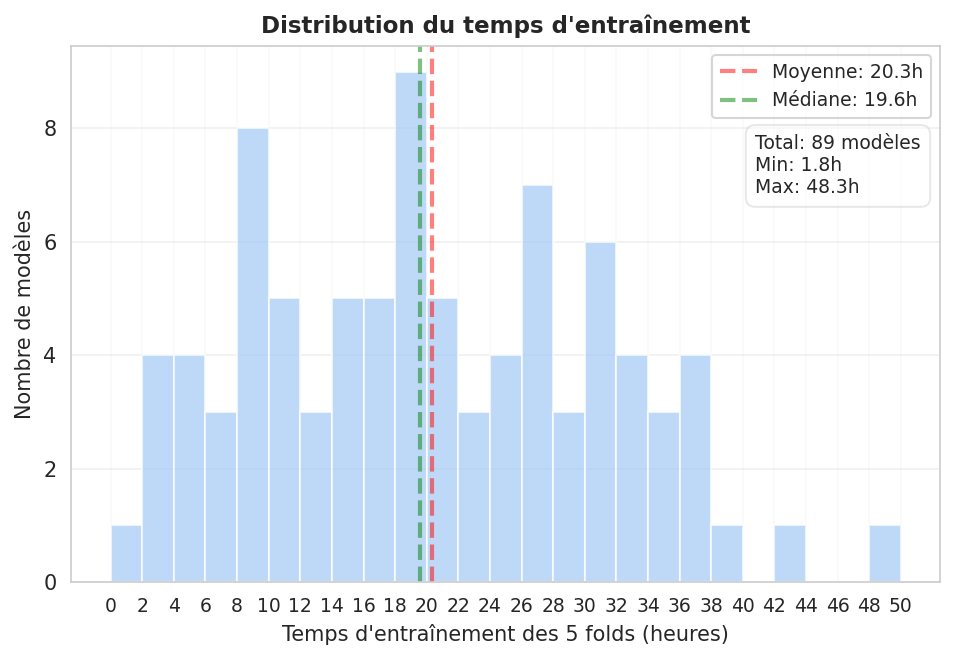

In [ ]:
def plot_training_time_distribution(df_models, save_path=None):
    """Plot a histogram showing the distribution of training times (in hours) for all models, using 2-hour bins."""
    set_plot_style()
    
    fig, ax = plt.subplots(1, 1, figsize=(6.5, 4.5))
    
    if 'total_training_time_hour' in df_models.columns:
        valid_times = df_models['total_training_time_hour'].dropna()
        if len(valid_times) > 0:
            # Define histogram bins every 2 hours, covering the full range of training times
            max_time = valid_times.max()
            min_time = valid_times.min()
            max_bin = int(np.ceil(max_time / 2) * 2)
            min_bin = int(np.floor(min_time / 2) * 2)
            bins = np.arange(min_bin, max_bin + 2, 2)
            
            # Plot the histogram of training times
            n, bins, patches = ax.hist(valid_times, bins=bins, alpha=0.7, 
                                       edgecolor='white', linewidth=1)
            
            # Draw a vertical line for the mean training time
            mean_val = valid_times.mean()
            ax.axvline(mean_val, color='red', linestyle='--', linewidth=2, alpha=0.5,
                       label=f'Moyenne: {mean_val:.1f}h')
            
            # Draw a vertical line for the median training time
            median_val = valid_times.median()
            ax.axvline(median_val, color='green', linestyle='--', linewidth=2, alpha=0.5,
                       label=f'Médiane: {median_val:.1f}h')
            
            # Set plot title and axis labels
            ax.set_title("Distribution du temps d'entraînement", fontsize=11, fontweight='bold')
            ax.set_xlabel("Temps d'entraînement des 5 folds (heures)", fontsize=10)
            ax.set_ylabel('Nombre de modèles', fontsize=10)
            
            # Set x-axis ticks to match bin edges
            ax.set_xticks(bins)
            ax.set_xticklabels([f'{int(b)}' for b in bins], fontsize=9)
            
            # Add grid lines for readability
            ax.grid(True, alpha=0.3, axis='y')
            ax.grid(True, alpha=0.1, axis='x')
            
            # Show legend for mean and median lines
            ax.legend(fontsize=9, loc='upper right')
            
            # Display summary statistics in a text box
            stats_text = f'Total: {len(valid_times)} modèles\n'
            stats_text += f'Min: {valid_times.min():.1f}h\n'
            stats_text += f'Max: {valid_times.max():.1f}h'
            ax.text(0.787, 0.835, stats_text, transform=ax.transAxes, 
                    fontsize=9, verticalalignment='top',
                    bbox=dict(boxstyle='round,pad=0.5', facecolor='white', alpha=0.5,
                              edgecolor='lightgray', zorder=10))
    
    plt.tight_layout()
    if save_path:
        plt.savefig(f"{save_path}/ch4_11_training_time_dist_09.png", dpi=300, bbox_inches='tight')
    plt.show()

# Example usage
plot_training_time_distribution(df_model_results_clean, save_path=GRAPHICS_PATH)


## Analyse

### top 10 iou

In [ ]:
# Display the top 10 models ranked by mean IoU, showing key metrics and characteristics in LaTeX format
df_model_results_clean_concat_yolo_smp.sort_values('eval_test_iou_mean', ascending=False).head(10)[
	["config", "eval_test_iou_mean", "eval_test_f1_score_mean", "eval_test_map_50_mean", "eval_test_map_75_mean", "eval_test_map_95_mean", "num_params_M", "total_training_time_hour"]
].reset_index(drop=True).to_latex()

'\\begin{tabular}{llrrrrrrr}\n\\toprule\n & config & eval_test_iou_mean & eval_test_f1_score_mean & eval_test_map_50_mean & eval_test_map_75_mean & eval_test_map_95_mean & num_params_M & total_training_time_hour \\\\\n\\midrule\n0 & linknet_timm_efficientnet_b5_imagenet & 0.740986 & 0.809570 & 0.853933 & 0.667416 & 0.150562 & 28.746348 & 18.109806 \\\\\n1 & segformer_regnety_080_imagenet & 0.737744 & 0.804696 & 0.851685 & 0.671910 & 0.155056 & 38.406174 & 9.289725 \\\\\n2 & segformer_regnety_032_imagenet & 0.735484 & 0.800839 & 0.831461 & 0.671910 & 0.157303 & 18.871028 & 30.618504 \\\\\n3 & fpn_efficientnetv2_s_imagenet & 0.735073 & 0.801985 & 0.833708 & 0.674157 & 0.152809 & 23.421786 & 19.557488 \\\\\n4 & upernet_efficientnetv2_s_imagenet & 0.735004 & 0.800284 & 0.840449 & 0.667416 & 0.184270 & 29.127962 & 27.754554 \\\\\n5 & unetplusplus_efficientnet_b3_imagenet & 0.734564 & 0.800675 & 0.842697 & 0.660674 & 0.161798 & 13.625178 & 31.276592 \\\\\n6 & segformer_mambaout_base_imagenet

### moyennes générales

In [ ]:
# Print mean values for key metrics across all models
print("Mean IoU of all models:", df_model_results_clean_concat_yolo_smp['eval_test_iou_mean'].mean())
print("Mean F1 Score of all models:", df_model_results_clean_concat_yolo_smp['eval_test_f1_score_mean'].mean())
print("Mean mAP@0.5 of all models:", df_model_results_clean_concat_yolo_smp['eval_test_map_50_mean'].mean())
print("Mean mAP@0.75 of all models:", df_model_results_clean_concat_yolo_smp['eval_test_map_75_mean'].mean())
print("Mean mAP@0.95 of all models:", df_model_results_clean_concat_yolo_smp['eval_test_map_95_mean'].mean())
print("Mean Accuracy of all models:", df_model_results_clean_concat_yolo_smp['eval_test_accuracy_mean'].mean())
print("Mean Recall of all models:", df_model_results_clean_concat_yolo_smp['eval_test_recall_mean'].mean())
print("Mean Precision of all models:", df_model_results_clean_concat_yolo_smp['eval_test_precision_mean'].mean())

# Print summary statistics for each metric in LaTeX table format
print(f"IoU & {df_model_results_clean_concat_yolo_smp['eval_test_iou_mean'].mean():.3f} \\pm {df_model_results_clean_concat_yolo_smp['eval_test_iou_mean'].std():.3f} & {df_model_results_clean_concat_yolo_smp['eval_test_iou_mean'].median():.3f} & {df_model_results_clean_concat_yolo_smp['eval_test_iou_mean'].min():.3f} & {df_model_results_clean_concat_yolo_smp['eval_test_iou_mean'].max():.3f} \\\\")
print(f"F1 Score & {df_model_results_clean_concat_yolo_smp['eval_test_f1_score_mean'].mean():.3f} \\pm {df_model_results_clean_concat_yolo_smp['eval_test_f1_score_mean'].std():.3f} & {df_model_results_clean_concat_yolo_smp['eval_test_f1_score_mean'].median():.3f} & {df_model_results_clean_concat_yolo_smp['eval_test_f1_score_mean'].min():.3f} & {df_model_results_clean_concat_yolo_smp['eval_test_f1_score_mean'].max():.3f} \\\\")
print(f"mAP@0.5 & {df_model_results_clean_concat_yolo_smp['eval_test_map_50_mean'].mean():.3f} \\pm {df_model_results_clean_concat_yolo_smp['eval_test_map_50_mean'].std():.3f} & {df_model_results_clean_concat_yolo_smp['eval_test_map_50_mean'].median():.3f} & {df_model_results_clean_concat_yolo_smp['eval_test_map_50_mean'].min():.3f} & {df_model_results_clean_concat_yolo_smp['eval_test_map_50_mean'].max():.3f} \\\\")
print(f"mAP@0.75 & {df_model_results_clean_concat_yolo_smp['eval_test_map_75_mean'].mean():.3f} \\pm {df_model_results_clean_concat_yolo_smp['eval_test_map_75_mean'].std():.3f} & {df_model_results_clean_concat_yolo_smp['eval_test_map_75_mean'].median():.3f} & {df_model_results_clean_concat_yolo_smp['eval_test_map_75_mean'].min():.3f} & {df_model_results_clean_concat_yolo_smp['eval_test_map_75_mean'].max():.3f} \\\\")
print(f"mAP@0.95 & {df_model_results_clean_concat_yolo_smp['eval_test_map_95_mean'].mean():.3f} \\pm {df_model_results_clean_concat_yolo_smp['eval_test_map_95_mean'].std():.3f} & {df_model_results_clean_concat_yolo_smp['eval_test_map_95_mean'].median():.3f} & {df_model_results_clean_concat_yolo_smp['eval_test_map_95_mean'].min():.3f} & {df_model_results_clean_concat_yolo_smp['eval_test_map_95_mean'].max():.3f} \\\\")
print(f"Accuracy & {df_model_results_clean_concat_yolo_smp['eval_test_accuracy_mean'].mean():.3f} \\pm {df_model_results_clean_concat_yolo_smp['eval_test_accuracy_mean'].std():.3f} & {df_model_results_clean_concat_yolo_smp['eval_test_accuracy_mean'].median():.3f} & {df_model_results_clean_concat_yolo_smp['eval_test_accuracy_mean'].min():.3f} & {df_model_results_clean_concat_yolo_smp['eval_test_accuracy_mean'].max():.3f} \\\\")
print(f"Recall & {df_model_results_clean_concat_yolo_smp['eval_test_recall_mean'].mean():.3f} \\pm {df_model_results_clean_concat_yolo_smp['eval_test_recall_mean'].std():.3f} & {df_model_results_clean_concat_yolo_smp['eval_test_recall_mean'].median():.3f} & {df_model_results_clean_concat_yolo_smp['eval_test_recall_mean'].min():.3f} & {df_model_results_clean_concat_yolo_smp['eval_test_recall_mean'].max():.3f} \\\\")
print(f"Precision & {df_model_results_clean_concat_yolo_smp['eval_test_precision_mean'].mean():.3f} \\pm {df_model_results_clean_concat_yolo_smp['eval_test_precision_mean'].std():.3f} & {df_model_results_clean_concat_yolo_smp['eval_test_precision_mean'].median():.3f} & {df_model_results_clean_concat_yolo_smp['eval_test_precision_mean'].min():.3f} & {df_model_results_clean_concat_yolo_smp['eval_test_precision_mean'].max():.3f} \\\\")
print(f"Number of parameters & {df_model_results_clean_concat_yolo_smp['num_params_M'].mean():.3f} \\pm {df_model_results_clean_concat_yolo_smp['num_params_M'].std():.3f} & {df_model_results_clean_concat_yolo_smp['num_params_M'].median():.3f} & {df_model_results_clean_concat_yolo_smp['num_params_M'].min():.3f} & {df_model_results_clean_concat_yolo_smp['num_params_M'].max():.3f} \\\\")
print(f"Training time (hours) & {df_model_results_clean_concat_yolo_smp['total_training_time_hour'].mean():.3f} \\pm {df_model_results_clean_concat_yolo_smp['total_training_time_hour'].std():.3f} & {df_model_results_clean_concat_yolo_smp['total_training_time_hour'].median():.3f} & {df_model_results_clean_concat_yolo_smp['total_training_time_hour'].min():.3f} & {df_model_results_clean_concat_yolo_smp['total_training_time_hour'].max():.3f} \\\\")

Mean IoU of all models: 0.7083280399691112
Mean F1 Score of all models: 0.7748517241783673
Mean mAP@0.5 of all models: 0.8179411493788584
Mean mAP@0.75 of all models: 0.5919965552013917
Mean mAP@0.95 of all models: 0.1094380946488003
Mean Accuracy of all models: 0.9458732047289545
Mean Recall of all models: 0.8157461048335117
Mean Precision of all models: 0.77273978763861
IoU & 0.708 \pm 0.024 & 0.711 & 0.619 & 0.741 \
F1 Score & 0.775 \pm 0.048 & 0.787 & 0.544 & 0.810 \
mAP@0.5 & 0.818 \pm 0.056 & 0.834 & 0.556 & 0.854 \
mAP@0.75 & 0.592 \pm 0.073 & 0.609 & 0.347 & 0.694 \
mAP@0.95 & 0.109 \pm 0.036 & 0.110 & 0.029 & 0.191 \
Accuracy & 0.946 \pm 0.101 & 0.968 & 0.451 & 0.976 \
Recall & 0.816 \pm 0.043 & 0.823 & 0.616 & 0.872 \
Precision & 0.773 \pm 0.043 & 0.786 & 0.577 & 0.812 \
Nombre de paramètres & 45.404 \pm 47.794 & 29.677 & 0.282 & 210.452 \
Temps d'entraînement (heures) & 20.266 \pm 10.698 & 19.557 & 1.792 & 48.268 \


### par décodeur

In [35]:
df_model_results_clean_concat_yolo_smp.groupby('architecture').agg({
    'eval_test_iou_mean': ['mean', 'std', 'median', 'min', 'max'],

}).reset_index()

architecture eval_test_iou_mean                                        
                               mean       std    median       min       max
0           YOLO           0.716680  0.013123  0.717197  0.703187  0.729137
1      deeplabv3           0.711882  0.013819  0.708016  0.695302  0.729286
2            fpn           0.711193  0.019903  0.716420  0.675743  0.735073
3        linknet           0.719185  0.013255  0.720975  0.700108  0.740986
4          manet           0.666574  0.039719  0.664161  0.633940  0.732259
5            pan           0.698247  0.037553  0.711910  0.619164  0.727409
6         pspnet           0.697420  0.019003  0.700191  0.634850  0.714156
7      segformer           0.717916  0.018705  0.722289  0.675129  0.737744
8           unet           0.715387  0.018490  0.720870  0.681087  0.733806
9   unetplusplus           0.709847  0.020174  0.715576  0.681847  0.734564
10       upernet           0.721868  0.012737  0.723349  0.705771  0.735004

In [36]:
print(df_model_results_clean_concat_yolo_smp.groupby('architecture').agg({
    'eval_test_iou_mean': ['mean', 'std', 'median', 'min', 'max'],
}).reset_index().to_latex(index=False, 
    caption="Statistiques IoU par décodeur",
    label="tab:statistique_par_decodeur_iou",
    float_format="%.3f",))

\begin{table}
\caption{Statistiques IoU par décodeur}
\label{tab:statistique_par_decodeur_iou}
\begin{tabular}{lrrrrr}
\toprule
architecture & \multicolumn{5}{r}{eval_test_iou_mean} \\
 & mean & std & median & min & max \\
\midrule
YOLO & 0.717 & 0.013 & 0.717 & 0.703 & 0.729 \\
deeplabv3 & 0.712 & 0.014 & 0.708 & 0.695 & 0.729 \\
fpn & 0.711 & 0.020 & 0.716 & 0.676 & 0.735 \\
linknet & 0.719 & 0.013 & 0.721 & 0.700 & 0.741 \\
manet & 0.667 & 0.040 & 0.664 & 0.634 & 0.732 \\
pan & 0.698 & 0.038 & 0.712 & 0.619 & 0.727 \\
pspnet & 0.697 & 0.019 & 0.700 & 0.635 & 0.714 \\
segformer & 0.718 & 0.019 & 0.722 & 0.675 & 0.738 \\
unet & 0.715 & 0.018 & 0.721 & 0.681 & 0.734 \\
unetplusplus & 0.710 & 0.020 & 0.716 & 0.682 & 0.735 \\
upernet & 0.722 & 0.013 & 0.723 & 0.706 & 0.735 \\
\bottomrule
\end{tabular}
\end{table}



In [37]:
print(df_model_results_clean_concat_yolo_smp.groupby('architecture').agg({
    'eval_test_map_95_mean': ['mean', 'std', 'median', 'min', 'max'],
}).reset_index().to_latex(index=False, 
    caption="Statistiques mAP@0.95 par décodeur",
    label="tab:statistique_par_decodeur_map95",
    float_format="%.3f",
    column_format="lccccccccc",))

\begin{table}
\caption{Statistiques mAP@0.95 par décodeur}
\label{tab:statistique_par_decodeur_map95}
\begin{tabular}{lccccccccc}
\toprule
architecture & \multicolumn{5}{r}{eval_test_map_95_mean} \\
 & mean & std & median & min & max \\
\midrule
YOLO & 0.075 & 0.010 & 0.074 & 0.065 & 0.087 \\
deeplabv3 & 0.110 & 0.025 & 0.117 & 0.072 & 0.146 \\
fpn & 0.116 & 0.032 & 0.116 & 0.079 & 0.160 \\
linknet & 0.130 & 0.021 & 0.128 & 0.103 & 0.153 \\
manet & 0.062 & 0.064 & 0.034 & 0.029 & 0.175 \\
pan & 0.096 & 0.023 & 0.097 & 0.061 & 0.128 \\
pspnet & 0.087 & 0.014 & 0.088 & 0.058 & 0.112 \\
segformer & 0.131 & 0.028 & 0.151 & 0.081 & 0.160 \\
unet & 0.128 & 0.041 & 0.121 & 0.067 & 0.191 \\
unetplusplus & 0.107 & 0.033 & 0.108 & 0.063 & 0.162 \\
upernet & 0.137 & 0.039 & 0.137 & 0.090 & 0.184 \\
\bottomrule
\end{tabular}
\end{table}



### par encodeur

In [38]:
print(df_model_results_clean_concat_yolo_smp.groupby('backbone').agg({
    'eval_test_iou_mean': ['mean', 'std', 'median', 'min', 'max'],
}).reset_index().to_latex(index=False, 
    caption="Statistiques IoU par décodeur",
    label="tab:statistique_par_encodeur_iou",
    float_format="%.3f",))

\begin{table}
\caption{Statistiques IoU par décodeur}
\label{tab:statistique_par_encodeur_iou}
\begin{tabular}{lrrrrr}
\toprule
backbone & \multicolumn{5}{r}{eval_test_iou_mean} \\
 & mean & std & median & min & max \\
\midrule
resnext101_32x8d & 0.688 & 0.013 & 0.694 & 0.669 & 0.704 \\
resnext50_32x4d & 0.705 & 0.016 & 0.707 & 0.664 & 0.718 \\
timm-efficientnet-b3 & 0.714 & 0.036 & 0.729 & 0.634 & 0.735 \\
timm-efficientnet-b5 & 0.713 & 0.030 & 0.727 & 0.666 & 0.741 \\
timm-res2net101_26w_4s & 0.699 & 0.009 & 0.699 & 0.682 & 0.711 \\
timm-resnest200e & 0.695 & NaN & 0.695 & 0.695 & 0.695 \\
tu-efficientnetv2_rw_m.agc_in1k & 0.713 & 0.009 & 0.718 & 0.699 & 0.721 \\
tu-efficientnetv2_rw_s.ra2_in1k & 0.727 & 0.008 & 0.729 & 0.709 & 0.735 \\
tu-efficientvit_b2.r224_in1k & 0.674 & 0.045 & 0.669 & 0.635 & 0.722 \\
tu-fastvit_t8.apple_in1k & 0.705 & 0.008 & 0.705 & 0.700 & 0.711 \\
tu-mambaout_base & 0.717 & 0.020 & 0.720 & 0.694 & 0.734 \\
tu-mambaout_small & 0.715 & 0.019 & 0.716 & 0.696 &

In [39]:
print(df_model_results_clean_concat_yolo_smp.groupby('backbone').agg({
    'eval_test_map_95_mean': ['mean', 'std', 'median', 'min', 'max'],
}).reset_index().to_latex(index=False, 
    caption="Statistiques mAP@0.95 par décodeur",
    label="tab:statistique_par_encodeur_map95",
    float_format="%.3f",))

\begin{table}
\caption{Statistiques mAP@0.95 par décodeur}
\label{tab:statistique_par_encodeur_map95}
\begin{tabular}{lrrrrr}
\toprule
backbone & \multicolumn{5}{r}{eval_test_map_95_mean} \\
 & mean & std & median & min & max \\
\midrule
resnext101_32x8d & 0.081 & 0.015 & 0.079 & 0.061 & 0.103 \\
resnext50_32x4d & 0.101 & 0.028 & 0.103 & 0.034 & 0.130 \\
timm-efficientnet-b3 & 0.120 & 0.045 & 0.126 & 0.036 & 0.162 \\
timm-efficientnet-b5 & 0.099 & 0.045 & 0.108 & 0.029 & 0.151 \\
timm-res2net101_26w_4s & 0.093 & 0.018 & 0.091 & 0.063 & 0.115 \\
timm-resnest200e & 0.072 & NaN & 0.072 & 0.072 & 0.072 \\
tu-efficientnetv2_rw_m.agc_in1k & 0.112 & 0.021 & 0.117 & 0.079 & 0.135 \\
tu-efficientnetv2_rw_s.ra2_in1k & 0.136 & 0.030 & 0.133 & 0.081 & 0.184 \\
tu-efficientvit_b2.r224_in1k & 0.083 & 0.050 & 0.073 & 0.034 & 0.151 \\
tu-fastvit_t8.apple_in1k & 0.099 & 0.016 & 0.099 & 0.088 & 0.110 \\
tu-mambaout_base & 0.130 & 0.042 & 0.133 & 0.081 & 0.175 \\
tu-mambaout_small & 0.118 & 0.063 & 0.085

### pareto iou vs parametres

In [40]:
# Get all unique config names that start with 'linknet_'
[x for x in df_model_results_clean_concat_yolo_smp['config'].unique() if x.startswith('unetplusplus_')]

['unetplusplus_efficientnet_b3_imagenet',
 'unetplusplus_efficientnetv2_s_imagenet',
 'unetplusplus_efficientnetv2_xl_imagenet',
 'unetplusplus_regnety_080_imagenet',
 'unetplusplus_res2net101_26w_4s_imagenet',
 'unetplusplus_resnext50_32x4d_imagenet',
 'unetplusplus_timm_efficientnet_b5_imagenet']

In [41]:
df_model_results_clean_concat_yolo_smp[df_model_results_clean_concat_yolo_smp["config"] == "linknet_timm_efficientnet_b5_imagenet"][["config", "eval_test_iou_mean", "eval_test_f1_score_mean", "eval_test_map_50_mean", "eval_test_map_75_mean", "eval_test_map_95_mean","num_params_M", "total_training_time_hour"]]

,config,eval_test_iou_mean,eval_test_f1_score_mean,eval_test_map_50_mean,eval_test_map_75_mean,eval_test_map_95_mean,num_params_M,total_training_time_hour
30,linknet_timm_efficientnet_b5_imagenet,0.740986,0.80957,0.853933,0.667416,0.150562,28.746348,18.109806


In [42]:
df_model_results_clean_concat_yolo_smp[df_model_results_clean_concat_yolo_smp["config"] == "segformer_regnety_032_imagenet"][["config", "eval_test_iou_mean", "eval_test_f1_score_mean", "eval_test_map_50_mean", "eval_test_map_75_mean", "eval_test_map_95_mean","num_params_M", "total_training_time_hour"]]

,config,eval_test_iou_mean,eval_test_f1_score_mean,eval_test_map_50_mean,eval_test_map_75_mean,eval_test_map_95_mean,num_params_M,total_training_time_hour
63,segformer_regnety_032_imagenet,0.735484,0.800839,0.831461,0.67191,0.157303,18.871028,30.618504


In [43]:
df_model_results_clean_concat_yolo_smp[df_model_results_clean_concat_yolo_smp["config"] == "unetplusplus_efficientnet_b3_imagenet"][["config", "eval_test_iou_mean", "eval_test_f1_score_mean", "eval_test_map_50_mean", "eval_test_map_75_mean", "eval_test_map_95_mean","num_params_M", "total_training_time_hour"]]

,config,eval_test_iou_mean,eval_test_f1_score_mean,eval_test_map_50_mean,eval_test_map_75_mean,eval_test_map_95_mean,num_params_M,total_training_time_hour
78,unetplusplus_efficientnet_b3_imagenet,0.734564,0.800675,0.842697,0.660674,0.161798,13.625178,31.276592


### Analyse mAP multi-seuils

In [44]:
# First, do the groupby
df_grouped = df_model_results_clean_concat_yolo_smp.groupby('architecture').agg({
    'eval_test_map_50_mean': ['mean'],
    'eval_test_map_65_mean': ['mean'],
    'eval_test_map_75_mean': ['mean'],
    'eval_test_map_85_mean': ['mean'],
    'eval_test_map_90_mean': ['mean'],
    'eval_test_map_95_mean': ['mean'],
}).reset_index()

# Flatten column names for easier access
df_grouped.columns = ['architecture', 'map_50_mean', 'map_65_mean', 'map_75_mean', 'map_85_mean', 'map_90_mean', 'map_95_mean']

# Add percentage calculations
df_grouped['percentage_drop_50_to_95'] = ((df_grouped['map_50_mean'] - df_grouped['map_95_mean']) / df_grouped['map_50_mean']) * 100

print(df_grouped.to_latex(index=False, 
    caption="Performances moyennes mAP à différents seuils",
    label="tab:performance_moyenne_map_different_seuils",
    float_format="%.3f",))

\begin{table}
\caption{Performances moyennes mAP à différents seuils}
\label{tab:performance_moyenne_map_different_seuils}
\begin{tabular}{lrrrrrrr}
\toprule
architecture & map_50_mean & map_65_mean & map_75_mean & map_85_mean & map_90_mean & map_95_mean & percentage_drop_50_to_95 \\
\midrule
YOLO & 0.577 & 0.468 & 0.378 & 0.279 & 0.189 & 0.075 & 87.034 \\
deeplabv3 & 0.834 & 0.725 & 0.604 & 0.416 & 0.265 & 0.110 & 86.822 \\
fpn & 0.829 & 0.728 & 0.618 & 0.433 & 0.285 & 0.116 & 85.969 \\
linknet & 0.837 & 0.732 & 0.616 & 0.443 & 0.294 & 0.130 & 84.506 \\
manet & 0.805 & 0.651 & 0.498 & 0.287 & 0.150 & 0.062 & 92.355 \\
pan & 0.814 & 0.702 & 0.584 & 0.401 & 0.254 & 0.096 & 88.195 \\
pspnet & 0.827 & 0.705 & 0.588 & 0.387 & 0.243 & 0.087 & 89.426 \\
segformer & 0.829 & 0.738 & 0.628 & 0.444 & 0.298 & 0.131 & 84.147 \\
unet & 0.834 & 0.731 & 0.615 & 0.429 & 0.283 & 0.128 & 84.636 \\
unetplusplus & 0.837 & 0.719 & 0.594 & 0.406 & 0.255 & 0.107 & 87.193 \\
upernet & 0.837 & 0.745 & 0.635 & 

## Analyse qualitative dataset test

In [45]:
df_model_results_clean

,config,test_iou_mean,test_f1_score_mean,test_accuracy_mean,test_recall_mean,test_precision_mean,eval_test_iou_mean,eval_test_f1_score_mean,eval_test_accuracy_mean,eval_test_recall_mean,...,auto_batch_size,min_batch_size_search,max_batch_size_search,batch_size_test_steps,total_training_time_hour,num_params_M,first_training_date,last_training_date,num_training_sessions,config_
0,deeplabv3_efficientnet_b3_imagenet,0.729162,0.797084,0.974115,0.839423,0.788829,0.729163,0.797086,0.974115,0.839425,...,False,1,128,2,30.875472,11.680570,2025-06-22 12:21:06,2025-06-25 22:48:24,5,deeplabv3_efficientnet_b3_imagenet
1,deeplabv3_efficientnetv2_m_imagenet,0.708016,0.783274,0.963320,0.830401,0.772319,0.708016,0.783273,0.963321,0.830397,...,False,1,128,2,28.529690,51.285524,2025-06-25 21:54:48,2025-06-25 22:46:34,5,deeplabv3_efficientnetv2_m_imagenet
2,deeplabv3_efficientnetv2_s_imagenet,0.729284,0.799759,0.972001,0.839695,0.792127,0.729286,0.799763,0.972001,0.839695,...,True,2,128,2,18.491102,22.495898,2025-06-17 20:58:57,2025-06-25 17:25:54,5,deeplabv3_efficientnetv2_s_imagenet
3,deeplabv3_regnety_032_imagenet,0.726527,0.795353,0.973833,0.831620,0.787153,0.726530,0.795357,0.973833,0.831625,...,True,1,128,2,30.391772,20.385020,2025-06-22 12:31:23,2025-06-25 19:06:23,5,deeplabv3_regnety_032_imagenet
4,deeplabv3_regnety_080_imagenet,0.715650,0.789420,0.970852,0.824378,0.781128,0.715650,0.789420,0.970852,0.824376,...,True,2,128,2,16.300745,40.288590,2025-06-17 21:01:59,2025-06-25 22:48:42,4,deeplabv3_regnety_080_imagenet
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
84,unetplusplus_timm_efficientnet_b5_imagenet,0.726895,0.802562,0.969564,0.855125,0.781207,0.726884,0.802554,0.969566,0.855010,...,True,2,128,2,27.823314,31.910594,2025-06-19 19:03:53,2025-06-21 15:21:05,5,unetplusplus_timm_efficientnet_b5_imagenet
85,upernet_efficientnetv2_s_imagenet,0.735009,0.800291,0.974230,0.834094,0.796995,0.735004,0.800284,0.974230,0.834091,...,True,1,128,2,27.754554,29.127962,2025-06-17 21:19:39,2025-06-25 23:55:14,5,upernet_efficientnetv2_s_imagenet
86,upernet_regnety_032_imagenet,0.728385,0.794068,0.973956,0.825376,0.792825,0.728383,0.794065,0.973956,0.825376,...,True,1,128,2,27.991994,29.677188,2025-06-22 13:30:05,2025-06-26 16:50:23,5,upernet_regnety_032_imagenet
87,upernet_res2net101_26w_4s_imagenet,0.705772,0.786283,0.967148,0.815932,0.784721,0.705771,0.786281,0.967148,0.815929,...,True,1,128,2,31.062129,56.936378,2025-06-17 21:24:25,2025-06-25 21:15:42,5,upernet_res2net101_26w_4s_imagenet


In [ ]:
raise Exception("All plots and analyses are complete.")

In [ ]:
import os
import torch
import torch.nn.functional as F
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
from tqdm import tqdm
from pathlib import Path
import pandas as pd
from datetime import datetime
import json
import gc

class LaTeXVisualizationSystem:
    """System for visualizing segmentation results, optimized for LaTeX report integration and ensemble support."""
    
    def __init__(self, img_size=(256, 256), device='cuda:0'):
        self.img_size = img_size
        self.device = device
        self.overlay_alpha = 0.5
        self.mask_color_gt = [0, 0, 255]      # Blue for ground truth
        self.mask_color_pred = [255, 0, 0]    # Red for prediction
        self.mask_color_ensemble = [0, 255, 0] # Green for ensemble
        
    def load_model_for_inference(self, model_info, device_id=0):
        """Load a single model for inference on the specified device."""
        try:
            device = torch.device(f'cuda:{device_id}')
            config = {
                "architecture": model_info["architecture"],
                "backbone": model_info["backbone"],
                "encoder_weights": model_info.get("encoder_weights"),
                "num_classes": int(model_info.get("num_classes", 1)),
                "model_path": model_info["model_path"],
            }
            model, _ = create_model(config)
            import logging
            logger = logging.getLogger('silent')
            logger.setLevel(logging.CRITICAL)
            if not corriger_state_dict(model, config["model_path"], logger):
                raise Exception("Failed to load model weights")
            model = model.to(device)
            model.eval()
            return model, device
        except Exception as e:
            print(f"Error loading model: {e}")
            return None, None
    
    def predict_batch(self, model, image_paths, device, batch_size=8):
        """Generate predictions for a batch of images."""
        predictions = []
        for i in range(0, len(image_paths), batch_size):
            batch_paths = image_paths[i:i+batch_size]
            batch_images = []
            for image_path in batch_paths:
                image = Image.open(image_path).convert("RGB")
                image_resized = image.resize(self.img_size, Image.Resampling.BILINEAR)
                image_array = np.array(image_resized).astype(np.float32) / 255.0
                batch_images.append(image_array)
            batch_array = np.stack(batch_images)
            batch_tensor = torch.from_numpy(batch_array).permute(0, 3, 1, 2)
            batch_tensor = batch_tensor.to(device)
            with torch.no_grad():
                with torch.cuda.amp.autocast():
                    outputs = model(batch_tensor)
                    if isinstance(outputs, tuple):
                        outputs = outputs[0]
                    pred_masks = torch.sigmoid(outputs).squeeze(1).cpu().numpy()
                    pred_binaries = (pred_masks > 0.5).astype(np.uint8)
            for j, (pred_mask, pred_binary) in enumerate(zip(pred_masks, pred_binaries)):
                predictions.append({
                    'image_array': batch_images[j],
                    'pred_mask': pred_mask,
                    'pred_binary': pred_binary
                })
            del batch_tensor, outputs
        return predictions
    
    def ensemble_predict_batch(self, model_infos, image_paths, device_id=0, batch_size=8):
        """Generate ensemble predictions for a batch of images by averaging outputs from multiple models."""
        ensemble_predictions = None
        num_models = len(model_infos)
        print(f"Ensemble prediction with {num_models} models...")
        for model_idx, model_info in enumerate(tqdm(model_infos, desc="Processing models")):
            model, device = self.load_model_for_inference(model_info, device_id)
            if model is None:
                print(f"Skipping model {model_idx+1}: failed to load")
                continue
            model_predictions = []
            for i in range(0, len(image_paths), batch_size):
                batch_paths = image_paths[i:i+batch_size]
                batch_images = []
                for image_path in batch_paths:
                    image = Image.open(image_path).convert("RGB")
                    image_resized = image.resize(self.img_size, Image.Resampling.BILINEAR)
                    image_array = np.array(image_resized).astype(np.float32) / 255.0
                    batch_images.append(image_array)
                batch_array = np.stack(batch_images)
                batch_tensor = torch.from_numpy(batch_array).permute(0, 3, 1, 2)
                batch_tensor = batch_tensor.to(device)
                with torch.no_grad():
                    with torch.cuda.amp.autocast():
                        outputs = model(batch_tensor)
                        if isinstance(outputs, tuple):
                            outputs = outputs[0]
                        pred_probs = torch.sigmoid(outputs).squeeze(1).cpu().numpy()
                for j, pred_prob in enumerate(pred_probs):
                    if model_idx == 0:
                        model_predictions.append({
                            'image_array': batch_images[j],
                            'pred_prob': pred_prob
                        })
                    else:
                        model_predictions.append(pred_prob)
                del batch_tensor, outputs
            if model_idx == 0:
                ensemble_predictions = model_predictions
            else:
                for i, pred_prob in enumerate(model_predictions):
                    ensemble_predictions[i]['pred_prob'] += pred_prob
            del model
            torch.cuda.empty_cache()
            gc.collect()
        final_predictions = []
        for pred_data in ensemble_predictions:
            avg_prob = pred_data['pred_prob'] / num_models
            binary_mask = (avg_prob > 0.5).astype(np.uint8)
            final_predictions.append({
                'image_array': pred_data['image_array'],
                'pred_mask': avg_prob,
                'pred_binary': binary_mask,
                'ensemble': True
            })
        return final_predictions
    
    def load_ground_truth(self, mask_path):
        """Load and preprocess ground truth mask as a binary array."""
        mask = Image.open(mask_path)
        if mask.mode != "L":
            mask = mask.convert("L")
        mask = mask.resize(self.img_size, Image.Resampling.NEAREST)
        mask_array = np.array(mask)
        if mask_array.max() > 1:
            mask_array = (mask_array > 127).astype(np.uint8)
        else:
            mask_array = (mask_array > 0).astype(np.uint8)
        return mask_array
    
    def calculate_iou(self, pred_binary, gt_mask):
        """Calculate Intersection over Union (IoU) between prediction and ground truth."""
        intersection = np.logical_and(pred_binary, gt_mask).sum()
        union = np.logical_or(pred_binary, gt_mask).sum()
        iou = intersection / (union + 1e-6)
        return iou
    
    def save_individual_images(self, image_array, gt_mask, pred_binary, output_dir, image_name, is_ensemble=False):
        """Save original image, ground truth, prediction, and overlays to disk."""
        output_dir = Path(output_dir)
        output_dir.mkdir(parents=True, exist_ok=True)
        original_img = Image.fromarray((image_array * 255).astype(np.uint8))
        original_img.save(output_dir / f"{image_name}_original.png")
        gt_img = Image.fromarray((gt_mask * 255).astype(np.uint8), mode='L')
        gt_img.save(output_dir / f"{image_name}_gt.png")
        pred_img = Image.fromarray((pred_binary * 255).astype(np.uint8), mode='L')
        pred_img.save(output_dir / f"{image_name}_pred.png")
        overlay_gt = image_array.copy()
        mask_indices = gt_mask > 0
        for c, color_val in enumerate(self.mask_color_gt):
            overlay_gt[mask_indices, c] = (1 - self.overlay_alpha) * overlay_gt[mask_indices, c] + \
                                          self.overlay_alpha * (color_val / 255.0)
        overlay_gt_img = Image.fromarray((overlay_gt * 255).astype(np.uint8))
        overlay_gt_img.save(output_dir / f"{image_name}_overlay_gt.png")
        overlay_pred = image_array.copy()
        mask_indices = pred_binary > 0
        mask_color = self.mask_color_ensemble if is_ensemble else self.mask_color_pred
        for c, color_val in enumerate(mask_color):
            overlay_pred[mask_indices, c] = (1 - self.overlay_alpha) * overlay_pred[mask_indices, c] + \
                                           self.overlay_alpha * (color_val / 255.0)
        overlay_pred_img = Image.fromarray((overlay_pred * 255).astype(np.uint8))
        overlay_pred_img.save(output_dir / f"{image_name}_overlay_pred.png")
    
    def process_ensemble_models(self, model_infos, test_paths, output_base_dir, 
                               device_id=0, save_best_worst=True):
        """Process all test images using an ensemble of models and save results."""
        ensemble_name = f"ensemble_{len(model_infos)}_models"
        print(f"\nProcessing ensemble of {len(model_infos)} models")
        model_output_dir = Path(output_base_dir) / ensemble_name
        model_output_dir.mkdir(parents=True, exist_ok=True)
        all_ious = []
        image_metrics = []
        print("Generating ensemble predictions...")
        predictions = self.ensemble_predict_batch(model_infos, test_paths['images'], device_id, batch_size=8)
        print("Saving visualizations...")
        for idx, (image_path, mask_path, pred_data) in enumerate(
            tqdm(zip(test_paths['images'], test_paths['masks'], predictions), 
                 total=len(test_paths['images']), desc="Saving images")):
            gt_mask = self.load_ground_truth(mask_path)
            iou = self.calculate_iou(pred_data['pred_binary'], gt_mask)
            all_ious.append(iou)
            image_name = Path(image_path).stem
            self.save_individual_images(
                pred_data['image_array'], 
                gt_mask, 
                pred_data['pred_binary'],
                model_output_dir / "all_images",
                image_name,
                is_ensemble=True
            )
            image_metrics.append({
                'image_idx': idx,
                'image_name': image_name,
                'image_path': image_path,
                'iou': iou
            })
        if save_best_worst and len(image_metrics) > 10:
            sorted_metrics = sorted(image_metrics, key=lambda x: x['iou'])
            worst_5 = sorted_metrics[:5]
            best_5 = sorted_metrics[-5:]
            print("\nSaving best and worst cases...")
            worst_dir = model_output_dir / "worst_cases"
            for rank, metric in enumerate(worst_5):
                idx = metric['image_idx']
                pred_data = predictions[idx]
                gt_mask = self.load_ground_truth(test_paths['masks'][idx])
                self.save_individual_images(
                    pred_data['image_array'],
                    gt_mask,
                    pred_data['pred_binary'],
                    worst_dir,
                    f"worst_{rank+1}_iou{metric['iou']:.3f}_{metric['image_name']}",
                    is_ensemble=True
                )
            best_dir = model_output_dir / "best_cases"
            for rank, metric in enumerate(best_5):
                idx = metric['image_idx']
                pred_data = predictions[idx]
                gt_mask = self.load_ground_truth(test_paths['masks'][idx])
                self.save_individual_images(
                    pred_data['image_array'],
                    gt_mask,
                    pred_data['pred_binary'],
                    best_dir,
                    f"best_{rank+1}_iou{metric['iou']:.3f}_{metric['image_name']}",
                    is_ensemble=True
                )
            summary = {
                'model_name': ensemble_name,
                'ensemble_models': [f"{m['architecture']}_{m['backbone']}" for m in model_infos],
                'total_images': len(test_paths['images']),
                'mean_iou': float(np.mean(all_ious)),
                'std_iou': float(np.std(all_ious)),
                'min_iou': float(np.min(all_ious)),
                'max_iou': float(np.max(all_ious)),
                'worst_5_cases': worst_5,
                'best_5_cases': best_5
            }
            with open(model_output_dir / 'summary.json', 'w') as f:
                json.dump(summary, f, indent=2, default=str)
            print(f"\nEnsemble: {ensemble_name}")
            print(f"Mean IoU: {summary['mean_iou']:.3f} ± {summary['std_iou']:.3f}")
            print(f"IoU range: [{summary['min_iou']:.3f}, {summary['max_iou']:.3f}]")
            print("\nWorst 5 cases:")
            for case in worst_5:
                print(f"  - {case['image_name']}: IoU = {case['iou']:.3f}")
            print("\nBest 5 cases:")
            for case in best_5:
                print(f"  - {case['image_name']}: IoU = {case['iou']:.3f}")
        metrics_df = pd.DataFrame(image_metrics)
        metrics_df.to_csv(model_output_dir / 'image_metrics.csv', index=False)
        return {
            'model_name': ensemble_name,
            'output_dir': str(model_output_dir),
            'mean_iou': np.mean(all_ious),
            'image_metrics': image_metrics
        }
    
    def process_all_images_for_model(self, model_info, test_paths, output_base_dir, 
                                   device_id=3, save_best_worst=True):
        """Process all test images for a single model and save results."""
        model_name = f"{model_info['architecture']}_{model_info['backbone']}"
        print(f"\nProcessing model: {model_name}")
        model_output_dir = Path(output_base_dir) / model_name
        model_output_dir.mkdir(parents=True, exist_ok=True)
        model, device = self.load_model_for_inference(model_info, device_id)
        if model is None:
            print(f"Failed to load model: {model_name}")
            return None
        all_ious = []
        image_metrics = []
        print("Generating predictions...")
        predictions = self.predict_batch(model, test_paths['images'], device, batch_size=8)
        print("Saving visualizations...")
        for idx, (image_path, mask_path, pred_data) in enumerate(
            tqdm(zip(test_paths['images'], test_paths['masks'], predictions), 
                 total=len(test_paths['images']), desc="Saving images")):
            gt_mask = self.load_ground_truth(mask_path)
            iou = self.calculate_iou(pred_data['pred_binary'], gt_mask)
            all_ious.append(iou)
            image_name = Path(image_path).stem
            self.save_individual_images(
                pred_data['image_array'], 
                gt_mask, 
                pred_data['pred_binary'],
                model_output_dir / "all_images",
                image_name
            )
            image_metrics.append({
                'image_idx': idx,
                'image_name': image_name,
                'image_path': image_path,
                'iou': iou
            })
        if save_best_worst and len(image_metrics) > 10:
            sorted_metrics = sorted(image_metrics, key=lambda x: x['iou'])
            worst_5 = sorted_metrics[:5]
            best_5 = sorted_metrics[-5:]
            print("\nSaving best and worst cases...")
            worst_dir = model_output_dir / "worst_cases"
            for rank, metric in enumerate(worst_5):
                idx = metric['image_idx']
                pred_data = predictions[idx]
                gt_mask = self.load_ground_truth(test_paths['masks'][idx])
                self.save_individual_images(
                    pred_data['image_array'],
                    gt_mask,
                    pred_data['pred_binary'],
                    worst_dir,
                    f"worst_{rank+1}_iou{metric['iou']:.3f}_{metric['image_name']}"
                )
            best_dir = model_output_dir / "best_cases"
            for rank, metric in enumerate(best_5):
                idx = metric['image_idx']
                pred_data = predictions[idx]
                gt_mask = self.load_ground_truth(test_paths['masks'][idx])
                self.save_individual_images(
                    pred_data['image_array'],
                    gt_mask,
                    pred_data['pred_binary'],
                    best_dir,
                    f"best_{rank+1}_iou{metric['iou']:.3f}_{metric['image_name']}"
                )
            summary = {
                'model_name': model_name,
                'model_info': model_info,
                'total_images': len(test_paths['images']),
                'mean_iou': float(np.mean(all_ious)),
                'std_iou': float(np.std(all_ious)),
                'min_iou': float(np.min(all_ious)),
                'max_iou': float(np.max(all_ious)),
                'worst_5_cases': worst_5,
                'best_5_cases': best_5
            }
            with open(model_output_dir / 'summary.json', 'w') as f:
                json.dump(summary, f, indent=2, default=str)
            print(f"\nModel: {model_name}")
            print(f"Mean IoU: {summary['mean_iou']:.3f} ± {summary['std_iou']:.3f}")
            print(f"IoU range: [{summary['min_iou']:.3f}, {summary['max_iou']:.3f}]")
            print("\nWorst 5 cases:")
            for case in worst_5:
                print(f"  - {case['image_name']}: IoU = {case['iou']:.3f}")
            print("\nBest 5 cases:")
            for case in best_5:
                print(f"  - {case['image_name']}: IoU = {case['iou']:.3f}")
        metrics_df = pd.DataFrame(image_metrics)
        metrics_df.to_csv(model_output_dir / 'image_metrics.csv', index=False)
        del model
        torch.cuda.empty_cache()
        gc.collect()
        return {
            'model_name': model_name,
            'output_dir': str(model_output_dir),
            'mean_iou': np.mean(all_ious),
            'image_metrics': image_metrics
        }
    
    def select_models_by_metric(self, df_models, metric, n_models=5, ascending=False):
        """Select top N models by a specific evaluation metric."""
        successful_models = df_models[df_models['evaluation_status'] == 'success'].copy()
        metric_mapping = {
            'iou': 'eval_test_iou',
            'f1': 'eval_test_f1_score',
            'map50': 'eval_test_map_50',
            'map75': 'eval_test_map_75',
            'map95': 'eval_test_map_95'
        }
        column_name = metric_mapping.get(metric, metric)
        if column_name not in successful_models.columns:
            print(f"Metric '{metric}' not found. Available metrics:")
            print([col for col in successful_models.columns if 'eval_test' in col])
            return pd.DataFrame()
        if ascending:
            selected = successful_models.nsmallest(n_models, column_name)
        else:
            selected = successful_models.nlargest(n_models, column_name)
        return selected
    
    def process_selected_models(self, df_models, test_paths, output_base_dir, 
                               model_indices=None, metrics_dict=None, device_id=0):
        """Process and visualize selected models based on indices or metrics."""
        output_base_dir = Path(output_base_dir)
        timestamp = datetime.now().strftime("%Y%m%d_%H%M%S")
        output_dir = output_base_dir / f"visualizations_{timestamp}"
        output_dir.mkdir(parents=True, exist_ok=True)
        models_to_process = []
        if model_indices is not None:
            for idx in model_indices:
                if idx < len(df_models):
                    model_info = df_models.iloc[idx].to_dict()
                    model_info['selection_reason'] = 'manual'
                    models_to_process.append(model_info)
        if metrics_dict is not None:
            for metric, n_models in metrics_dict.items():
                selected = self.select_models_by_metric(df_models, metric, n_models)
                for _, row in selected.iterrows():
                    model_info = row.to_dict()
                    model_info['selection_reason'] = f'top_{n_models}_by_{metric}'
                    models_to_process.append(model_info)
        seen_paths = set()
        unique_models = []
        for model in models_to_process:
            if model['model_path'] not in seen_paths:
                seen_paths.add(model['model_path'])
                unique_models.append(model)
        print(f"\nProcessing {len(unique_models)} unique models...")
        results = []
        for model_info in unique_models:
            result = self.process_all_images_for_model(
                model_info, test_paths, output_dir, device_id
            )
            if result:
                result['selection_reason'] = model_info['selection_reason']
                results.append(result)
        summary = {
            'timestamp': timestamp,
            'total_models_processed': len(results),
            'output_directory': str(output_dir),
            'models': results
        }
        with open(output_dir / 'overall_summary.json', 'w') as f:
            json.dump(summary, f, indent=2)
        print(f"\nAll visualizations saved to: {output_dir}")
        return output_dir
    
    def create_latex_snippet(self, model_results, output_dir):
        """Generate LaTeX code snippet for including images in a report."""
        output_dir = Path(output_dir)
        latex_code = """% LaTeX code for model visualization figures
% Add this to your preamble:
% \\usepackage{graphicx}
% \\usepackage{subcaption}
% \\usepackage{float}

"""
        for model_result in model_results:
            model_name = model_result['model_name']
            model_dir = Path(model_result['output_dir'])
            latex_code += f"""
% Figure for {model_name} - Best Case
\\begin{{figure}}[H]
\\centering
\\begin{{subfigure}}{{0.24\\textwidth}}
    \\includegraphics[width=\\textwidth]{{{model_dir}/best_cases/best_1_*.png}}
    \\caption{{Original}}
\\end{{subfigure}}
\\begin{{subfigure}}{{0.24\\textwidth}}
    \\includegraphics[width=\\textwidth]{{{model_dir}/best_cases/best_1_*_gt.png}}
    \\caption{{Ground Truth}}
\\end{{subfigure}}
\\begin{{subfigure}}{{0.24\\textwidth}}
    \\includegraphics[width=\\textwidth]{{{model_dir}/best_cases/best_1_*_pred.png}}
    \\caption{{Prediction}}
\\end{{subfigure}}
\\begin{{subfigure}}{{0.24\\textwidth}}
    \\includegraphics[width=\\textwidth]{{{model_dir}/best_cases/best_1_*_overlay_pred.png}}
    \\caption{{Overlay}}
\\end{{subfigure}}
\\caption{{{model_name.replace('_', '\\_')} - Best Case (IoU: X.XXX)}}
\\label{{fig:{model_name}_best}}
\\end{{figure}}
"""
        with open(output_dir / 'latex_snippets.tex', 'w') as f:
            f.write(latex_code)
        print(f"LaTeX snippets saved to: {output_dir / 'latex_snippets.tex'}")

    def inference_on_unseen_images(self, model_infos, image_paths, output_dir, 
                                ensemble_name="ensemble", device_id=0, batch_size=8):
        """
        Run inference on unseen images using ensemble models and save results.
        Args:
            model_infos: List of model info dictionaries.
            image_paths: List of image paths for inference.
            output_dir: Directory to save results.
            ensemble_name: Name for this ensemble run.
            device_id: GPU device ID.
            batch_size: Batch size for inference.
        Returns:
            Dictionary with paths to generated outputs.
        """
        output_dir = Path(output_dir)
        timestamp = datetime.now().strftime("%Y%m%d_%H%M%S")
        run_dir = output_dir / f"{ensemble_name}_{timestamp}"
        run_dir.mkdir(parents=True, exist_ok=True)
        print(f"\nRunning inference on {len(image_paths)} unseen images")
        print(f"Output directory: {run_dir}")
        predictions = self.ensemble_predict_batch(
            model_infos, 
            image_paths, 
            device_id=device_id, 
            batch_size=batch_size
        )
        results = []
        print("\nSaving predictions and visualizations...")
        for idx, (image_path, pred_data) in enumerate(
            tqdm(zip(image_paths, predictions), total=len(image_paths), desc="Processing images")):
            image_name = Path(image_path).stem
            image_dir = run_dir / image_name
            image_dir.mkdir(exist_ok=True)
            original_img = Image.fromarray((pred_data['image_array'] * 255).astype(np.uint8))
            original_path = image_dir / f"{image_name}_original.png"
            original_img.save(original_path)
            binary_mask = pred_data['pred_binary']
            mask_img = Image.fromarray((binary_mask * 255).astype(np.uint8), mode='L')
            mask_path = image_dir / f"{image_name}_mask.png"
            mask_img.save(mask_path)
            overlay = self.create_prediction_overlay(
                pred_data['image_array'], 
                binary_mask,
                color=[0, 255, 0]
            )
            overlay_img = Image.fromarray((overlay * 255).astype(np.uint8))
            overlay_path = image_dir / f"{image_name}_overlay.png"
            overlay_img.save(overlay_path)
            confidence = pred_data['pred_mask']
            heatmap_path = image_dir / f"{image_name}_confidence.png"
            self.save_confidence_heatmap(confidence, heatmap_path)
            confidence_overlay = self.create_confidence_overlay(
                pred_data['image_array'],
                confidence
            )
            conf_overlay_img = Image.fromarray((confidence_overlay * 255).astype(np.uint8))
            conf_overlay_path = image_dir / f"{image_name}_confidence_overlay.png"
            conf_overlay_img.save(conf_overlay_path)
            result = {
                'image_name': image_name,
                'original_path': str(image_path),
                'outputs': {
                    'original': str(original_path),
                    'mask': str(mask_path),
                    'overlay': str(overlay_path),
                    'confidence': str(heatmap_path),
                    'confidence_overlay': str(conf_overlay_path)
                },
                'confidence_stats': {
                    'mean': float(confidence.mean()),
                    'std': float(confidence.std()),
                    'min': float(confidence.min()),
                    'max': float(confidence.max()),
                    'pixels_above_50': int((confidence > 0.5).sum()),
                    'pixels_above_90': int((confidence > 0.9).sum())
                }
            }
            results.append(result)
        summary = {
            'timestamp': timestamp,
            'ensemble_name': ensemble_name,
            'num_models': len(model_infos),
            'num_images': len(image_paths),
            'output_directory': str(run_dir),
            'model_architectures': [f"{m['architecture']}_{m['backbone']}" for m in model_infos],
            'results': results
        }
        with open(run_dir / 'inference_summary.json', 'w') as f:
            json.dump(summary, f, indent=2)
        self.create_html_index(results, run_dir)
        print("\nInference complete.")
        print(f"Results saved to: {run_dir}")
        print(f"View results: {run_dir / 'index.html'}")
        return summary

    def create_prediction_overlay(self, image_array, binary_mask, color=[0, 255, 0], alpha=0.5):
        """Create an overlay of the prediction mask on the original image."""
        overlay = image_array.copy()
        mask_indices = binary_mask > 0
        for c, color_val in enumerate(color):
            overlay[mask_indices, c] = (1 - alpha) * overlay[mask_indices, c] + \
                                    alpha * (color_val / 255.0)
        return overlay

    def save_confidence_heatmap(self, confidence_map, save_path):
        """Save the confidence/probability map as a heatmap image."""
        plt.figure(figsize=(8, 8))
        plt.imshow(confidence_map, cmap='hot', vmin=0, vmax=1)
        plt.colorbar(label='Confidence')
        plt.title('Prediction Confidence Heatmap')
        plt.axis('off')
        plt.tight_layout()
        plt.savefig(save_path, dpi=150, bbox_inches='tight')
        plt.close()

    def create_confidence_overlay(self, image_array, confidence_map, alpha=0.6):
        """Overlay the confidence heatmap on the original image."""
        colormap = cm.get_cmap('hot')
        confidence_rgb = colormap(confidence_map)[:, :, :3]
        overlay = (1 - alpha) * image_array + alpha * confidence_rgb
        overlay = np.clip(overlay, 0, 1)
        return overlay

    def create_html_index(self, results, output_dir):
        """Create an HTML index page for easy viewing of inference results."""
        html_content = """
        <!DOCTYPE html>
        <html>
        <head>
            <title>Ensemble Inference Results</title>
            <style>
                body { font-family: Arial, sans-serif; margin: 20px; background-color: #f5f5f5; }
                .container { max-width: 1400px; margin: 0 auto; }
                .image-grid { display: grid; grid-template-columns: repeat(auto-fit, minmax(300px, 1fr)); gap: 20px; }
                .image-card { background: white; border-radius: 8px; padding: 15px; box-shadow: 0 2px 4px rgba(0,0,0,0.1); }
                .image-name { font-weight: bold; margin-bottom: 10px; color: #333; }
                .thumbnails { display: grid; grid-template-columns: repeat(2, 1fr); gap: 10px; margin-bottom: 10px; }
                .thumbnail { width: 100%; cursor: pointer; border: 2px solid transparent; transition: border-color 0.3s; }
                .thumbnail:hover { border-color: #007bff; }
                .stats { font-size: 12px; color: #666; background: #f8f8f8; padding: 10px; border-radius: 4px; }
                .stat-row { margin: 2px 0; }
                h1 { color: #333; text-align: center; }
                .summary { background: white; padding: 20px; border-radius: 8px; margin-bottom: 30px; }
            </style>
        </head>
        <body>
            <div class="container">
                <h1>Ensemble Inference Results</h1>
                <div class="summary">
                    <h3>Summary</h3>
                    <p><strong>Total Images:</strong> """ + str(len(results)) + """</p>
                    <p><strong>Timestamp:</strong> """ + datetime.now().strftime('%Y-%m-%d %H:%M:%S') + """</p>
                </div>
                <div class="image-grid">
        """
        for result in results:
            name = result['image_name']
            stats = result['confidence_stats']
            rel_dir = f"{name}/"
            html_content += f"""
                <div class="image-card">
                    <div class="image-name">{name}</div>
                    <div class="thumbnails">
                        <img class="thumbnail" src="{rel_dir}{name}_original.png" alt="Original" title="Original">
                        <img class="thumbnail" src="{rel_dir}{name}_overlay.png" alt="Prediction Overlay" title="Prediction Overlay">
                        <img class="thumbnail" src="{rel_dir}{name}_confidence.png" alt="Confidence Heatmap" title="Confidence Heatmap">
                        <img class="thumbnail" src="{rel_dir}{name}_confidence_overlay.png" alt="Confidence Overlay" title="Confidence Overlay">
                    </div>
                    <div class="stats">
                        <div class="stat-row"><strong>Confidence Stats:</strong></div>
                        <div class="stat-row">Mean: {stats['mean']:.3f} ± {stats['std']:.3f}</div>
                        <div class="stat-row">Range: [{stats['min']:.3f}, {stats['max']:.3f}]</div>
                        <div class="stat-row">Pixels &gt;50%: {stats['pixels_above_50']:,}</div>
                        <div class="stat-row">Pixels &gt;90%: {stats['pixels_above_90']:,}</div>
                    </div>
                </div>
            """
        html_content += """
                </div>
            </div>
            <script>
                document.querySelectorAll('.thumbnail').forEach(img => {
                    img.addEventListener('click', () => {
                        window.open(img.src, '_blank');
                    });
                });
            </script>
        </body>
        </html>
        """
        with open(output_dir / 'index.html', 'w') as f:
            f.write(html_content)

# Convenience functions for common use cases

def visualize_top_models_all_metrics(df_model_results, test_paths, output_dir, n_models=3, device_id=0):
    """Visualize top N models by different metrics."""
    viz_system = LaTeXVisualizationSystem()
    metrics_dict = {
        'iou': n_models,
        'f1': n_models,
        'map50': n_models,
        'map75': n_models,
        'map95': n_models
    }
    output_path = viz_system.process_selected_models(
        df_model_results,
        test_paths,
        output_dir,
        metrics_dict=metrics_dict,
        device_id=device_id
    )
    return output_path

def visualize_specific_models(df_model_results, test_paths, output_dir, model_indices, device_id=0):
    """Visualize specific models by their indices."""
    viz_system = LaTeXVisualizationSystem()
    output_path = viz_system.process_selected_models(
        df_model_results,
        test_paths,
        output_dir,
        model_indices=model_indices,
        device_id=device_id
    )
    return output_path

def visualize_ensemble_from_folds(df_model_results, test_paths, output_dir, fold_prefix="fold_", device_id=0):
    """Create and visualize ensemble from k-fold models."""
    viz_system = LaTeXVisualizationSystem()
    fold_models = []
    for _, row in df_model_results.iterrows():
        model_path = row['model_path']
        if fold_prefix in str(model_path):
            fold_models.append(row.to_dict())
    if len(fold_models) == 0:
        print(f"No models found with prefix '{fold_prefix}'")
        return None
    print(f"Found {len(fold_models)} fold models for ensemble")
    result = viz_system.process_ensemble_models(
        fold_models,
        test_paths,
        output_dir,
        device_id=device_id
    )
    return result

def visualize_custom_ensemble(df_model_results, test_paths, output_dir, model_indices, device_id=0):
    """Create ensemble from specific model indices."""
    viz_system = LaTeXVisualizationSystem()
    ensemble_models = []
    for idx in model_indices:
        if idx < len(df_model_results):
            ensemble_models.append(df_model_results.iloc[idx].to_dict())
    if len(ensemble_models) == 0:
        print("No valid models selected for ensemble")
        return None
    print(f"Creating ensemble from {len(ensemble_models)} selected models")
    result = viz_system.process_ensemble_models(
        ensemble_models,
        test_paths,
        output_dir,
        device_id=device_id
    )
    return result

def compare_individual_vs_ensemble(df_model_results, test_paths, output_dir, top_n=5, device_id=0):
    """Compare top N individual models with their ensemble."""
    viz_system = LaTeXVisualizationSystem()
    timestamp = datetime.now().strftime("%Y%m%d_%H%M%S")
    comparison_dir = Path(output_dir) / f"individual_vs_ensemble_{timestamp}"
    comparison_dir.mkdir(parents=True, exist_ok=True)
    top_models = viz_system.select_models_by_metric(df_model_results, 'iou', top_n)
    top_model_infos = [row.to_dict() for _, row in top_models.iterrows()]
    results = []
    print(f"\nProcessing top {top_n} individual models...")
    for model_info in top_model_infos:
        result = viz_system.process_all_images_for_model(
            model_info,
            test_paths,
            comparison_dir / "individual_models",
            device_id=device_id
        )
        if result:
            results.append(result)
    print(f"\nProcessing ensemble of top {top_n} models...")
    ensemble_result = viz_system.process_ensemble_models(
        top_model_infos,
        test_paths,
        comparison_dir / "ensemble",
        device_id=device_id
    )
    if ensemble_result:
        results.append(ensemble_result)
    summary = {
        'timestamp': timestamp,
        'top_n': top_n,
        'individual_models': [r for r in results if 'ensemble' not in r['model_name']],
        'ensemble_result': ensemble_result,
        'improvement': {
            'ensemble_iou': ensemble_result['mean_iou'] if ensemble_result else None,
            'best_individual_iou': max([r['mean_iou'] for r in results if 'ensemble' not in r['model_name']]),
            'improvement_percent': None
        }
    }
    if ensemble_result and results:
        best_individual = max([r['mean_iou'] for r in results if 'ensemble' not in r['model_name']])
        improvement = ((ensemble_result['mean_iou'] - best_individual) / best_individual) * 100
        summary['improvement']['improvement_percent'] = improvement
        print("\nEnsemble Performance Summary:")
        print(f"Best Individual Model IoU: {best_individual:.4f}")
        print(f"Ensemble IoU: {ensemble_result['mean_iou']:.4f}")
        print(f"Improvement: {improvement:.2f}%")
    with open(comparison_dir / 'comparison_summary.json', 'w') as f:
        json.dump(summary, f, indent=2)
    print(f"\nComparison saved to: {comparison_dir}")
    return comparison_dir

def quick_visualization_test(df_model_results, test_paths, output_dir):
    """Quick test with the best model on the first 5 images."""
    viz_system = LaTeXVisualizationSystem()
    best_model = df_model_results[
        df_model_results['evaluation_status'] == 'success'
    ].nlargest(1, 'eval_test_iou').iloc[0]
    limited_test_paths = {
        'images': test_paths['images'][:5],
        'masks': test_paths['masks'][:5]
    }
    result = viz_system.process_all_images_for_model(
        best_model.to_dict(),
        limited_test_paths,
        output_dir,
        save_best_worst=False
    )
    return result


In [ ]:
if EVALUER_ENSEMBLE:
    if not MAJ_DATASET:
        logger.info("Loading existing results...")
        df_model_results = pd.read_parquet(SAVED_MODEL_RESULTS_PARQUET_PATH)
        df_per_image_results = pd.read_parquet(SAVED_PER_IMAGE_RESULTS_PARQUET_PATH)
        
        # Keep only the best result for each architecture-backbone-validation_fold combination
        df_model_results = df_model_results.sort_values('eval_test_iou', ascending=False).drop_duplicates(
            subset=['architecture', 'backbone', 'validation_fold'], keep='first'
        ).reset_index(drop=True)

        # Load test image and mask paths
        test_paths = load_test_data(TEST_DATASET_FILE, DATASET_IMAGES_DIR, DATASET_MASKS_DIR)

    # Initialize the visualization system for reporting
    viz_system = LaTeXVisualizationSystem(img_size=IMG_SIZE)

    # Helper function to get model indices by architecture, backbone, and optionally fold
    def get_model_indices(df, architecture, backbone, fold=None):
        mask = (df['architecture'] == architecture) & (df['backbone'] == backbone)
        if fold is not None:
            mask = mask & (df['validation_fold'] == fold)
        return df[mask].index.tolist()

    # List of models to ensemble, specified by architecture and backbone
    models_to_ensemble = [
        ('unet', 'tu-mambaout_small'),
        ('upernet', 'tu-efficientnetv2_rw_s.ra2_in1k'),
        ('segformer', 'tu-mambaout_base'),
        ('linknet', 'timm-efficientnet-b5'),
        ('unetplusplus', 'tu-efficientnetv2_rw_s.ra2_in1k'),
        ('segformer', 'tu-regnety_080.ra3_in1k'),
    ]

    # Store ensemble and individual fold results for each model
    ensemble_results = {}
    individual_fold_results = {}

    print("\n" + "=" * 60)
    print("Creating K-Fold Ensembles for Each Model")
    print("=" * 60)

    for arch, backbone in models_to_ensemble:
        model_name = f"{arch}_{backbone}"
        print(f"\n{'='*40}")
        print(f"Processing: {model_name}")
        print(f"{'='*40}")
        
        fold_indices = []
        fold_performances = []
        
        for fold in range(5):  # 5-fold cross-validation
            indices = get_model_indices(df_model_results, arch, backbone, fold)
            if indices:
                fold_indices.extend(indices)
                fold_data = df_model_results.iloc[indices[0]]
                fold_performances.append({
                    'fold': fold,
                    'iou': fold_data['eval_test_iou'],
                    'f1': fold_data['eval_test_f1_score'],
                    'map50': fold_data['eval_test_map_50']
                })
                print(f"  Fold {fold}: IoU = {fold_data['eval_test_iou']:.4f}")
        
        if len(fold_indices) == 0:
            print(f"  No models found for {model_name}")
            continue
        
        individual_fold_results[model_name] = fold_performances
        
        ious = [f['iou'] for f in fold_performances]
        mean_iou = np.mean(ious)
        std_iou = np.std(ious)
        
        print("\n  Fold Statistics:")
        print(f"     Mean IoU: {mean_iou:.4f} ± {std_iou:.4f}")
        print(f"     Best fold: {max(ious):.4f}")
        print(f"     Worst fold: {min(ious):.4f}")
        
        # Create ensemble using all available folds for this model
        print(f"\n  Creating ensemble with {len(fold_indices)} folds...")

        model_infos = [df_model_results.iloc[idx].to_dict() for idx in fold_indices]

        # Use a unique directory for each model's ensemble outputs
        model_specific_dir = VIZ_OUTPUT_DIR / "kfold_ensembles" / model_name

        # Run ensemble processing and evaluation
        ensemble_result = viz_system.process_ensemble_models(
            model_infos,
            test_paths,
            model_specific_dir,
            device_id=0
        )
        
        if ensemble_result:
            actual_output = model_specific_dir / 'ensemble_5_models'
            ensemble_iou = ensemble_result.get('mean_iou', None)
            
            if ensemble_iou:
                improvement = ((ensemble_iou - mean_iou) / mean_iou) * 100
                improvement_best = ((ensemble_iou - max(ious)) / max(ious)) * 100
                
                print("\n  Ensemble Results:")
                print(f"     Ensemble IoU: {ensemble_iou:.4f}")
                print(f"     Improvement over mean: {improvement:.2f}%")
                print(f"     Improvement over best fold: {improvement_best:.2f}%")
            else:
                ensemble_iou = None
                improvement = None
                improvement_best = None
        else:
            actual_output = None
            ensemble_iou = None
            improvement = None
            improvement_best = None
        
        ensemble_results[model_name] = {
            'output_path': str(actual_output) if actual_output else None,
            'fold_indices': fold_indices,
            'num_folds': len(fold_indices),
            'individual_fold_performances': fold_performances,
            'fold_mean_iou': mean_iou,
            'fold_std_iou': std_iou,
            'ensemble_result': ensemble_result,
            'ensemble_iou': ensemble_iou,
            'improvement_percent': improvement,
            'improvement_best_percent': improvement_best
        }

    # Generate summary statistics and report
    print("\n" + "=" * 60)
    print("Creating K-Fold Ensemble Report")
    print("=" * 60)

    successful_ensembles = [r for r in ensemble_results.values() if r.get('ensemble_iou') is not None]
    all_improvements = [r['improvement_percent'] for r in successful_ensembles if r.get('improvement_percent') is not None]

    print("\nSummary Statistics:")
    print(f"Models processed: {len(ensemble_results)}")
    print(f"Successful ensembles: {len(successful_ensembles)}")

    if all_improvements:
        print("\nImprovement over mean fold:")
        print(f"  - Average: {np.mean(all_improvements):.2f}%")
        print(f"  - Best: {max(all_improvements):.2f}%")
        print(f"  - Worst: {min(all_improvements):.2f}%")

    print("\n" + "-" * 60)
    print("Detailed Results by Model:")
    print("-" * 60)

    for model_name, result in ensemble_results.items():
        if result.get('ensemble_iou') is not None:
            print(f"\n{model_name}:")
            print(f"  Folds: {result['num_folds']}")
            print(f"  Mean fold IoU: {result['fold_mean_iou']:.4f} ± {result['fold_std_iou']:.4f}")
            print(f"  Best fold IoU: {max([f['iou'] for f in result['individual_fold_performances']]):.4f}")
            print(f"  Ensemble IoU: {result['ensemble_iou']:.4f}")
            print(f"  Improvement: +{result['improvement_percent']:.2f}% (vs mean), {result['improvement_best_percent']:+.2f}% (vs best)")
            print(f"  Output: {result['output_path']}")

    # Build a detailed markdown report for the ensemble analysis
    report_content = f"""# K-Fold Ensemble Analysis Report
    Generated: {datetime.now().strftime('%Y-%m-%d %H:%M:%S')}

    ## Executive Summary
    This report analyzes the performance improvement achieved by ensembling models across their k-fold variants.

    ## Dataset Information
    - Total test images: {len(test_paths['images'])}
    - Number of folds: 5
    - Models evaluated: {len(models_to_ensemble)}

    ## Detailed Results by Model

    """

    for model_name, result in ensemble_results.items():
        if result.get('ensemble_iou') is not None:
            report_content += f"### {model_name}\n"
            report_content += f"- Number of folds ensembled: {result['num_folds']}\n"
            report_content += f"- Individual fold IoUs: {[f'{f:.4f}' for f in [fold['iou'] for fold in result['individual_fold_performances']]]}\n"
            report_content += f"- Mean fold IoU: {result['fold_mean_iou']:.4f} ± {result['fold_std_iou']:.4f}\n"
            report_content += f"- Best single fold: {max([fold['iou'] for fold in result['individual_fold_performances']]):.4f}\n"
            report_content += f"- Ensemble IoU: {result['ensemble_iou']:.4f}\n"
            report_content += f"- Improvement over mean: {result['improvement_percent']:.2f}%\n"
            report_content += f"- Output directory: `{result.get('output_path', 'Not generated')}`\n\n"

    if all_improvements:
        report_content += f"""## Overall Statistics

    - Average improvement: {np.mean(all_improvements):.2f}%
    - Best improvement: {max(all_improvements):.2f}%
    - Worst improvement: {min(all_improvements):.2f}%
    """

    with open(VIZ_OUTPUT_DIR / 'KFOLD_ENSEMBLE_REPORT.md', 'w') as f:
        f.write(report_content)

    print(f"\nReport saved to: {VIZ_OUTPUT_DIR / 'KFOLD_ENSEMBLE_REPORT.md'}")


In [ ]:
if EVALUER_ENSEMBLE:
    # Generate a LaTeX table comparing K-Fold ensemble performance for each model
    latex_table = """\\begin{table}[h]
    \\centering
    \\caption{K-Fold Ensemble Performance Comparison}
    \\label{tab:kfold_ensemble}
    \\begin{tabular}{|l|c|c|c|c|c|}
    \\hline
    \\textbf{Model} & \\textbf{Folds} & \\textbf{Mean Fold IoU} & \\textbf{Best Fold} & \\textbf{Ensemble IoU} & \\textbf{Improvement} \\\\
    \\hline
    """

    for model_name, result in ensemble_results.items():
        if result.get('ensemble_iou') is not None:
            # Format model name for LaTeX and truncate if too long
            model_name_tex = model_name.replace('_', '\\_')[:35] + '...' if len(model_name) > 35 else model_name.replace('_', '\\_')
            fold_ious = [fold['iou'] for fold in result['individual_fold_performances']]
            
            latex_table += f"{model_name_tex} & {result['num_folds']} & "
            latex_table += f"{result['fold_mean_iou']:.3f} ± {result['fold_std_iou']:.3f} & "
            latex_table += f"{max(fold_ious):.3f} & "
            latex_table += f"\\textbf{{{result['ensemble_iou']:.3f}}} & "
            latex_table += f"+{result['improvement_percent']:.1f}\\% \\\\\n"

    latex_table += """\\hline
    \\end{tabular}
    \\end{table}"""

    # Save the LaTeX table to a file for use in reports
    with open(VIZ_OUTPUT_DIR / 'kfold_ensemble_table.tex', 'w') as f:
        f.write(latex_table)

    print(f"LaTeX table saved to: {VIZ_OUTPUT_DIR / 'kfold_ensemble_table.tex'}")


In [ ]:
if EVALUER_ENSEMBLE:
    # ============================================================
    # Generate LaTeX Figure Snippets for K-Fold Ensemble Results
    # ============================================================

    def sanitize_label(text):
        """Convert text to a valid LaTeX label by removing spaces, underscores, and special characters."""
        text = text.replace('timm-', '').replace('tu-', '')
        return re.sub(r'[^a-zA-Z0-9]', '', text).lower()

    def escape_latex(text):
        """Escape special LaTeX characters for LaTeX compatibility."""
        chars = {
            '_': r'\_',
            '%': r'\%',
            '&': r'\&',
            '#': r'\#',
            '$': r'\$',
            '{': r'\{',
            '}': r'\}',
        }
        for char, escape in chars.items():
            text = text.replace(char, escape)
        return text

    def format_model_name(model_name):
        """Split and format model name into architecture and backbone for display."""
        parts = model_name.split('_', 1)
        if len(parts) == 2:
            arch, backbone = parts
            backbone = backbone.replace('timm-', '').replace('tu-', '')
            arch = arch.capitalize()
            if arch == 'Unetplusplus':
                arch = 'UNet++'
            elif arch == 'Upernet':
                arch = 'UPerNet'
            elif arch == 'Segformer':
                arch = 'SegFormer'
            elif arch == 'Linknet':
                arch = 'LinkNet'
            return arch, backbone
        return model_name, ''

    def get_image_files(directory, case_type='best', case_number=1):
        """Retrieve image files for a specific case and extract IoU from filename."""
        files = {}
        patterns = {
            'original': f'{case_type}_{case_number}_iou*_original.png',
            'gt': f'{case_type}_{case_number}_iou*_gt.png',
            'pred': f'{case_type}_{case_number}_iou*_pred.png',
            'overlay_gt': f'{case_type}_{case_number}_iou*_overlay_gt.png',
            'overlay_pred': f'{case_type}_{case_number}_iou*_overlay_pred.png'
        }
        for key, pattern in patterns.items():
            found = list(directory.glob(pattern))
            if found:
                files[key] = found[0]
        iou = None
        if files:
            first_file = list(files.values())[0]
            match = re.search(r'iou([\d.]+)', first_file.name)
            if match:
                iou = float(match.group(1))
        return files, iou

    def load_summary_data(model_output_path):
        """Load summary.json for additional model information."""
        summary_path = Path(model_output_path) / 'summary.json'
        if summary_path.exists():
            with open(summary_path, 'r') as f:
                return json.load(f)
        return None

    # Initialize LaTeX code for figures
    latex_figures = r"""% LaTeX code for K-Fold Ensemble Visualization Figures
    % Required packages: graphicx, subcaption, float
    % Set the graphics path to your kfold_ensembles directory
    % \graphicspath{{./path/to/kfold_ensembles/}}

    """

    all_models_best = []

    # Process each model and generate LaTeX figure code
    for model_name, result in ensemble_results.items():
        if result.get('output_path') is None:
            continue

        model_dir = Path(result['output_path'])
        if model_dir.name == 'ensemble_5_models':
            model_dir = model_dir.parent
        ensemble_dir = model_dir / 'ensemble_5_models'

        if not ensemble_dir.exists():
            print(f"Warning: Ensemble directory not found for {model_name}: {ensemble_dir}")
            continue

        arch_display, backbone_display = format_model_name(model_name)
        model_name_tex = escape_latex(model_name)
        arch_tex = escape_latex(arch_display)
        backbone_tex = escape_latex(backbone_display)
        model_label = sanitize_label(model_name)
        summary = load_summary_data(ensemble_dir)
        ensemble_iou = result.get('ensemble_iou', 0)

        latex_figures += f"""
    % ============================================================
    % Model: {arch_display} with {backbone_display}
    % Ensemble IoU: {ensemble_iou:.4f}
    % ============================================================

    """

        # Best case figure
        best_cases_dir = ensemble_dir / "best_cases"
        if best_cases_dir.exists():
            best_files, best_iou = get_image_files(best_cases_dir, 'best', 1)
            if best_files and all(k in best_files for k in ['original', 'gt', 'pred', 'overlay_pred']):
                all_models_best.append({
                    'model_name': model_name,
                    'arch': arch_display,
                    'backbone': backbone_display,
                    'ensemble_iou': ensemble_iou,
                    'best_iou': best_iou,
                    'overlay_file': best_files['overlay_pred'].name,
                    'model_dir': model_dir.name
                })
                latex_figures += f"""% Best segmentation result for {arch_tex}
    \\begin{{figure}}[htbp]
    \\centering
    \\begin{{subfigure}}{{0.24\\textwidth}}
        \\includegraphics[width=\\textwidth]{{{model_dir.name}/ensemble_5_models/best_cases/{best_files['original'].name}}}
        \\caption{{Input Image}}
    \\end{{subfigure}}
    \\hfill
    \\begin{{subfigure}}{{0.24\\textwidth}}
        \\includegraphics[width=\\textwidth]{{{model_dir.name}/ensemble_5_models/best_cases/{best_files['gt'].name}}}
        \\caption{{Ground Truth}}
    \\end{{subfigure}}
    \\hfill
    \\begin{{subfigure}}{{0.24\\textwidth}}
        \\includegraphics[width=\\textwidth]{{{model_dir.name}/ensemble_5_models/best_cases/{best_files['pred'].name}}}
        \\caption{{Prediction}}
    \\end{{subfigure}}
    \\hfill
    \\begin{{subfigure}}{{0.24\\textwidth}}
        \\includegraphics[width=\\textwidth]{{{model_dir.name}/ensemble_5_models/best_cases/{best_files['overlay_pred'].name}}}
        \\caption{{Overlay}}
    \\end{{subfigure}}
    \\caption{{Best segmentation result for {arch_tex} with {backbone_tex} backbone. K-fold ensemble of 5 models achieves IoU = {best_iou:.3f} on this image (ensemble mean IoU = {ensemble_iou:.3f}).}}
    \\label{{fig:{model_label}best}}
    \\end{{figure}}

    """

        # Worst case figure
        worst_cases_dir = ensemble_dir / "worst_cases"
        if worst_cases_dir.exists():
            worst_files, worst_iou = get_image_files(worst_cases_dir, 'worst', 1)
            if worst_files and all(k in worst_files for k in ['original', 'gt', 'pred', 'overlay_pred']):
                latex_figures += f"""% Most challenging case for {arch_tex}
    \\begin{{figure}}[htbp]
    \\centering
    \\begin{{subfigure}}{{0.24\\textwidth}}
        \\includegraphics[width=\\textwidth]{{{model_dir.name}/ensemble_5_models/worst_cases/{worst_files['original'].name}}}
        \\caption{{Input Image}}
    \\end{{subfigure}}
    \\hfill
    \\begin{{subfigure}}{{0.24\\textwidth}}
        \\includegraphics[width=\\textwidth]{{{model_dir.name}/ensemble_5_models/worst_cases/{worst_files['gt'].name}}}
        \\caption{{Ground Truth}}
    \\end{{subfigure}}
    \\hfill
    \\begin{{subfigure}}{{0.24\\textwidth}}
        \\includegraphics[width=\\textwidth]{{{model_dir.name}/ensemble_5_models/worst_cases/{worst_files['pred'].name}}}
        \\caption{{Prediction}}
    \\end{{subfigure}}
    \\hfill
    \\begin{{subfigure}}{{0.24\\textwidth}}
        \\includegraphics[width=\\textwidth]{{{model_dir.name}/ensemble_5_models/worst_cases/{worst_files['overlay_pred'].name}}}
        \\caption{{Overlay}}
    \\end{{subfigure}}
    \\caption{{Most challenging case for {arch_tex} with {backbone_tex} backbone. This example shows the limitations with IoU = {worst_iou:.3f}.}}
    \\label{{fig:{model_label}worst}}
    \\end{{figure}}

    """

    # Comparison figure for best cases across all models
    if all_models_best:
        all_models_best.sort(key=lambda x: x['ensemble_iou'], reverse=True)
        latex_figures += """
    % ============================================================
    % Comparison of Best Cases Across All K-Fold Ensembles
    % ============================================================

    \\begin{figure}[htbp]
    \\centering
    """
        models_to_show = all_models_best[:6]
        for i, model_data in enumerate(models_to_show):
            if i > 0 and i % 3 == 0:
                latex_figures += "\n\\vspace{0.5em}\n"
            latex_figures += f"""\\begin{{subfigure}}{{0.32\\textwidth}}
        \\includegraphics[width=\\textwidth]{{{model_data['model_dir']}/ensemble_5_models/best_cases/{model_data['overlay_file']}}}
        \\caption{{{model_data['arch']} (IoU={model_data['ensemble_iou']:.3f})}}
    \\end{{subfigure}}"""
            if (i + 1) % 3 != 0 and i < len(models_to_show) - 1:
                latex_figures += "\n\\hfill"
            elif (i + 1) % 3 == 0 and i < len(models_to_show) - 1:
                latex_figures += "\n"
        latex_figures += """
    \\caption{Comparison of best segmentation results across different architectures using k-fold ensembles. Green overlays show the ensemble predictions. Models are ordered by mean ensemble IoU performance.}
    \\label{fig:kfoldcomparison}
    \\end{figure}

    """

    # Section for individual model performance across multiple cases
    latex_figures += """
    % ============================================================
    % Individual Model Performance Across Multiple Cases
    % ============================================================

    """

    # Show multiple best cases for the top performing model
    if all_models_best:
        best_model = all_models_best[0]
        model_dir = Path(VIZ_OUTPUT_DIR) / 'kfold_ensembles' / best_model['model_dir']
        ensemble_dir = model_dir / 'ensemble_5_models'
        best_cases_dir = ensemble_dir / 'best_cases'
        if best_cases_dir.exists():
            latex_figures += f"""% Multiple successful cases for best model: {best_model['arch']}
    \\begin{{figure}}[htbp]
    \\centering
    """
            for case_num in range(1, 4):
                files, iou = get_image_files(best_cases_dir, 'best', case_num)
                if files and 'overlay_pred' in files:
                    latex_figures += f"""\\begin{{subfigure}}{{0.32\\textwidth}}
        \\includegraphics[width=\\textwidth]{{{best_model['model_dir']}/ensemble_5_models/best_cases/{files['overlay_pred'].name}}}
        \\caption{{Case {case_num}: IoU={iou:.3f}}}
    \\end{{subfigure}}"""
                    if case_num < 3:
                        latex_figures += "\n\\hfill"
            latex_figures += f"""
    \\caption{{Top 3 segmentation results for {best_model['arch']} with {best_model['backbone']} backbone, demonstrating consistent high performance across different dermoscopy images.}}
    \\label{{fig:bestmodelmultiple}}
    \\end{{figure}}

    """

    # Usage instructions for including figures in LaTeX documents
    latex_figures += """
    % ============================================================
    % USAGE INSTRUCTIONS
    % ============================================================
    %
    % Copy the kfold_ensembles directory to your LaTeX project.
    % Add \\graphicspath{{./figures/kfold_ensembles/}} to your preamble.
    % Include the generated .tex file or copy individual figure environments as needed.
    %
    % ============================================================

    """

    # Save the LaTeX figure code to a file
    output_file = VIZ_OUTPUT_DIR / 'kfold_ensemble_figures_improved.tex'
    with open(output_file, 'w') as f:
        f.write(latex_figures)

    print(f"\nLaTeX figure snippets saved to: {output_file}")

    # Create a summary of generated figures
    summary_text = f"""
    LaTeX Figure Generation Summary
    ==============================

    Total models processed: {len(all_models_best)}
    Figures generated per model: 2 (best case + worst case)
    Comparison figures: 2

    Models included (ordered by performance):
    """

    for i, model in enumerate(all_models_best, 1):
        summary_text += f"{i}. {model['arch']} with {model['backbone']} - Ensemble IoU: {model['ensemble_iou']:.4f}\n"

    summary_text += f"""
    Output files:
    - LaTeX figures: {output_file}
    - This summary: {VIZ_OUTPUT_DIR / 'latex_generation_summary.txt'}

    To use in your LaTeX document:
    Copy the kfold_ensembles folder to your LaTeX project.
    Add \\graphicspath{{./figures/kfold_ensembles/}} to your preamble.
    Include the generated .tex file or copy individual figures as needed.
    """

    with open(VIZ_OUTPUT_DIR / 'latex_generation_summary.txt', 'w') as f:
        f.write(summary_text)

    print("\nSummary of generated figures:")
    print(summary_text)

    # Save results to JSON
    results_summary = {
        'timestamp': datetime.now().strftime('%Y-%m-%d %H:%M:%S'),
        'models_evaluated': len(models_to_ensemble),
        'successful_ensembles': len(successful_ensembles),
        'average_improvement': float(np.mean(all_improvements)) if all_improvements else None,
        'ensemble_results': ensemble_results
    }

    with open(VIZ_OUTPUT_DIR / 'kfold_ensemble_results.json', 'w') as f:
        json.dump(results_summary, f, indent=2, default=str)

    print("\nK-Fold ensemble analysis complete.")
    print(f"Results saved to: {VIZ_OUTPUT_DIR / 'kfold_ensembles/'}")
    print(f"Summary saved to: {VIZ_OUTPUT_DIR / 'kfold_ensemble_results.json'}")
    print("LaTeX outputs:")
    print(f"   - Table: {VIZ_OUTPUT_DIR / 'kfold_ensemble_table.tex'}")
    print(f"   - Figures: {VIZ_OUTPUT_DIR / 'kfold_ensemble_figures.tex'}")
    print(f"   - Report: {VIZ_OUTPUT_DIR / 'KFOLD_ENSEMBLE_REPORT.md'}")


## Analyse quartier

### pré-processing images

Loaded 335730 building polygons

Processing: data/notebook_04/geotiff/tile_1024_split/24991118_tile_10_7_18eac4.tif
  Original - Bands: 3, Dtype: uint8
  Original - Size: 1280 x 1280
  Original - Data range: 1 to 254
  Original color interpretation: (<ColorInterp.red: 3>, <ColorInterp.green: 4>, <ColorInterp.blue: 5>)
  Found 30 buildings
  Masked data shape: (3, 1280, 1280)
  Masked data range: 0 to 254
  Coverage: 107.21%
  ✅ Saved: data/notebook_07/analyse_quartier/20250703-091757/masked_images/24991118_tile_10_7_18eac4_masked.tif
  Verification - Bands: 3, Dtype: uint8
  Verification - Color interp: (<ColorInterp.red: 3>, <ColorInterp.green: 4>, <ColorInterp.blue: 5>)
  Verification - Data range: 0 to 254
  🎨 Creating color preview...


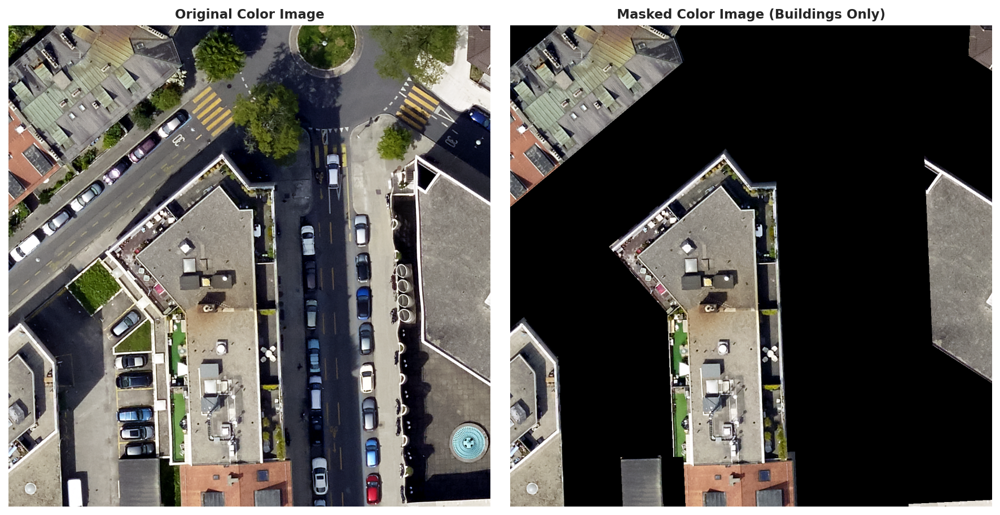


Processing: data/notebook_04/geotiff/tile_1024_split/24991118_tile_10_8_2931b8.tif
  Original - Bands: 3, Dtype: uint8
  Original - Size: 1280 x 1280
  Original - Data range: 1 to 254
  Original color interpretation: (<ColorInterp.red: 3>, <ColorInterp.green: 4>, <ColorInterp.blue: 5>)
  Found 45 buildings
  Masked data shape: (3, 1280, 1280)
  Masked data range: 0 to 254
  Coverage: 155.08%
  ✅ Saved: data/notebook_07/analyse_quartier/20250703-091757/masked_images/24991118_tile_10_8_2931b8_masked.tif
  Verification - Bands: 3, Dtype: uint8
  Verification - Color interp: (<ColorInterp.red: 3>, <ColorInterp.green: 4>, <ColorInterp.blue: 5>)
  Verification - Data range: 0 to 254
  🎨 Creating color preview...


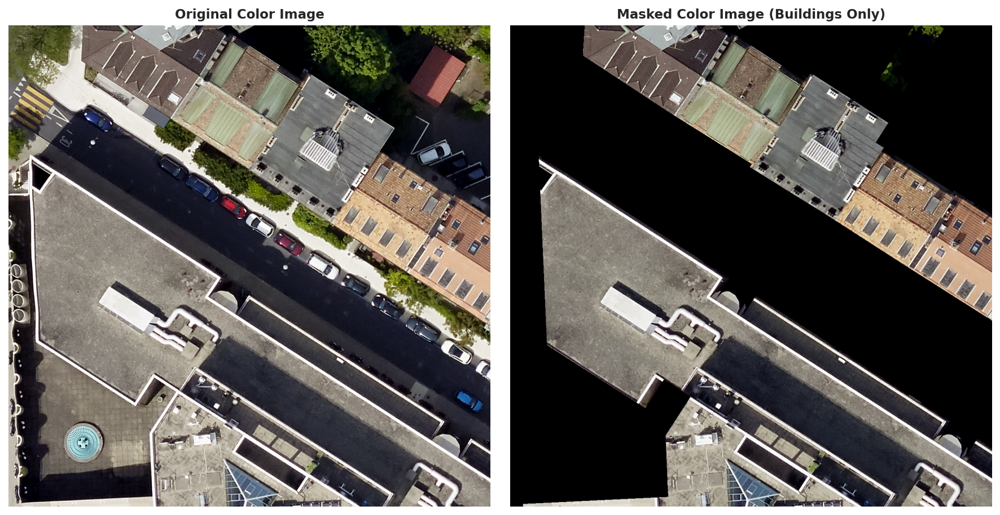


Processing: data/notebook_04/geotiff/tile_1024_split/24991118_tile_11_7_4db66f.tif
  Original - Bands: 3, Dtype: uint8
  Original - Size: 1280 x 1280
  Original - Data range: 1 to 254
  Original color interpretation: (<ColorInterp.red: 3>, <ColorInterp.green: 4>, <ColorInterp.blue: 5>)
  Found 51 buildings
  Masked data shape: (3, 1280, 1280)
  Masked data range: 0 to 254
  Coverage: 135.36%
  ✅ Saved: data/notebook_07/analyse_quartier/20250703-091757/masked_images/24991118_tile_11_7_4db66f_masked.tif
  Verification - Bands: 3, Dtype: uint8
  Verification - Color interp: (<ColorInterp.red: 3>, <ColorInterp.green: 4>, <ColorInterp.blue: 5>)
  Verification - Data range: 0 to 254
  🎨 Creating color preview...


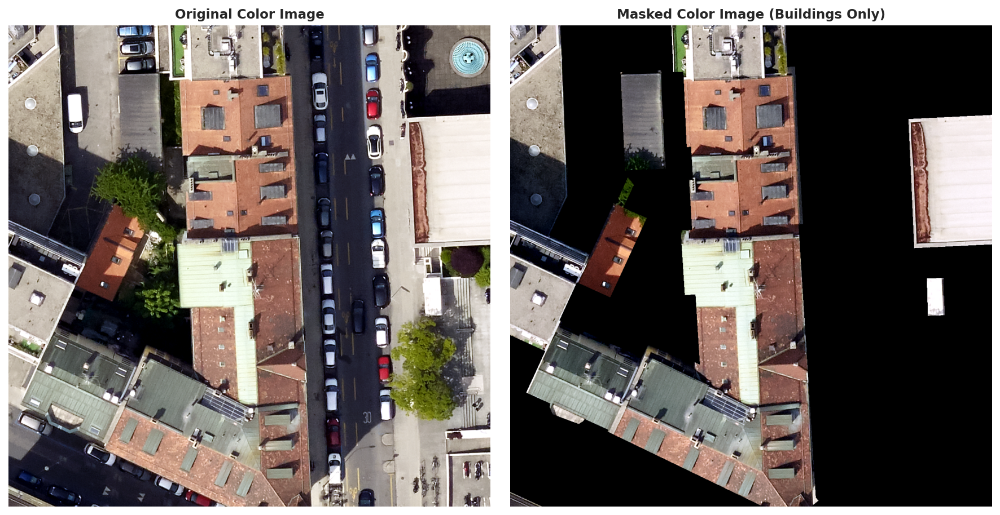


Processing: data/notebook_04/geotiff/tile_1024_split/24991118_tile_11_8_6b34a7.tif
  Original - Bands: 3, Dtype: uint8
  Original - Size: 1280 x 1280
  Original - Data range: 1 to 254
  Original color interpretation: (<ColorInterp.red: 3>, <ColorInterp.green: 4>, <ColorInterp.blue: 5>)
  Found 79 buildings
  Masked data shape: (3, 1280, 1280)
  Masked data range: 0 to 254
  Coverage: 207.91%
  ✅ Saved: data/notebook_07/analyse_quartier/20250703-091757/masked_images/24991118_tile_11_8_6b34a7_masked.tif
  Verification - Bands: 3, Dtype: uint8
  Verification - Color interp: (<ColorInterp.red: 3>, <ColorInterp.green: 4>, <ColorInterp.blue: 5>)
  Verification - Data range: 0 to 254
  🎨 Creating color preview...


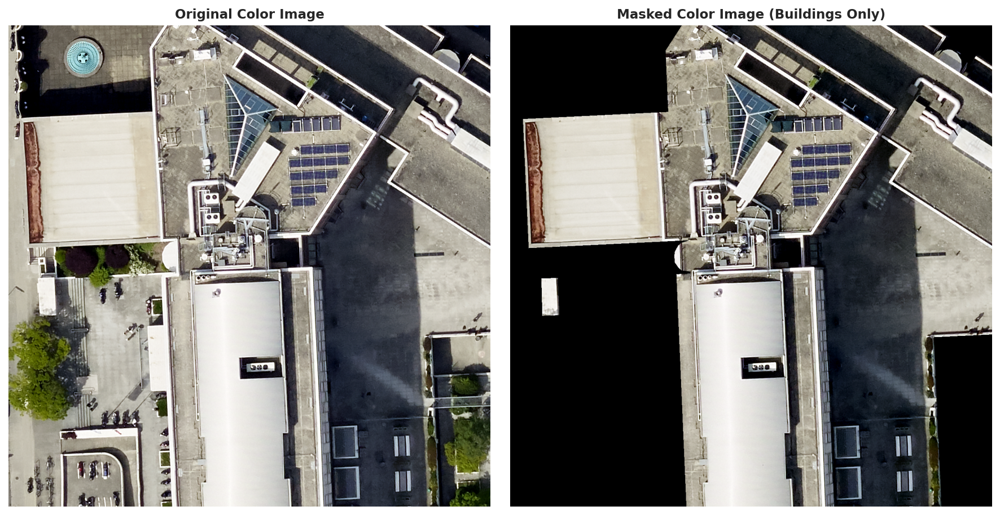


Processing: data/notebook_04/geotiff/tile_1024_split/24991118_tile_12_7_7ce219.tif
  Original - Bands: 3, Dtype: uint8
  Original - Size: 1280 x 1280
  Original - Data range: 1 to 254
  Original color interpretation: (<ColorInterp.red: 3>, <ColorInterp.green: 4>, <ColorInterp.blue: 5>)
  Found 34 buildings
  Masked data shape: (3, 1280, 1280)
  Masked data range: 0 to 254
  Coverage: 128.72%
  ✅ Saved: data/notebook_07/analyse_quartier/20250703-091757/masked_images/24991118_tile_12_7_7ce219_masked.tif
  Verification - Bands: 3, Dtype: uint8
  Verification - Color interp: (<ColorInterp.red: 3>, <ColorInterp.green: 4>, <ColorInterp.blue: 5>)
  Verification - Data range: 0 to 254
  🎨 Creating color preview...


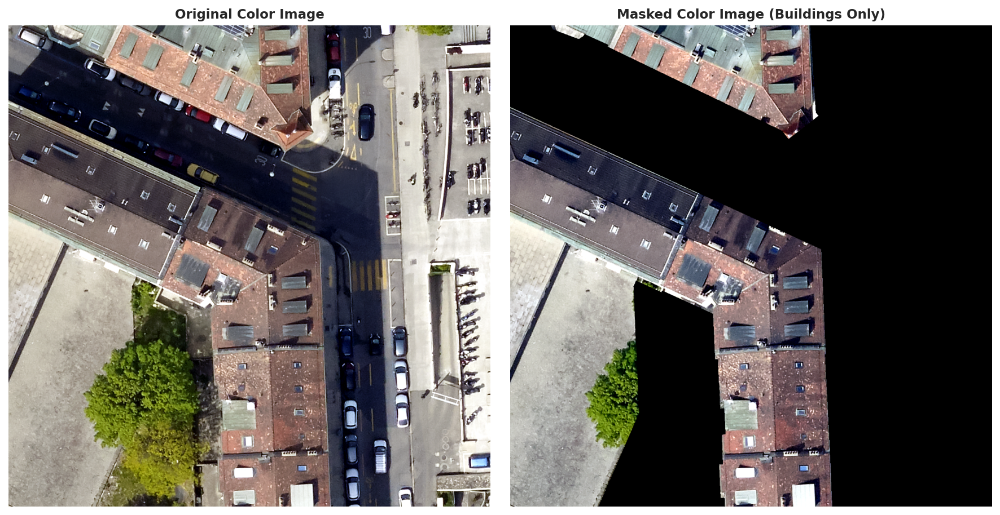


Processing: data/notebook_04/geotiff/tile_1024_split/24991118_tile_12_8_83485c.tif
  Original - Bands: 3, Dtype: uint8
  Original - Size: 1280 x 1280
  Original - Data range: 1 to 254
  Original color interpretation: (<ColorInterp.red: 3>, <ColorInterp.green: 4>, <ColorInterp.blue: 5>)
  Found 139 buildings
  Masked data shape: (3, 1280, 1280)
  Masked data range: 0 to 254
  Coverage: 142.48%
  ✅ Saved: data/notebook_07/analyse_quartier/20250703-091757/masked_images/24991118_tile_12_8_83485c_masked.tif
  Verification - Bands: 3, Dtype: uint8
  Verification - Color interp: (<ColorInterp.red: 3>, <ColorInterp.green: 4>, <ColorInterp.blue: 5>)
  Verification - Data range: 0 to 254
  🎨 Creating color preview...


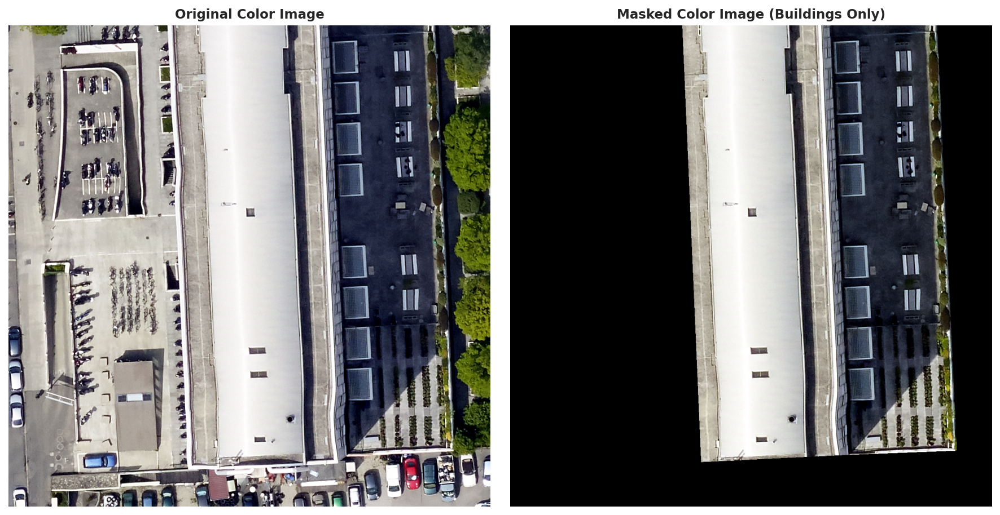


🎉 All done! Color masked images saved to: data/notebook_07/analyse_quartier/20250703-091757/masked_images

📋 Final verification of all output files:
  ✅ 24991118_tile_10_7_18eac4_masked.tif:
     - Bands: 3 (uint8)
     - Color interp: (<ColorInterp.red: 3>, <ColorInterp.green: 4>, <ColorInterp.blue: 5>)
     - Size: 1280 x 1280
     - CRS: EPSG:2056
     - Non-zero pixels: 1,756,572
  ✅ 24991118_tile_10_8_2931b8_masked.tif:
     - Bands: 3 (uint8)
     - Color interp: (<ColorInterp.red: 3>, <ColorInterp.green: 4>, <ColorInterp.blue: 5>)
     - Size: 1280 x 1280
     - CRS: EPSG:2056
     - Non-zero pixels: 2,540,772
  ✅ 24991118_tile_11_7_4db66f_masked.tif:
     - Bands: 3 (uint8)
     - Color interp: (<ColorInterp.red: 3>, <ColorInterp.green: 4>, <ColorInterp.blue: 5>)
     - Size: 1280 x 1280
     - CRS: EPSG:2056
     - Non-zero pixels: 2,217,702
  ✅ 24991118_tile_11_8_6b34a7_masked.tif:
     - Bands: 3 (uint8)
     - Color interp: (<ColorInterp.red: 3>, <ColorInterp.green: 4>, <C

In [ ]:
import geopandas as gpd
import rasterio
from rasterio.mask import mask
from rasterio.enums import ColorInterp
from shapely.geometry import box
import numpy as np
from pathlib import Path
import os
import matplotlib.pyplot as plt

# List of input GeoTIFF images to process
images_to_process = [
    "data/notebook_04/geotiff/tile_1024_split/24991118_tile_10_7_18eac4.tif",
    "data/notebook_04/geotiff/tile_1024_split/24991118_tile_10_8_2931b8.tif",
    "data/notebook_04/geotiff/tile_1024_split/24991118_tile_11_7_4db66f.tif",
    "data/notebook_04/geotiff/tile_1024_split/24991118_tile_11_8_6b34a7.tif",
    "data/notebook_04/geotiff/tile_1024_split/24991118_tile_12_7_7ce219.tif",
    "data/notebook_04/geotiff/tile_1024_split/24991118_tile_12_8_83485c.tif",
]

# Define output directory for masked images
output_dir = QUARTIER_OUTPUT_DIR / "masked_images"
os.makedirs(output_dir, exist_ok=True)

# Load building polygons from GeoPackage
gdf_toitures = gpd.read_file("data/SITG/CAD_BATIMENT_HORSOL_TOIT_2024-11-03.gpkg")
print(f"Loaded {len(gdf_toitures)} building polygons")

# Process each image in the list
for image_path in images_to_process:
    print(f"\nProcessing: {image_path}")
    
    with rasterio.open(image_path) as src:
        print(f"  Original - Bands: {src.count}, Dtype: {src.dtypes[0]}")
        print(f"  Original - Size: {src.width} x {src.height}")
        print(f"  Original - Data range: {src.read(1).min()} to {src.read(1).max()}")
        
        # Store original color interpretation for later use
        original_colorinterp = src.colorinterp
        print(f"  Original color interpretation: {original_colorinterp}")
        
        # Copy raster profile for output
        profile = src.profile.copy()
        
        # Reproject polygons to match raster CRS if necessary
        if gdf_toitures.crs != src.crs:
            gdf_reproj = gdf_toitures.to_crs(src.crs)
        else:
            gdf_reproj = gdf_toitures
        
        # Select building polygons that intersect the raster extent
        image_bbox = box(*src.bounds)
        intersecting = gdf_reproj[gdf_reproj.intersects(image_bbox)]
        
        if len(intersecting) == 0:
            print(f"  No buildings found in {image_path}")
            continue
        
        print(f"  Found {len(intersecting)} buildings")
        
        # Apply mask to retain only building areas in the raster
        geometries = intersecting.geometry.values
        masked_data, masked_transform = mask(
            src, 
            geometries, 
            crop=False,
            invert=False,    # Keep pixels inside building polygons
            nodata=None,     # Do not set nodata explicitly unless present in original
            filled=True
        )
        
        print(f"  Masked data shape: {masked_data.shape}")
        print(f"  Masked data range: {masked_data.min()} to {masked_data.max()}")
        
        # Calculate percentage of non-zero (building) pixels
        non_zero_pixels = np.count_nonzero(masked_data)
        total_pixels = masked_data.shape[1] * masked_data.shape[2]
        coverage_pct = (non_zero_pixels / total_pixels) * 100
        print(f"  Coverage: {coverage_pct:.2f}%")
        
        # Update output profile with correct properties
        profile.update({
            'driver': 'GTiff',
            'compress': 'lzw',
            'tiled': True,
            'count': src.count,
            'dtype': src.dtypes[0],
            'width': masked_data.shape[2],
            'height': masked_data.shape[1],
            'transform': masked_transform,
        })
        
        # Set nodata value only if present in the original raster
        if src.nodata is not None:
            profile['nodata'] = src.nodata
        
        # Define output file path
        base_name = Path(image_path).stem
        output_path = os.path.join(output_dir, f"{base_name}_masked.tif")
        
        with rasterio.open(output_path, 'w', **profile) as dst:
            # Write all raster bands to output
            dst.write(masked_data)
            
            # Set color interpretation for RGB(A) images
            if src.count >= 3:
                dst.colorinterp = [ColorInterp.red, ColorInterp.green, ColorInterp.blue]
                if src.count == 4:
                    dst.colorinterp = [ColorInterp.red, ColorInterp.green, ColorInterp.blue, ColorInterp.alpha]
            else:
                dst.colorinterp = original_colorinterp
            
            # Copy metadata tags from source raster
            dst.update_tags(**src.tags())
            
            # Add processing metadata to output
            dst.update_tags(
                PROCESSING='Building mask applied',
                MASK_COVERAGE=f'{coverage_pct:.2f}%',
                BUILDINGS_COUNT=str(len(intersecting))
            )
        
        print(f"  Saved: {output_path}")
        
        # Verify the saved output file
        with rasterio.open(output_path) as verify:
            print(f"  Verification - Bands: {verify.count}, Dtype: {verify.dtypes[0]}")
            print(f"  Verification - Color interp: {verify.colorinterp}")
            print(f"  Verification - Data range: {verify.read(1).min()} to {verify.read(1).max()}")
        
        # Display color preview if the image has at least 3 bands
        if src.count >= 3:
            print("  Creating color preview...")
            
            # Prepare RGB composite for masked image using percentile stretch
            rgb_display = np.zeros((masked_data.shape[1], masked_data.shape[2], 3), dtype=np.uint8)
            for i in range(3):
                band_data = masked_data[i].astype(np.float32)
                non_zero_mask = band_data > 0
                if np.any(non_zero_mask):
                    non_zero_values = band_data[non_zero_mask]
                    p2, p98 = np.percentile(non_zero_values, [2, 98])
                    stretched = np.clip((band_data - p2) / (p98 - p2) * 255, 0, 255)
                    rgb_display[:, :, i] = stretched.astype(np.uint8)
            
            # Prepare RGB composite for original image
            fig, axes = plt.subplots(1, 2, figsize=(12, 6))
            original_rgb = np.zeros((src.height, src.width, 3), dtype=np.uint8)
            original_data = src.read()
            for i in range(3):
                band_data = original_data[i].astype(np.float32)
                p2, p98 = np.percentile(band_data, [2, 98])
                stretched = np.clip((band_data - p2) / (p98 - p2) * 255, 0, 255)
                original_rgb[:, :, i] = stretched.astype(np.uint8)
            
            axes[0].imshow(original_rgb)
            axes[0].set_title('Original Color Image')
            axes[0].axis('off')
            
            axes[1].imshow(rgb_display)
            axes[1].set_title('Masked Color Image (Buildings Only)')
            axes[1].axis('off')
            
            plt.tight_layout()
            plt.show()

print(f"\nAll processing complete. Masked images saved to: {output_dir}")

# Verify all output files and print summary
print("\nFinal verification of all output files:")
for image_path in images_to_process:
    base_name = Path(image_path).stem
    output_path = os.path.join(output_dir, f"{base_name}_masked.tif")
    if os.path.exists(output_path):
        with rasterio.open(output_path) as check:
            print(f"  {base_name}_masked.tif:")
            print(f"     - Bands: {check.count} ({check.dtypes[0]})")
            print(f"     - Color interp: {check.colorinterp}")
            print(f"     - Size: {check.width} x {check.height}")
            print(f"     - CRS: {check.crs}")
            print(f"     - Non-zero pixels: {np.count_nonzero(check.read()):,}")
    else:
        print(f"  {base_name}_masked.tif: NOT FOUND")

print("\nNote: You can open these files in GIS software for further analysis.")


In [ ]:
import os
import torch
import torch.nn.functional as F
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
from tqdm import tqdm
from pathlib import Path
import pandas as pd
from datetime import datetime
import json
import gc
import matplotlib.cm as cm

# Example function to run inference on new images using k-fold ensembles
def run_inference_on_new_images(viz_system, df_model_results, unseen_image_paths, output_dir):
    """
    Run inference on new images using k-fold ensembles for predefined model architectures and backbones.

    Args:
        viz_system: Instance of LaTeXVisualizationSystem.
        df_model_results: DataFrame containing model information.
        unseen_image_paths: List of file paths to new images for inference.
        output_dir: Directory where results will be saved.
    """
    # List of model architectures and backbones to use for ensemble inference
    models_to_use = [
        ('unet', 'tu-mambaout_small'),
        ('upernet', 'tu-efficientnetv2_rw_s.ra2_in1k'),
        ('segformer', 'tu-mambaout_base'),
        ('linknet', 'timm-efficientnet-b5'),
        ('unetplusplus', 'tu-efficientnetv2_rw_s.ra2_in1k'),
        ('segformer', 'tu-regnety_080.ra3_in1k'),
    ]
    
    # Process each model ensemble
    for arch, backbone in models_to_use:
        model_name = f"{arch}_{backbone}"
        print("\n" + "=" * 60)
        print(f"Processing ensemble: {model_name}")
        print("=" * 60)
        
        # Collect all k-fold models for the current architecture-backbone combination
        model_infos = []
        for fold in range(5):
            mask = (
                (df_model_results['architecture'] == arch) &
                (df_model_results['backbone'] == backbone) &
                (df_model_results['validation_fold'] == fold)
            )
            fold_models = df_model_results[mask]
            if not fold_models.empty:
                model_infos.append(fold_models.iloc[0].to_dict())
        
        if len(model_infos) == 0:
            print(f"No models found for {model_name}")
            continue
        
        print(f"Found {len(model_infos)} fold models")
        
        # Run ensemble inference and save results
        viz_system.inference_on_unseen_images(
            model_infos,
            unseen_image_paths,
            output_dir,
            ensemble_name=model_name,
            device_id=0
        )


In [ ]:
# List of new masked image paths for inference
unseen_images = [
    QUARTIER_OUTPUT_DIR / "masked_images/24991118_tile_10_7_18eac4_masked.tif",
    QUARTIER_OUTPUT_DIR / "masked_images/24991118_tile_10_8_2931b8_masked.tif",
    QUARTIER_OUTPUT_DIR / "masked_images/24991118_tile_11_7_4db66f_masked.tif",
    QUARTIER_OUTPUT_DIR / "masked_images/24991118_tile_11_8_6b34a7_masked.tif",
    QUARTIER_OUTPUT_DIR / "masked_images/24991118_tile_12_7_7ce219_masked.tif",
    QUARTIER_OUTPUT_DIR / "masked_images/24991118_tile_12_8_83485c_masked.tif",
]

logger.info("Loading existing model results...")
df_model_results = pd.read_parquet(SAVED_MODEL_RESULTS_PARQUET_PATH)
df_per_image_results = pd.read_parquet(SAVED_PER_IMAGE_RESULTS_PARQUET_PATH)

# Keep only the best model for each architecture-backbone-validation_fold combination
df_model_results = df_model_results.sort_values('eval_test_iou', ascending=False).drop_duplicates(
    subset=['architecture', 'backbone', 'validation_fold'], keep='first'
).reset_index(drop=True)

# Load test image and mask paths
test_paths = load_test_data(TEST_DATASET_FILE, DATASET_IMAGES_DIR, DATASET_MASKS_DIR)

# Initialize the visualization system
viz_system = LaTeXVisualizationSystem(img_size=IMG_SIZE)

# Run inference on new masked images using k-fold ensembles
run_inference_on_new_images(viz_system, df_model_results, unseen_images, QUARTIER_OUTPUT_DIR)

2025-07-03 09:54:21 | INFO | Loading existing results...



Processing ensemble: unet_tu-mambaout_small
Found 5 fold models

🔮 Running inference on 6 unseen images
📁 Output directory: data/notebook_07/analyse_quartier/20250703-091757/unet_tu-mambaout_small_20250703_095421
Ensemble prediction with 5 models...


Processing models: 100%|██████████| 5/5 [00:14<00:00,  2.99s/it]



💾 Saving predictions and visualizations...


Processing images: 100%|██████████| 6/6 [00:09<00:00,  1.59s/it]



✅ Inference complete!
📊 Results saved to: data/notebook_07/analyse_quartier/20250703-091757/unet_tu-mambaout_small_20250703_095421
🌐 View results: data/notebook_07/analyse_quartier/20250703-091757/unet_tu-mambaout_small_20250703_095421/index.html

Processing ensemble: upernet_tu-efficientnetv2_rw_s.ra2_in1k
Found 5 fold models

🔮 Running inference on 6 unseen images
📁 Output directory: data/notebook_07/analyse_quartier/20250703-091757/upernet_tu-efficientnetv2_rw_s.ra2_in1k_20250703_095445
Ensemble prediction with 5 models...


Processing models: 100%|██████████| 5/5 [00:12<00:00,  2.46s/it]



💾 Saving predictions and visualizations...


Processing images: 100%|██████████| 6/6 [00:08<00:00,  1.47s/it]



✅ Inference complete!
📊 Results saved to: data/notebook_07/analyse_quartier/20250703-091757/upernet_tu-efficientnetv2_rw_s.ra2_in1k_20250703_095445
🌐 View results: data/notebook_07/analyse_quartier/20250703-091757/upernet_tu-efficientnetv2_rw_s.ra2_in1k_20250703_095445/index.html

Processing ensemble: segformer_tu-mambaout_base
Found 5 fold models

🔮 Running inference on 6 unseen images
📁 Output directory: data/notebook_07/analyse_quartier/20250703-091757/segformer_tu-mambaout_base_20250703_095506
Ensemble prediction with 5 models...


Processing models: 100%|██████████| 5/5 [00:20<00:00,  4.04s/it]



💾 Saving predictions and visualizations...


Processing images: 100%|██████████| 6/6 [00:08<00:00,  1.45s/it]



✅ Inference complete!
📊 Results saved to: data/notebook_07/analyse_quartier/20250703-091757/segformer_tu-mambaout_base_20250703_095506
🌐 View results: data/notebook_07/analyse_quartier/20250703-091757/segformer_tu-mambaout_base_20250703_095506/index.html

Processing ensemble: linknet_timm-efficientnet-b5
Found 5 fold models

🔮 Running inference on 6 unseen images
📁 Output directory: data/notebook_07/analyse_quartier/20250703-091757/linknet_timm-efficientnet-b5_20250703_095535
Ensemble prediction with 5 models...


Processing models: 100%|██████████| 5/5 [00:16<00:00,  3.28s/it]



💾 Saving predictions and visualizations...


Processing images: 100%|██████████| 6/6 [00:09<00:00,  1.54s/it]



✅ Inference complete!
📊 Results saved to: data/notebook_07/analyse_quartier/20250703-091757/linknet_timm-efficientnet-b5_20250703_095535
🌐 View results: data/notebook_07/analyse_quartier/20250703-091757/linknet_timm-efficientnet-b5_20250703_095535/index.html

Processing ensemble: unetplusplus_tu-efficientnetv2_rw_s.ra2_in1k
Found 5 fold models

🔮 Running inference on 6 unseen images
📁 Output directory: data/notebook_07/analyse_quartier/20250703-091757/unetplusplus_tu-efficientnetv2_rw_s.ra2_in1k_20250703_095601
Ensemble prediction with 5 models...


Processing models: 100%|██████████| 5/5 [00:09<00:00,  1.95s/it]



💾 Saving predictions and visualizations...


Processing images: 100%|██████████| 6/6 [00:09<00:00,  1.57s/it]



✅ Inference complete!
📊 Results saved to: data/notebook_07/analyse_quartier/20250703-091757/unetplusplus_tu-efficientnetv2_rw_s.ra2_in1k_20250703_095601
🌐 View results: data/notebook_07/analyse_quartier/20250703-091757/unetplusplus_tu-efficientnetv2_rw_s.ra2_in1k_20250703_095601/index.html

Processing ensemble: segformer_tu-regnety_080.ra3_in1k
Found 5 fold models

🔮 Running inference on 6 unseen images
📁 Output directory: data/notebook_07/analyse_quartier/20250703-091757/segformer_tu-regnety_080.ra3_in1k_20250703_095620
Ensemble prediction with 5 models...


Processing models: 100%|██████████| 5/5 [00:10<00:00,  2.10s/it]



💾 Saving predictions and visualizations...


Processing images: 100%|██████████| 6/6 [00:08<00:00,  1.47s/it]


✅ Inference complete!
📊 Results saved to: data/notebook_07/analyse_quartier/20250703-091757/segformer_tu-regnety_080.ra3_in1k_20250703_095620
🌐 View results: data/notebook_07/analyse_quartier/20250703-091757/segformer_tu-regnety_080.ra3_in1k_20250703_095620/index.html


# END